In [1]:
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.metrics.cluster import mutual_info_score
from sklearn.cluster import KMeans
from scipy.stats import entropy
import copy
import math
import os
import numpy as np
import matplotlib.pyplot as plt


## Model

In [4]:
class TransformerModel(nn.Module):
    def __init__(self, ntokens, emsize, nhead, d_hid, nlayers, dropout=0.5):
        super(TransformerModel, self).__init__()
        self.model_type = 'Transformer'
        self.src_mask = None
        self.pos_encoder = PositionalEncoding(emsize, dropout)
        encoder_layers = nn.TransformerEncoderLayer(emsize, nhead, d_hid, dropout)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layers, nlayers)
        self.encoder = nn.Embedding(ntokens, emsize)
        self.emsize = emsize
        self.decoder = nn.Linear(emsize, ntokens)
        self.ntokens=ntokens
        self.init_weights()

    def _generate_square_subsequent_mask(self, sz):
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

    def init_weights(self):
        initrange = 0.1
        self.encoder.weight.data.uniform_(-initrange, initrange)
        self.decoder.bias.data.zero_()
        self.decoder.weight.data.uniform_(-initrange, initrange)

    def forward(self, src,verbose=False):
        if self.src_mask is None or self.src_mask.size(0) != len(src):
            device = src.device
            mask = self._generate_square_subsequent_mask(len(src)).to(device)
            self.src_mask = mask

        src = self.encoder(src) * math.sqrt(self.emsize)
        src = self.pos_encoder(src)
        output = self.transformer_encoder(src, self.src_mask)
        self.store=output.detach().numpy().copy()
        if verbose:
            print(output.shape)
        output = self.decoder(output)
        return output

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * -(math.log(10000.0) / d_model))
        pe = torch.zeros(max_len, 1, d_model)
        pe[:, 0, 0::2] = torch.sin(position * div_term)
        pe[:, 0, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0)]
        return self.dropout(x)

# Parameters
ntokens = 8  # size of vocabulary
emsize = 20  # embedding dimension
nhead = 4  # number of heads in the nn.MultiheadAttention
d_hid = 20  # dimension of the feedforward network model in nn.TransformerEncoder
nlayers = 2  # number of nn.TransformerEncoderLayer
dropout = 0.03  # dropout probability

# Initialize the model
model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
print(model)

TransformerModel(
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.03, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-1): 2 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=20, out_features=20, bias=True)
        )
        (linear1): Linear(in_features=20, out_features=20, bias=True)
        (dropout): Dropout(p=0.03, inplace=False)
        (linear2): Linear(in_features=20, out_features=20, bias=True)
        (norm1): LayerNorm((20,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((20,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.03, inplace=False)
        (dropout2): Dropout(p=0.03, inplace=False)
      )
    )
  )
  (encoder): Embedding(8, 20)
  (decoder): Linear(in_features=20, out_features=8, bias=True)
)


## Test function

In [5]:
def test(model, source, target):
    model.eval()  # Set the model to evaluation mode
    correct = 0
    total = 0
    
    source = torch.tensor(source, dtype=torch.long)
    target = torch.tensor(target, dtype=torch.long)

    with torch.no_grad():  # No need to track gradients
        src = source.transpose(0, 1)  # Adjust for the expected input dimensions [sequence_length, batch_size]
        tgt = target.transpose(0, 1)  # Same adjustment for the target
        
        output = model(src)  # Compute the output
        
        # The output is [sequence_length, batch_size, ntokens]. Get the most likely token predictions
        predictions = output.argmax(dim=2)  # Get the index of the max log-probability
        print('prediction shape', predictions.shape)
        correct += (predictions == tgt).sum().item()  # Count how many predictions match the target
        total += tgt.numel()  # Total number of predictions
        
    accuracy = correct / total  # Calculate the accuracy
    return accuracy

## Dataset preparation

In [6]:

def getTrainingData(songStrings, nrOfSongs):
    notes = list("ABCDEFGHI")
    chord = [[0], [1], [2], [3], [4], [5], [6], [7],[8]]
    source = []
    target = []
    for s in range(nrOfSongs):
        for i in range(42):
            sentence = []
            answer = []
            for j in range(4):
                sentence.append(chord[notes.index(songStrings[s][(i+j)%42])][0])
                answer.append(chord[notes.index(songStrings[s][(i+j+1)%42])][0])
            source.append(sentence)
            target.append(answer)
    return np.array(source), np.array(target)

def split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction):
    total_rows = source.shape[0] // 2
    first_set_rows = int(total_rows * fraction)
    second_set_rows = total_rows - first_set_rows

    first_set_indices = np.random.choice(range(total_rows), first_set_rows, replace=False)
    second_set_indices = np.random.choice(range(total_rows, 2 * total_rows), second_set_rows, replace=False)

    combined_indices = np.concatenate((first_set_indices, second_set_indices))
    np.random.shuffle(combined_indices)

    input_list = source[combined_indices]
    output_list = target[combined_indices]

    return input_list, output_list


In [6]:
# Data generation and preparation
songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
])

source_mixed, target_mixed = getTrainingData(songStrings, 2)
fraction = 0.5
input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source_mixed, target_mixed, fraction)

print(input_list.shape, output_list.shape)

(42, 4) (42, 4)


## Decision Tree

In [21]:
from sklearn.tree import DecisionTreeClassifier
import itertools
import numpy as np

songs = [
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",  # Normal
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",  # Reverse
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",  # Daisy bells
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF",  # IGH contradiction
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF",  # 5th note different
    "AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"   # Every 2nd note different
]

def generate_features_from_song(song):
    ins = []
    outs = []
    DB = list(song)
    for i in range(42):
        I = [ord(DB[(i + j) % len(DB)]) for j in range(4)]
        outs.append(ord(DB[(i + 4) % len(DB)]))
        ins.append(I)
    return ins, outs

def train_and_test_classifier(train_song, test_song, train_fraction, n_iterations):
    inputs_train, outputs_train = generate_features_from_song(train_song)
    inputs_test, outputs_test = generate_features_from_song(test_song)
    
    accuracies = []
    for _ in range(n_iterations):
        train_size = int(train_fraction * len(inputs_train))
        test_size = len(inputs_train) - train_size

        all_train_indices = np.random.permutation(len(inputs_train))
        train_indices = all_train_indices[:train_size]
        test_indices = np.random.choice(len(inputs_test), size=test_size, replace=False)

        combined_inputs_train = [inputs_train[i] for i in train_indices] + [inputs_test[i] for i in test_indices]
        combined_outputs_train = [outputs_train[i] for i in train_indices] + [outputs_test[i] for i in test_indices]

        dtc = DecisionTreeClassifier(random_state=40)
        dtc.fit(combined_inputs_train, combined_outputs_train)
        test_accuracy = dtc.score(inputs_test, outputs_test)
        accuracies.append(test_accuracy)

    return accuracies

# Store results in a dictionary
results = {}
n_iterations = 30  # Number of times to repeat training/testing for averaging
fractions = np.arange(0, 101, 10) / 100  # Generate fractions from 1.0 (100%) to 0.0 (0%) in steps of 0.1 (10%)

for fraction in fractions:
    for train_idx, test_idx in itertools.product(range(len(songs)), repeat=2):
        train_song = songs[train_idx]
        test_song = songs[test_idx]
        accuracies = train_and_test_classifier(train_song, test_song, fraction, n_iterations)
        results[(train_idx+1, test_idx+1, fraction)] = accuracies

# Display results
for key, value in results.items():
    train_percent = int(key[2] * 100)
    test_percent = 100 - train_percent
    avg_accuracy = np.mean(value)
    print(f"Training {train_percent}% on Song {key[0]} and {test_percent}% on Song {key[1]}: Average Accuracy over {n_iterations} runs = {avg_accuracy:.2f}")


Training 0% on Song 1 and 100% on Song 1: Average Accuracy over 30 runs = 0.98
Training 0% on Song 1 and 100% on Song 2: Average Accuracy over 30 runs = 0.98
Training 0% on Song 1 and 100% on Song 3: Average Accuracy over 30 runs = 0.93
Training 0% on Song 1 and 100% on Song 4: Average Accuracy over 30 runs = 0.98
Training 0% on Song 1 and 100% on Song 5: Average Accuracy over 30 runs = 1.00
Training 0% on Song 1 and 100% on Song 6: Average Accuracy over 30 runs = 0.98
Training 0% on Song 2 and 100% on Song 1: Average Accuracy over 30 runs = 0.98
Training 0% on Song 2 and 100% on Song 2: Average Accuracy over 30 runs = 0.98
Training 0% on Song 2 and 100% on Song 3: Average Accuracy over 30 runs = 0.93
Training 0% on Song 2 and 100% on Song 4: Average Accuracy over 30 runs = 0.98
Training 0% on Song 2 and 100% on Song 5: Average Accuracy over 30 runs = 1.00
Training 0% on Song 2 and 100% on Song 6: Average Accuracy over 30 runs = 0.98
Training 0% on Song 3 and 100% on Song 1: Average Ac

In [22]:
results

{(1, 1, 0.0): [0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762],
 (1, 2, 0.0): [0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9

### Plots

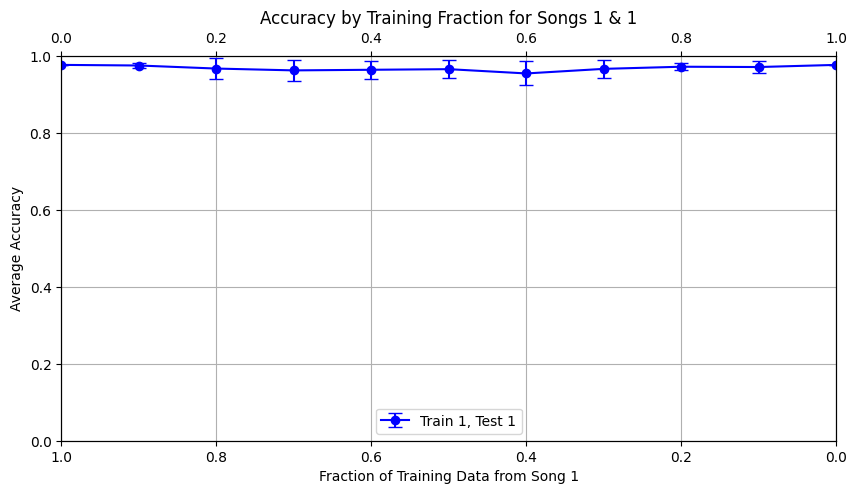

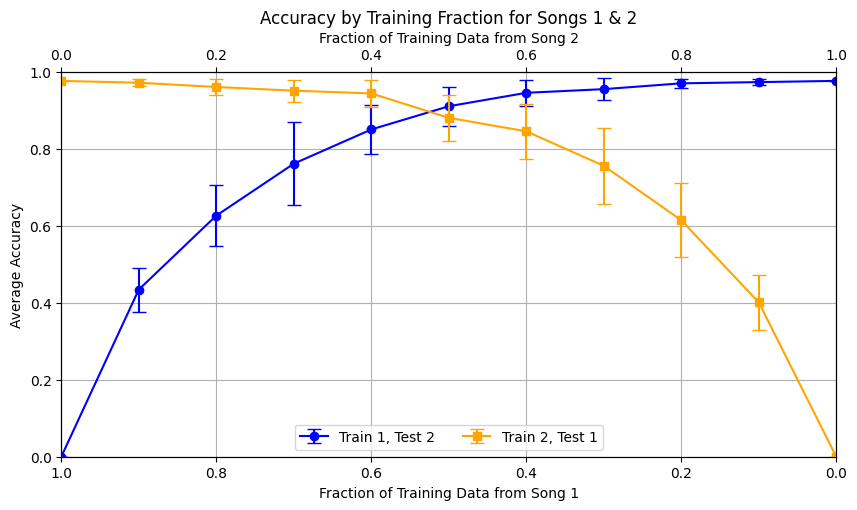

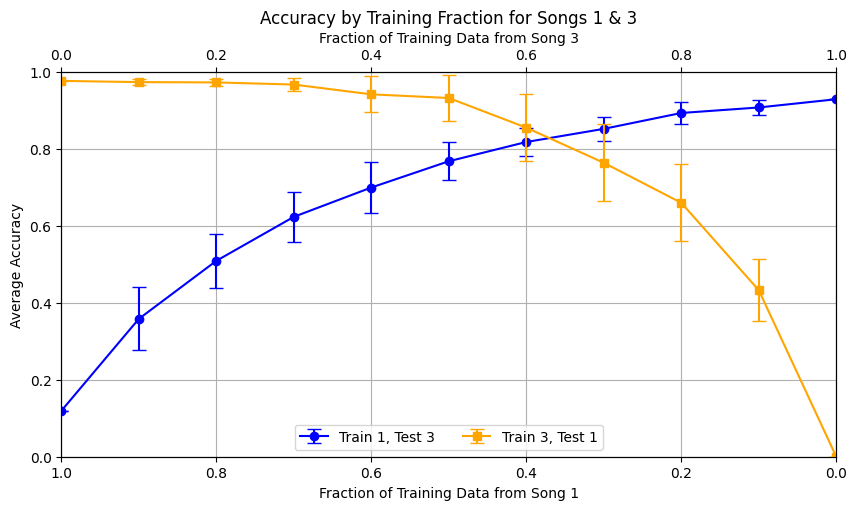

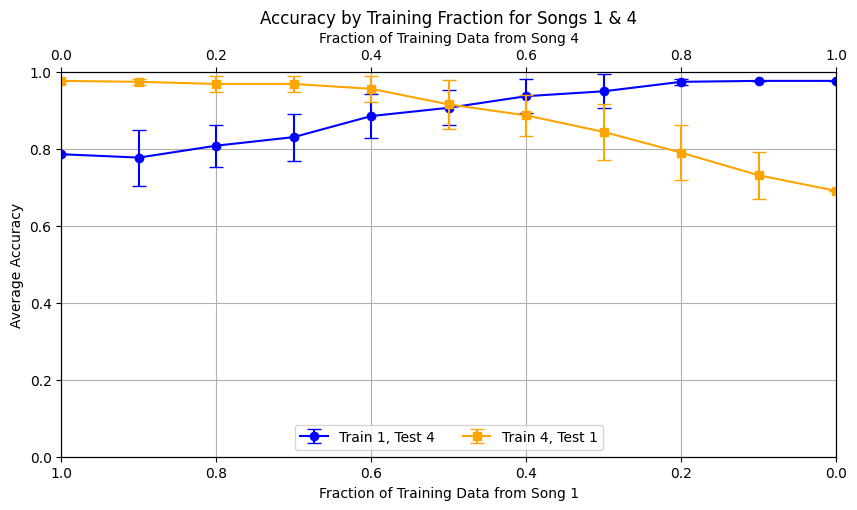

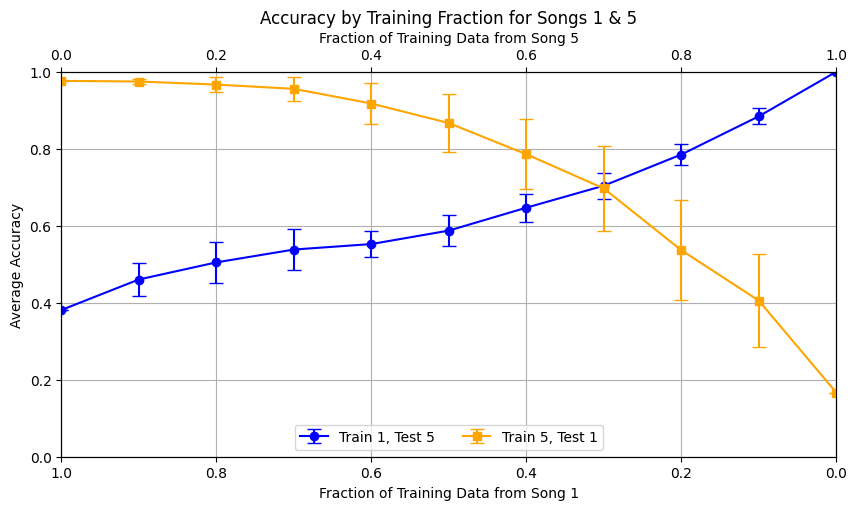

...

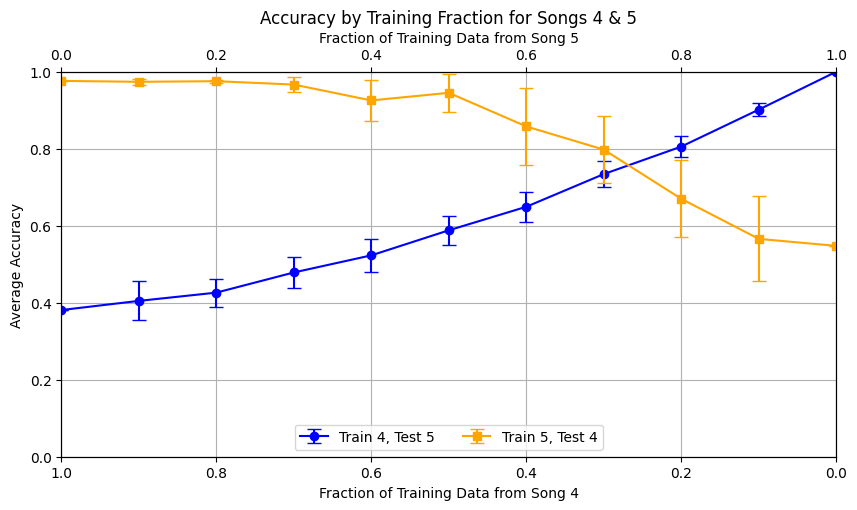

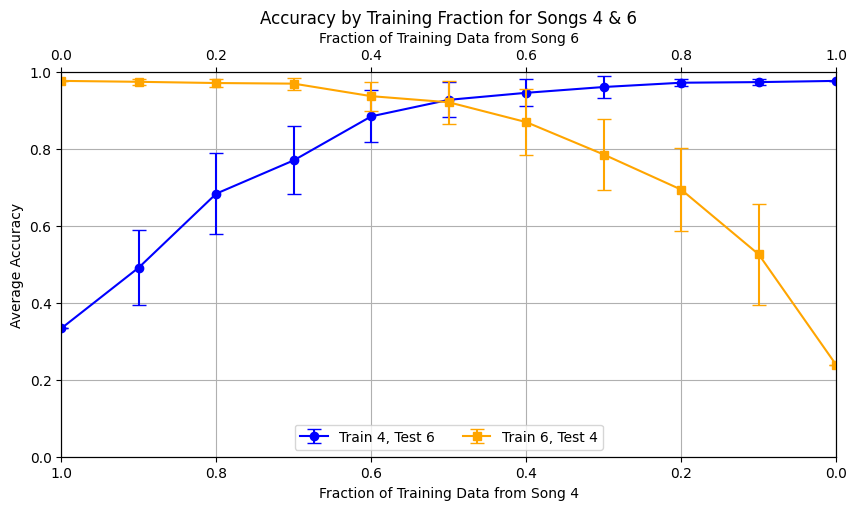

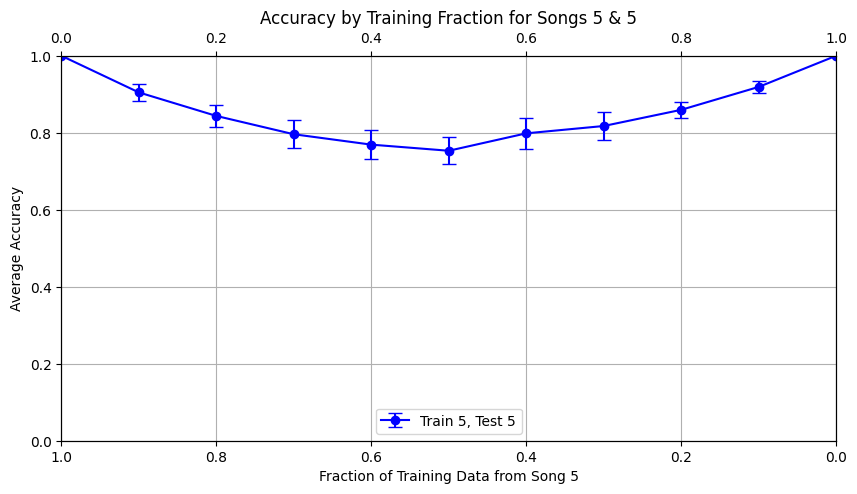

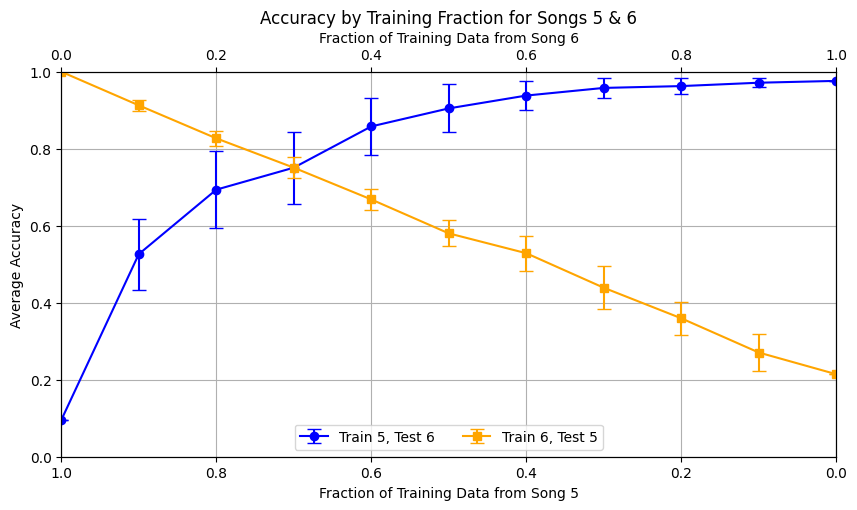

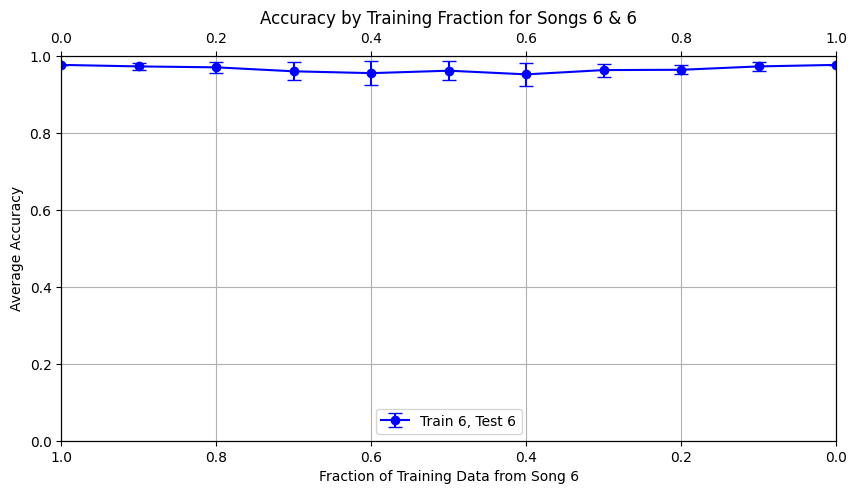

In [23]:
import matplotlib.pyplot as plt
import numpy as np

# Organizing data for plotting by unordered pairs
plot_data = {}
for (train_idx, test_idx, fraction), accuracies in results.items():
    pair_label = tuple(sorted([train_idx, test_idx]))  # Create an unordered pair
    if pair_label not in plot_data:
        plot_data[pair_label] = {}
    order_label = f"Train {train_idx}, Test {test_idx}"
    if order_label not in plot_data[pair_label]:
        plot_data[pair_label][order_label] = ([], [], [])  # Store fractions, means, and std deviations
    mean_accuracy = np.mean(accuracies)
    std_deviation = np.std(accuracies)
    plot_data[pair_label][order_label][0].append(fraction)
    plot_data[pair_label][order_label][1].append(mean_accuracy)
    plot_data[pair_label][order_label][2].append(std_deviation)

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    fig, ax1 = plt.subplots(figsize=(10, 5))

    # Set the y-axis limit to [0, 1] for all plots
    ax1.set_ylim([0, 1])

    # Initialize the secondary axis
    ax2 = ax1.twiny()

    # Sort data by fraction and plot for each training order within the pair
    for order_label, (fractions, means, std_devs) in data.items():
        sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
        fractions, means, std_devs = zip(*sorted_data)

        # Plot with error bars
        if "Train " + str(pair[0]) in order_label:
            ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
            ax1.set_ylabel('Average Accuracy')
            ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
        else:
            ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
            ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
            ax2.set_xlim([0, 1])  # Regular order for the second song

    ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
    lines, labels = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
    ax1.grid(True)
    plt.show()


### Songpair Dictionaries

In [24]:
from collections import defaultdict

# Create a dictionary to hold a dictionary for each song pair
song_pair_dictionaries = defaultdict(dict)

# Populate the song pair dictionaries
for (train_idx, test_idx, fraction), accuracy in results.items():
    key = (train_idx, test_idx)
    if fraction not in song_pair_dictionaries[key]:
        song_pair_dictionaries[key][fraction] = []
    song_pair_dictionaries[key][fraction].append(accuracy)

# Now you have a dictionary of dictionaries, where each key is a song pair (train_idx, test_idx)
# and the value is another dictionary with fractions as keys and accuracies as values

# Example of accessing the data for song pair (1, 2)
song1_song2_results = song_pair_dictionaries[(1, 2)]
#print("Results for Song 1 training and Song 2 testing:", song1_song2_results)


# Now you can directly access results for song 1 training and song 2 testing like:
# print(song_1_2_results)


In [25]:
song_pair_dictionaries[(1, 2)]

{0.0: [[0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762]],
 0.1: [[0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9523809523809523,
   0.9761904761904762,
   0.9523809523809523,
   0.9761904761904762,
   0.9523809523809523,
   0.9761904761904762,
   0.9761904761904762,

## Overlap and Contradiction

### Normal and 5th Note - 0.58(overlap and contradiction)

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2226
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.6332
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.1507
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.8149
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.6226
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.5047
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4524
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.4304
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.4192
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.4127
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.4088
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.4054
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.4073
prediction sha

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.10, Epoch 1, Loss: 2.2085
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 101, Loss: 1.6005
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 201, Loss: 1.1449
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 301, Loss: 0.8709
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 401, Loss: 0.6949
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 501, Loss: 0.6071
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 601, Loss: 0.5960
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 701, Loss: 0.5303
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 801, Loss: 0.5073
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 901, Loss: 0.4924
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1001, Loss: 0.4722
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1101, Loss: 0.4841
prediction shape 

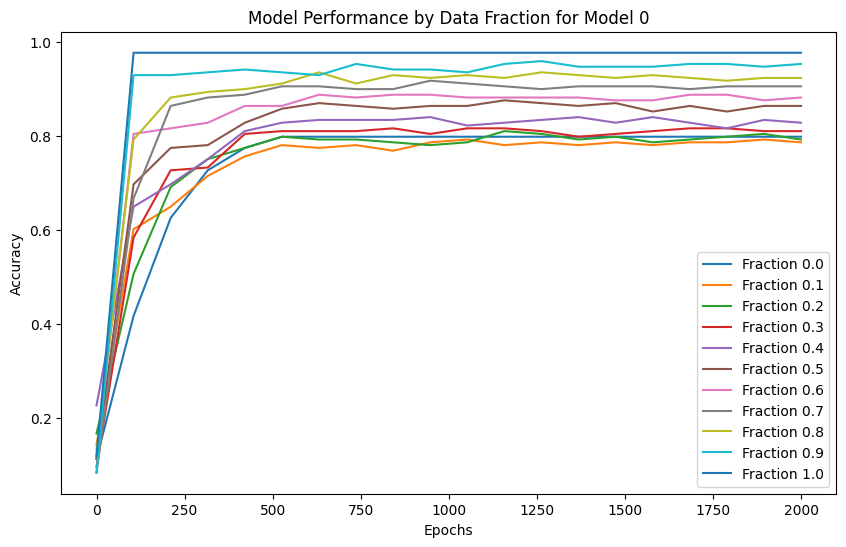

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2308
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.6370
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.1329
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.8087
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.6139
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.5162
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4630
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.4358
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.4224
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.4144
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.4059
prediction shape 

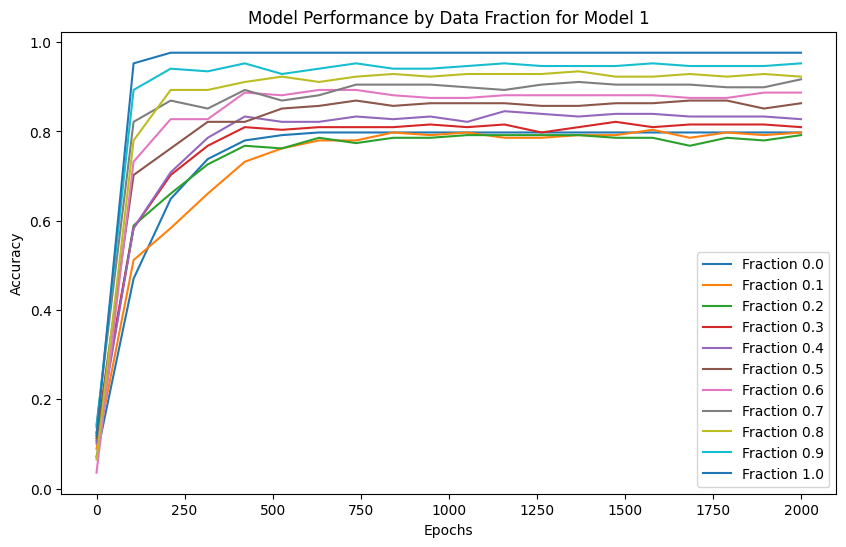

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2064
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.6265
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.1444
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.8397
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.6522
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.5615
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4802
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4423
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4244
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.4166
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.4087
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.4055
prediction shape 

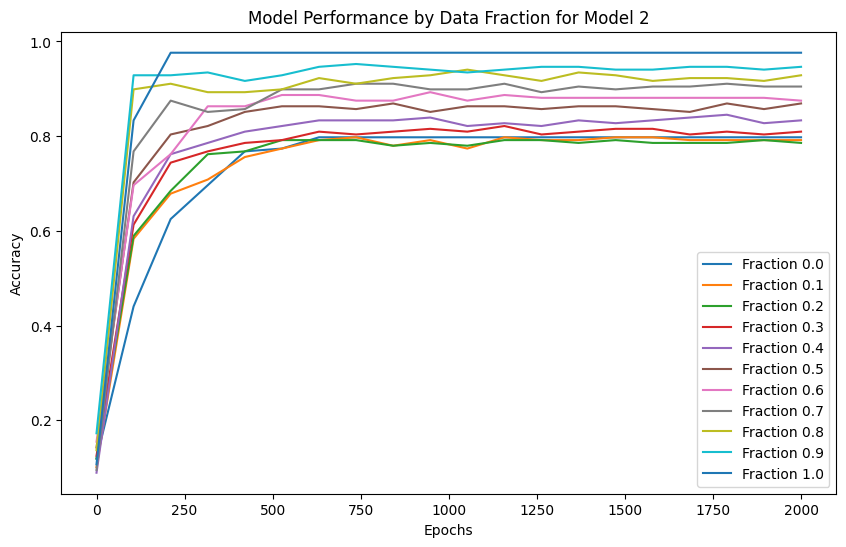

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.6017
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.1273
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.8232
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.6074
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.5239
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.4840
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4623
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.4491
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.4396
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.4324
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.4269
prediction shape 

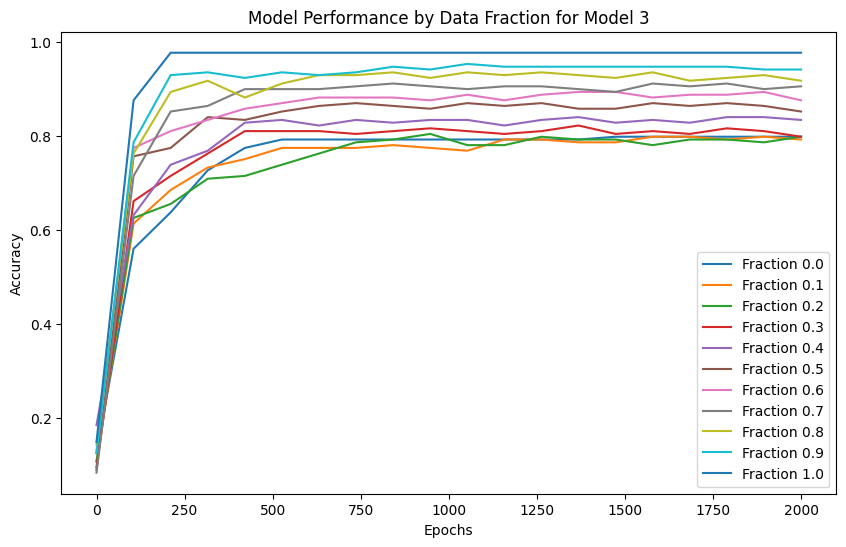

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2197
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.6432
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.1377
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.8283
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.6541
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5532
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.5020
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.4717
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.4470
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.4291
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.4176
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.4109
prediction shape 

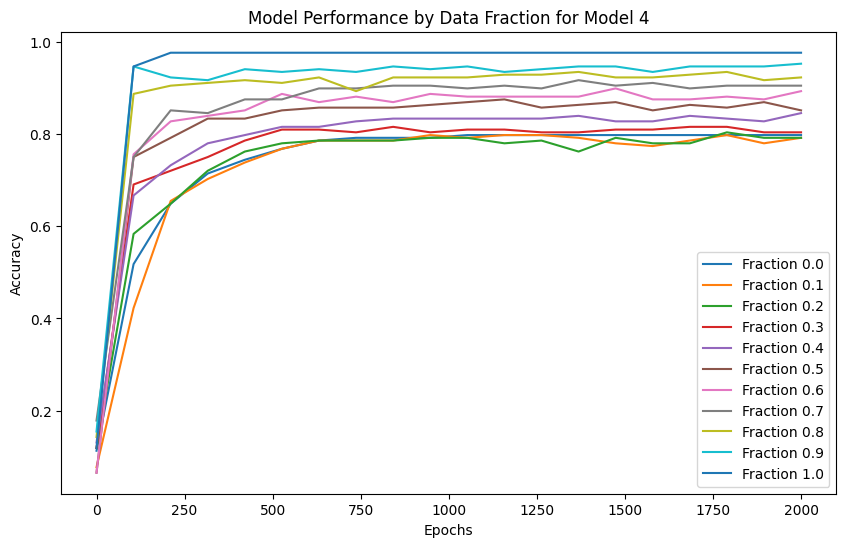

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2126
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.5897
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.0611
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.7619
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.6035
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.5075
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4644
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4391
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.4231
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.4146
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.4096
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.4062
prediction shape 

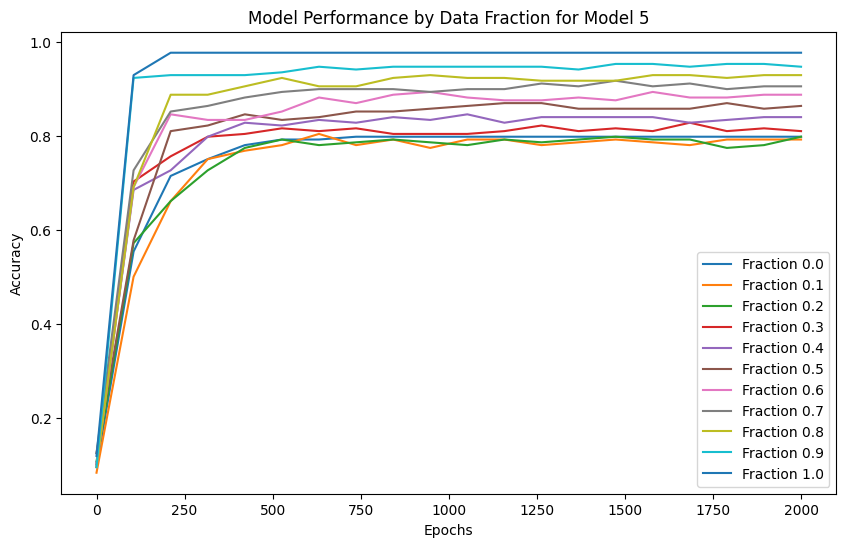

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2302
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.5861
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.1002
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.7892
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.6238
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.5354
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4771
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.4461
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.4304
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.4211
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.4138
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.4100
prediction shape 

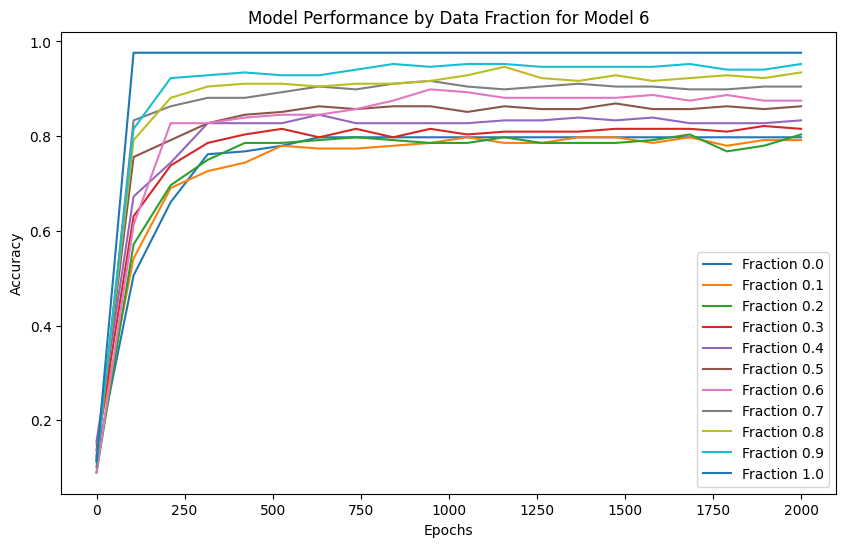

Model 7, Fraction 0.00, Epoch 1, Loss: 2.1967
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.5763
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.0605
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.7637
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.6096
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.5372
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4999
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.4711
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.4528
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.4405
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.4313
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.4219
prediction shape 

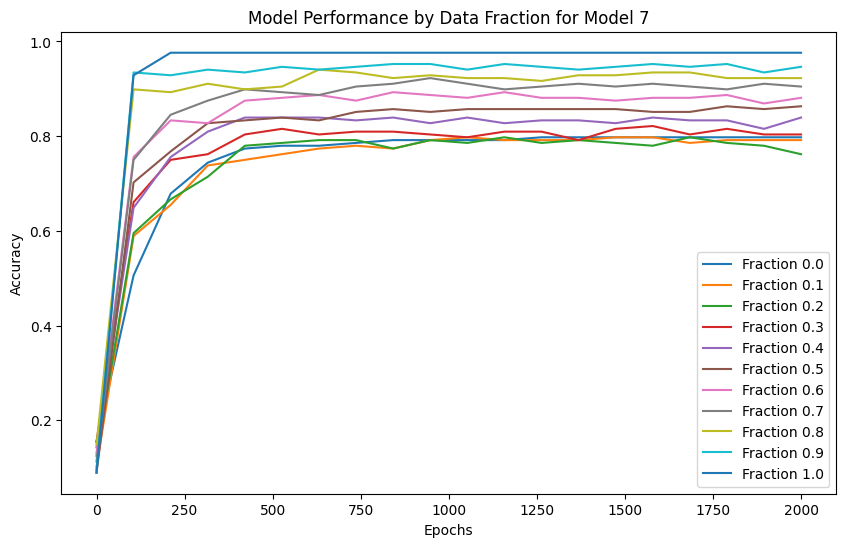

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2246
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.6391
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.1276
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.7970
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.5846
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.4890
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.4482
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.4288
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.4184
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.4122
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.4079
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.4052
prediction shape 

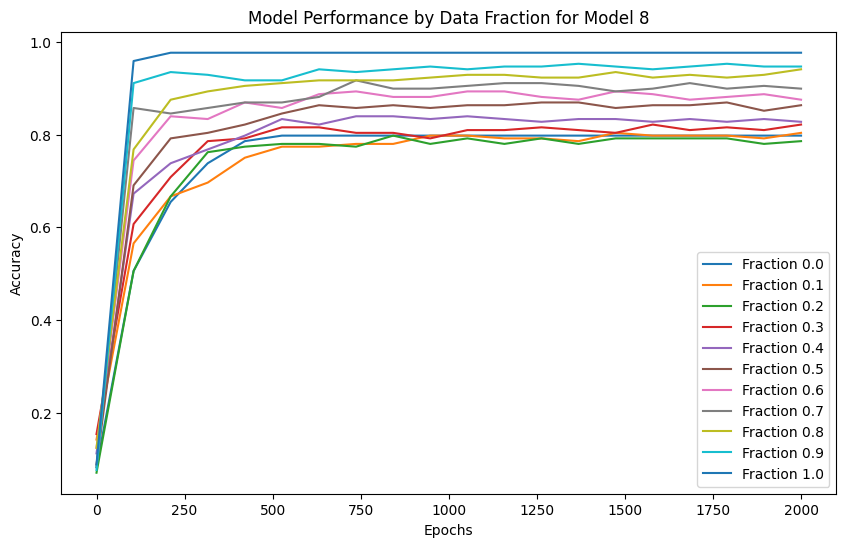

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2035
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.5813
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.1264
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.8409
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.6694
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5587
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.4862
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.4466
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.4269
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.4167
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.4100
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.4071
prediction shape 

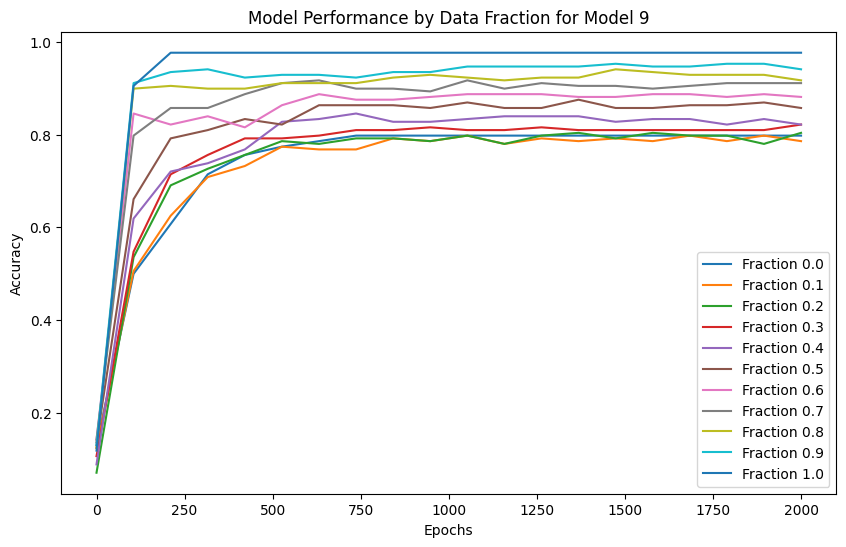

Model 10, Fraction 0.00, Epoch 1, Loss: 2.1974
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.5873
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.1323
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.7956
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.6203
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.5089
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.4552
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.4319
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.4201
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.4132
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.4087
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.4067
predi

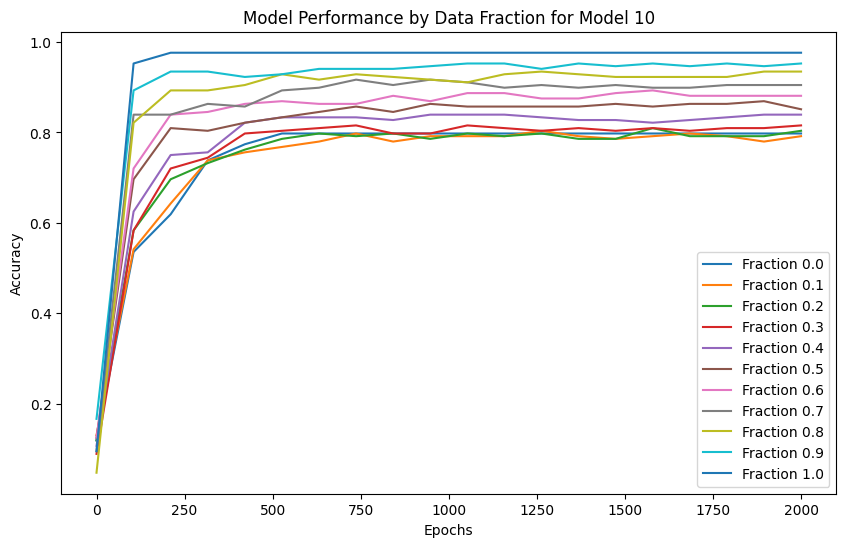

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.6247
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.2055
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.8646
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.6792
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.5793
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.5141
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.4727
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.4440
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.4283
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.4198
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.4137
predi

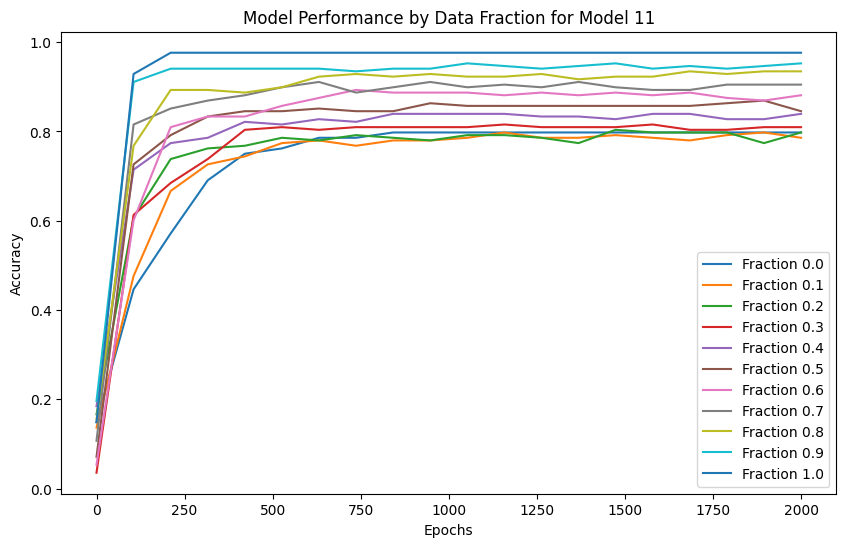

Model 12, Fraction 0.00, Epoch 1, Loss: 2.1998
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.6315
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.0514
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.7735
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.5970
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5115
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4724
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.4456
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.4288
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.4226
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.4117
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.4076
predi

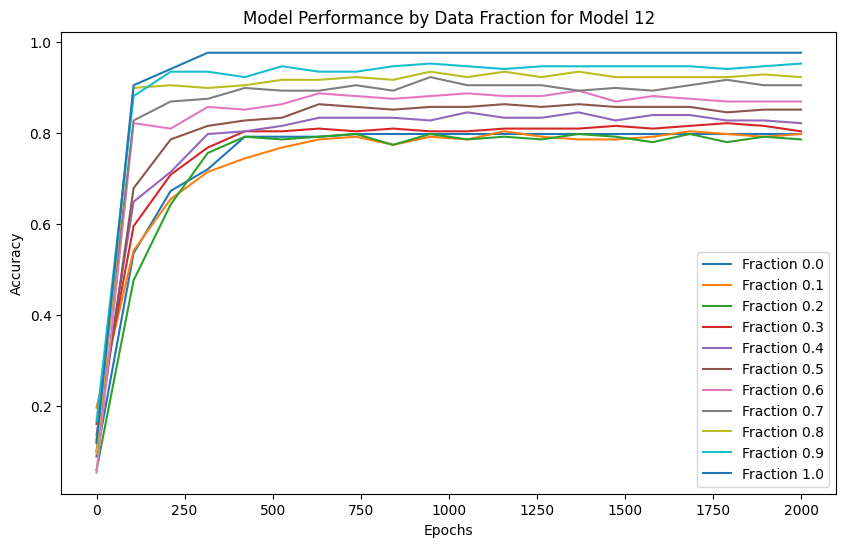

Model 13, Fraction 0.00, Epoch 1, Loss: 2.1920
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.5795
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.0522
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.7834
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.6105
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.5182
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4714
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4473
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.4323
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.4189
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.4105
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.4065
predi

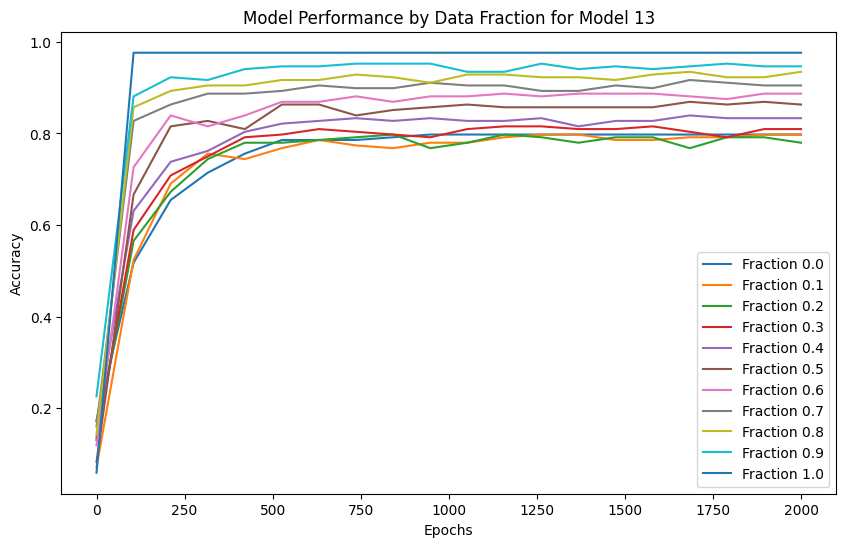

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2302
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.6128
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.1185
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.7682
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.5849
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.4995
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.4538
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.4306
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.4187
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.4079
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.4075
predi

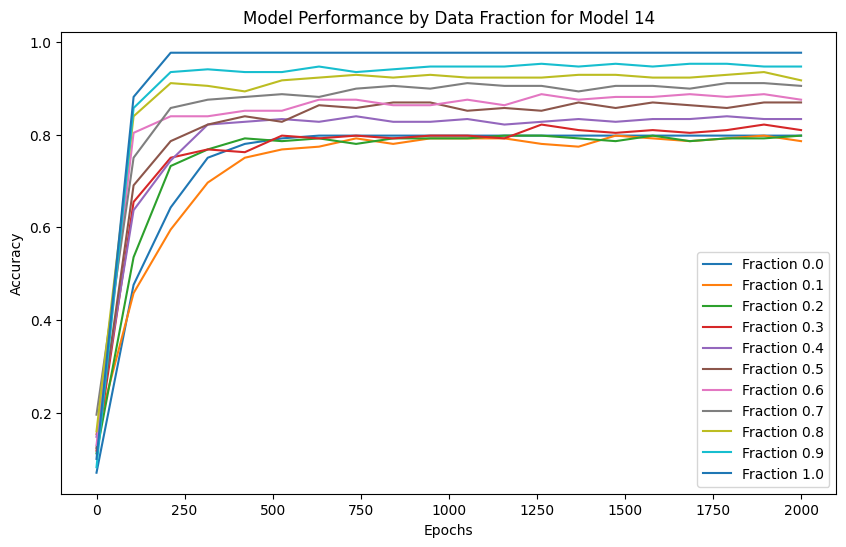

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2145
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.6261
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.1620
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.8328
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.5984
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.4876
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4445
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.4263
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.4181
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.4075
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.4045
predi

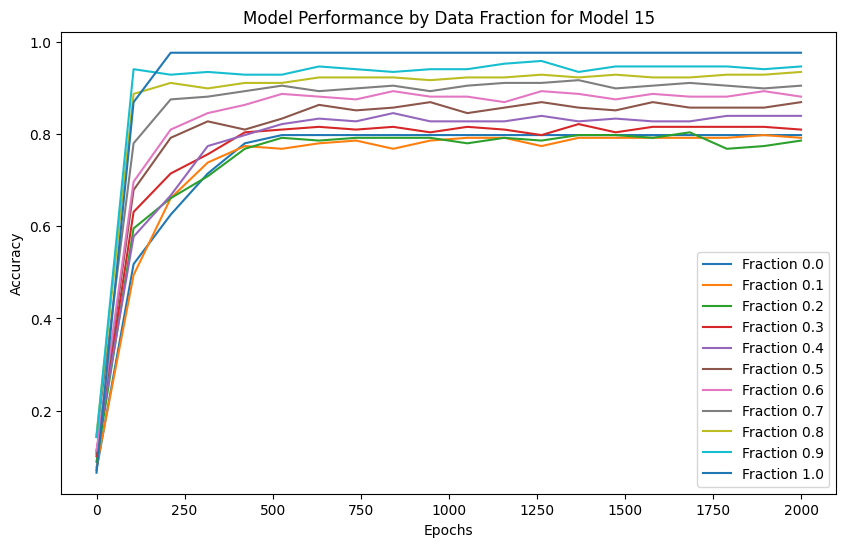

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2059
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.5689
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.1135
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.7816
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.5910
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5078
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.4690
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.4444
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.4236
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.4144
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.4061
predi

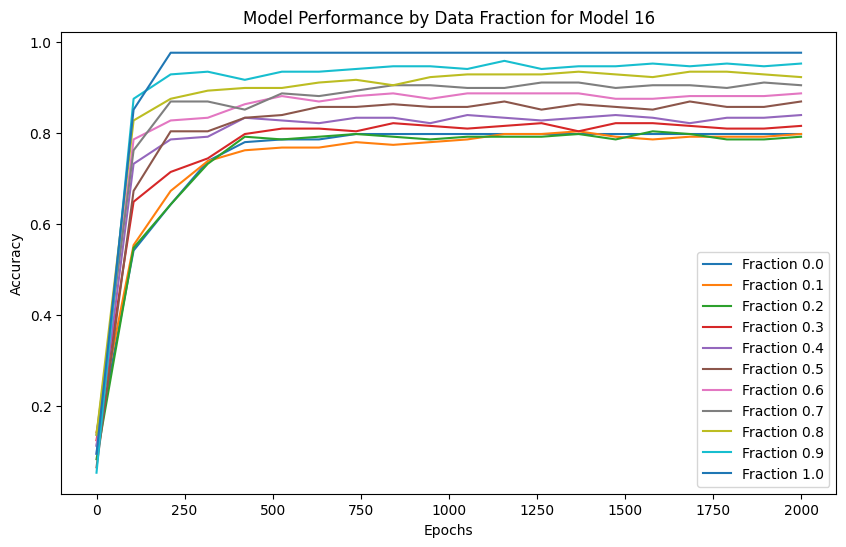

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2115
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.5425
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.0959
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.7722
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.6227
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.5416
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4852
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.4541
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.4318
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.4190
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.4123
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.4078
predi

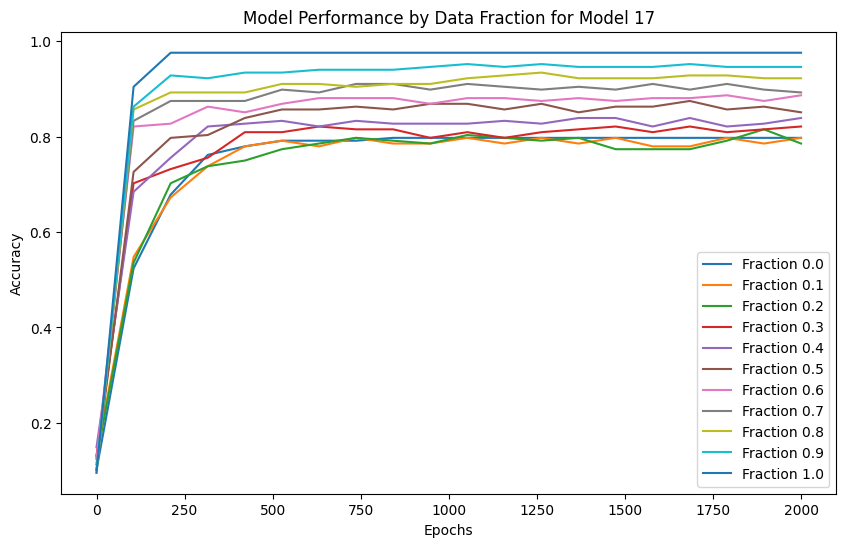

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.5626
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.0750
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.7648
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.6102
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5205
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4688
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.4426
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.4274
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.4198
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.4122
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.4081
predi

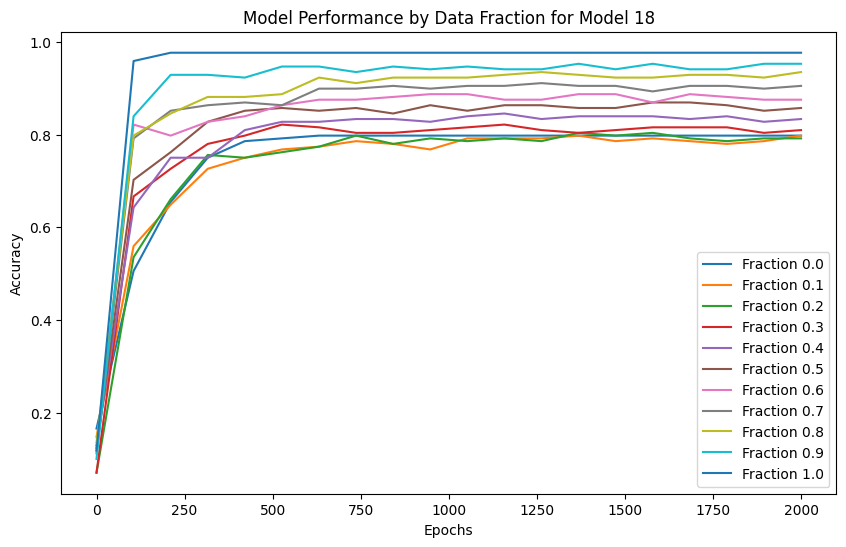

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2164
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.6536
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.1555
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.8224
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6079
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.4959
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.4470
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.4304
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.4179
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.4080
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.4054
predi

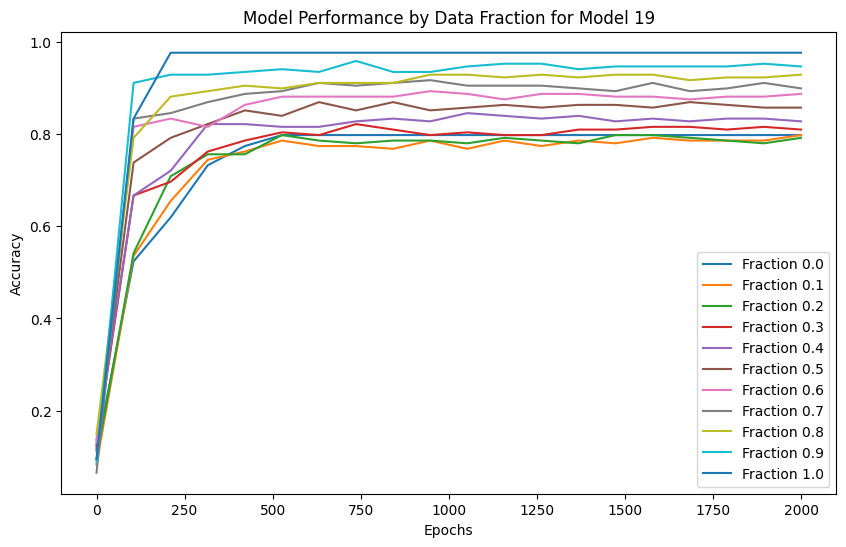

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2297
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.6023
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.1079
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.7670
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.5968
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5048
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4549
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.4338
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.4223
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.4149
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.4060
predi

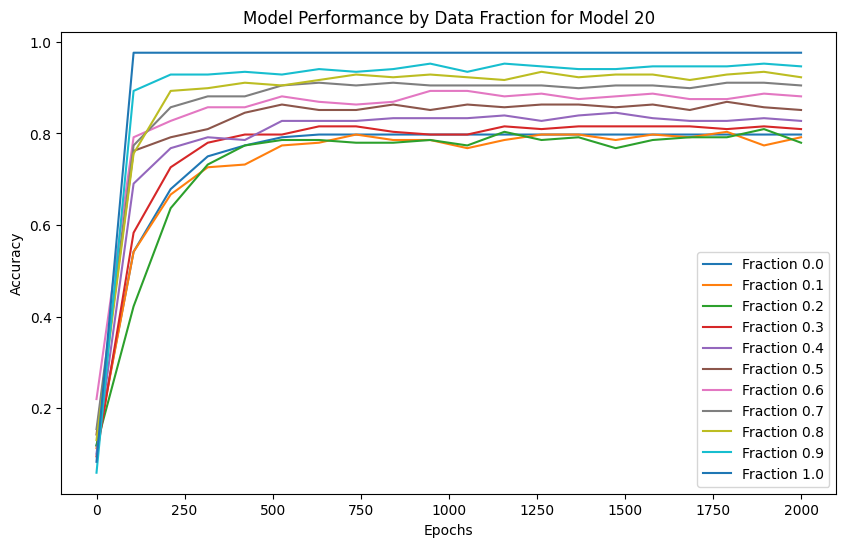

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2238
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.6203
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.1171
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.7786
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.5998
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5067
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.4590
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.4358
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.4231
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.4148
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.4104
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.4074
predi

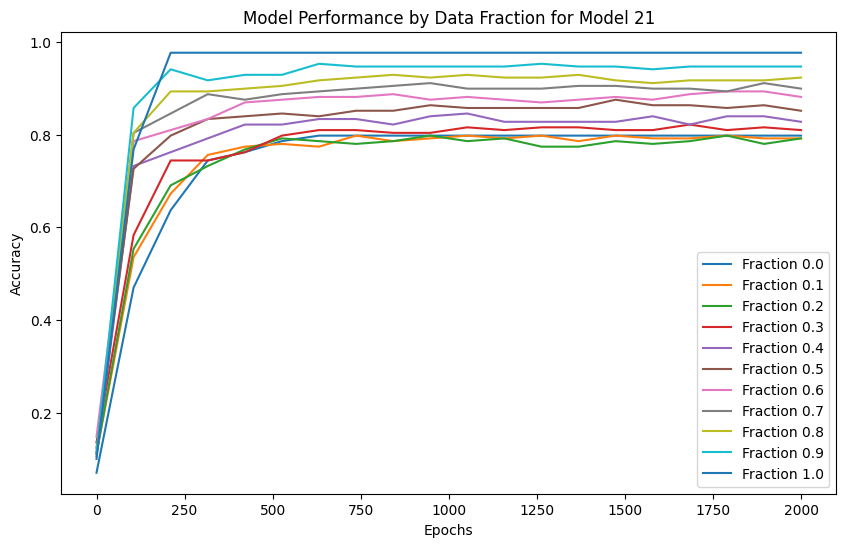

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2083
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.5585
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.0880
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.7695
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.5954
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.5052
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.4590
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.4322
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.4194
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.4124
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.4081
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.4050
predi

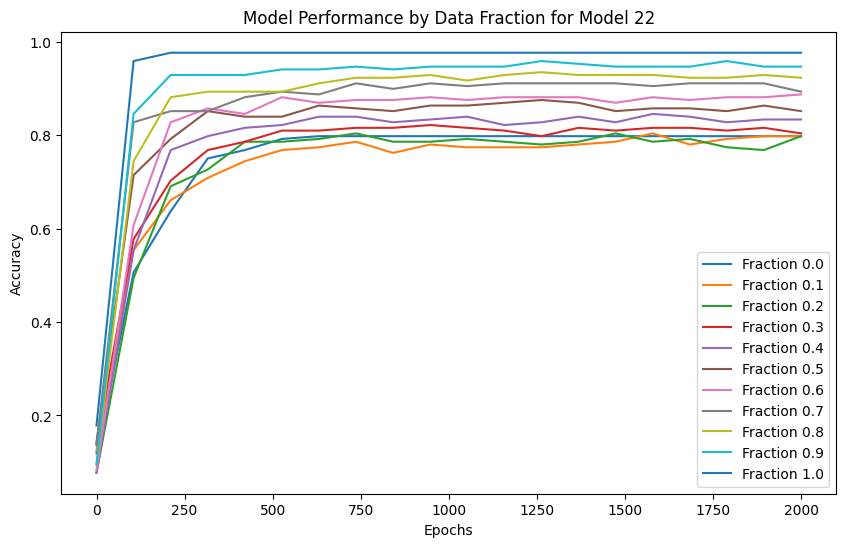

Model 23, Fraction 0.00, Epoch 1, Loss: 2.1843
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.6093
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.1014
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.8031
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.6154
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5179
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4634
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.4356
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.4232
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.4149
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.4122
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.4079
predi

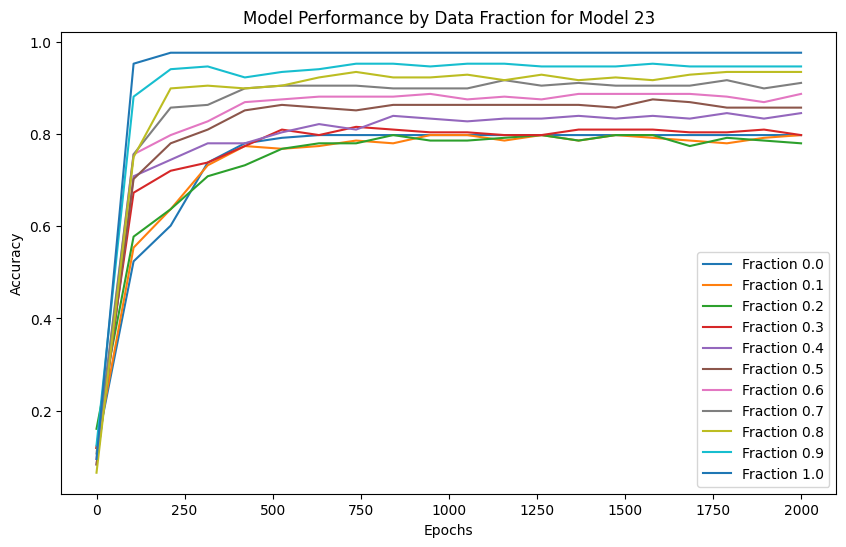

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2338
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.6105
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.1222
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.8097
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.6187
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.5137
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4677
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.4415
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.4257
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.4164
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.4106
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.4084
predi

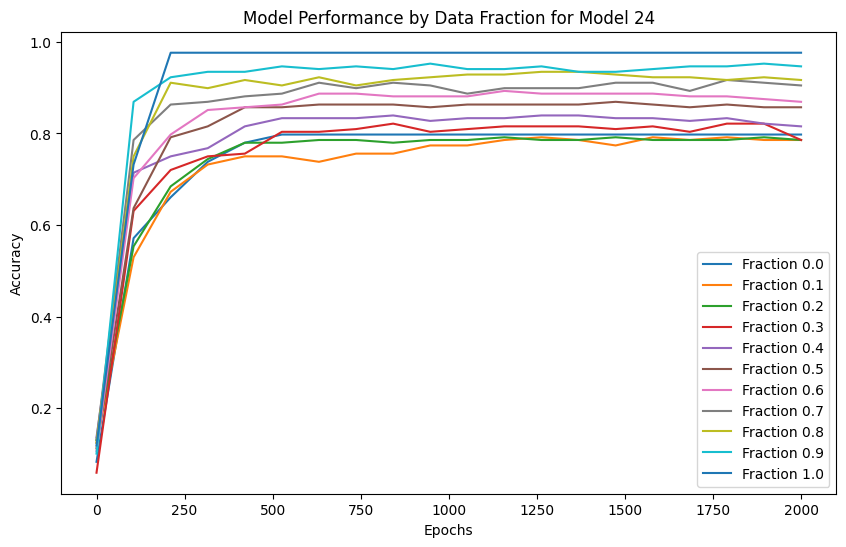

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2066
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.6316
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.1268
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.7891
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.5910
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.4953
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4534
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.4326
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.4207
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.4137
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.4090
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.4058
predi

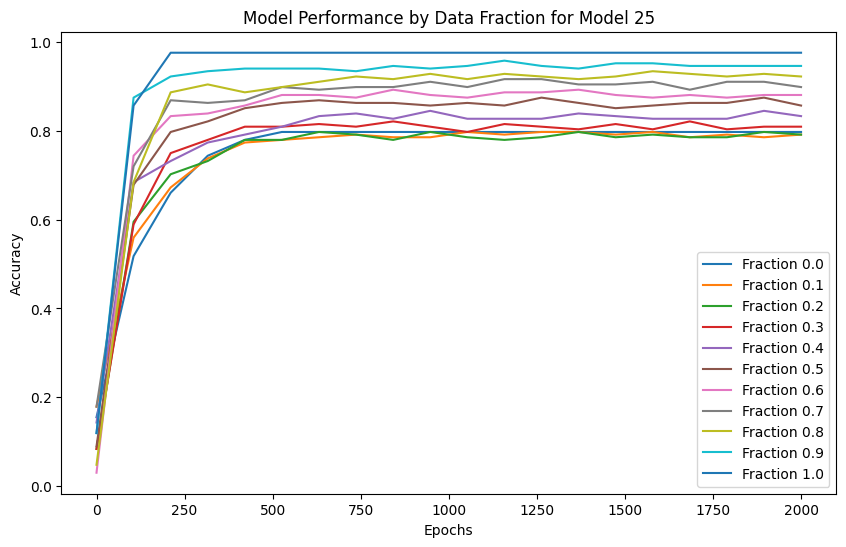

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2108
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.6138
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.0570
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.7921
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6191
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.5063
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.4566
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.4331
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.4209
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.4139
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.4111
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.4074
predi

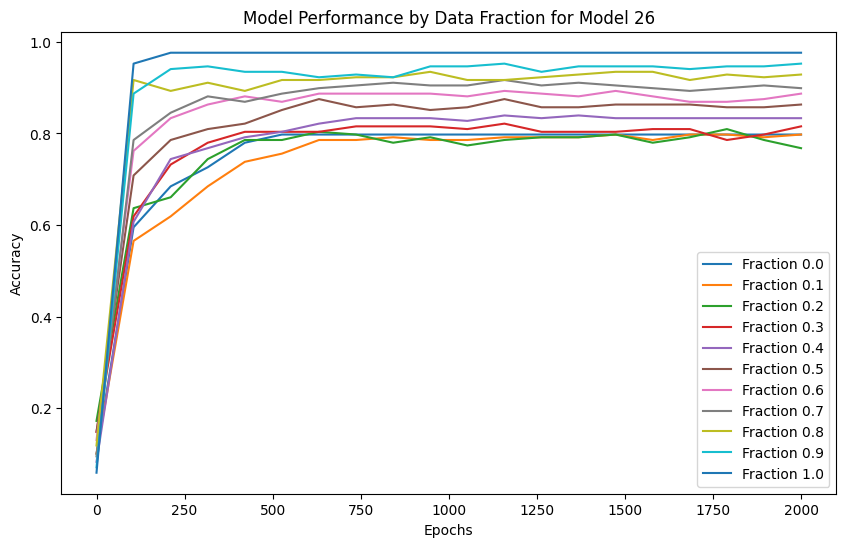

Model 27, Fraction 0.00, Epoch 1, Loss: 2.1978
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.6344
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.0530
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.7536
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.5828
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.4867
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4417
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.4248
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.4154
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.4101
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.4063
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.4035
predi

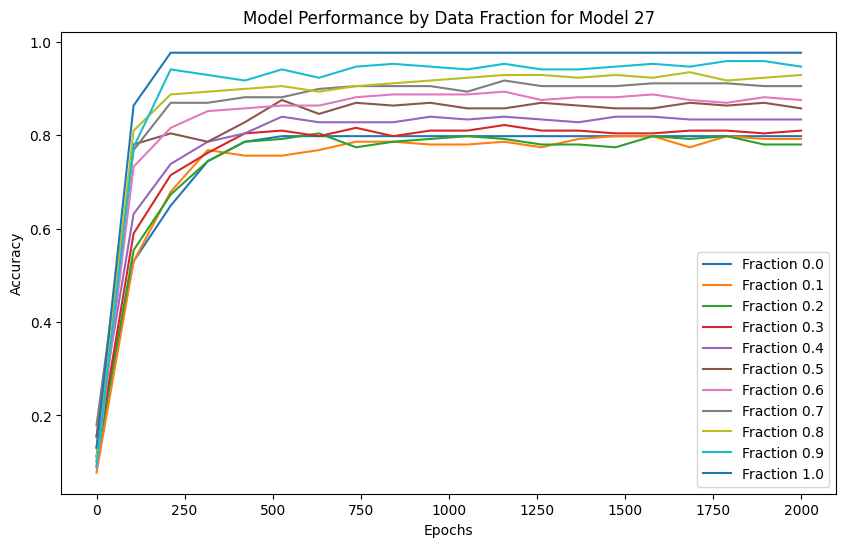

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2254
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.6596
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.1220
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.7794
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.6145
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.5319
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4864
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.4583
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.4416
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.4294
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.4197
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.4117
predi

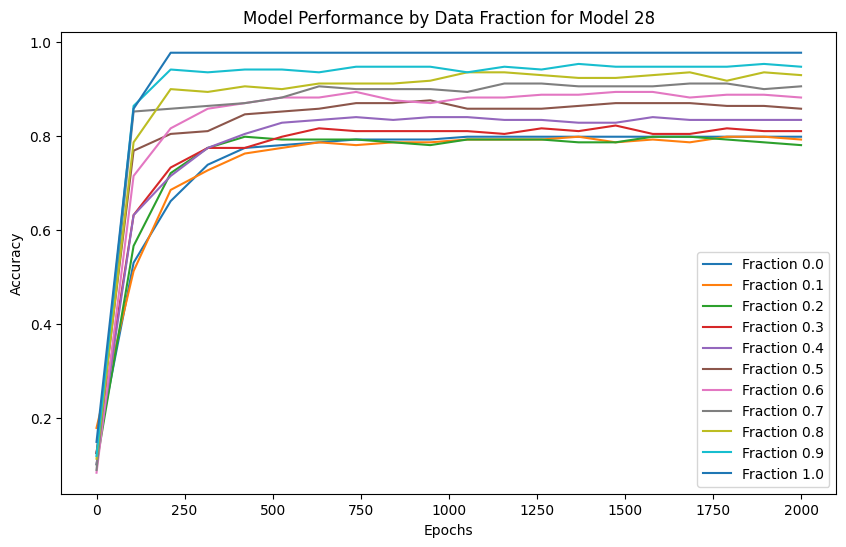

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2078
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.6181
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.1728
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.8302
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.6362
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.5316
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.4689
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.4409
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.4265
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.4177
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.4124
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.4082
predi

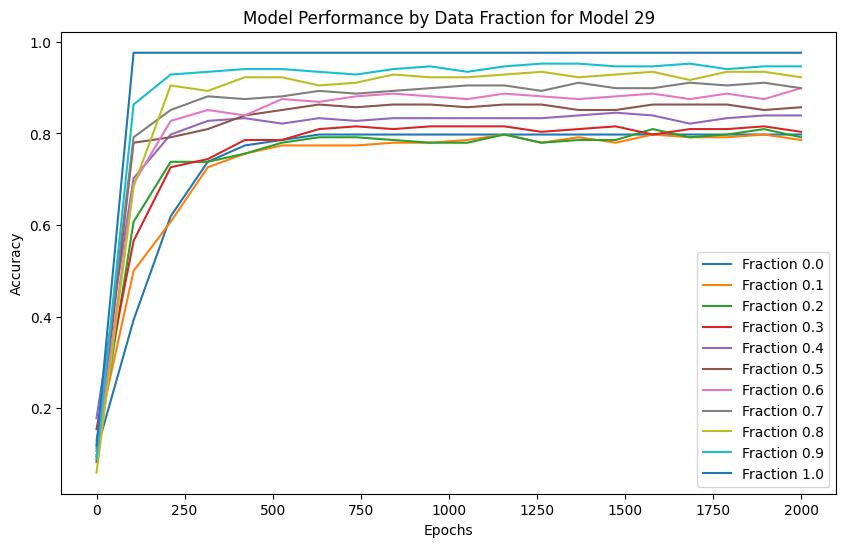

In [8]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_5th_note_contradiction/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [106]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_5th_note_contradiction"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6278
  Fraction 0.10, Average Accuracy: 0.7452
  Fraction 0.20, Average Accuracy: 0.8812
  Fraction 0.30, Average Accuracy: 0.9728
  Fraction 0.40, Average Accuracy: 0.9762
  Fraction 0.50, Average Accuracy: 0.9762
  Fraction 0.60, Average Accuracy: 0.9762
  Fraction 0.70, Average Accuracy: 0.9762
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7976
  Fraction 0.10, Average Accuracy: 0.7956
  Fraction 0.20, Average Accuracy: 0.7665
  Fraction 0.30, Average Accuracy: 0.7448
  Fraction 0.40, Average Accuracy: 0.7440
  Fraction 0.50, Average Accuracy: 0.7440
  Fraction 0.60, Average Accuracy: 0.7438
  Fraction 0.70, Average Accuracy: 0.7440
  Fraction 0.80, Average Accuracy: 0.7438
  Fraction 0.90, Average Accuracy: 0.7431
  Fraction 1.00, Average Accuracy: 0.5946


#### plot for transformers

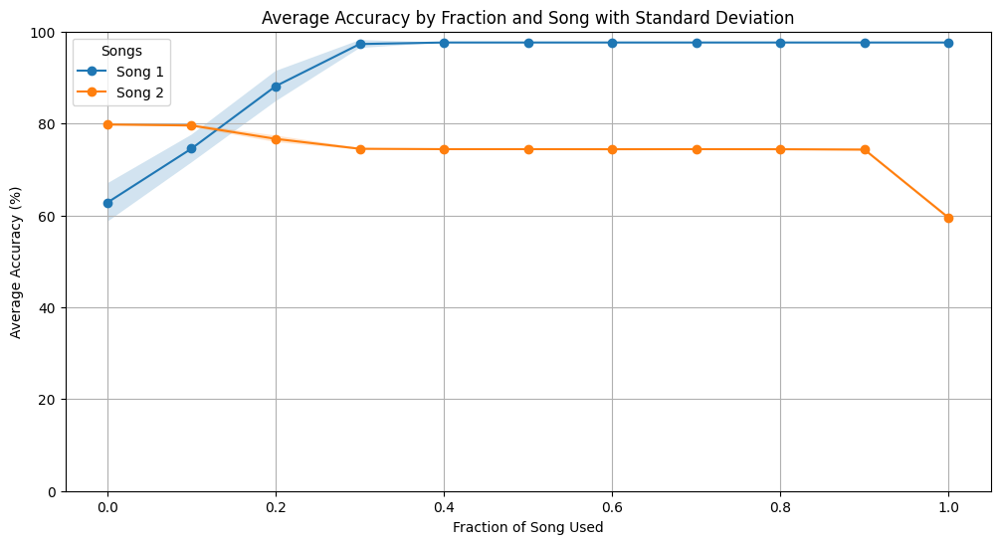

In [107]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

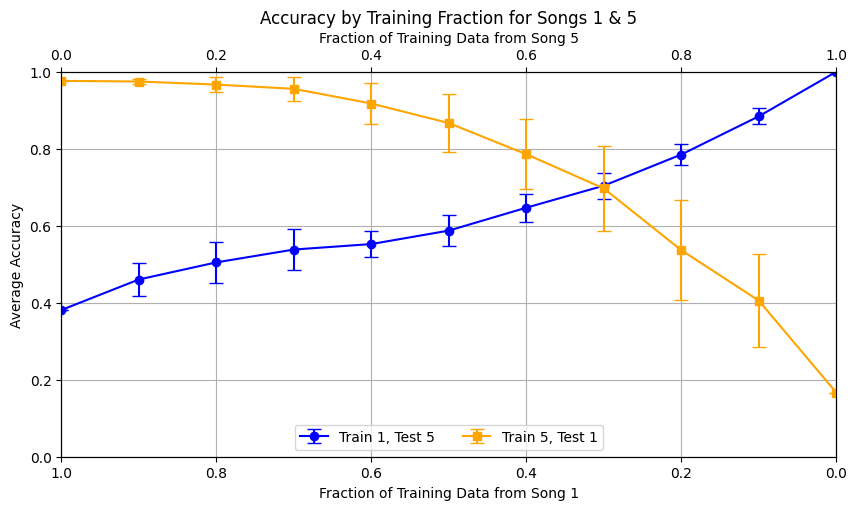

In [108]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 5), (5, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

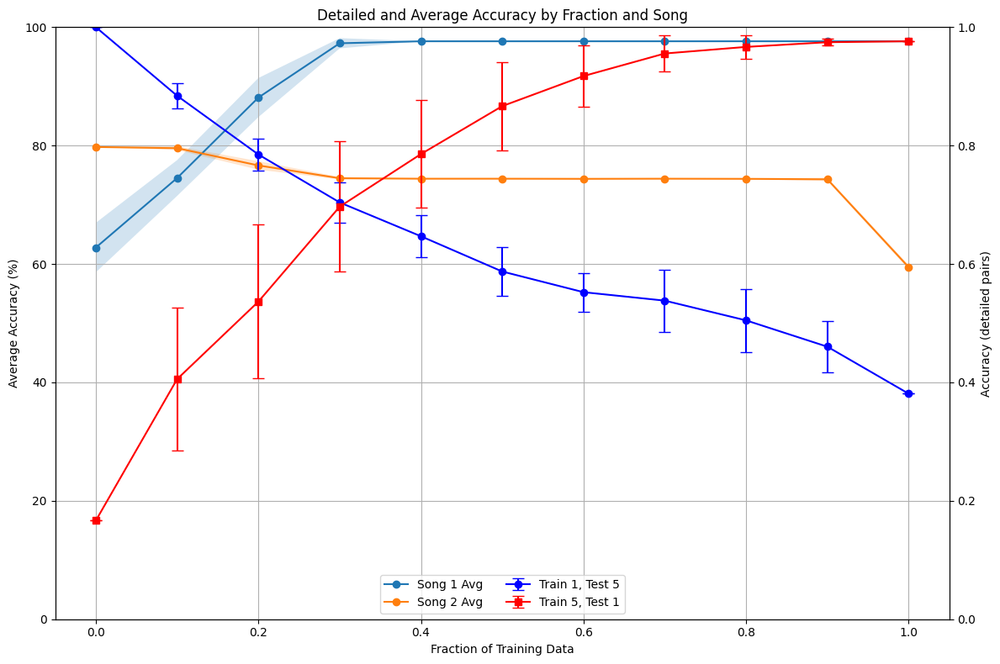

In [113]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 5), (5, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


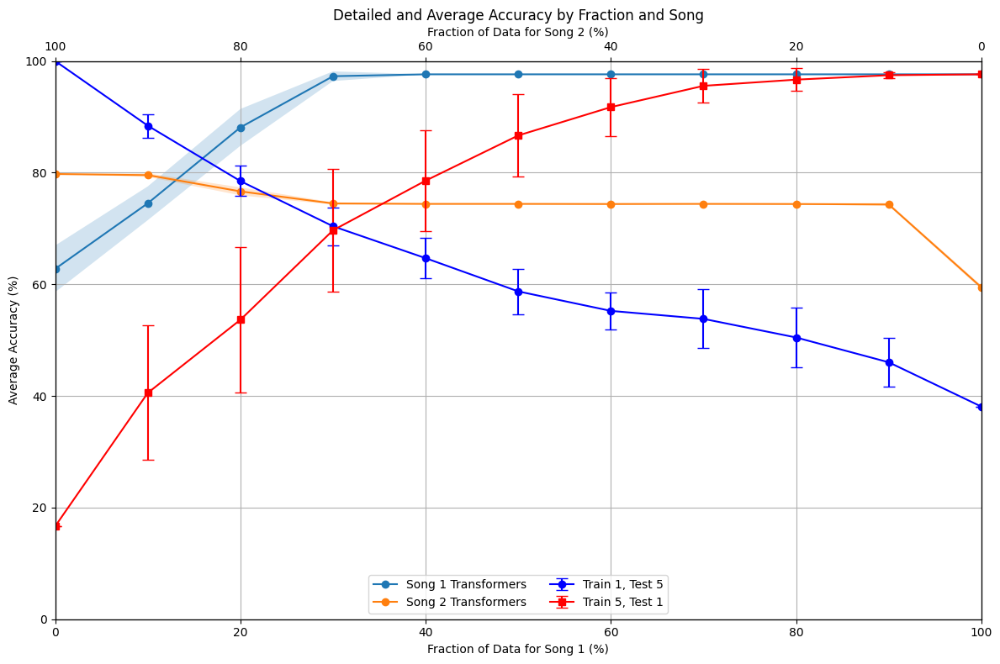

In [114]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Data for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 5), (5, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Data for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


### Normal and IGH - 0.98(overlap - contradiction)

#### Training

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.00, Epoch 1, Loss: 2.1875
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.3188
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.6090
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.2925
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.1767
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.1283
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1045
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0830
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0712
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0692
prediction sha

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.10, Epoch 1, Loss: 2.2187
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 101, Loss: 1.3941
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 201, Loss: 0.7565
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 301, Loss: 0.4397
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 401, Loss: 0.2466
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 501, Loss: 0.1906
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 601, Loss: 0.1529
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 701, Loss: 0.1697
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 801, Loss: 0.1324
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 901, Loss: 0.1250
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1001, Loss: 0.1526
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1101, Loss: 0.1101
prediction shape 

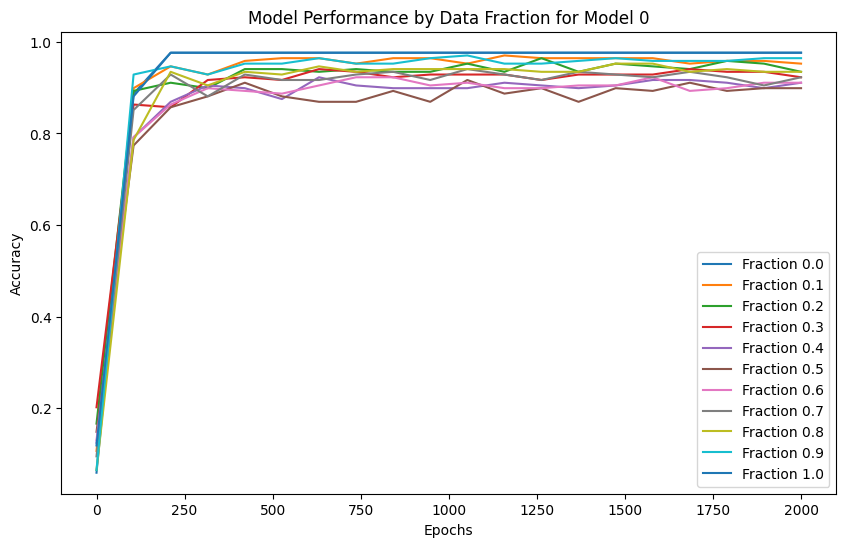

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1942
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.3057
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.6458
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.3200
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.1923
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.1382
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1112
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0960
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0867
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0761
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0730
prediction shape 

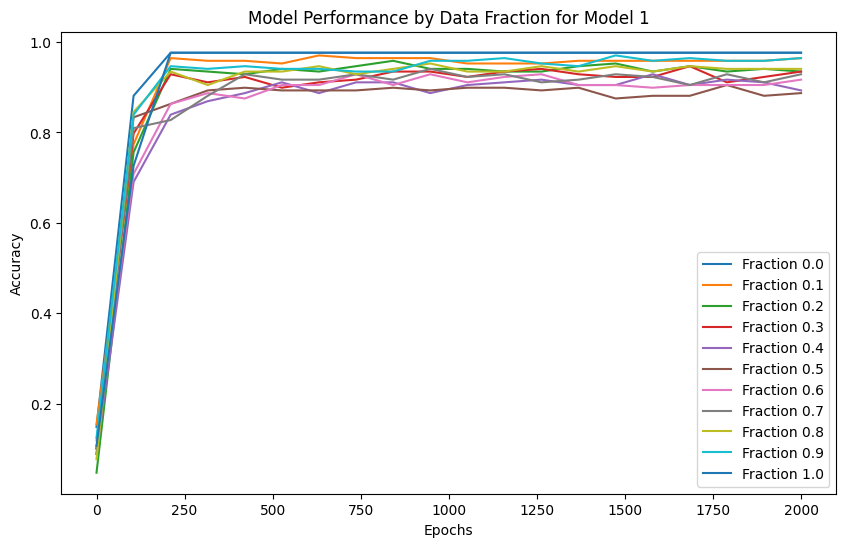

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2136
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.2582
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.5632
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.2747
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.1277
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1053
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0924
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0749
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0721
prediction shape 

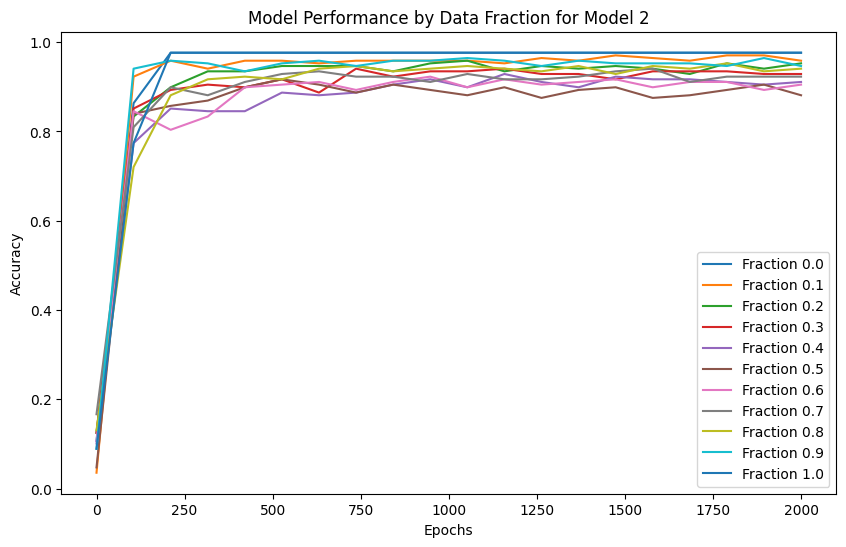

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2106
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.2436
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.5957
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.3040
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.1865
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.1349
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1089
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0852
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

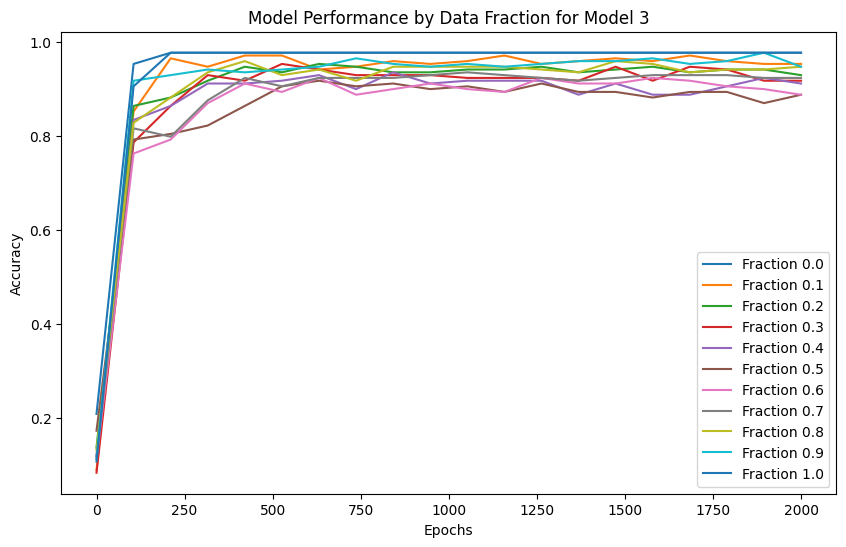

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1975
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.3146
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6224
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.3043
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.1863
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.1353
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1095
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0949
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0858
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0756
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0726
prediction shape 

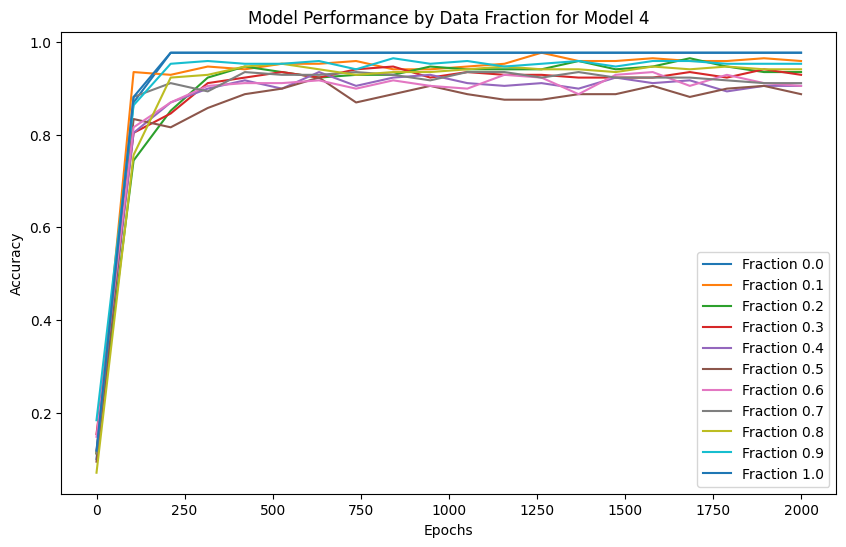

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2095
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.3088
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.5844
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.2832
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.1761
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.1300
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1066
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0931
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0723
prediction shape 

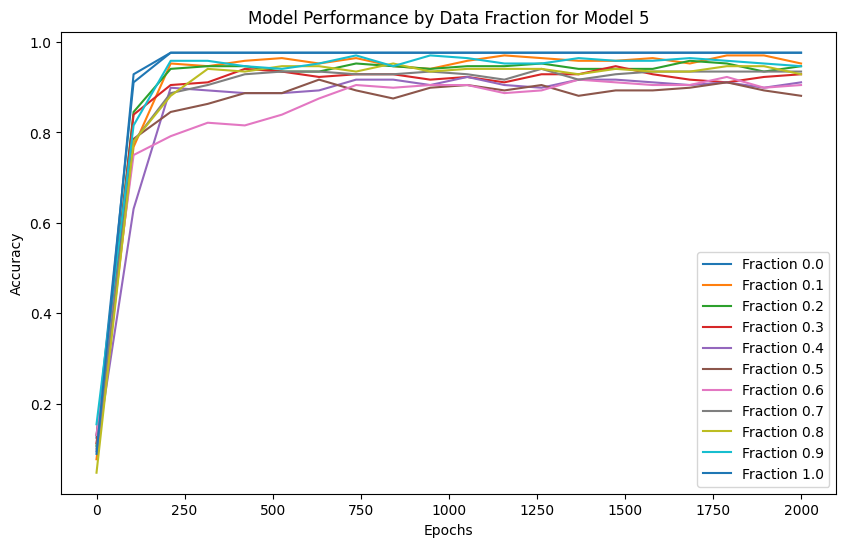

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2289
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.4221
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.6598
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.2981
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.1762
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.1275
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1040
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0909
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0828
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0712
prediction shape 

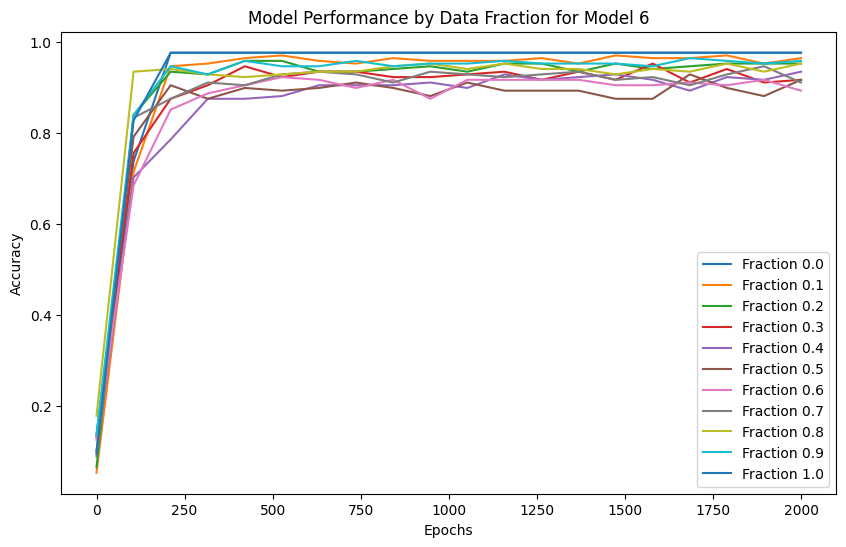

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2199
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.3784
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6380
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.2990
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.1780
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1291
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1052
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0835
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0781
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0743
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0716
prediction shape 

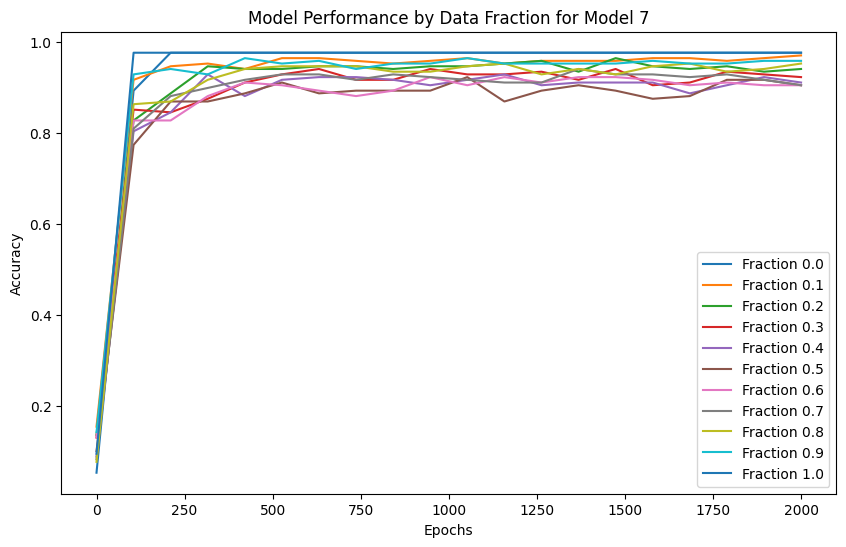

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2136
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.3647
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.6373
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.3100
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.1895
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.1378
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1116
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0966
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0873
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0810
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0767
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0735
prediction shape 

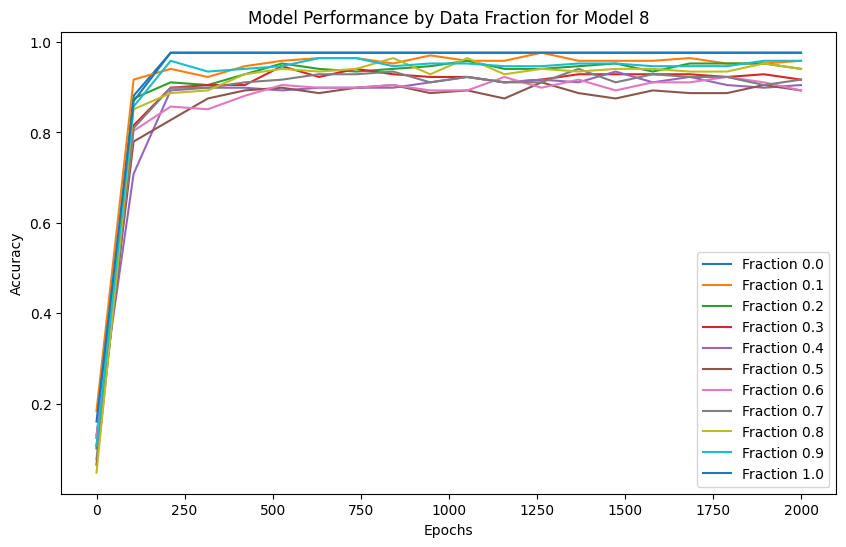

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2076
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.3072
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.5955
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.2934
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.1782
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.1292
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1051
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0916
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0714
prediction shape 

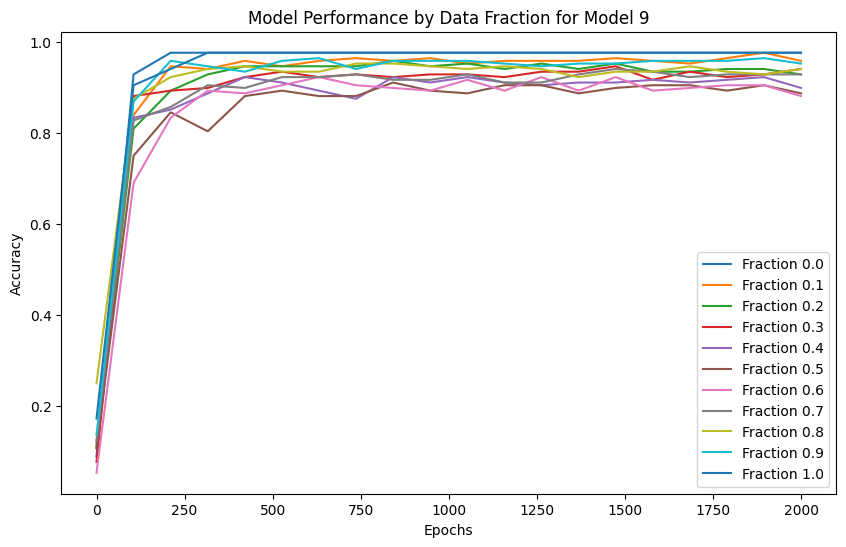

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2085
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.2912
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.5637
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.2775
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.1300
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1068
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0933
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0792
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0723
predi

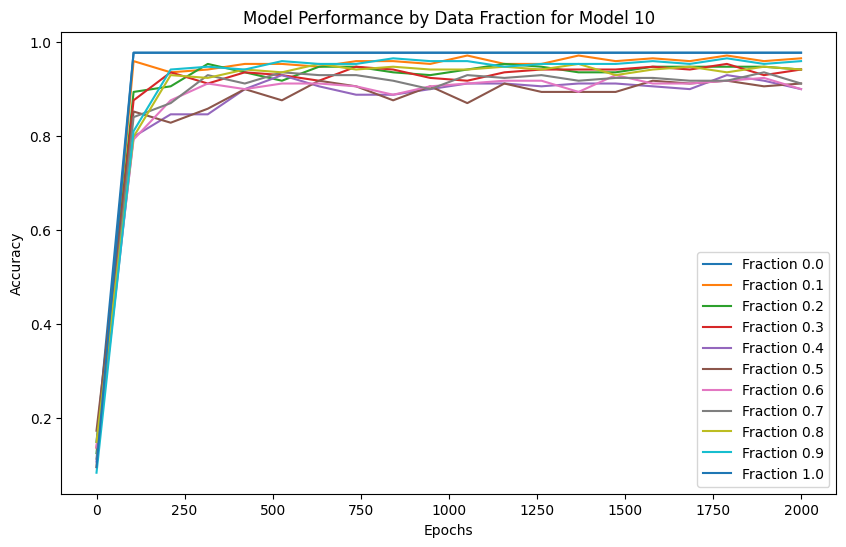

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2039
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.3113
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.5637
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.2686
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.1653
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.1220
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1006
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0886
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0812
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0763
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0704
predi

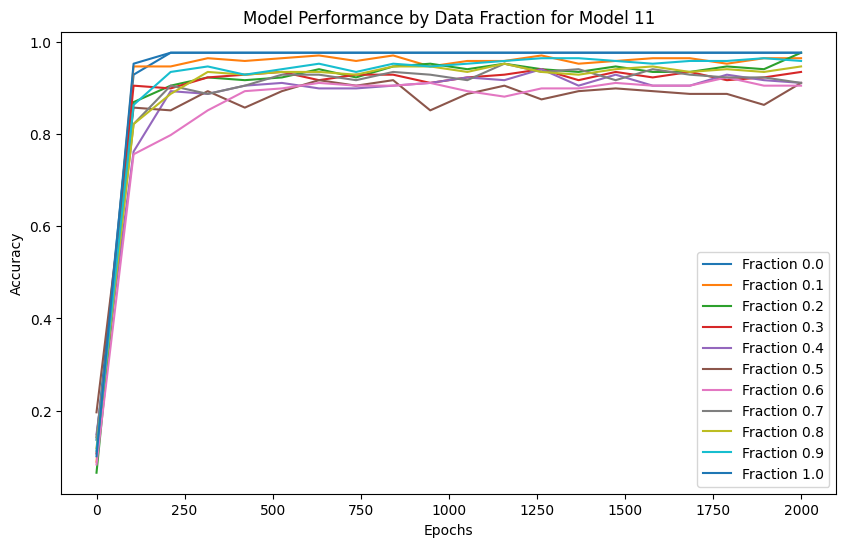

Model 12, Fraction 0.00, Epoch 1, Loss: 2.1904
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.2867
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.5990
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.2874
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.1752
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.1283
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0836
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0782
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

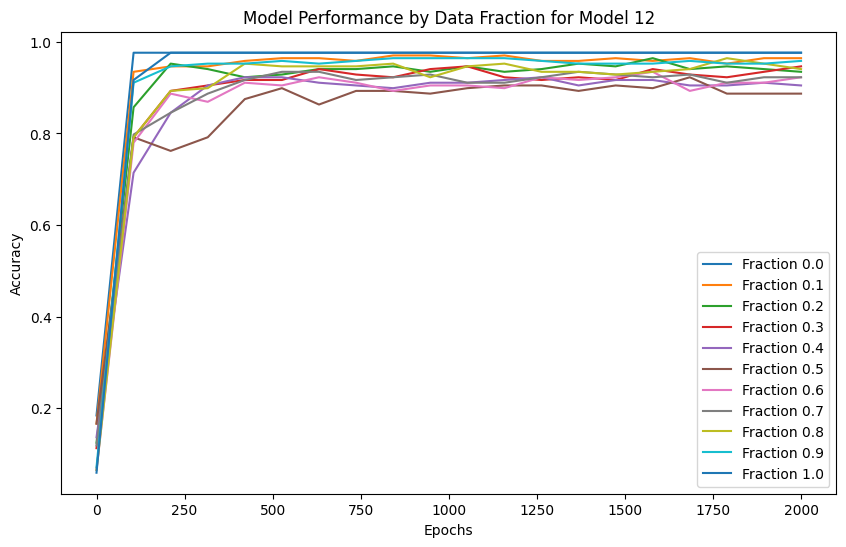

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2066
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.2959
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.5549
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.2766
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.1747
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.1298
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1066
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0931
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0722
predi

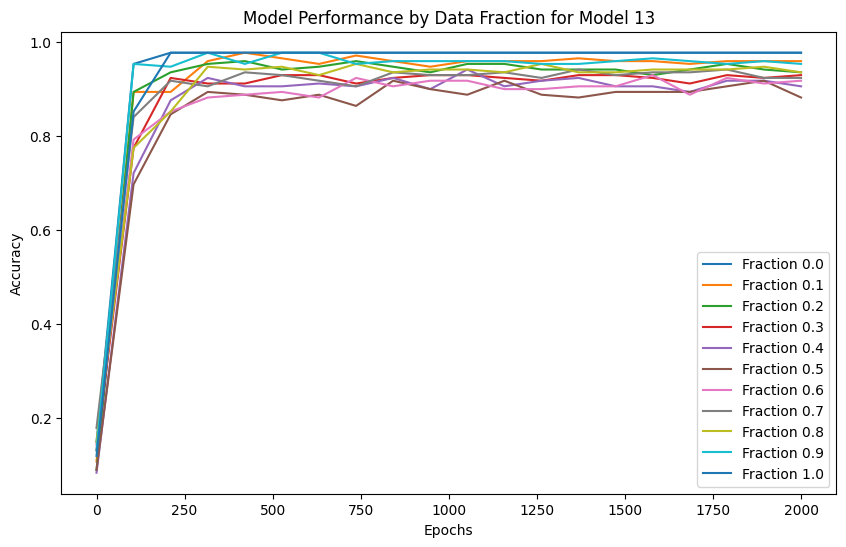

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2099
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.2707
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.5939
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.2868
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.1733
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.1267
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1037
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0827
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

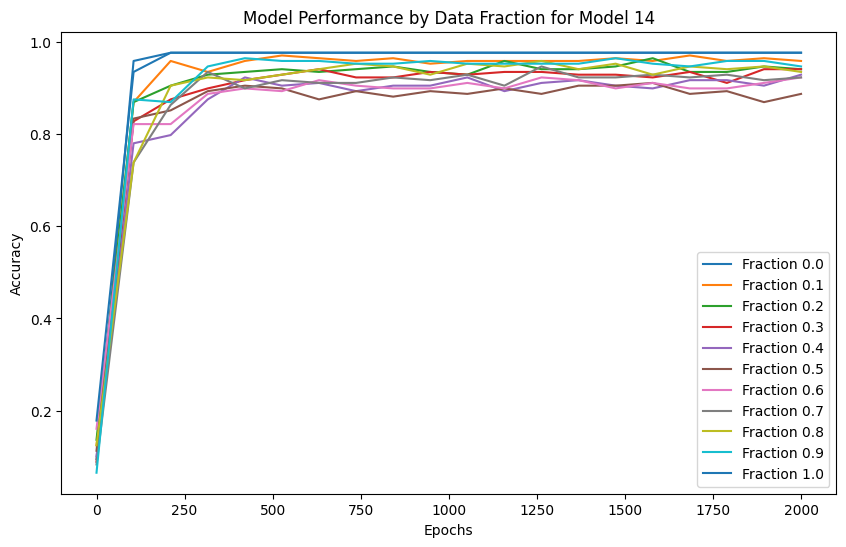

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2167
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.3066
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6198
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.2888
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.1731
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.1265
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1037
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0828
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

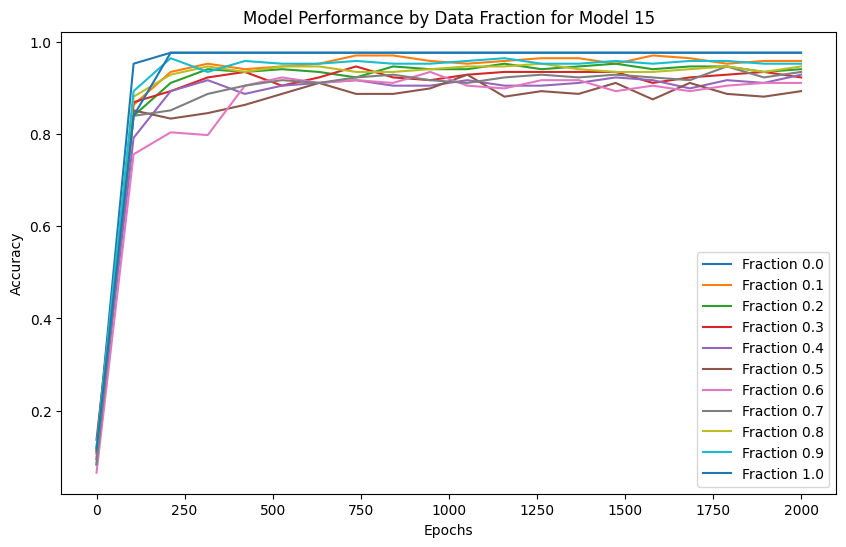

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2300
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.3061
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.5614
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.2700
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.1669
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.1239
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1024
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0902
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0826
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0774
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

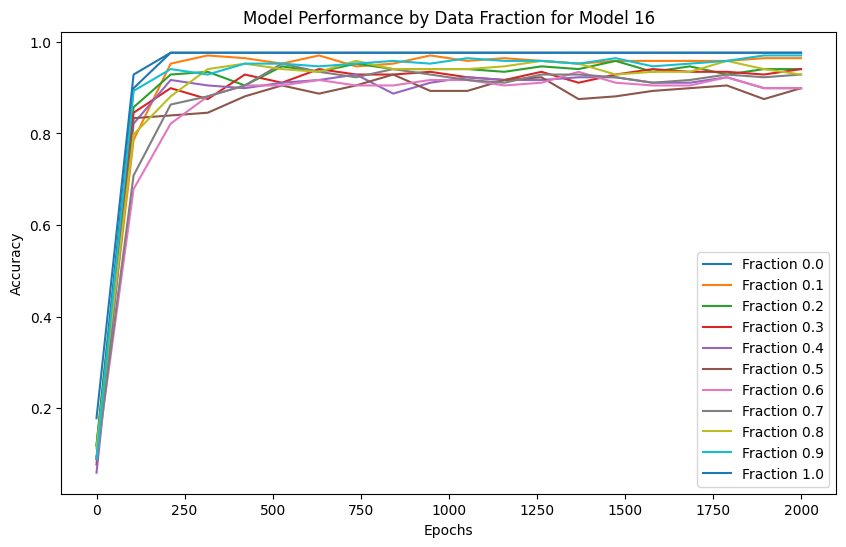

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2153
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.2981
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.6316
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.2992
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.1815
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.1326
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1082
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0856
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0757
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0727
predi

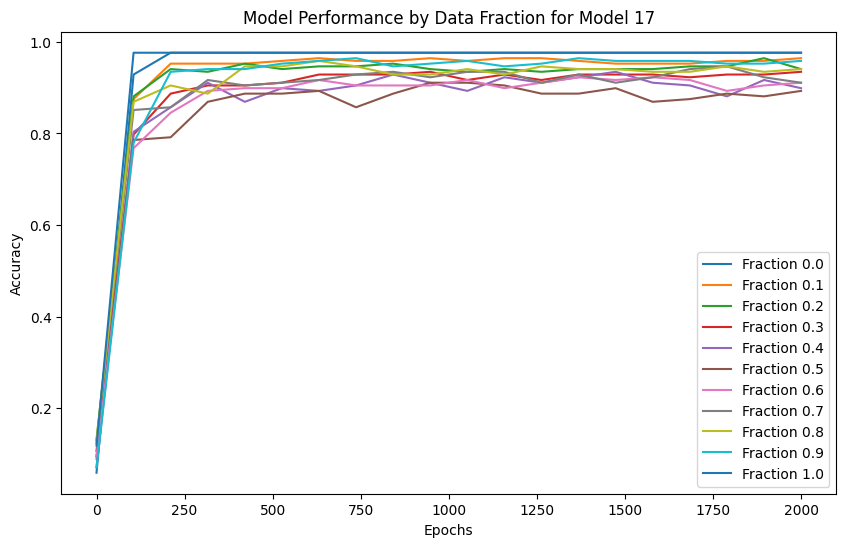

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1961
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.2788
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.6283
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.3029
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.1807
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.1303
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1057
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0919
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0835
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

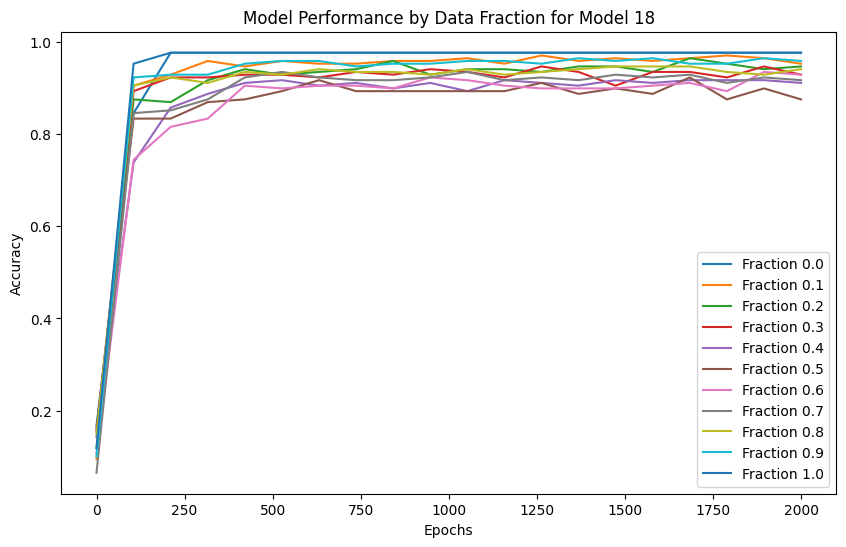

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2077
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.3040
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6162
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3143
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.1942
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.1403
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1127
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0970
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0872
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0808
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0764
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0731
predi

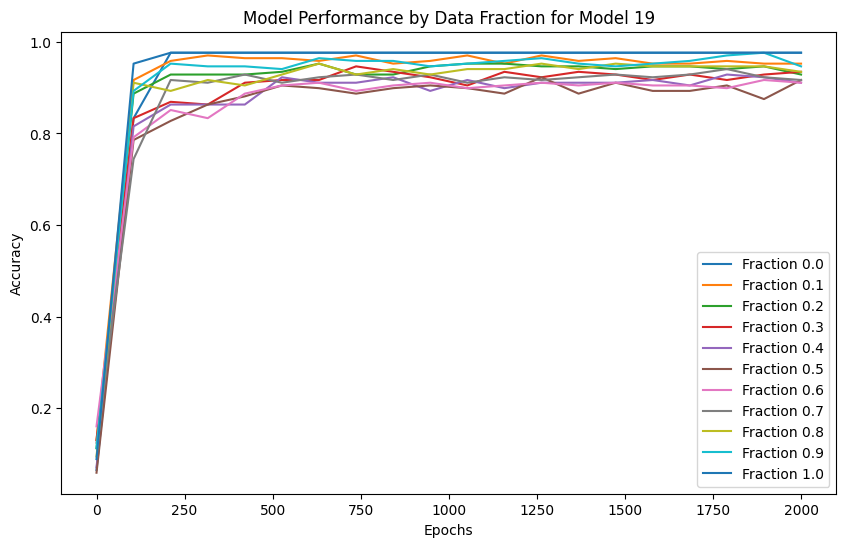

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1884
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.2524
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.5792
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.2792
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.1718
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.1267
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1042
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0913
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0780
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0743
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

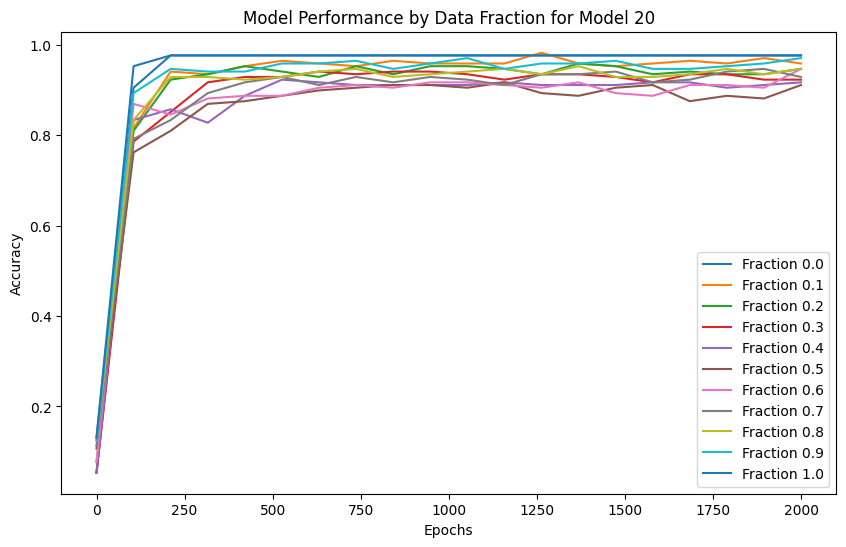

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2024
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.2891
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.5897
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.2889
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.1754
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.1277
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1043
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0832
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0715
predi

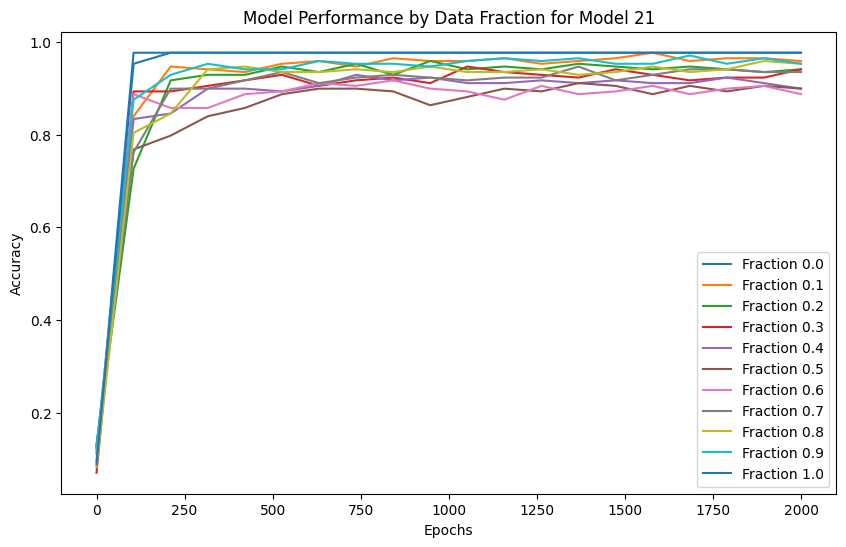

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2158
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.3653
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.7086
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.3722
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.2038
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.1363
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1072
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0921
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0777
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

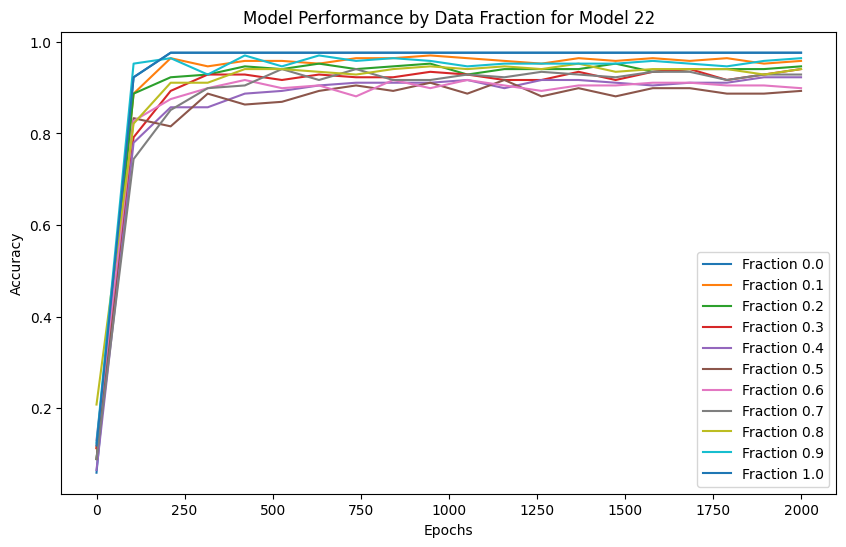

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2046
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.2809
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.6133
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.2881
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.1724
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.1260
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1033
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0906
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0827
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

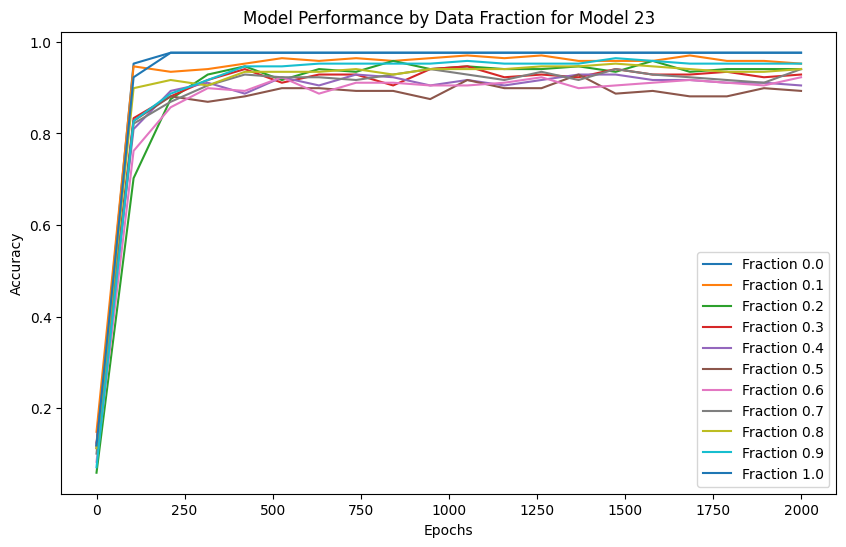

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2037
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.2894
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.5913
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.2755
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.1694
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.1254
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1033
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0907
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0828
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

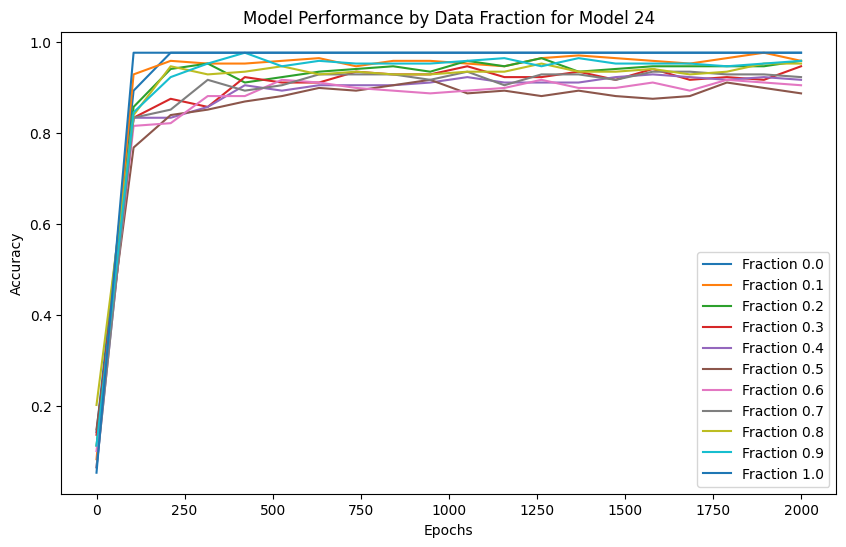

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2074
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.3232
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.5720
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.2785
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.1709
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.1260
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1034
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0906
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0827
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0774
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

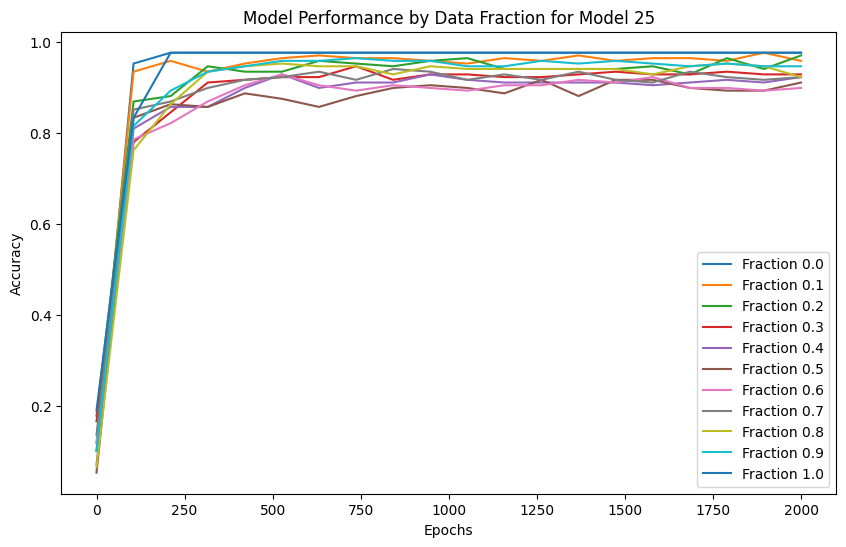

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1939
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.2919
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.5757
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.2765
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.1728
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.1285
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.1059
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0846
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0724
predi

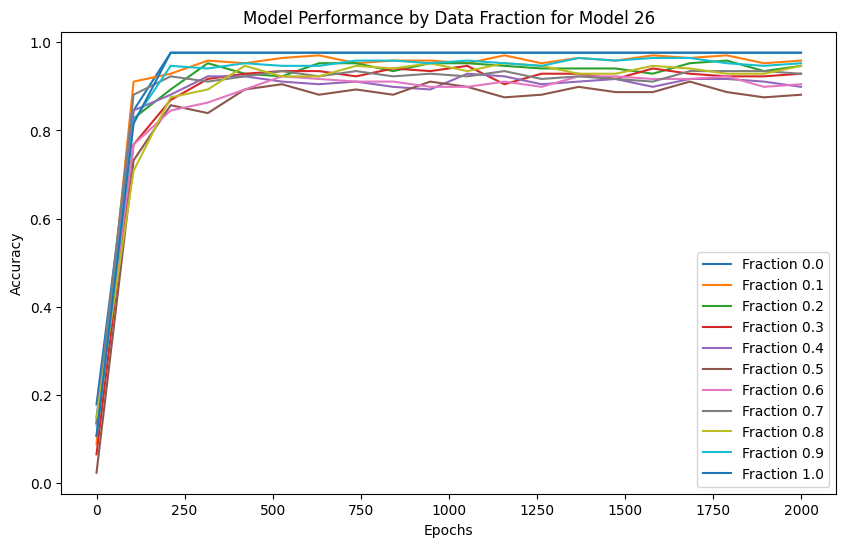

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2092
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.3037
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.6363
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3122
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.1885
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.1345
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1076
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0838
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0780
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

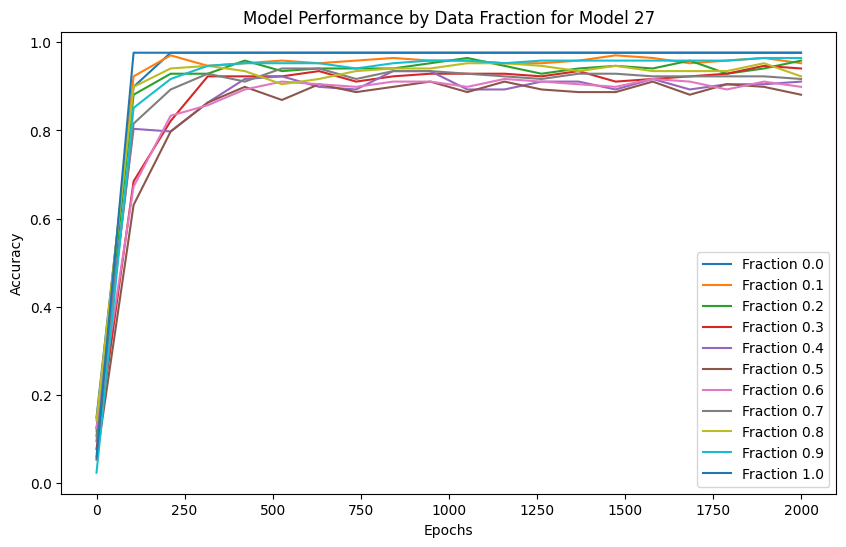

Model 28, Fraction 0.00, Epoch 1, Loss: 2.1804
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.1646
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.5157
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.2668
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.1714
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.1284
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1059
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0721
predi

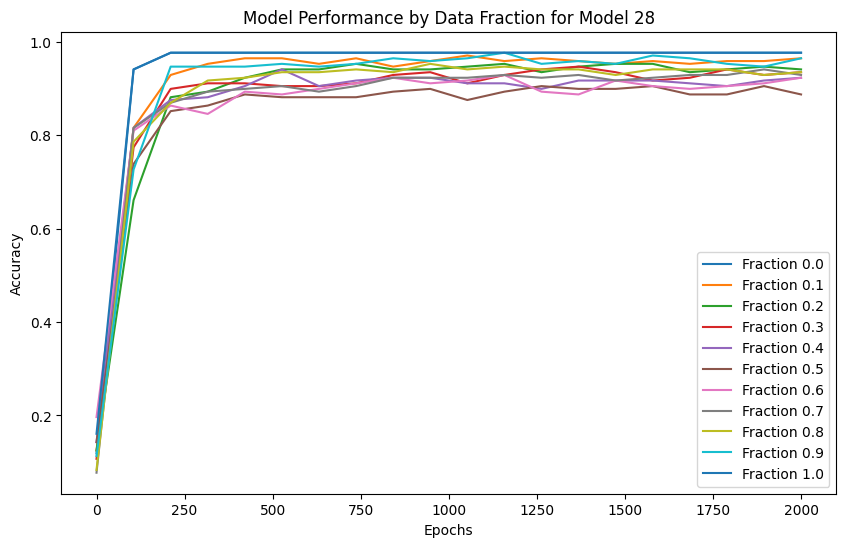

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2066
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.3575
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.6545
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3075
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.1819
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.1309
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1062
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0924
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0839
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0717
predi

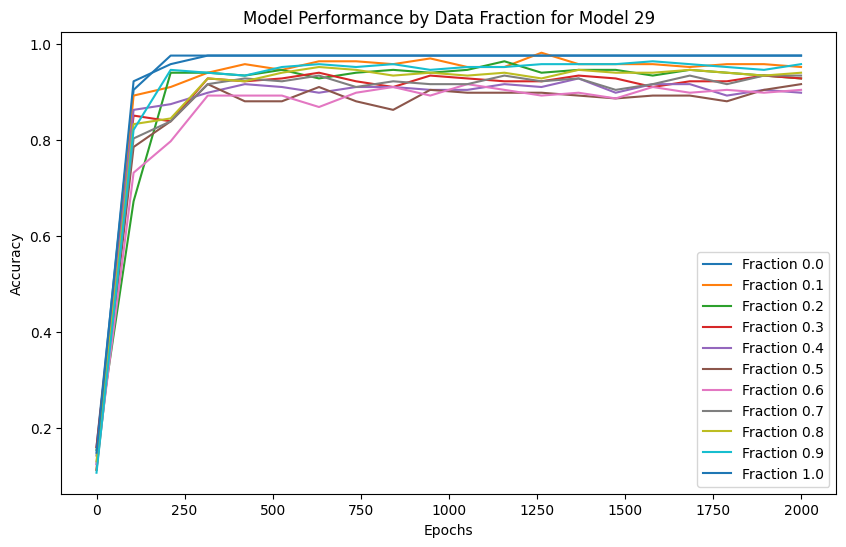

In [7]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF", # within song 8 con, 166 over
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"  # within song 8 con, 166 over
])  #igh contradiction contradiction 24  and overlap 54  

for model_idx in range(num_models):
    model_dir = f"Songs_GHI_contradiction/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [101]:
import os
import numpy as np
import torch

# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_GHI_contradiction"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6905
  Fraction 0.10, Average Accuracy: 0.8095
  Fraction 0.20, Average Accuracy: 0.8095
  Fraction 0.30, Average Accuracy: 0.8095
  Fraction 0.40, Average Accuracy: 0.8127
  Fraction 0.50, Average Accuracy: 0.8929
  Fraction 0.60, Average Accuracy: 0.9659
  Fraction 0.70, Average Accuracy: 0.9754
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9762
  Fraction 0.30, Average Accuracy: 0.9762
  Fraction 0.40, Average Accuracy: 0.9730
  Fraction 0.50, Average Accuracy: 0.8929
  Fraction 0.60, Average Accuracy: 0.8198
  Fraction 0.70, Average Accuracy: 0.8103
  Fraction 0.80, Average Accuracy: 0.8095
  Fraction 0.90, Average Accuracy: 0.8095
  Fraction 1.00, Average Accuracy: 0.6897


#### plot for transformer

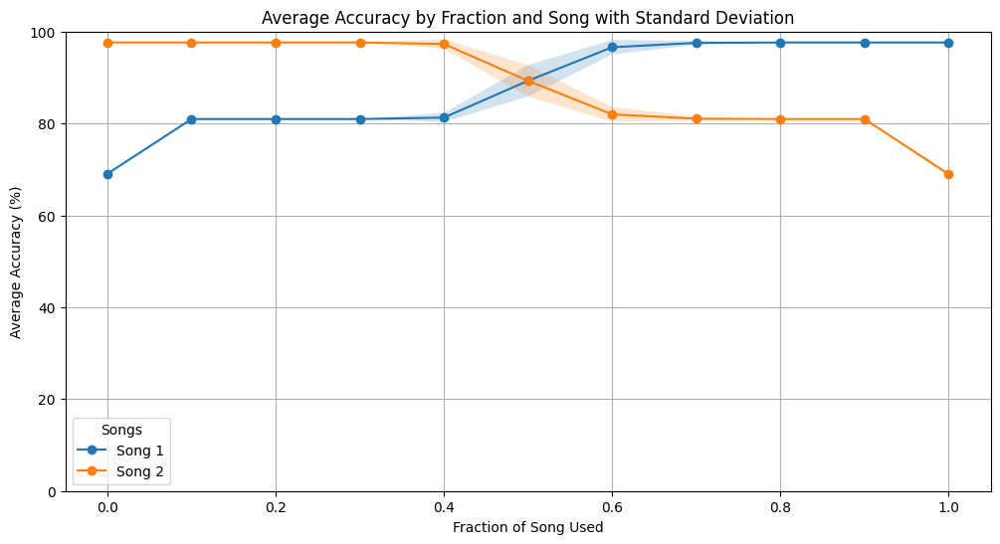

In [102]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

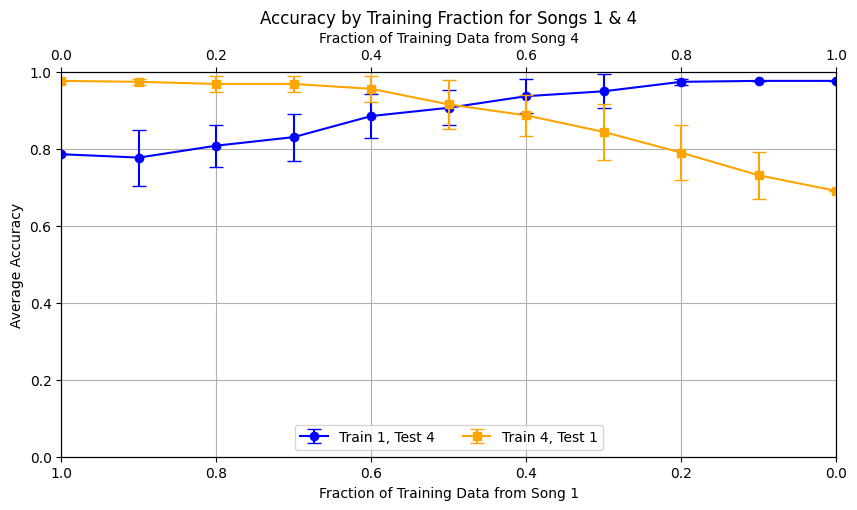

In [100]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 4), (4, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

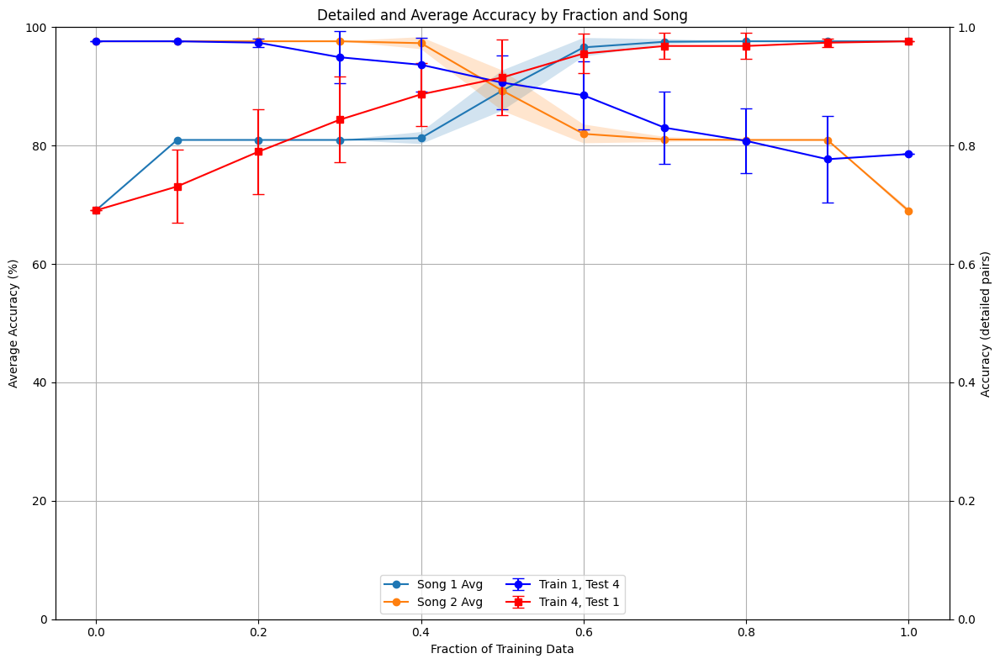

In [104]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 4), (4, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


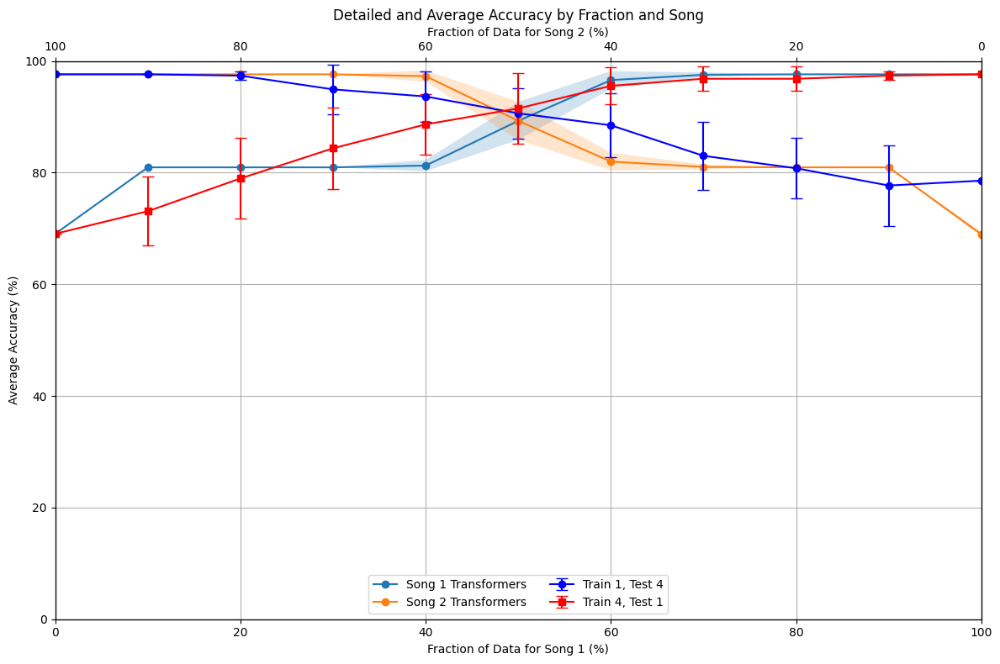

In [105]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Data for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 4), (4, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Data for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


## Training and Testing for Songs GHI contradiction with lower parameter

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2073
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.9102
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.4180
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.0749
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.8197
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.6055
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4214
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.2938
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.2116
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1642
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1364
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1186
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1065
prediction sha

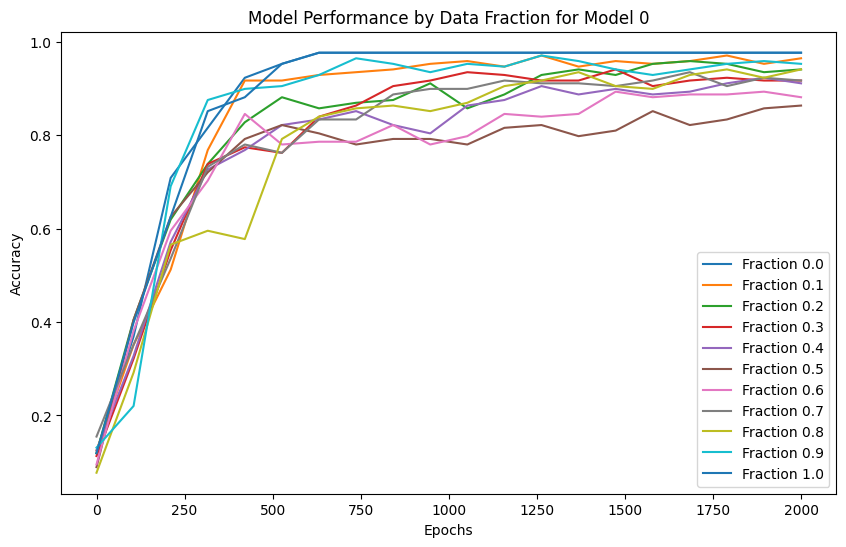

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1938
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.8502
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5281
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.1979
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.9279
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.6231
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4248
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.3124
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.2408
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1929
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1597
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1363
prediction shape 

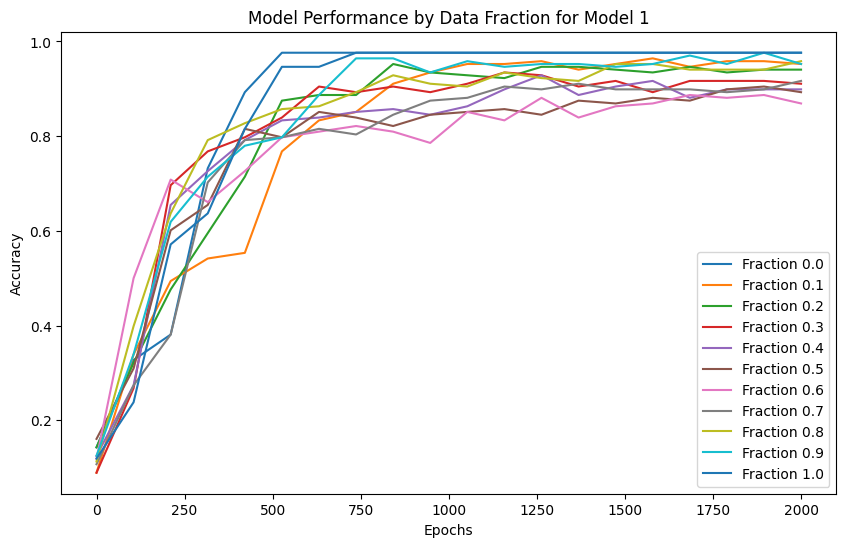

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.8843
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.4602
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.1362
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.8666
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.6545
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4495
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.2933
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.2159
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.1712
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.1439
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1251
prediction shape 

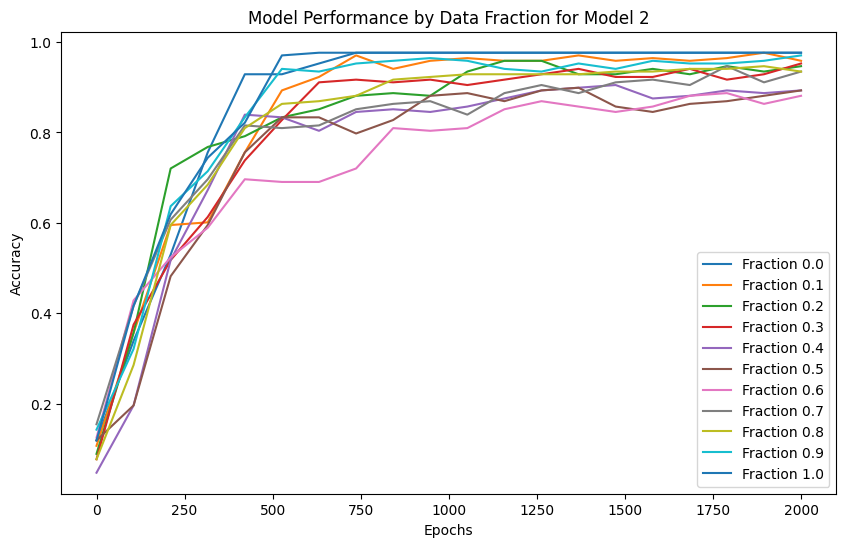

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.8959
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.4684
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.1700
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.9417
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.7782
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.6212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4029
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.2468
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1829
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1486
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1275
prediction shape 

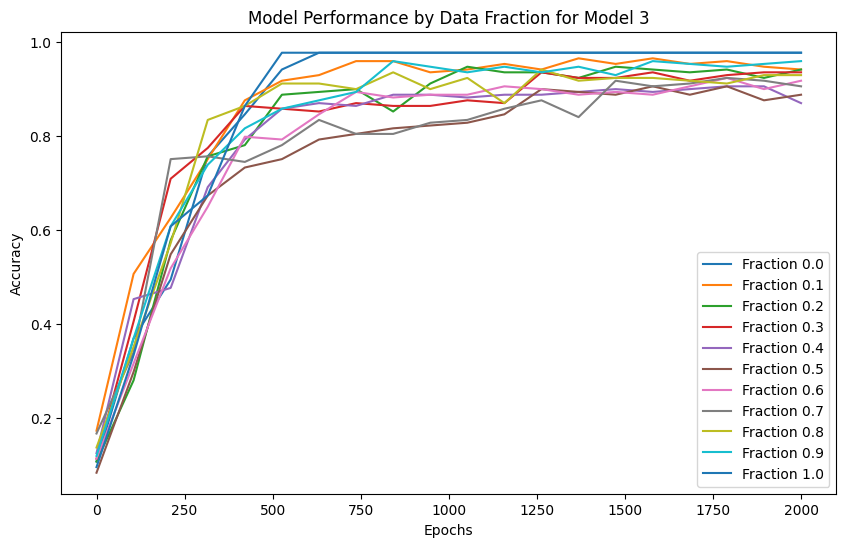

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1988
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.8893
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.3736
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.0954
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.8227
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5668
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.3935
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.2724
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.2081
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1693
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1437
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1257
prediction shape 

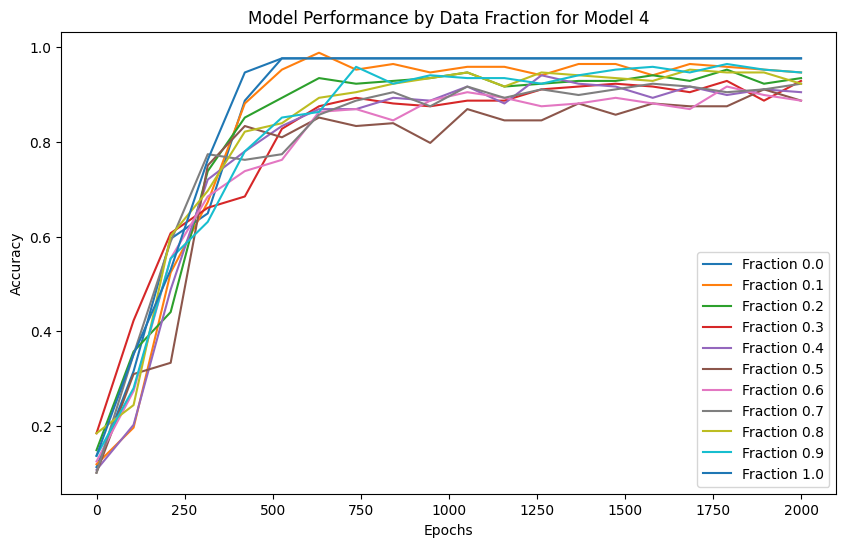

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1987
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.8926
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.4128
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.1612
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.9770
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.7781
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.5697
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4153
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.3242
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.2676
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.2281
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1980
prediction shape 

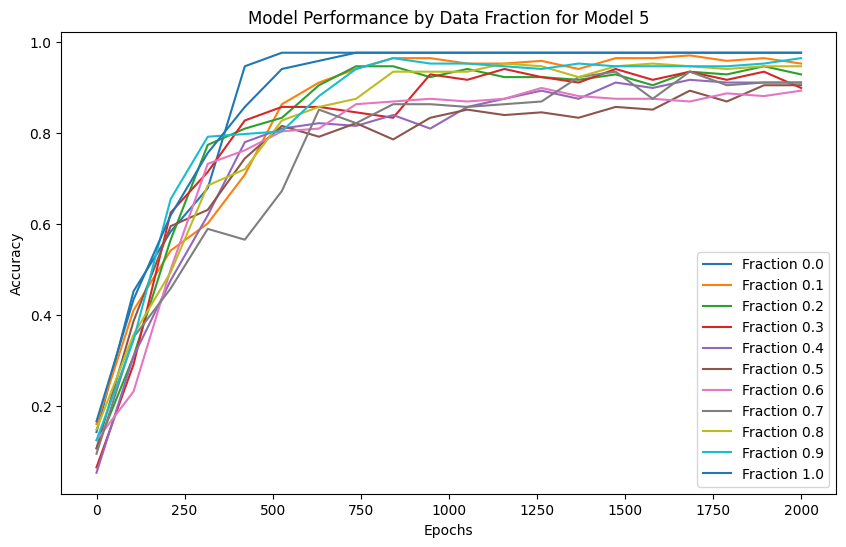

Model 6, Fraction 0.00, Epoch 1, Loss: 2.1995
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.8526
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.3422
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.9835
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.7248
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.5812
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4755
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.3647
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.2737
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.2131
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1724
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1462
prediction shape 

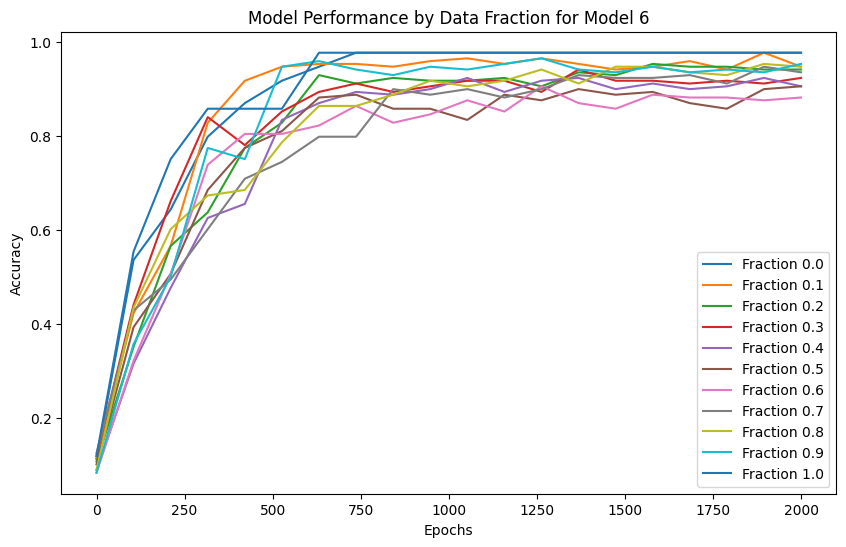

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2048
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.8853
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.3327
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.0241
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.8146
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.6149
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4578
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.3648
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.2961
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.2215
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1615
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1318
prediction shape 

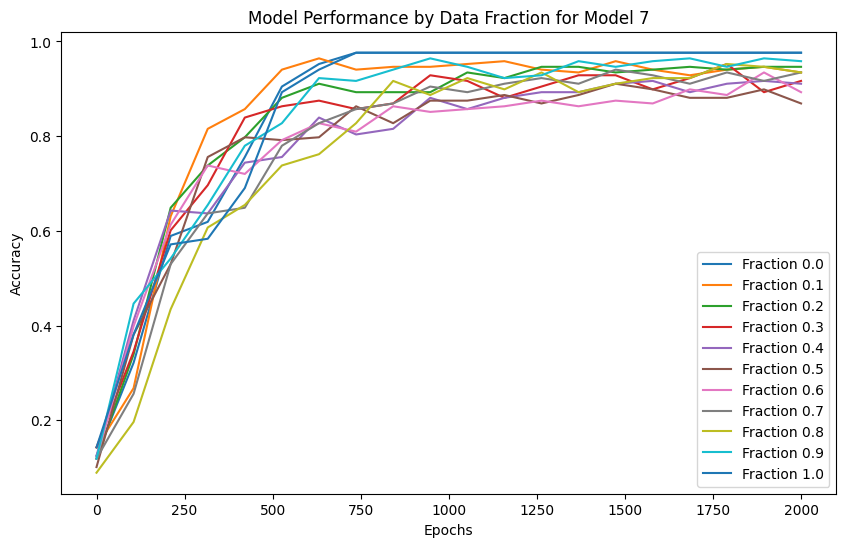

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2151
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9207
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.3742
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.0418
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.7071
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.4887
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.3708
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.2940
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.2234
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1465
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1275
prediction shape 

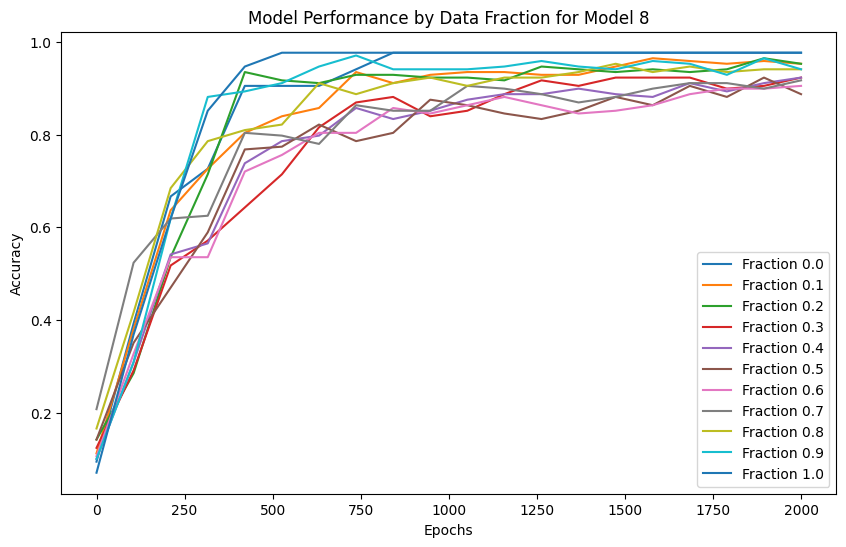

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2014
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.8676
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.4957
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.1451
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.7926
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5397
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.3591
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.2554
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.1953
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1580
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1346
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1186
prediction shape 

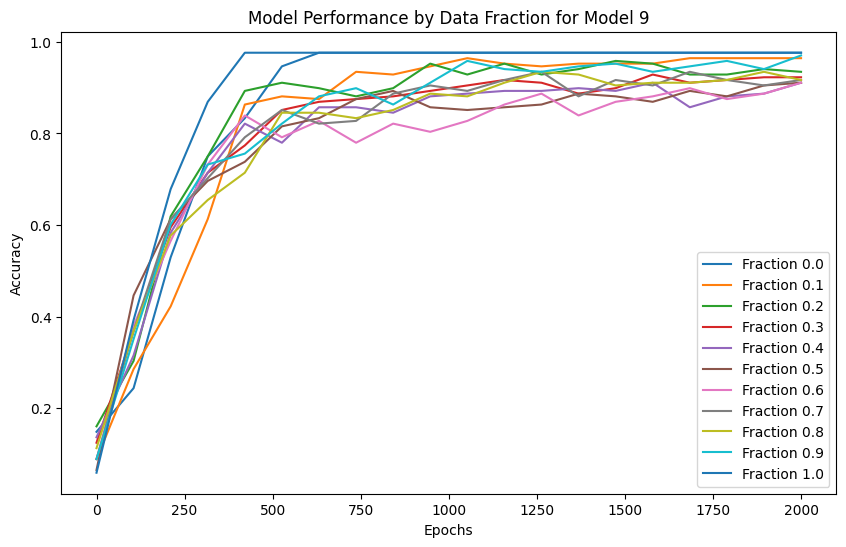

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2057
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.8949
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.4162
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.0269
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.6658
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.4415
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.3198
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.2455
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.1973
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1648
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1420
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1255
predi

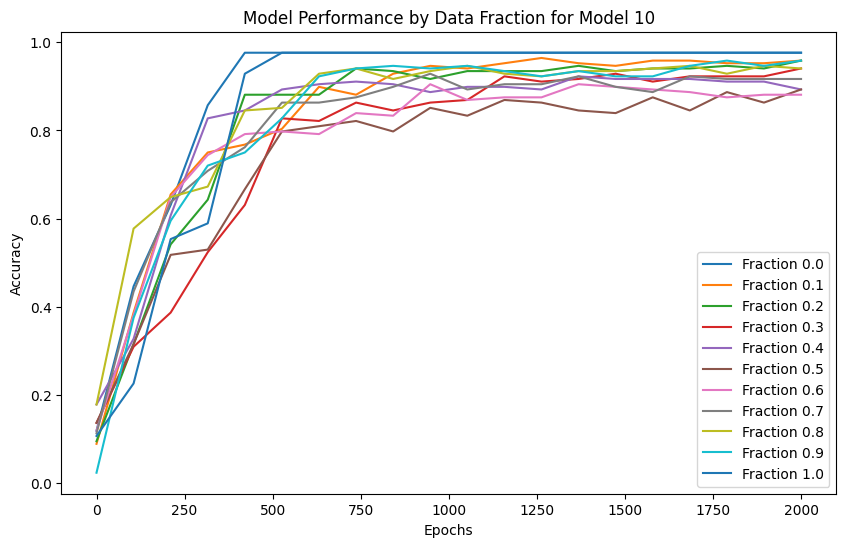

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2052
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9371
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.4212
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.0412
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.7362
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.4943
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.3384
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.2498
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.1957
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1604
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1361
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1189
predi

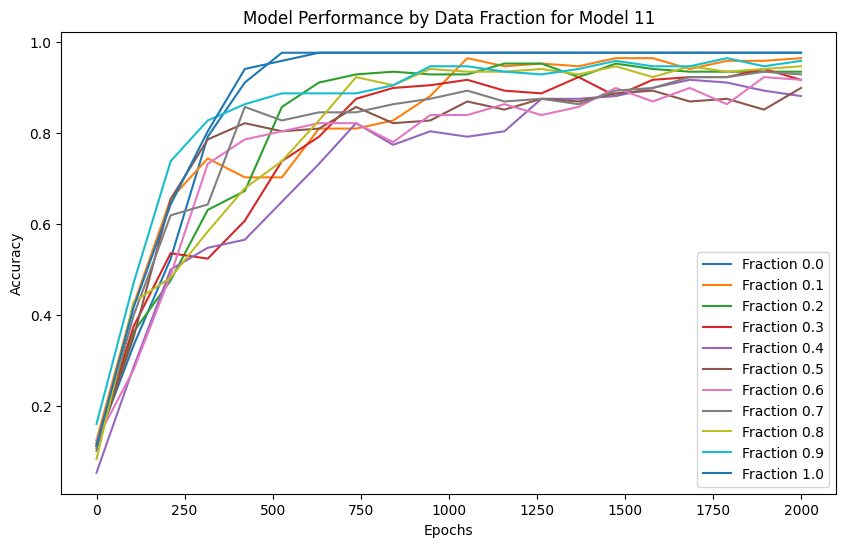

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2017
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.9018
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.3640
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.9855
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.7205
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5645
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.2940
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.2238
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1789
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1487
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1279
predi

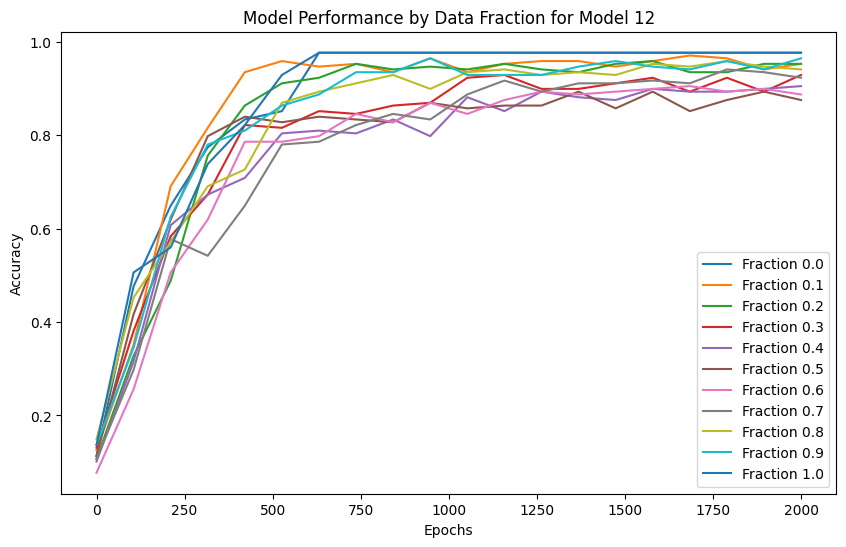

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2056
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.8684
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.3825
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 1.0821
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.9096
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.7769
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.5966
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4015
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.2827
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1587
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1308
predi

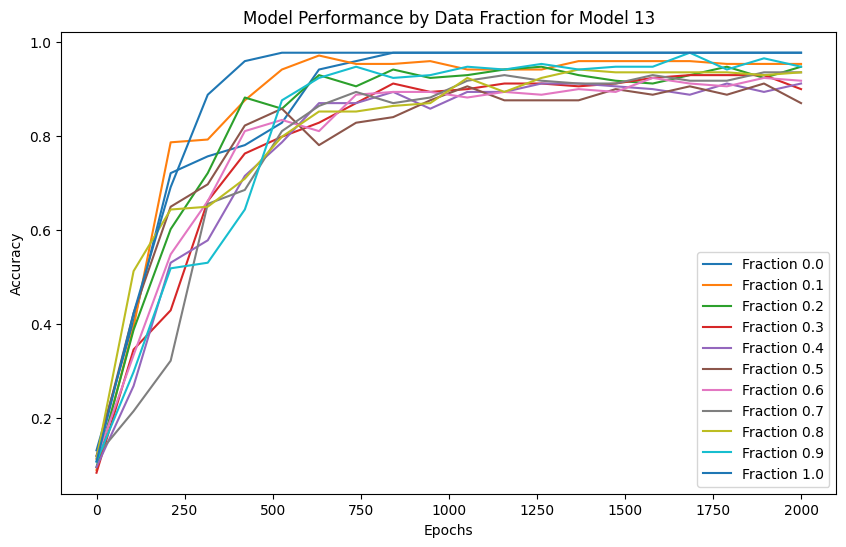

Model 14, Fraction 0.00, Epoch 1, Loss: 2.1948
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.8439
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.3639
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.0684
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.7757
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.5150
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.3613
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.2689
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.2098
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1711
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1453
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1273
predi

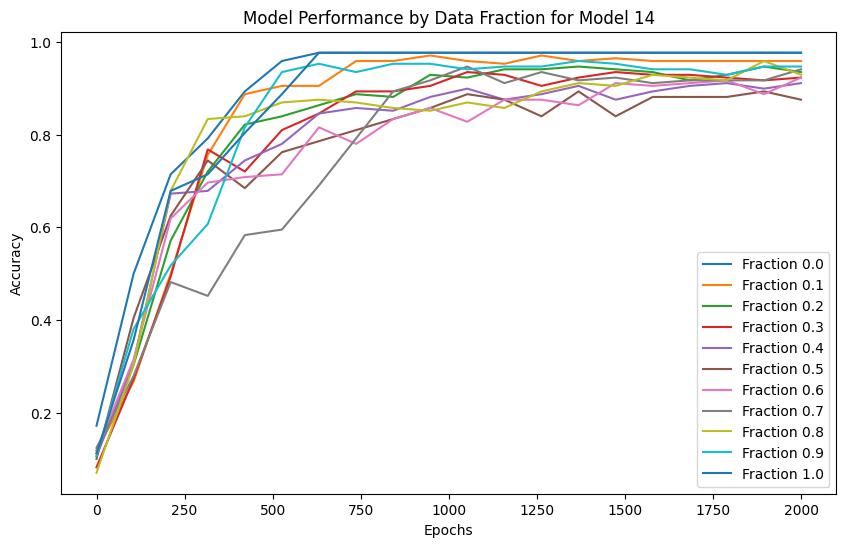

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2037
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.8953
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.3888
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.1128
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.8725
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.6463
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4661
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.3330
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.2446
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.1899
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1564
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1341
predi

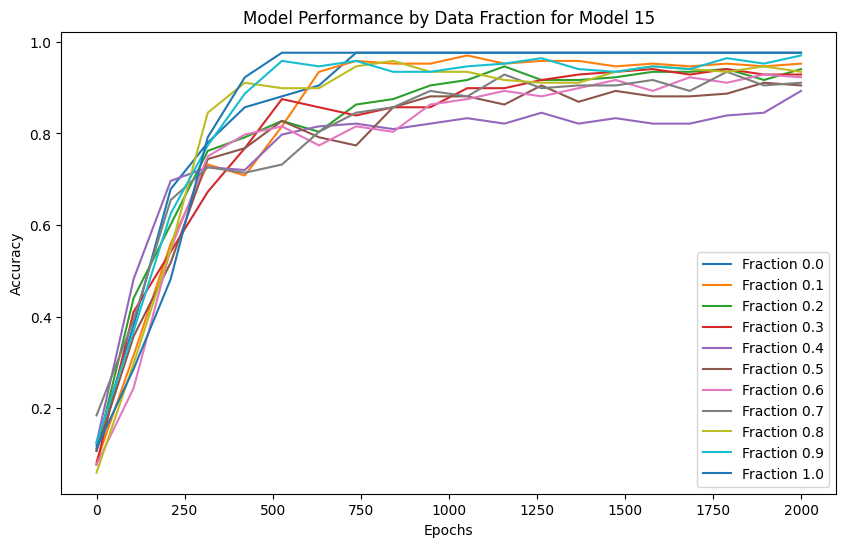

Model 16, Fraction 0.00, Epoch 1, Loss: 2.1974
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.8054
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.3825
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.1095
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.8432
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5905
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.3896
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.2732
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.2071
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1674
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1415
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1237
predi

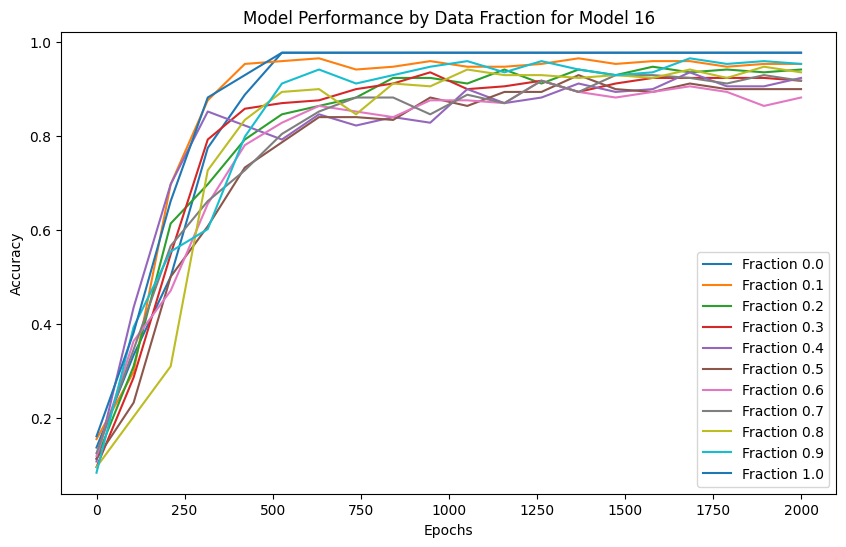

Model 17, Fraction 0.00, Epoch 1, Loss: 2.1941
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.8898
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.3781
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 1.1009
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.8931
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.6887
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4986
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.3323
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.2486
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1952
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1602
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1367
predi

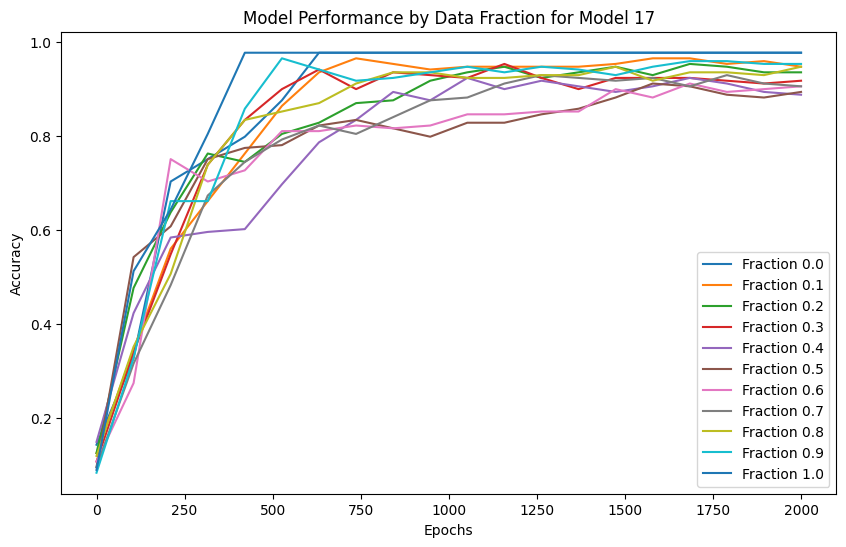

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1991
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.9425
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.5243
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 1.2020
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.8673
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5798
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.3818
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.2770
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.2142
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1730
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1452
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1261
predi

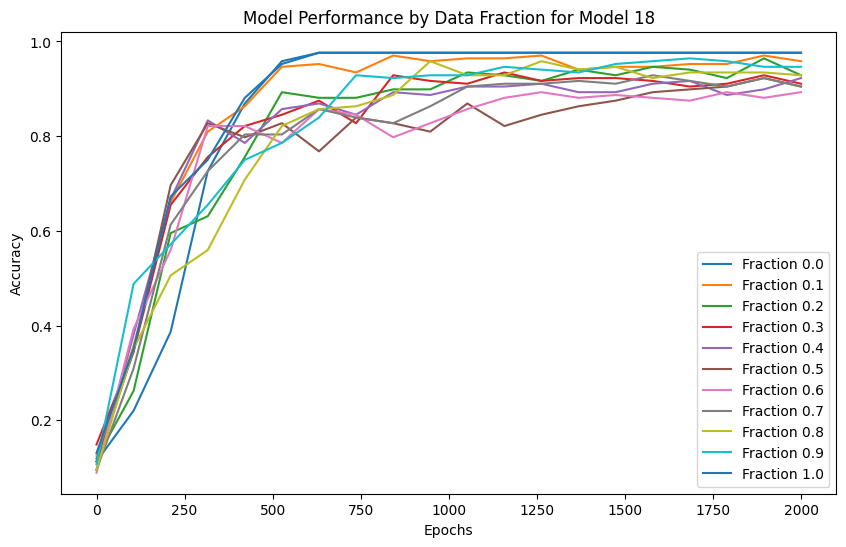

Model 19, Fraction 0.00, Epoch 1, Loss: 2.1993
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9188
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.2906
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.8888
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6563
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.5145
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.3797
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.2727
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.2094
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1694
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1426
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1240
predi

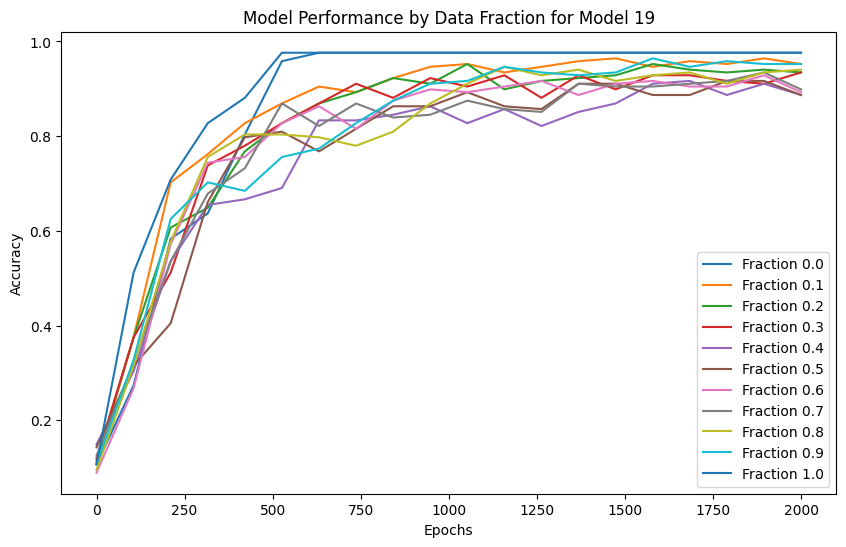

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2137
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9805
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.4692
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.0990
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.7794
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5491
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4208
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.3410
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.2850
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.2410
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.2049
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1751
predi

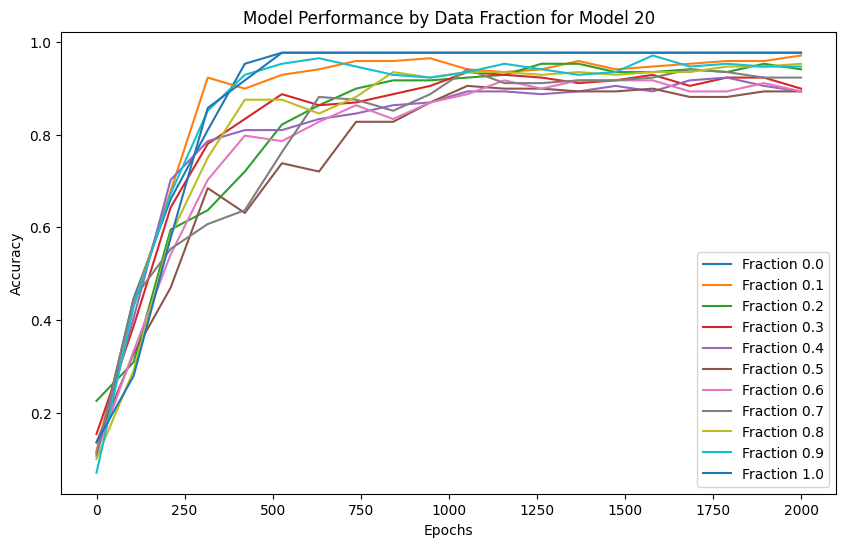

Model 21, Fraction 0.00, Epoch 1, Loss: 2.1956
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.8378
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.3189
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.9806
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6960
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.4926
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.3596
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.2760
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.2203
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1817
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1540
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1339
predi

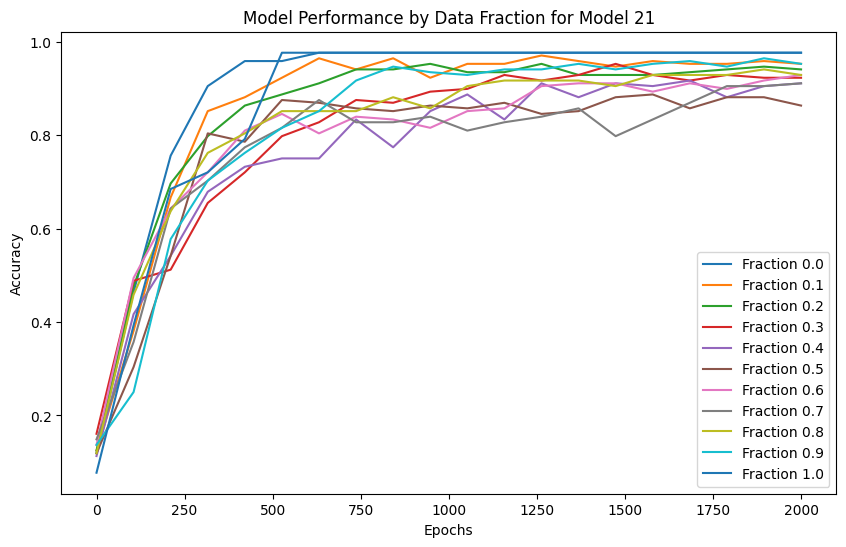

Model 22, Fraction 0.00, Epoch 1, Loss: 2.1997
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.8390
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.3560
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.0368
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.7561
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.5414
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.3884
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.2921
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.2293
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1876
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1583
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1370
predi

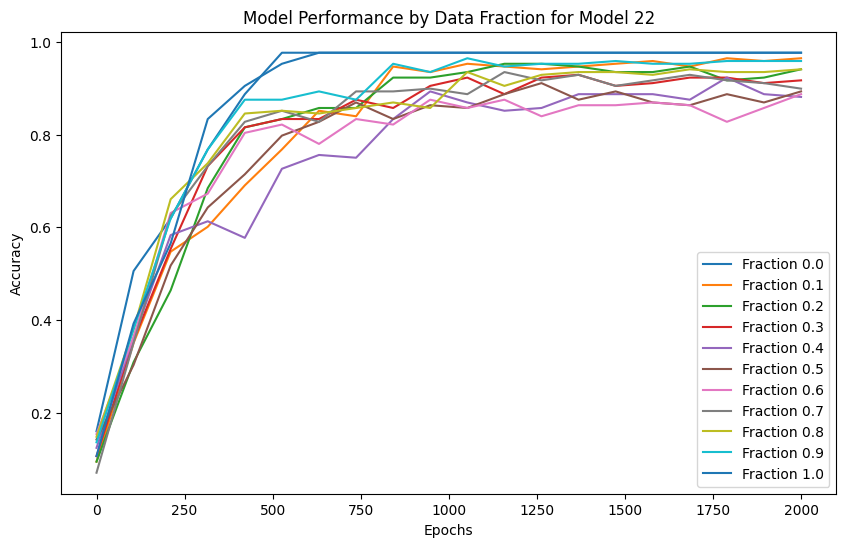

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2040
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9441
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.4761
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.1069
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.7808
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5322
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.3654
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.2656
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.2057
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1673
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1417
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1239
predi

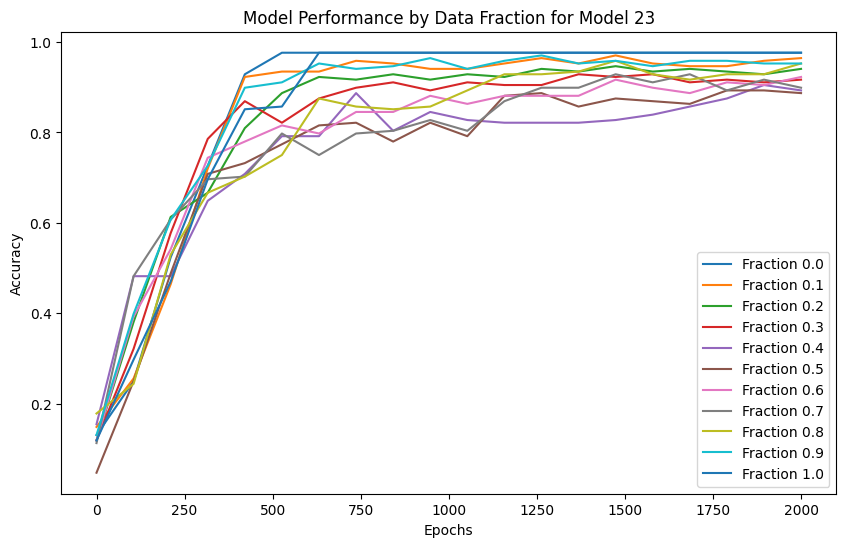

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2064
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.8883
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.4074
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.0425
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.7285
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.5463
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4353
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.3146
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.2227
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1745
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1460
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1271
predi

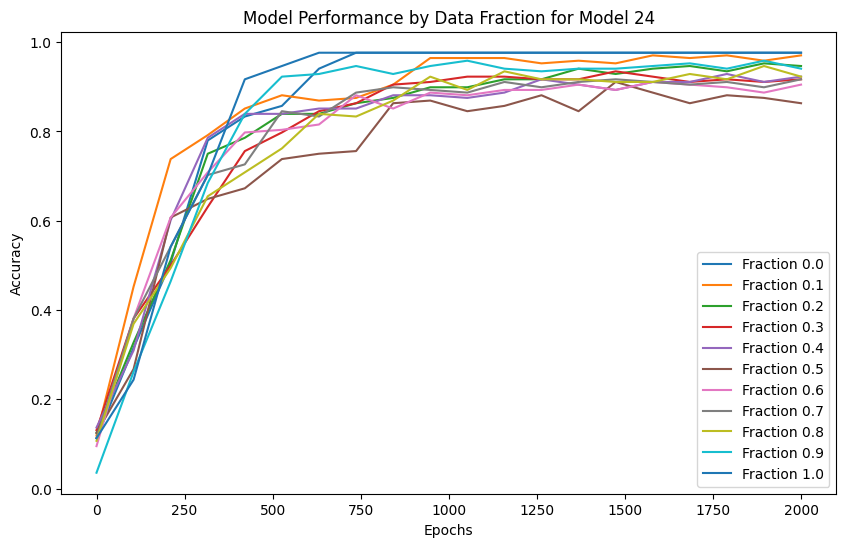

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2028
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.8836
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.3996
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.0964
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.8686
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.6128
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4066
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.2708
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.1984
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.1577
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.1328
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1165
predi

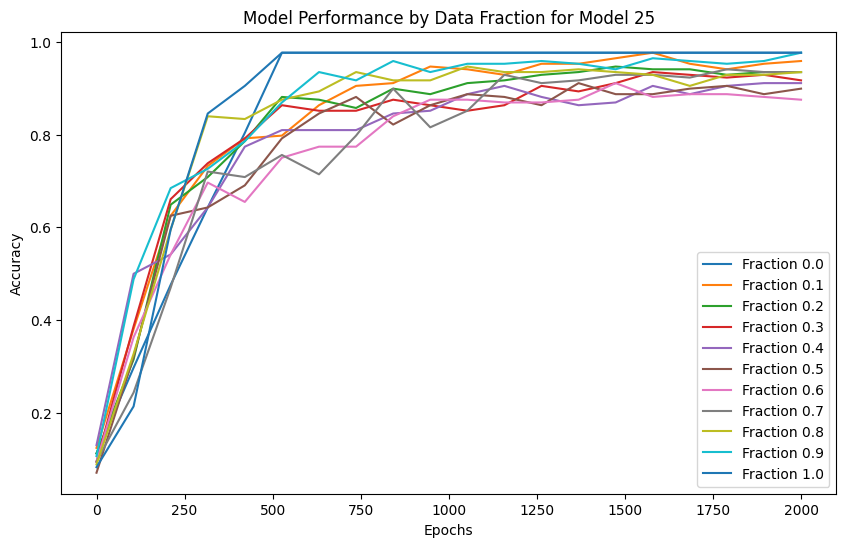

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1997
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.9121
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.3453
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.9576
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6782
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.4827
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.3547
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.2678
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1698
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1430
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1245
predi

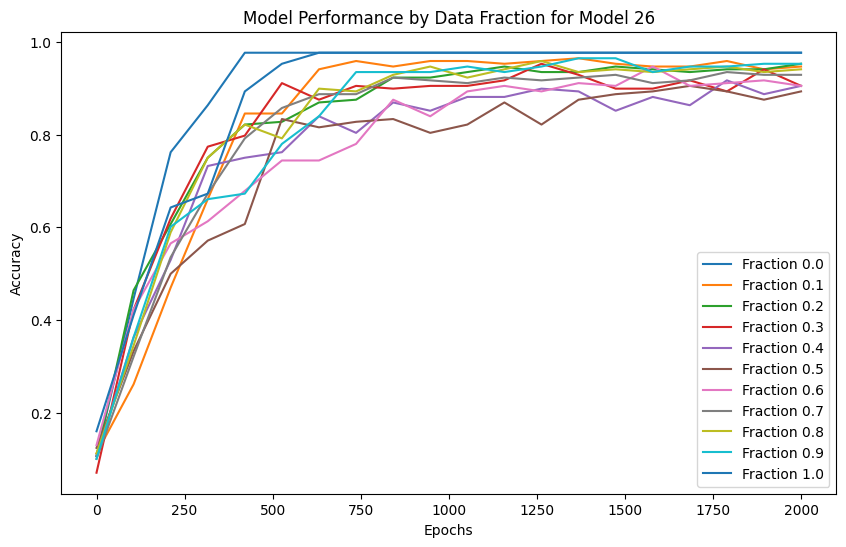

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2005
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.8994
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.3860
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.0917
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.8131
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.5775
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4166
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.3064
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.2299
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1822
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1518
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1313
predi

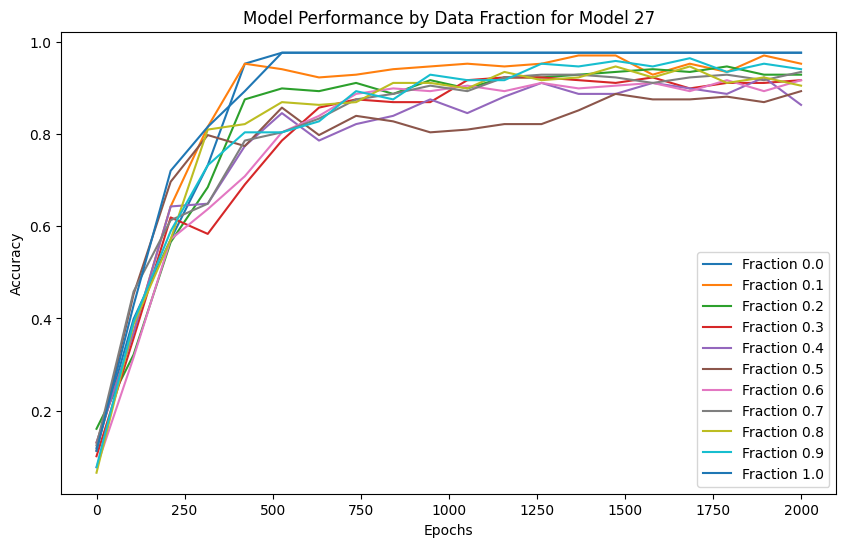

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2035
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.8650
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.4158
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.1025
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.8788
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.6702
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4973
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.3573
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.2596
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1998
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1622
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1370
predi

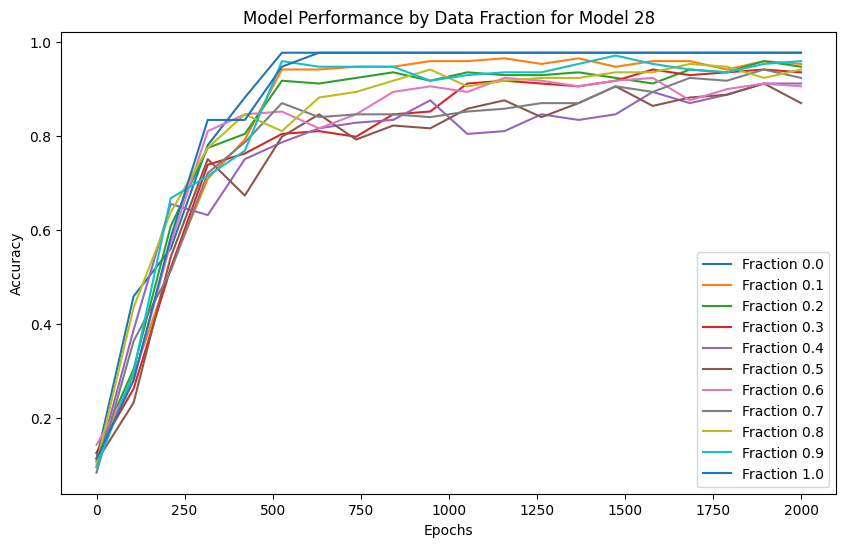

Model 29, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.8763
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.2973
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.8929
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.6688
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.4964
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.3666
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.2765
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.2135
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.1728
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1457
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1266
predi

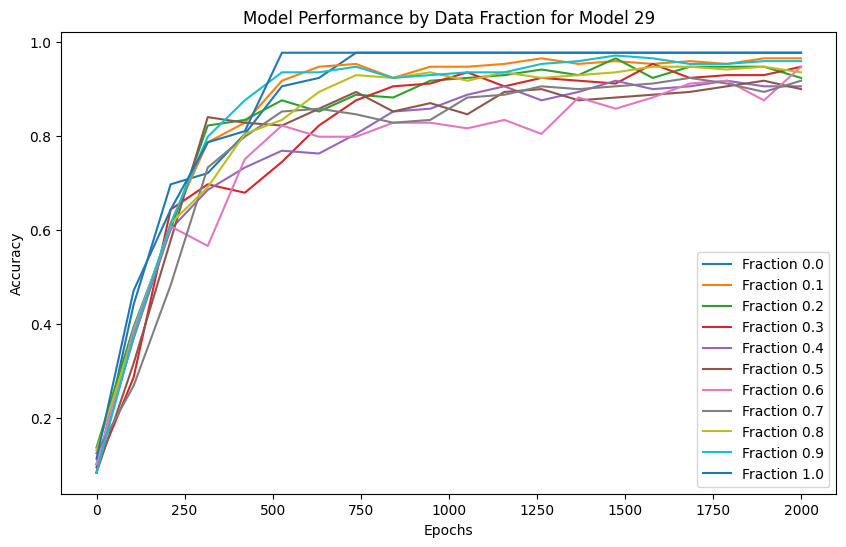

In [23]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_GHI_contradiction_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [24]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_GHI_contradiction_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6706
  Fraction 0.10, Average Accuracy: 0.7635
  Fraction 0.20, Average Accuracy: 0.7810
  Fraction 0.30, Average Accuracy: 0.7889
  Fraction 0.40, Average Accuracy: 0.7984
  Fraction 0.50, Average Accuracy: 0.8794
  Fraction 0.60, Average Accuracy: 0.9540
  Fraction 0.70, Average Accuracy: 0.9738
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9762
  Fraction 0.30, Average Accuracy: 0.9762
  Fraction 0.40, Average Accuracy: 0.9683
  Fraction 0.50, Average Accuracy: 0.8960
  Fraction 0.60, Average Accuracy: 0.8175
  Fraction 0.70, Average Accuracy: 0.7952
  Fraction 0.80, Average Accuracy: 0.7944
  Fraction 0.90, Average Accuracy: 0.7802
  Fraction 1.00, Average Accuracy: 0.6706


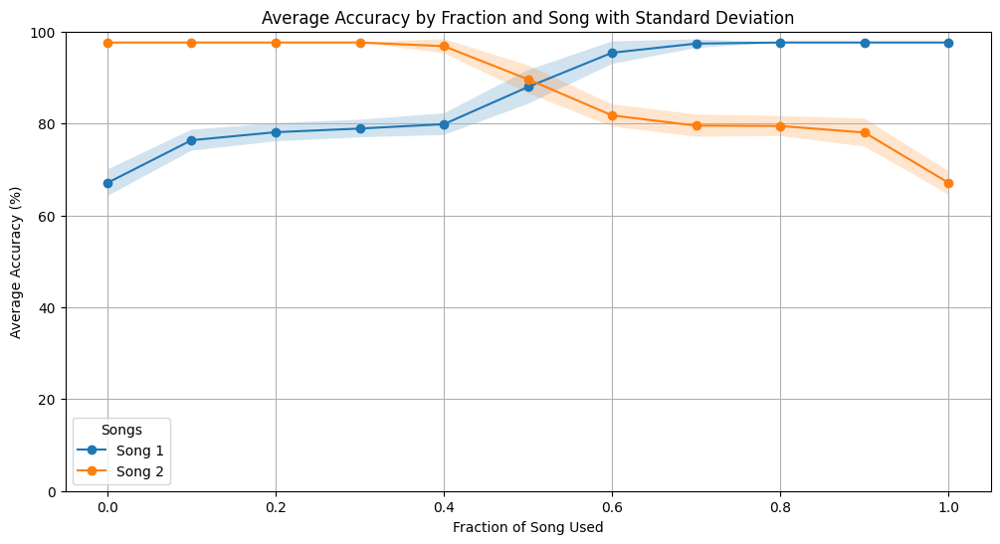

In [25]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## Model Size

### Normal and reverse songs - 8,8,2 - M

#### Training 

Model 0, Fraction 0.00, Epoch 1, Loss: 2.1844
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.2284
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.5692
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.2879
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.1797
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.1320
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0935
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0749
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0699
prediction sha

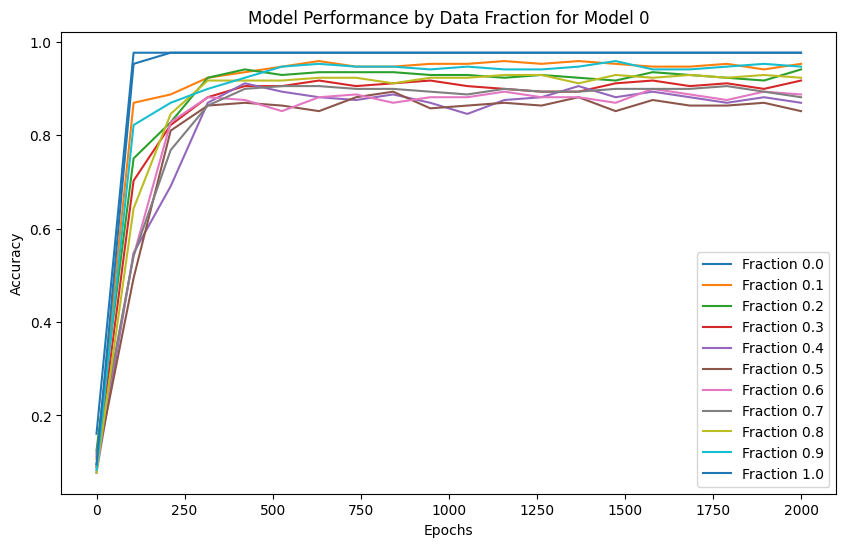

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2184
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.3392
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.6268
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.2958
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.1784
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.1302
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1064
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0929
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

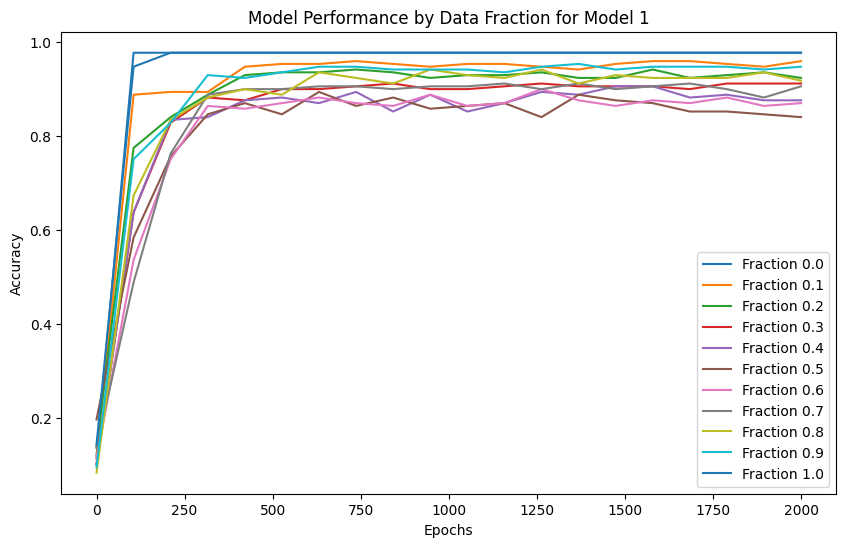

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2088
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.3385
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.5728
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.2745
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.1710
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.1273
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1051
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0923
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

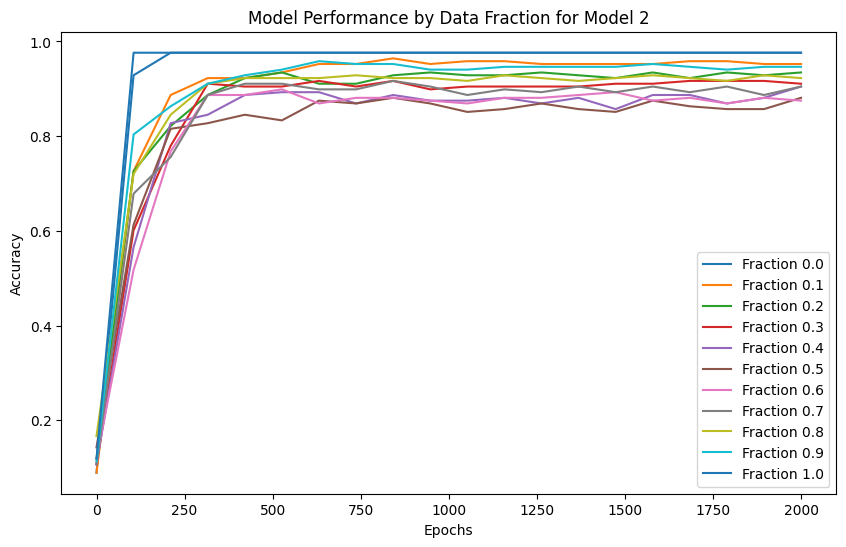

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2086
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.3118
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.6112
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.2928
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.1795
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.1318
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1077
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0853
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0796
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0755
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0726
prediction shape 

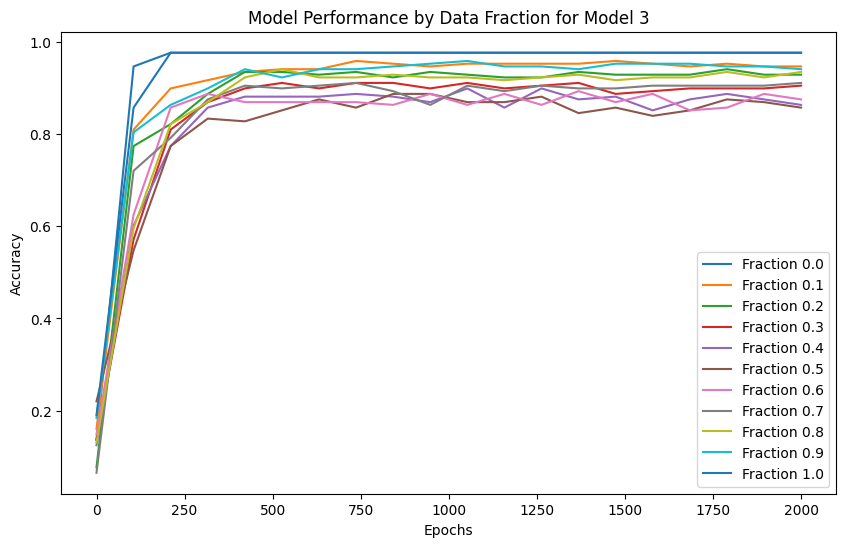

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2258
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.3577
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6312
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.2979
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.1811
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.1321
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0936
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0792
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

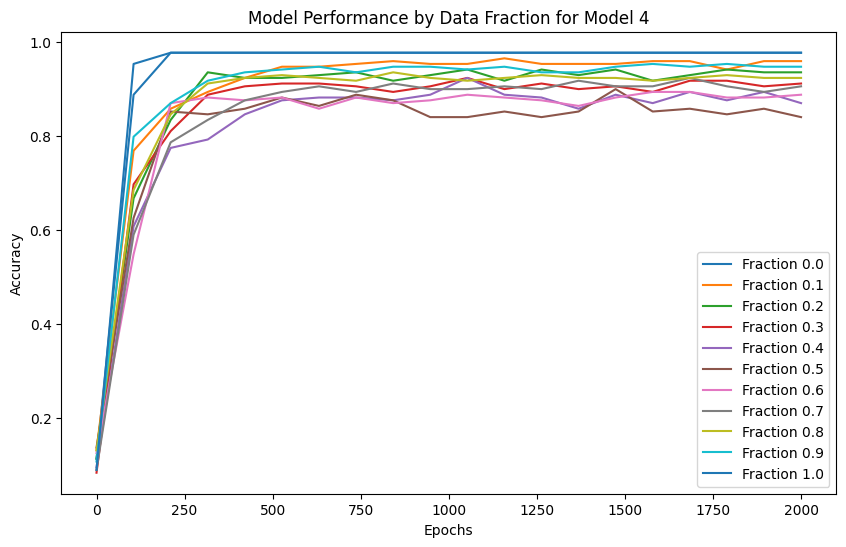

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2139
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.2934
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.6361
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.3117
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.1853
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.1336
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1082
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0851
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0752
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0723
prediction shape 

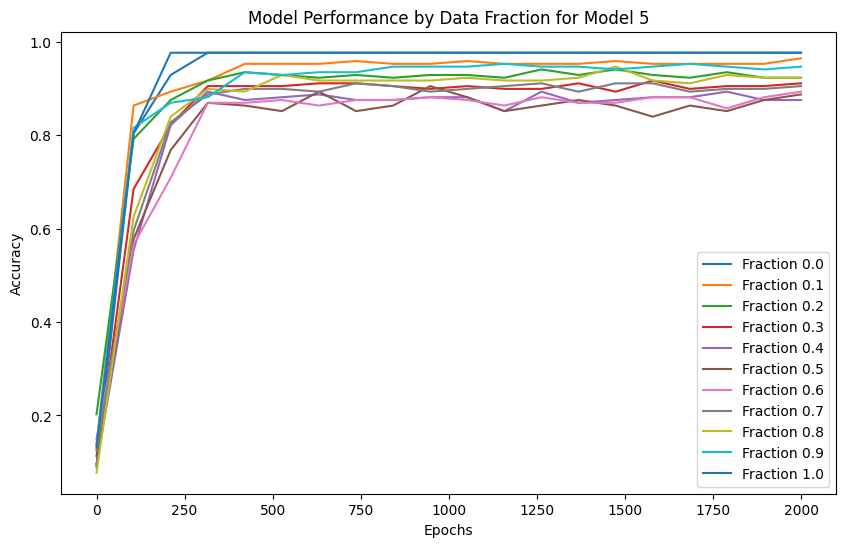

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2053
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.3502
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.6019
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.2863
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.1772
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.1308
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1071
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0935
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0721
prediction shape 

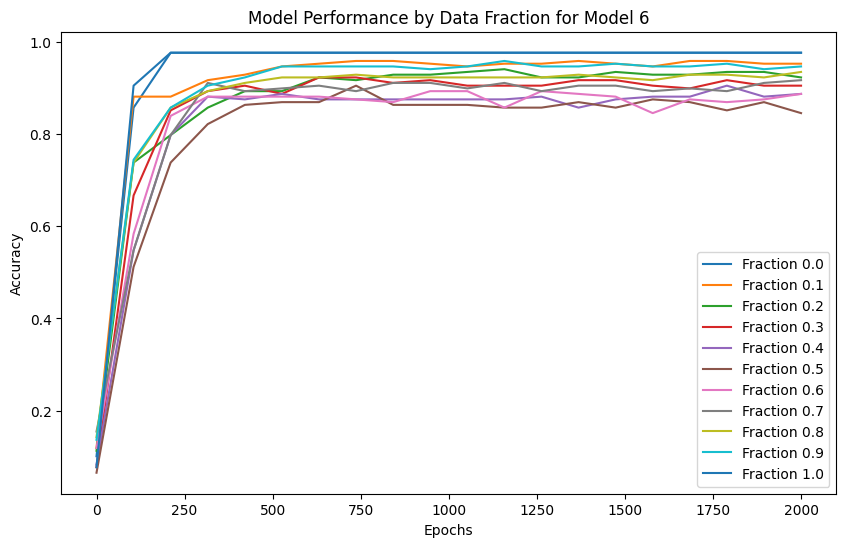

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2202
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.3819
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6225
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.2924
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.1758
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1283
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1049
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0836
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0782
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0716
prediction shape 

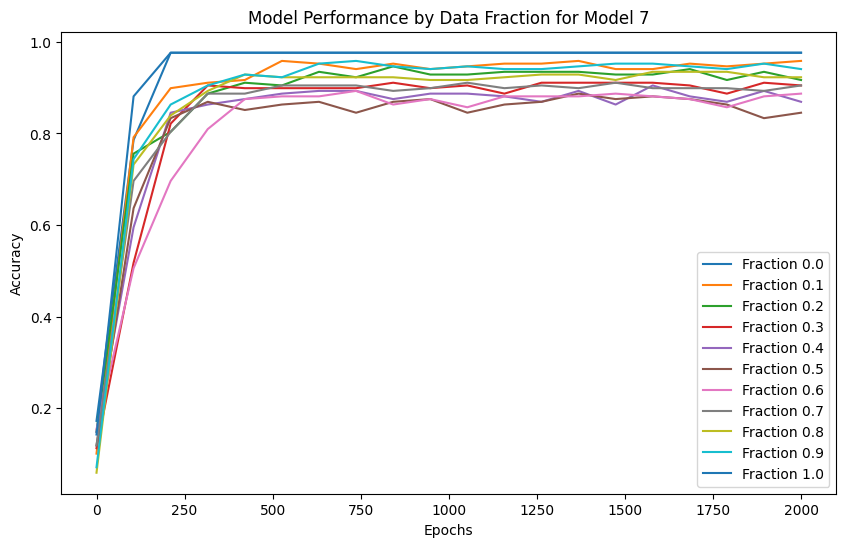

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2080
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.2874
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.5852
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.2906
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.1779
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.1292
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1049
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0913
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0830
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0776
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0711
prediction shape 

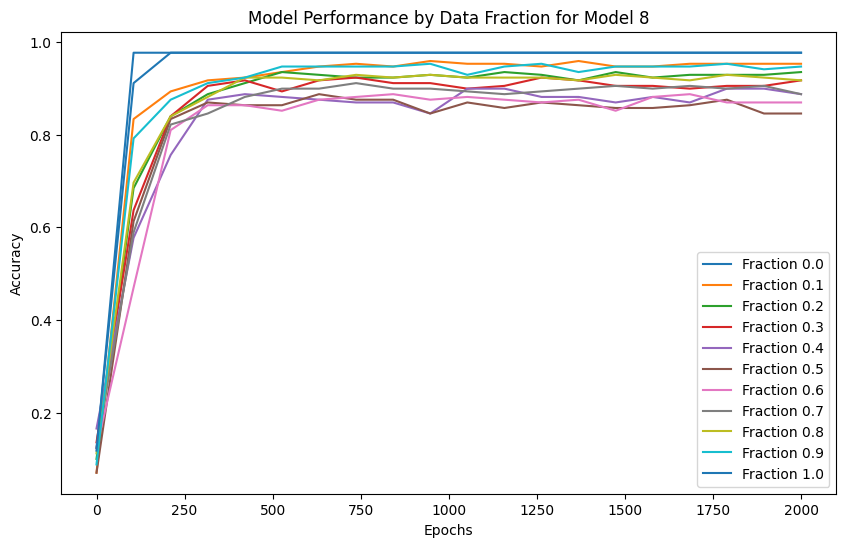

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2276
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.3336
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.6288
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.3115
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.1903
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.1376
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1109
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0958
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0864
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0802
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0760
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0728
prediction shape 

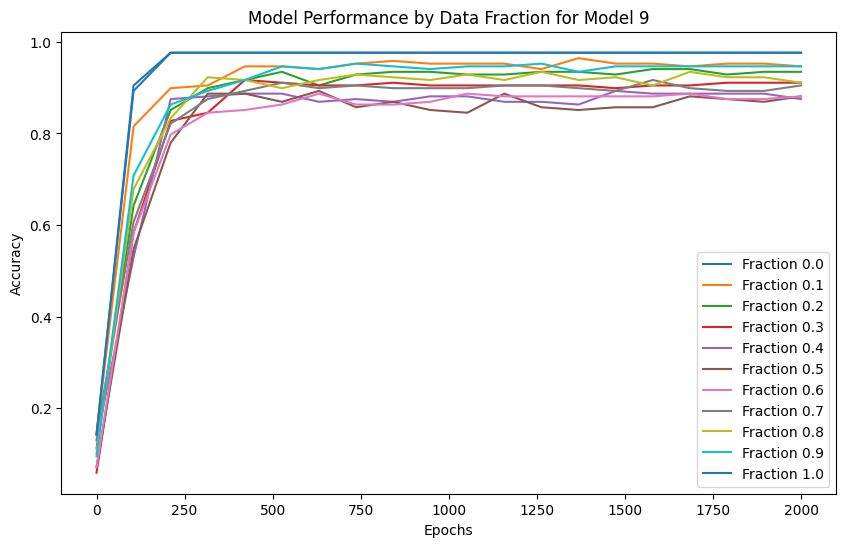

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2057
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.3281
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.6690
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.3298
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.1937
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.1370
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1096
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0944
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0853
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0751
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0722
predi

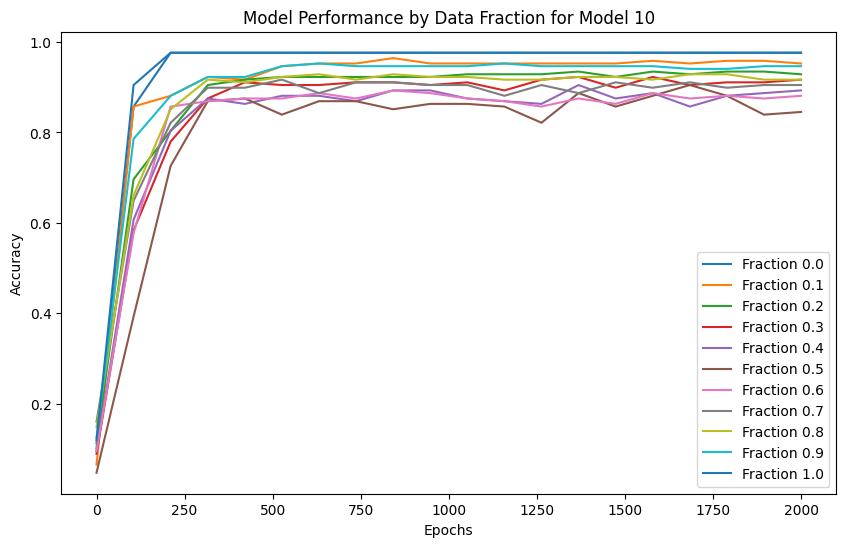

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2326
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.3467
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.6452
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.3076
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.1837
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.1324
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1071
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0929
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0785
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0717
predi

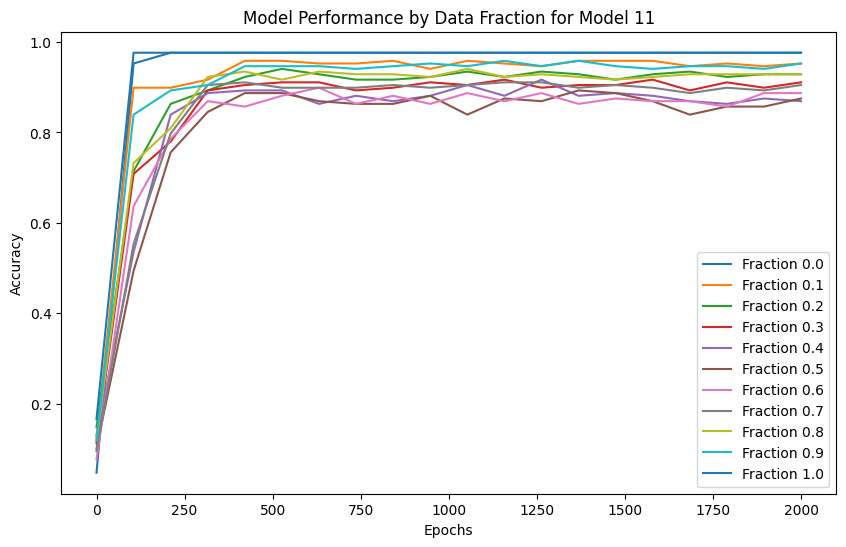

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2181
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.4442
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.6327
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.3130
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.1888
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.1355
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1090
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0941
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0748
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0719
predi

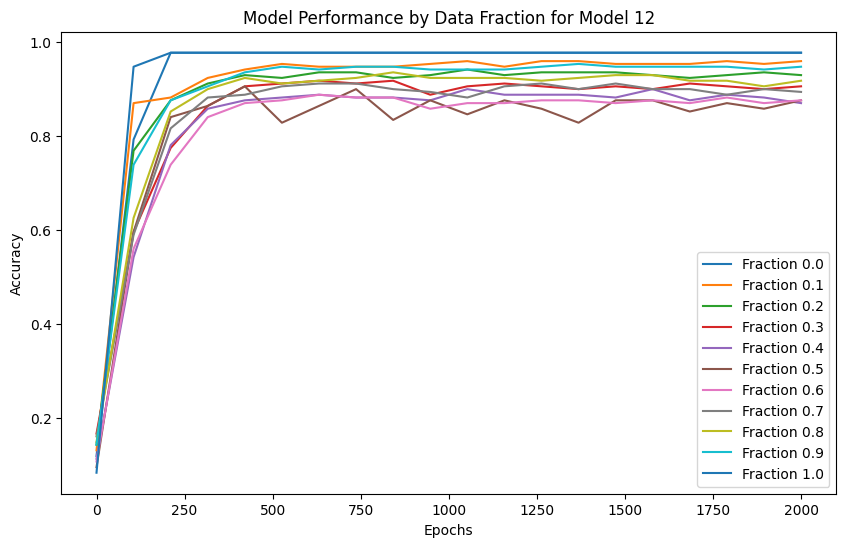

Model 13, Fraction 0.00, Epoch 1, Loss: 2.1909
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.3052
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.6206
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.3113
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.1901
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.1374
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1109
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0959
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0866
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0761
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0730
predi

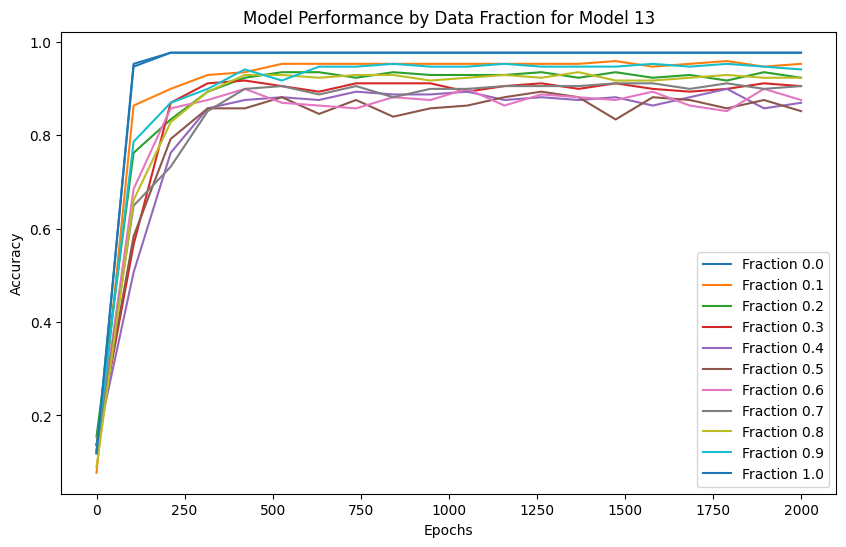

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2193
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.3068
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.6058
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.3031
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.1849
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.1340
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1086
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0853
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0753
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0723
predi

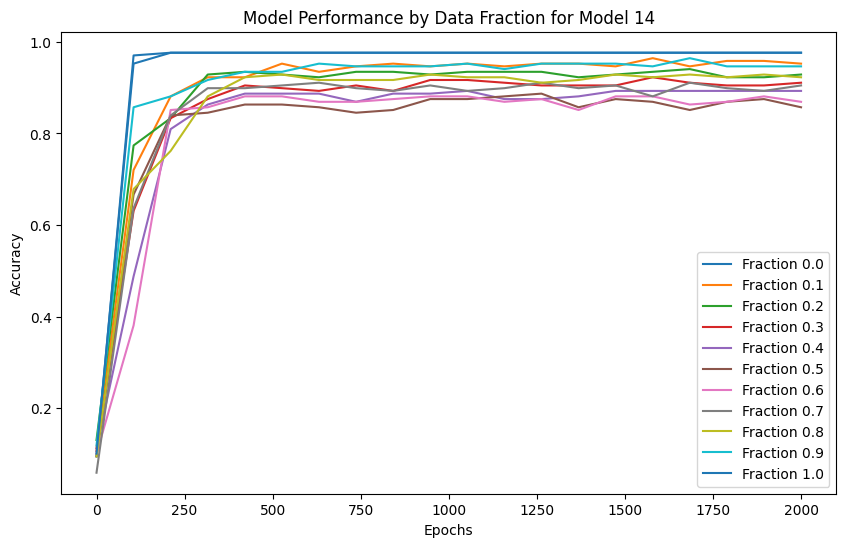

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2084
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.2706
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6097
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.3051
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.1869
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.1352
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1091
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0944
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0854
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0753
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0723
predi

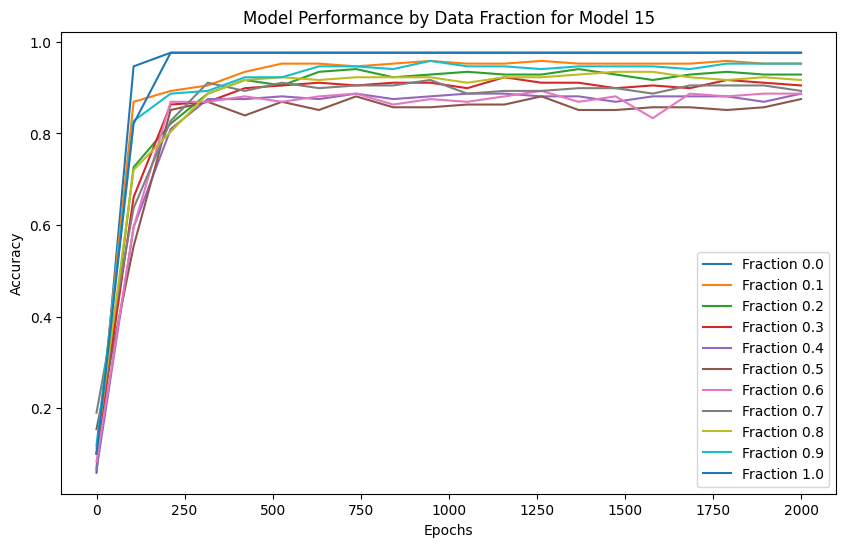

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2138
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.3460
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.6578
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.3273
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.1998
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.1440
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1154
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0990
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0888
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0820
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0772
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0738
predi

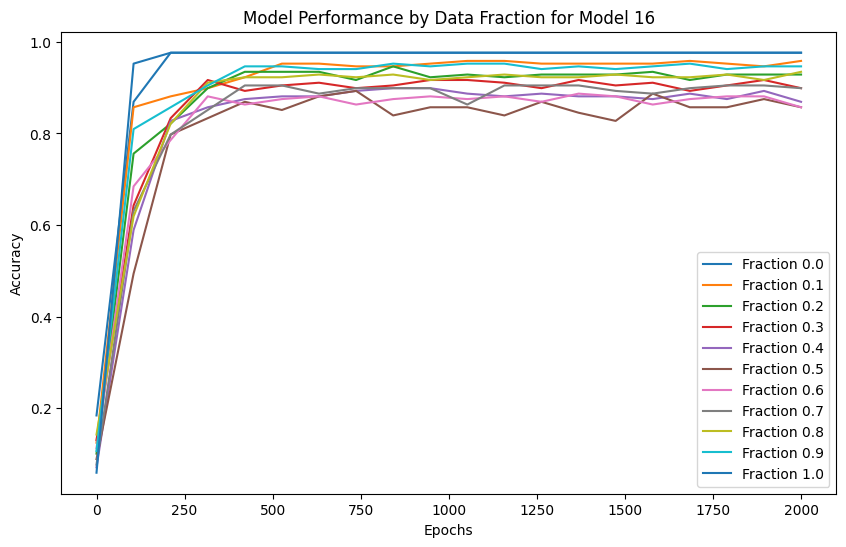

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2128
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.2869
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.5937
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.3002
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.1844
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.1333
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0842
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0715
predi

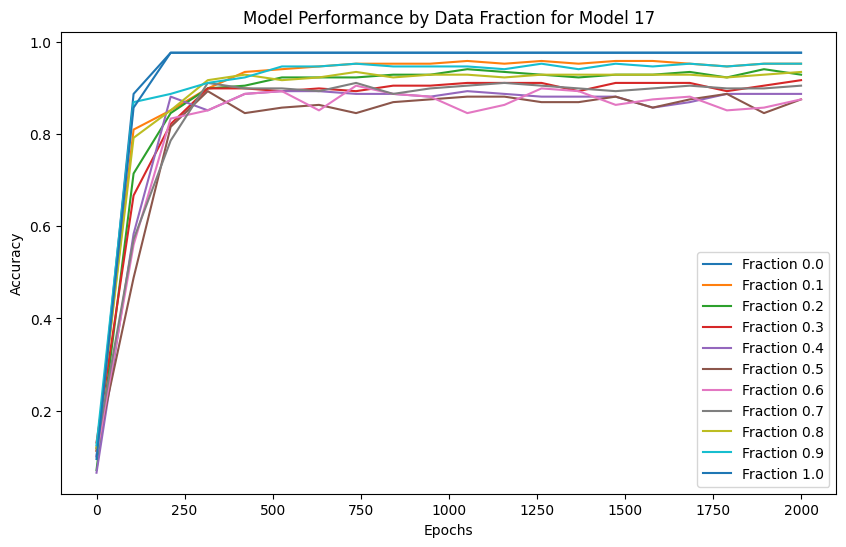

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1959
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.3491
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.5884
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.2787
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.1711
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.1263
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1038
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0910
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0831
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0714
predi

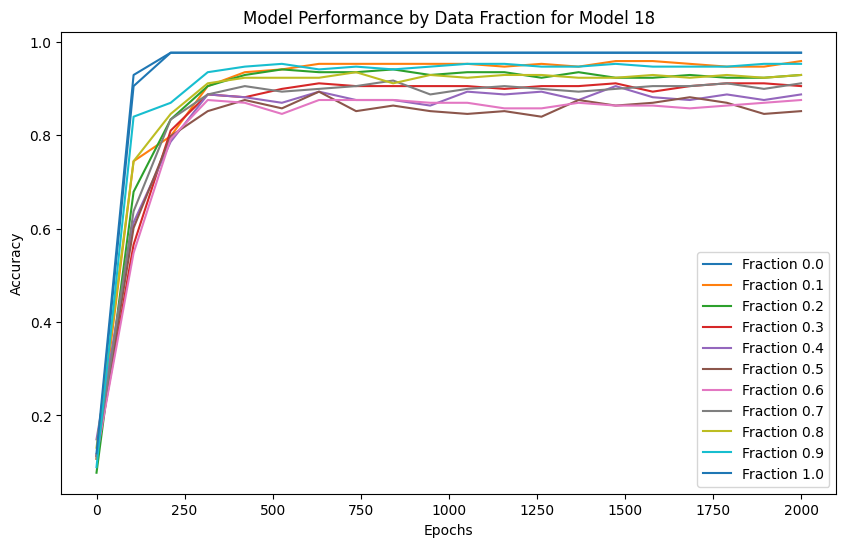

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2135
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.3321
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6503
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3146
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.1893
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.1367
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1105
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0957
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0865
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0762
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0731
predi

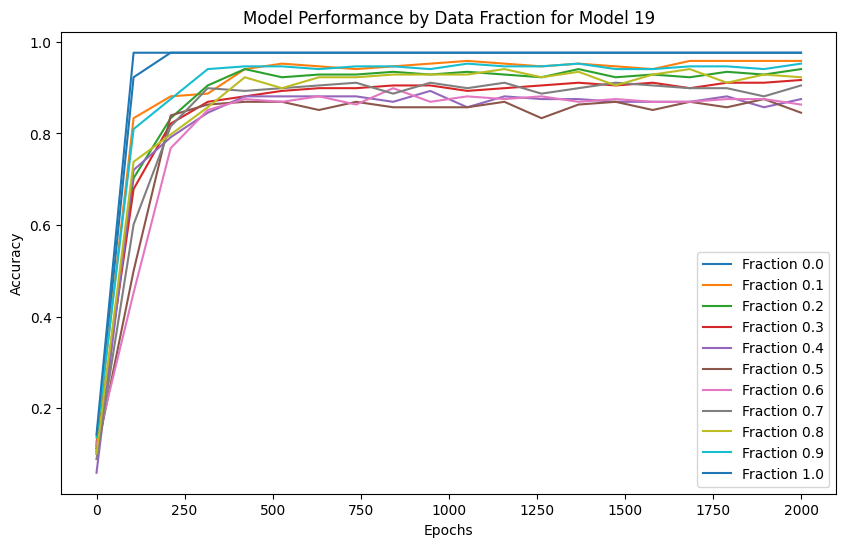

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1943
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.2698
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.6377
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.3166
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.1892
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.1359
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1097
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0950
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0859
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0757
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0727
predi

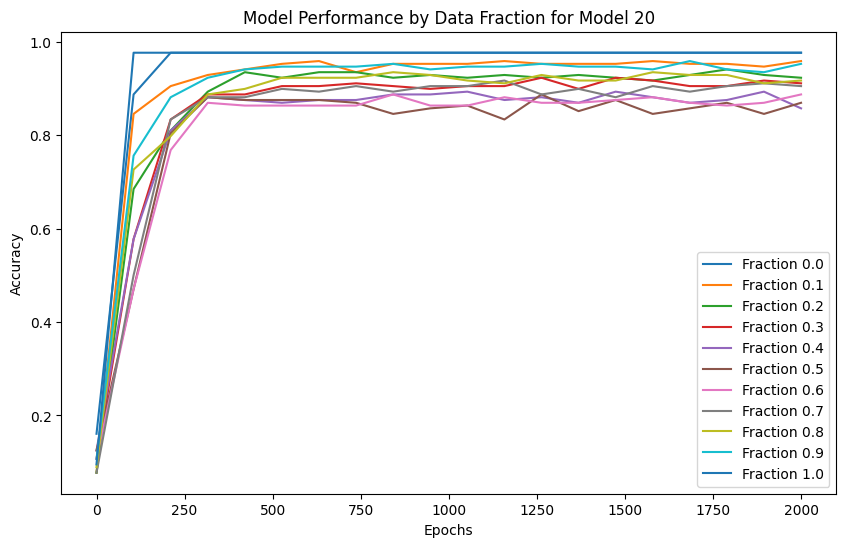

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2222
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.3348
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.5921
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.2847
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.1742
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.1275
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1043
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0831
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

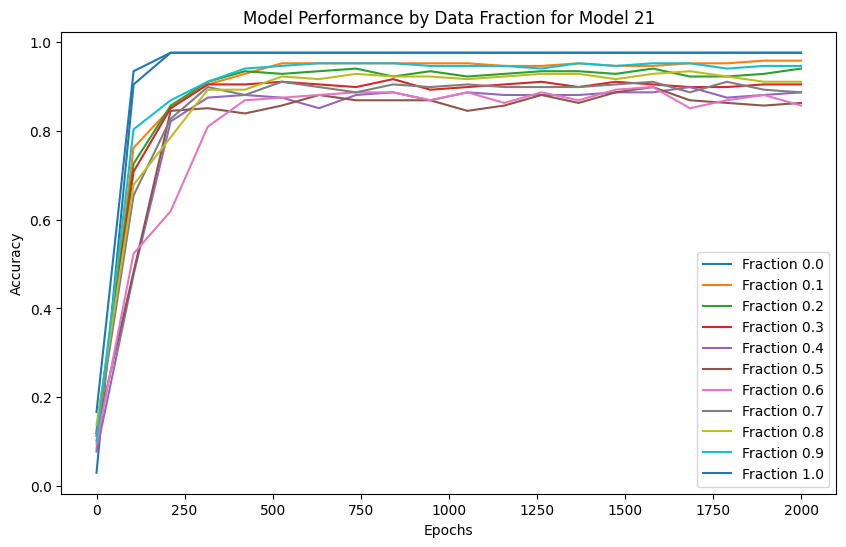

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2048
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.3152
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.5863
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.2929
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.1818
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.1332
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1085
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0943
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0855
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0797
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0756
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0726
predi

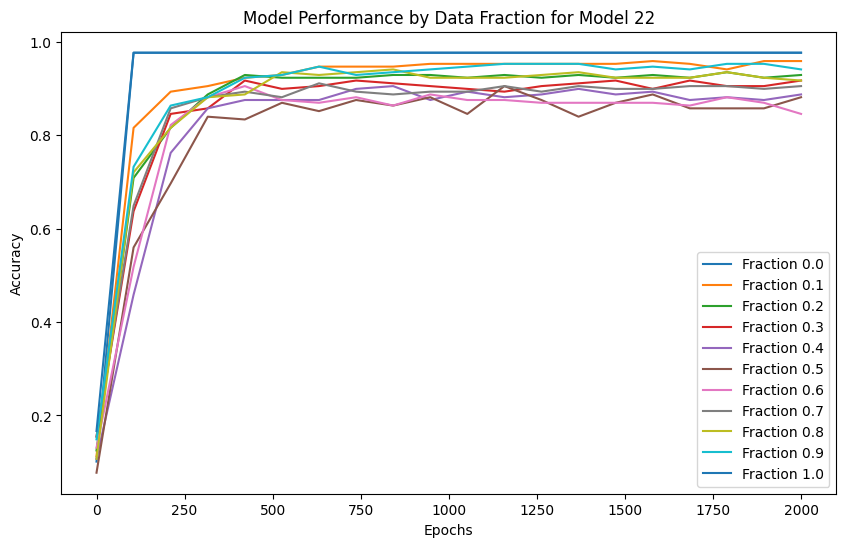

Model 23, Fraction 0.00, Epoch 1, Loss: 2.1994
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.2728
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.5976
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.2912
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.1755
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.1280
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1048
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0917
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0837
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0783
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0718
predi

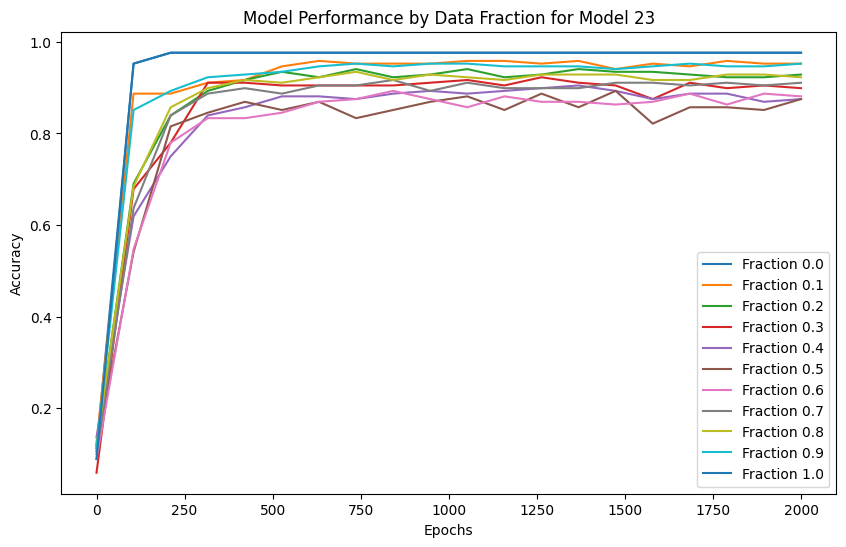

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2103
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.3676
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.6303
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.2951
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.1778
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.1298
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1059
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0923
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0839
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0783
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

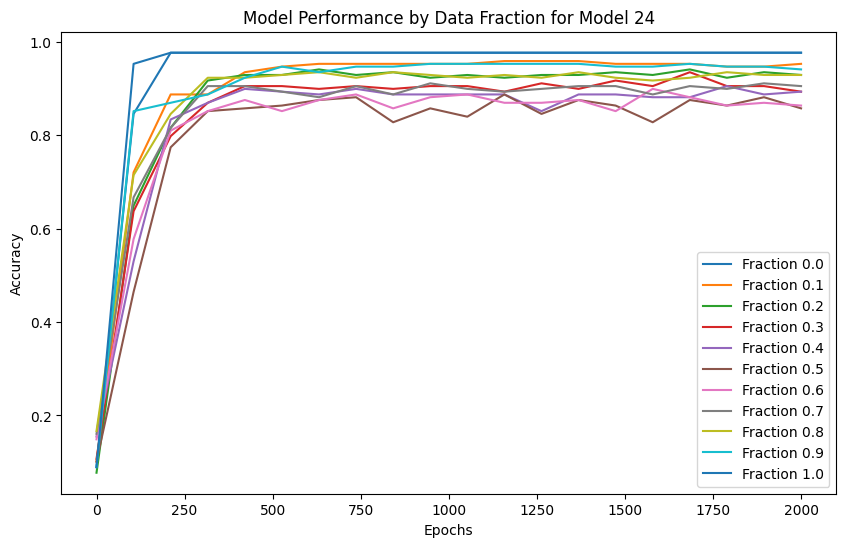

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2015
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.2543
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.5532
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.2567
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.1601
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.1207
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1008
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0893
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0820
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0771
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0737
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

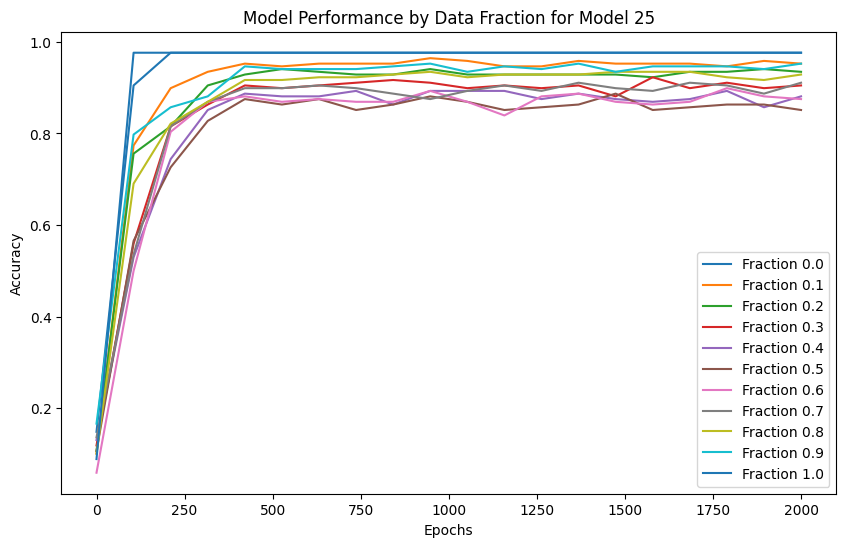

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2157
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.3086
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.5626
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.2656
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.1207
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.0995
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0877
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0757
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0723
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0700
predi

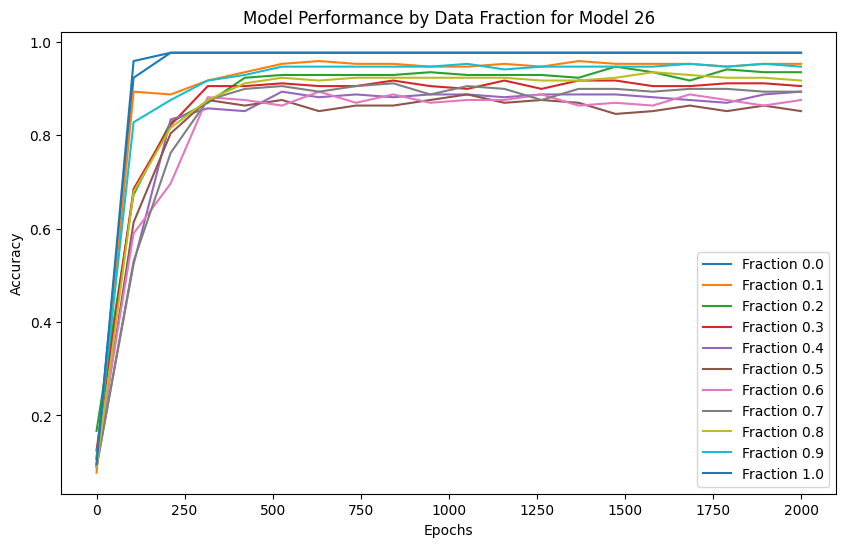

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2020
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.3266
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.6598
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3108
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.1839
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.1324
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1073
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0933
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0847
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0750
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0722
predi

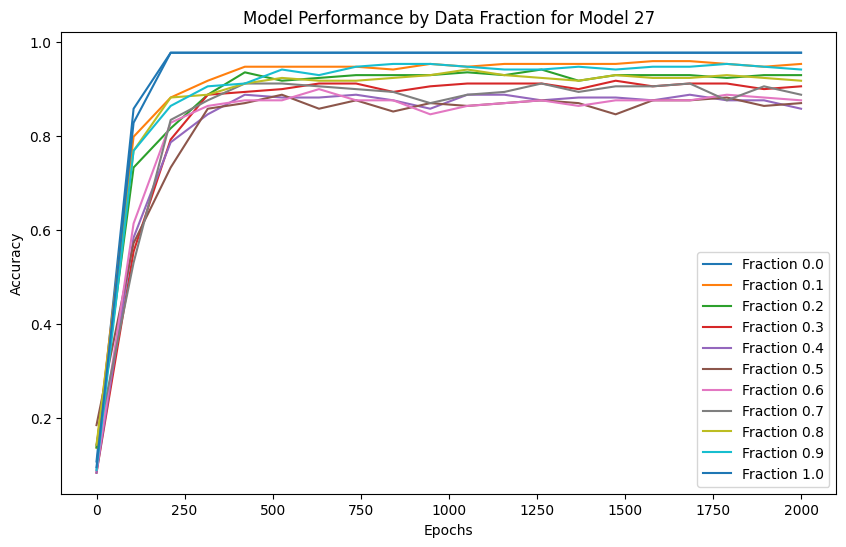

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2089
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.3025
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.6573
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.3337
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.1992
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.1407
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1118
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0958
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0862
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0756
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0726
predi

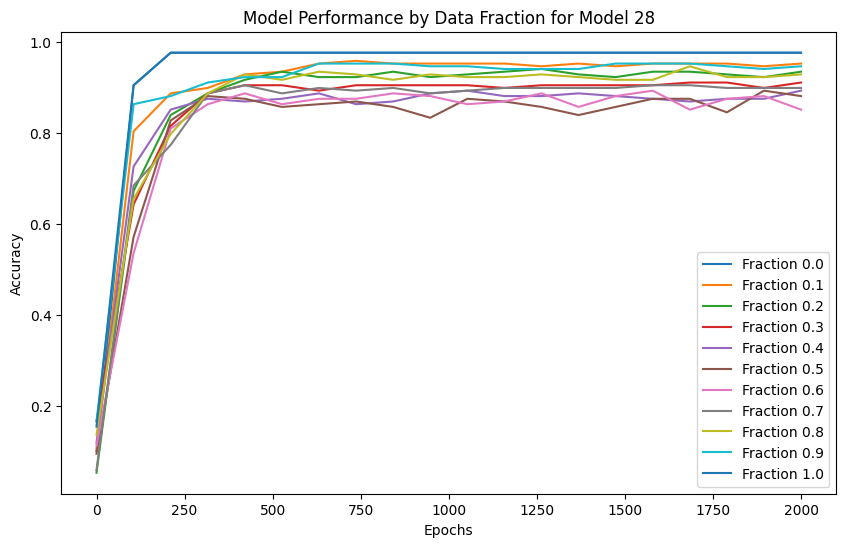

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2430
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.3887
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.6458
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3175
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.1886
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.1342
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1075
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0841
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0716
predi

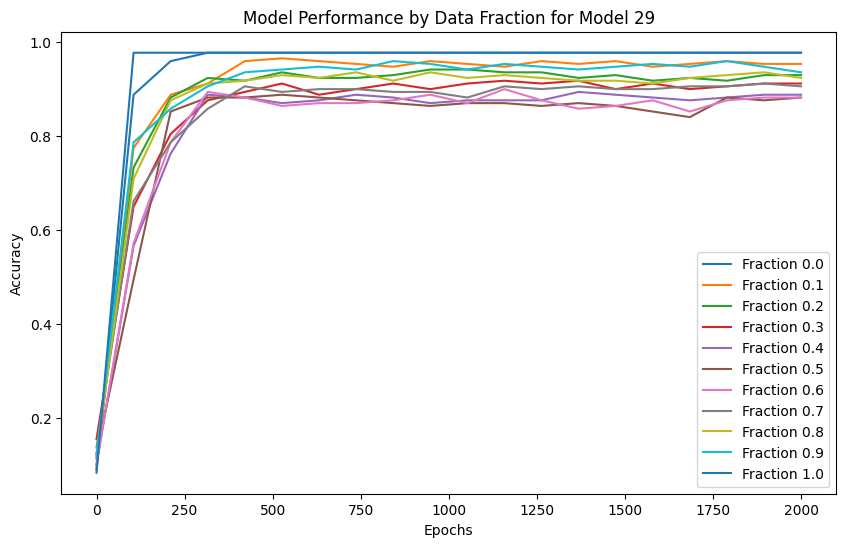

In [26]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED", # within song 8 con, 166 over
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"  # within song 8 con, 166 over
    #"ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])     # between songs 0 overlap and 0 contradiction

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing 

In [91]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0000
  Fraction 0.10, Average Accuracy: 0.7315
  Fraction 0.20, Average Accuracy: 0.7331
  Fraction 0.30, Average Accuracy: 0.7331
  Fraction 0.40, Average Accuracy: 0.7607
  Fraction 0.50, Average Accuracy: 0.8530
  Fraction 0.60, Average Accuracy: 0.9442
  Fraction 0.70, Average Accuracy: 0.9704
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9754
  Fraction 0.30, Average Accuracy: 0.9754
  Fraction 0.40, Average Accuracy: 0.9528
  Fraction 0.50, Average Accuracy: 0.8675
  Fraction 0.60, Average Accuracy: 0.7704
  Fraction 0.70, Average Accuracy: 0.7389
  Fraction 0.80, Average Accuracy: 0.7321
  Fraction 0.90, Average Accuracy: 0.7321
  Fraction 1.00, Average Accuracy: 0.0022


#### Plotting for transformers

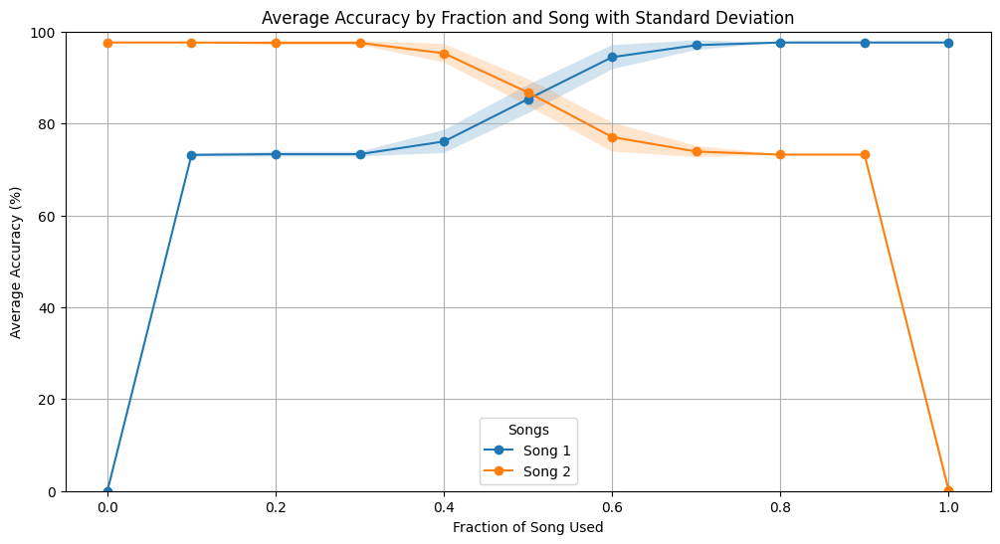

In [92]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plotting for decision tree

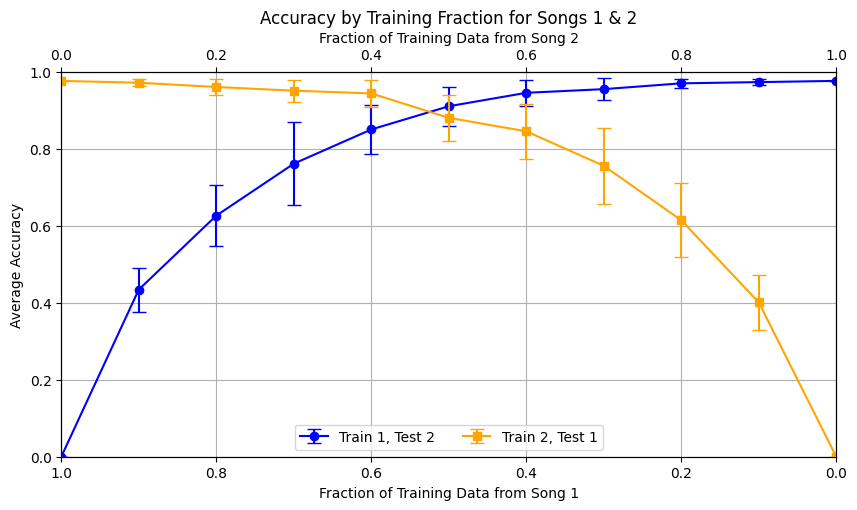

In [90]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 2), (2, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

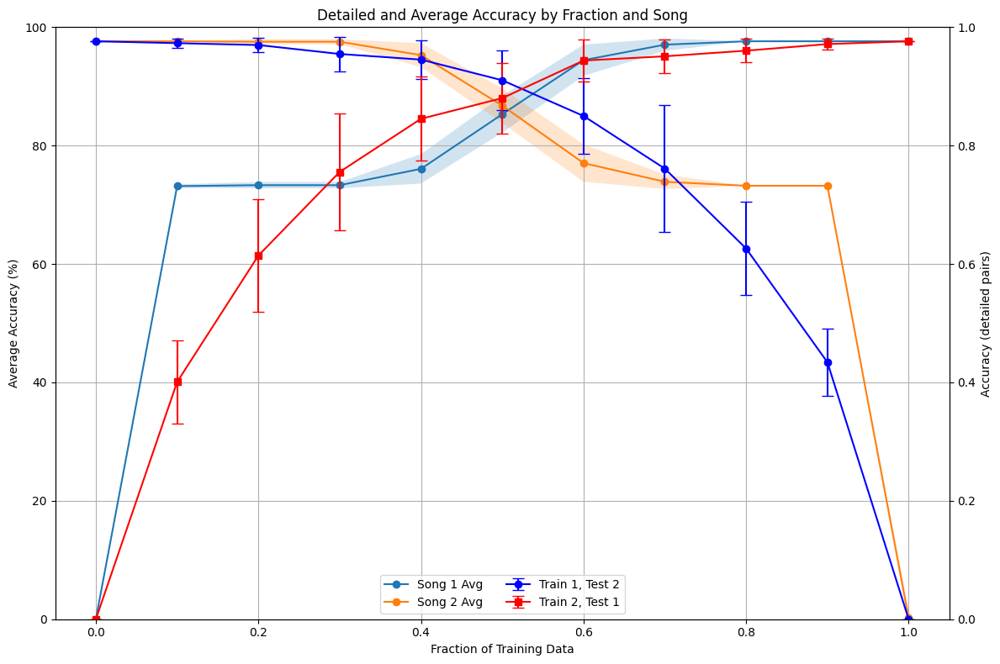

In [93]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


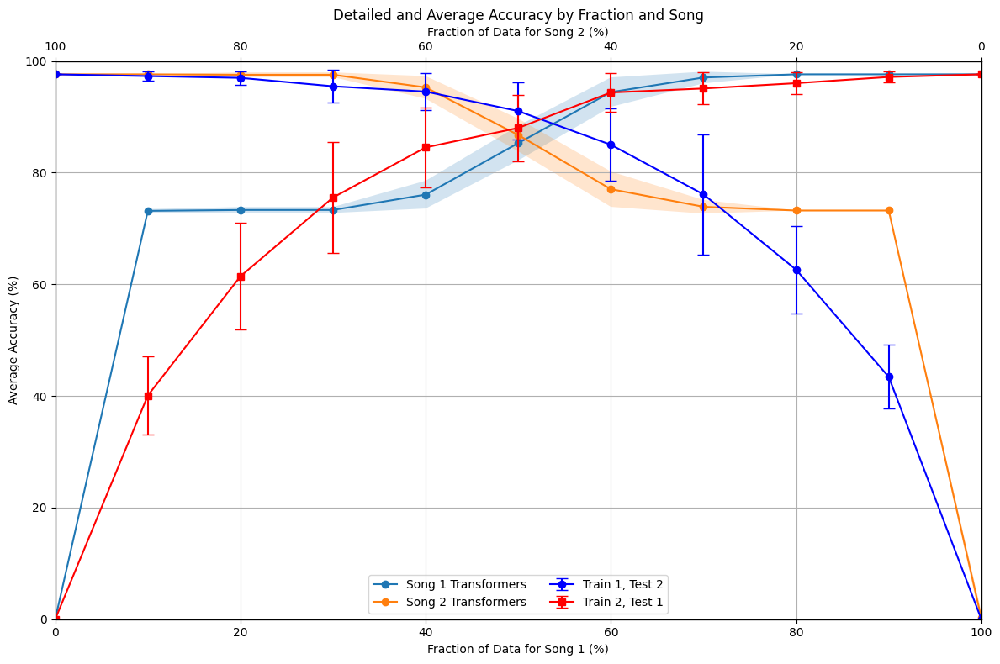

In [94]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Data for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Data for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


### Normal and reverse songs - 4,4,1 - S

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2050
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 101, Loss: 1.8370
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 201, Loss: 1.3519
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.0797
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.8865
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.6744
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4707
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.3272
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.2440
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1928
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1595
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1368
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1207
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1301, Loss: 0.1090
prediction sh

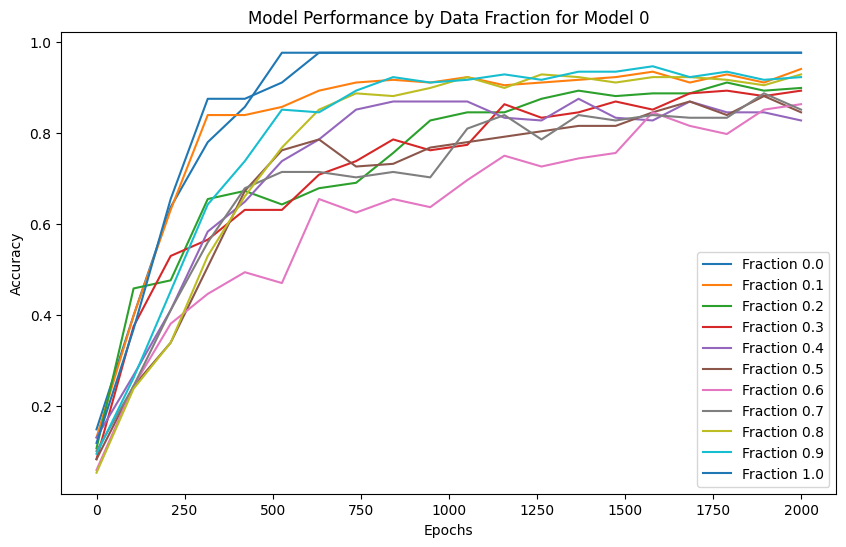

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2173
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.9190
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.3759
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.0197
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.7384
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.5410
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.3906
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.2930
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.2311
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1889
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1590
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1372
prediction shape 

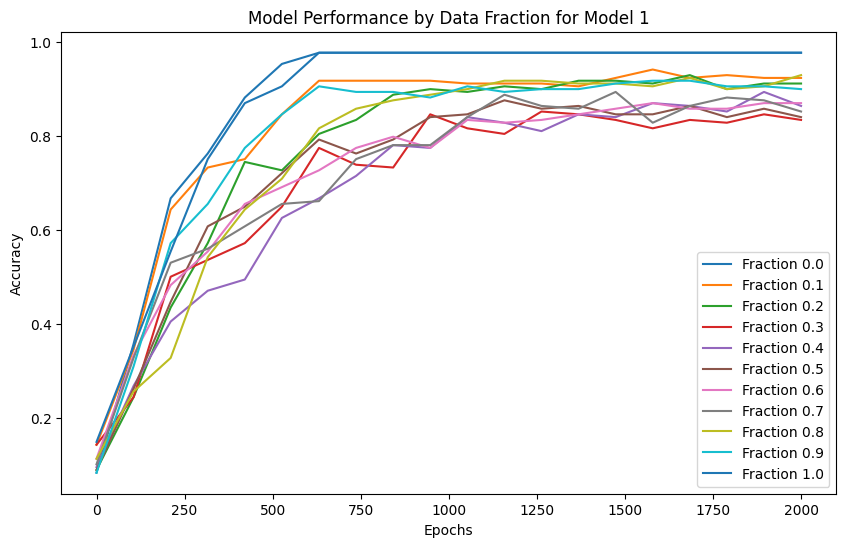

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.8514
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.4418
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.1198
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.8809
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.7285
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.6072
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4989
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4103
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.3199
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.2239
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1696
prediction shape 

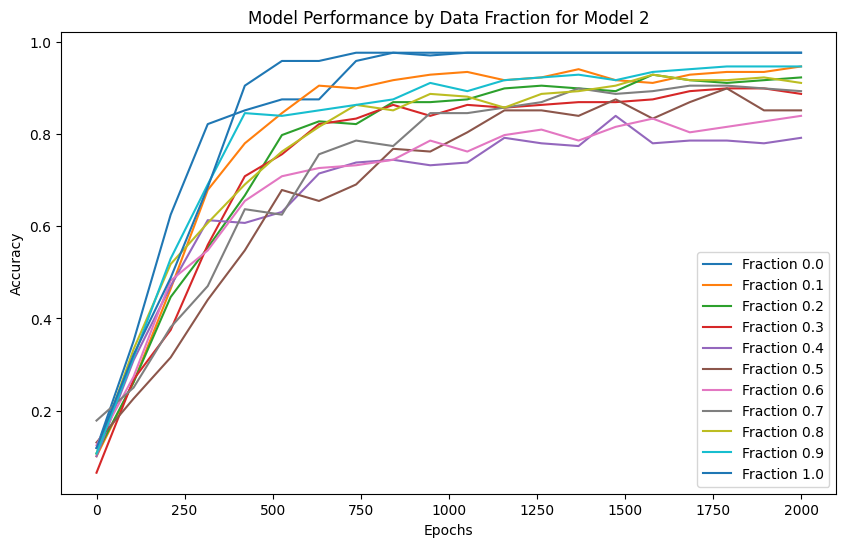

Model 3, Fraction 0.00, Epoch 1, Loss: 2.1976
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.8614
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.3463
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.0130
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.7996
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.6425
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.5007
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.3712
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.2638
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1906
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1474
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1243
prediction shape 

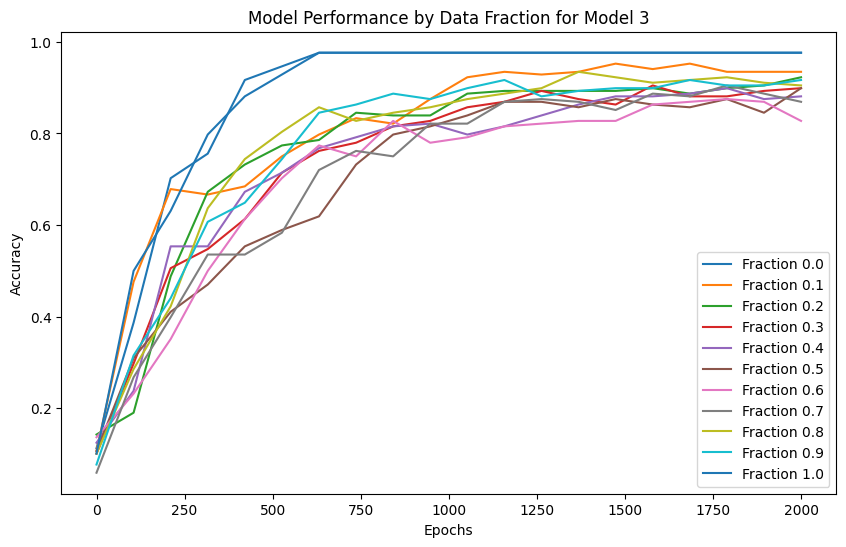

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2081
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.9348
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.4618
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.0653
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.7403
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5402
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.3826
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.2835
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.2210
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1803
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1527
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1331
prediction shape 

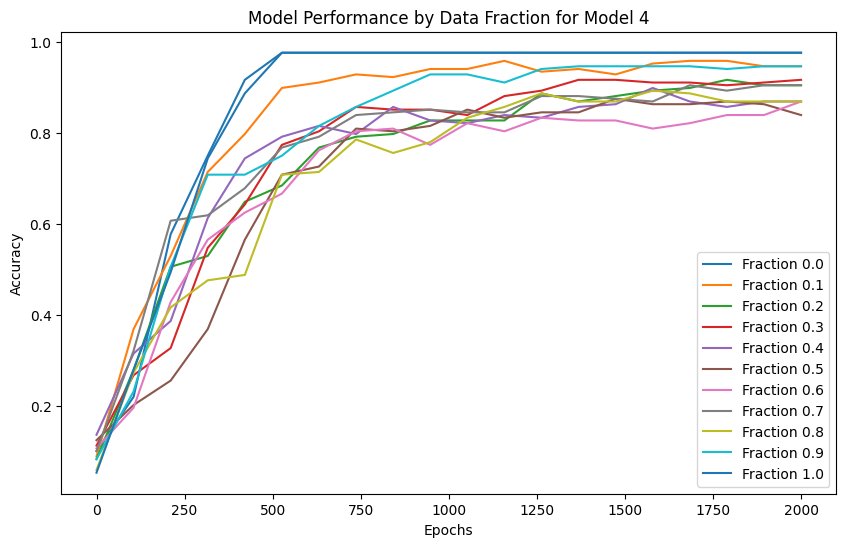

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1968
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.8220
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.2785
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.9657
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.7614
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.6232
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4806
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.3679
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.2866
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.2261
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.1783
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1448
prediction shape 

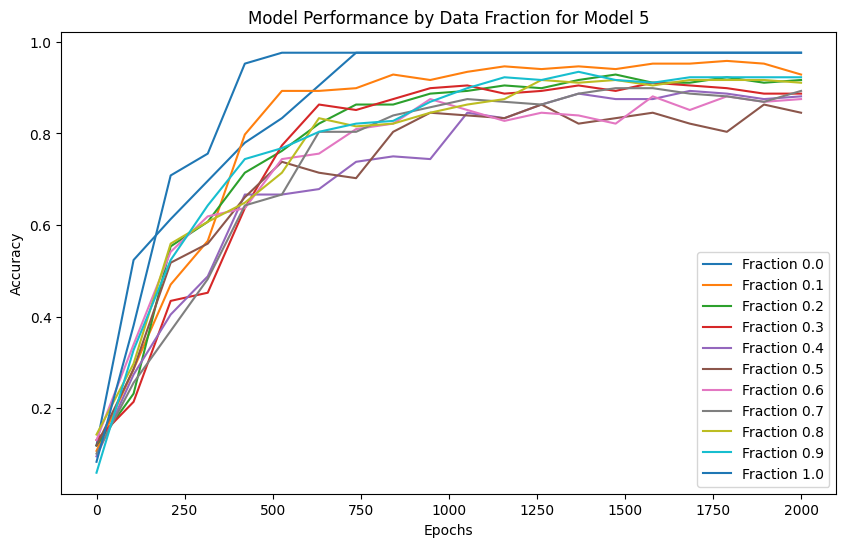

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2051
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.9114
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.4056
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 1.1036
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.8621
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.6246
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4527
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.3262
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.2420
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.1910
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1590
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1373
prediction shape 

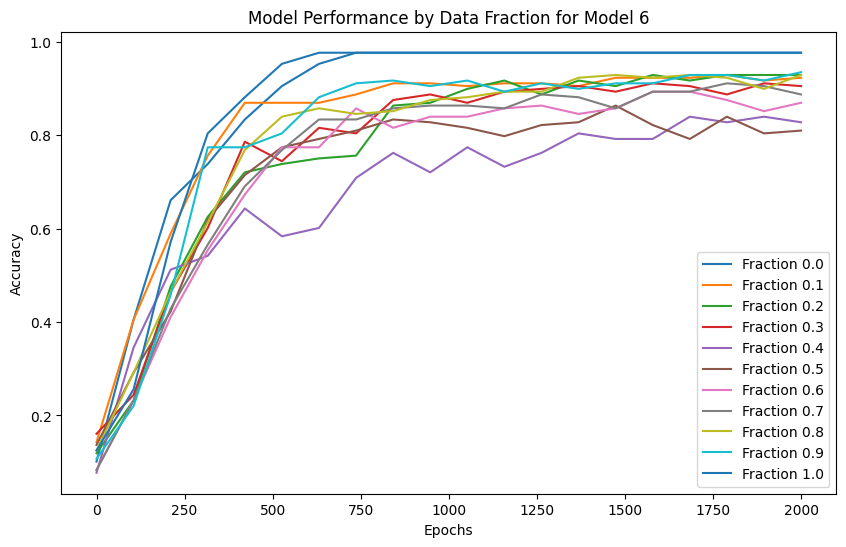

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2039
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.8986
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.3814
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.9998
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.6692
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.4686
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.3475
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.2631
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.2048
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.1663
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1405
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1228
prediction shape 

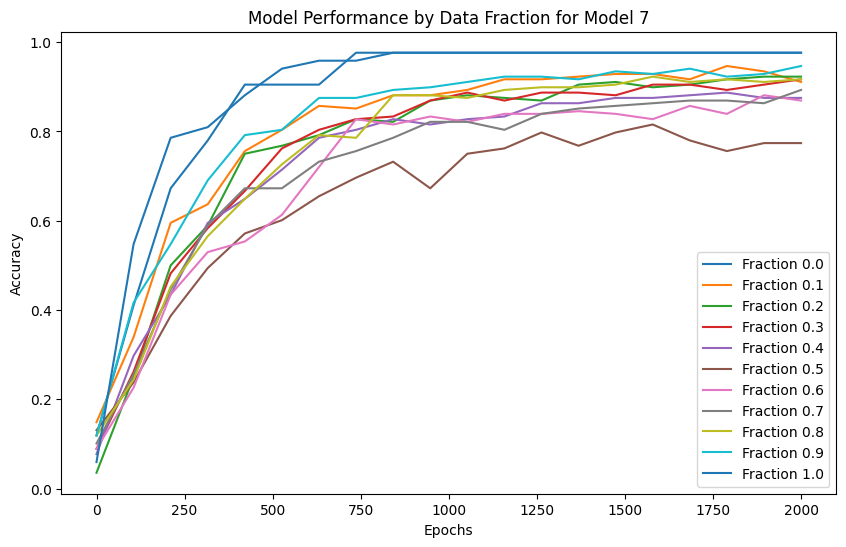

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2076
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9197
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.4052
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.1100
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.7899
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.5194
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.3577
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.2622
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.2040
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1666
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1412
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1237
prediction shape 

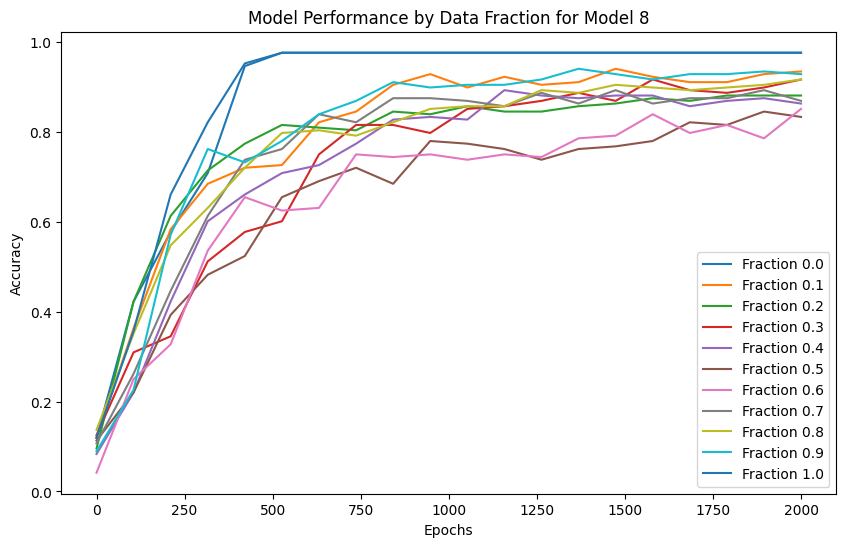

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2078
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.9289
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.4301
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.0373
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.7569
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5354
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.3667
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.2646
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.2044
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1662
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1408
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1231
prediction shape 

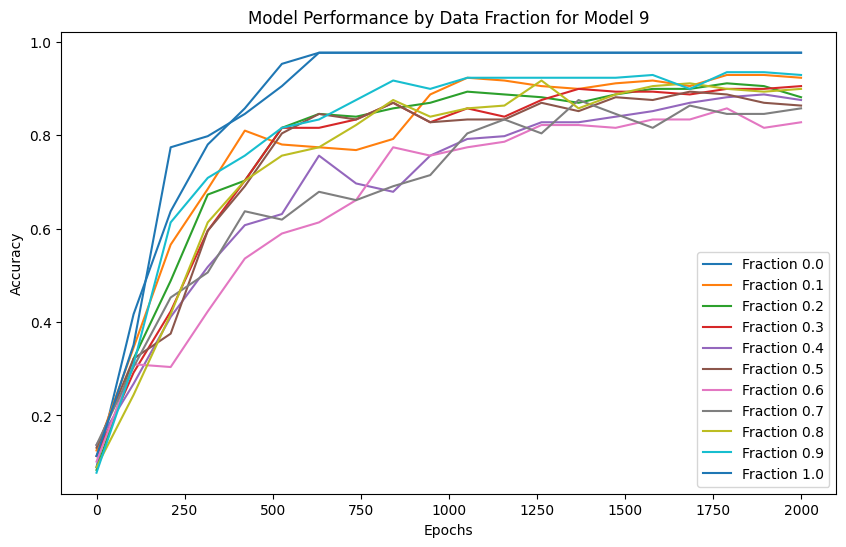

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2168
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.9287
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.4652
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.1203
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.8281
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.5681
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.4125
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.3154
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.2453
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1937
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1592
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1350
predi

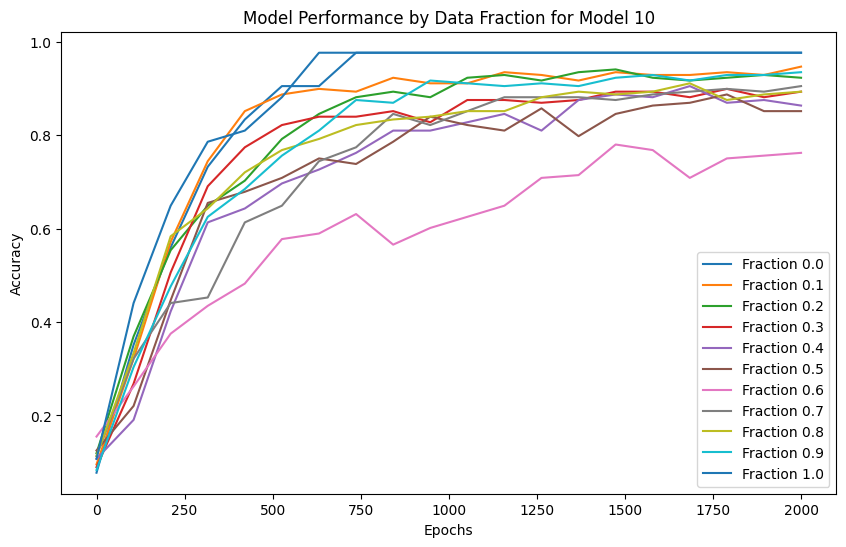

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2185
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9751
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.4025
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.0505
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.7958
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.5962
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.4428
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.3332
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.2537
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1997
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1386
predi

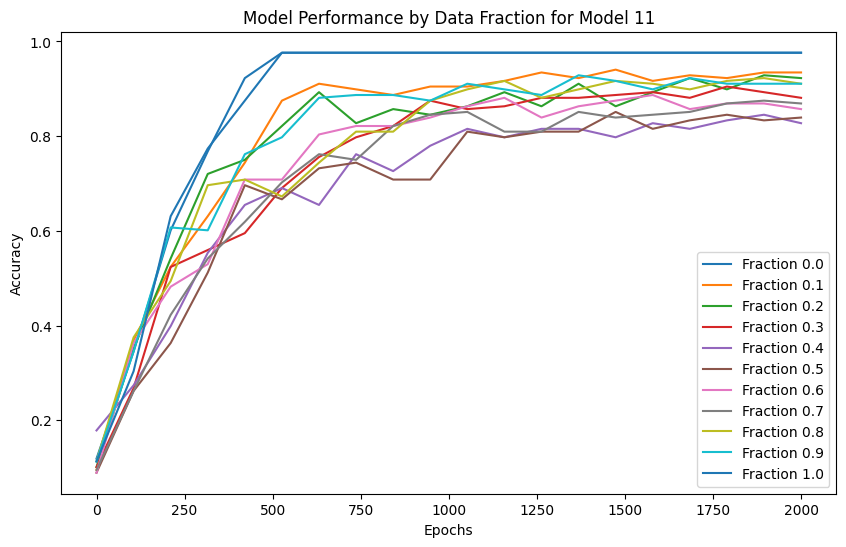

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2086
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.8753
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.5045
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 1.1912
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.8686
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5736
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.3742
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.2662
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.2050
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1670
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1419
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1244
predi

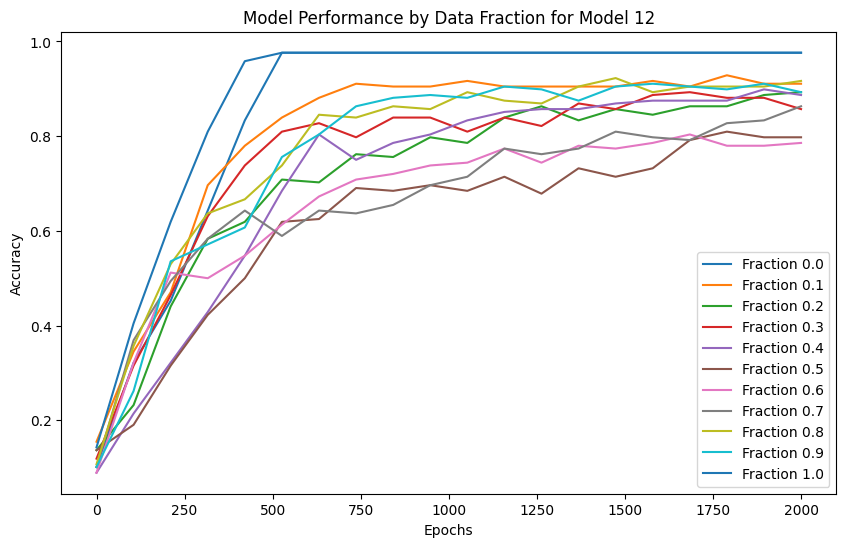

Model 13, Fraction 0.00, Epoch 1, Loss: 2.1913
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.8171
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.3370
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.9936
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.7727
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.6178
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4504
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.3234
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.2410
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.1891
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1557
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1334
predi

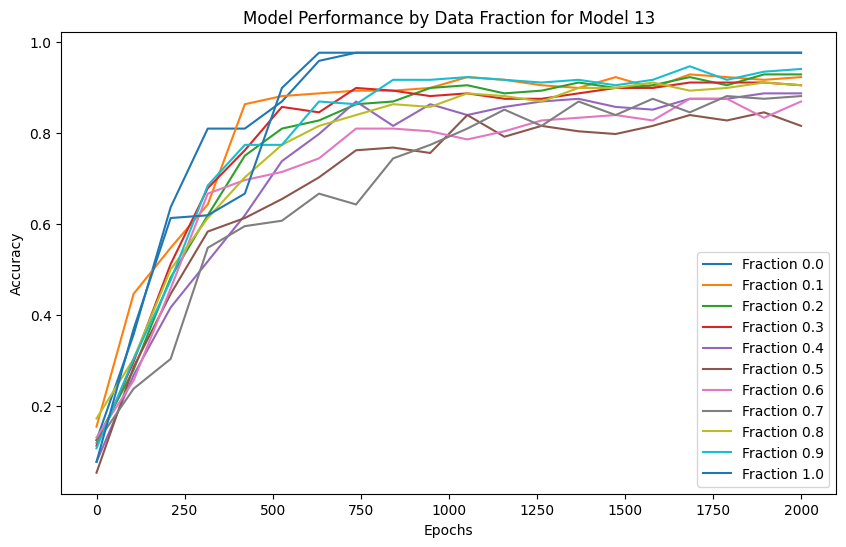

Model 14, Fraction 0.00, Epoch 1, Loss: 2.1917
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.8365
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.3394
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.0399
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.7703
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.5324
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.3791
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.2796
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.2132
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1708
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1438
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1256
predi

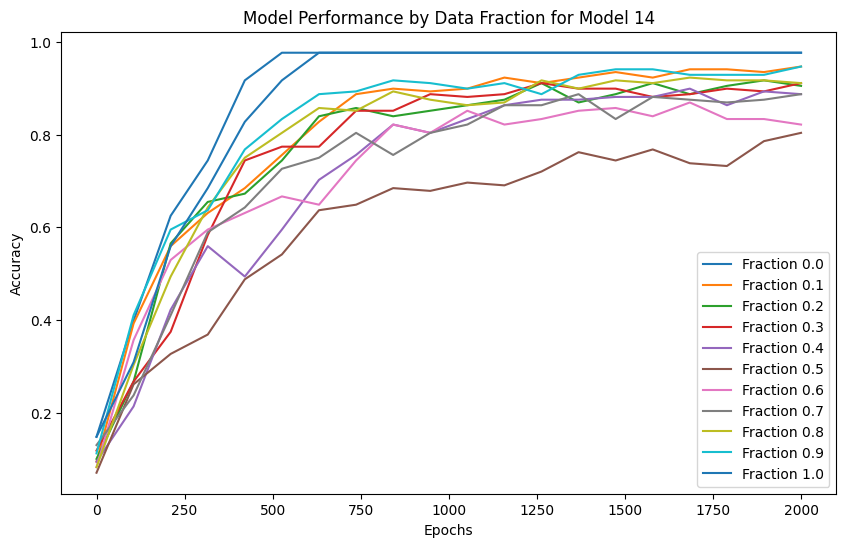

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2040
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.8966
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.3985
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.1026
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.8374
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.6215
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4656
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.3521
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.2681
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.2066
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1605
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1323
predi

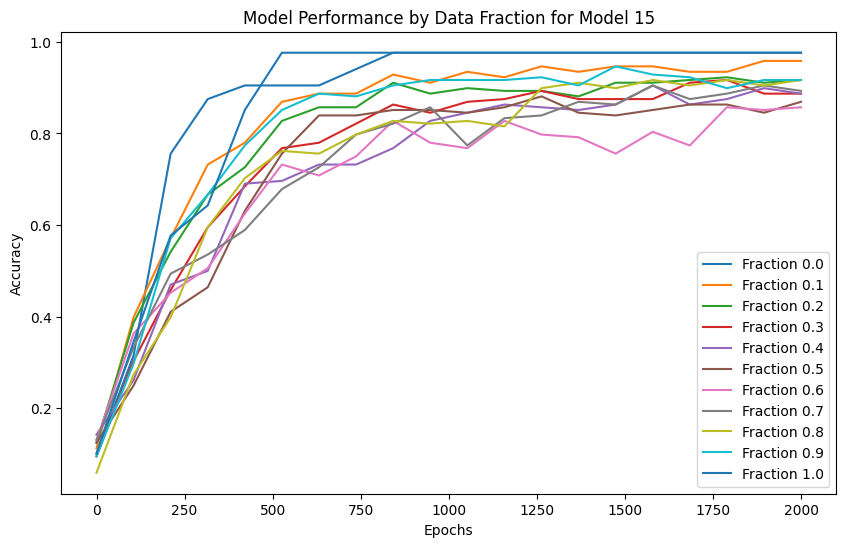

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2001
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.9171
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.3987
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.1253
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.8024
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5518
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.3683
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.2632
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.2018
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1625
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1372
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1198
predi

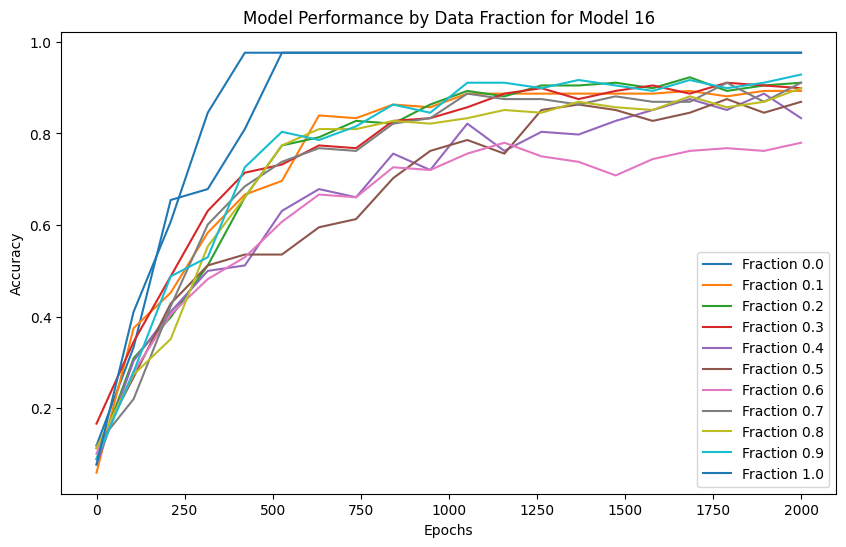

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2081
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.9824
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.3735
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.9543
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.6934
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.5002
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.3547
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.2636
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.2079
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1465
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1289
predi

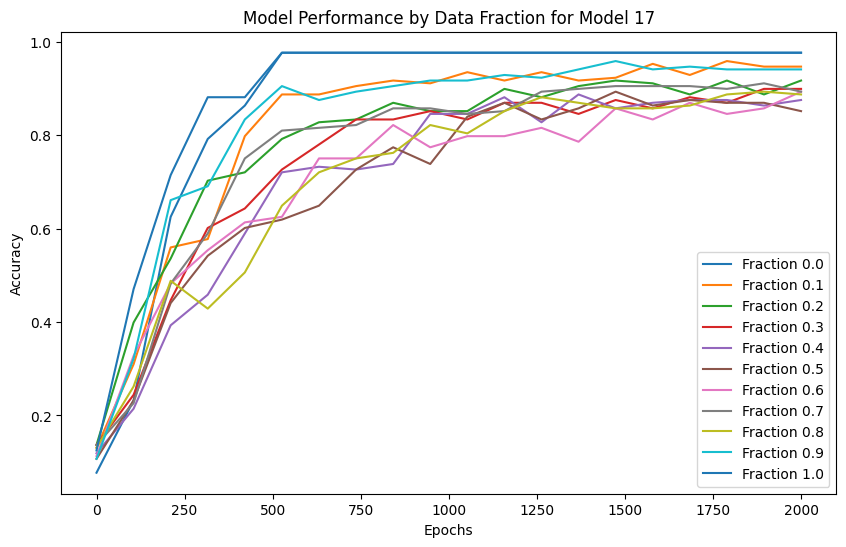

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2006
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.8832
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.3367
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.9815
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.7481
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5955
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4523
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.3211
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.2384
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1869
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1542
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1324
predi

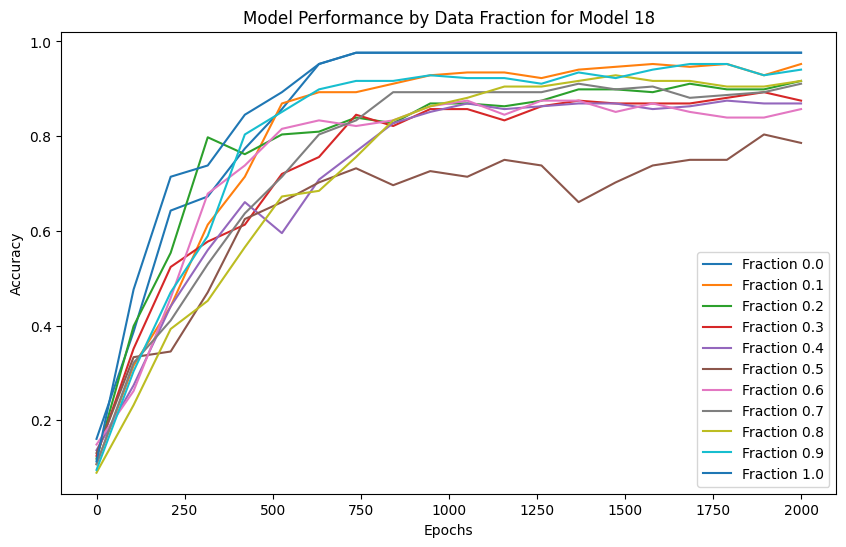

Model 19, Fraction 0.00, Epoch 1, Loss: 2.1994
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9353
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.3731
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 1.0694
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.8407
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.6726
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.5167
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.3632
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.2522
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1792
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1428
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1220
predi

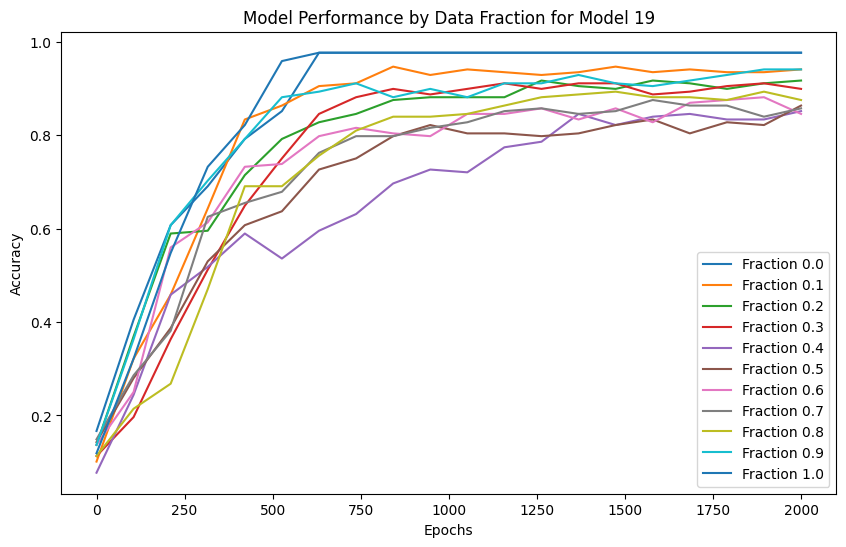

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2148
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9161
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.4214
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.0952
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.7668
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5564
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4032
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.2917
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.2214
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.1787
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.1506
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1311
predi

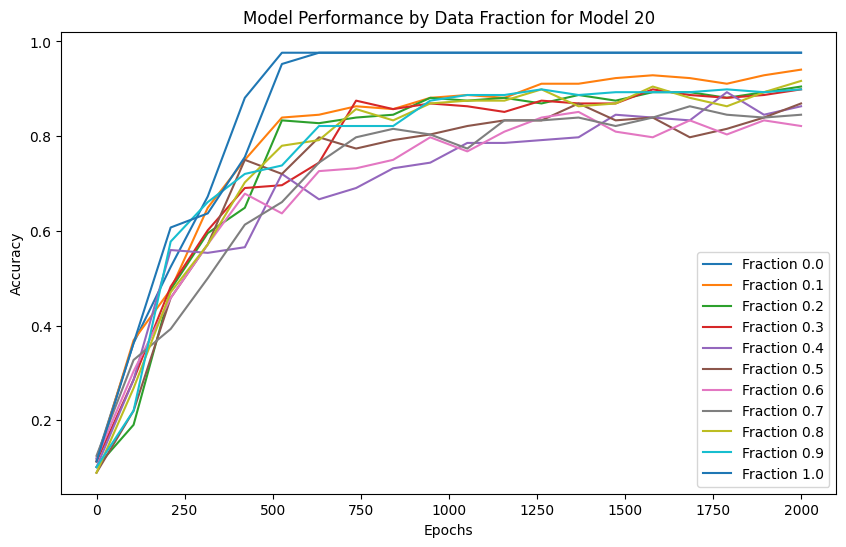

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2050
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.8802
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.3096
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.9317
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6934
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5475
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.3938
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.2834
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.2183
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1771
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1496
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1304
predi

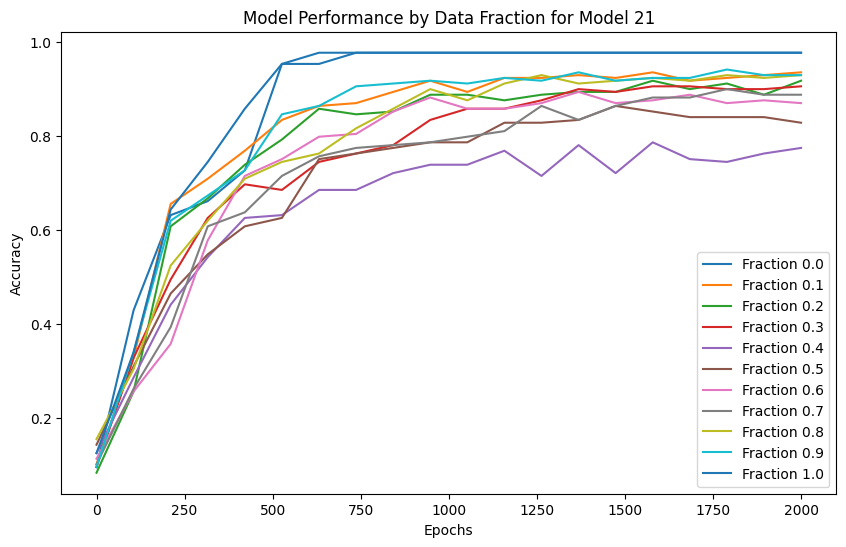

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2072
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.9946
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.3930
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.0060
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.7096
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.4694
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.3363
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.2551
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.2020
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1661
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1413
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1239
predi

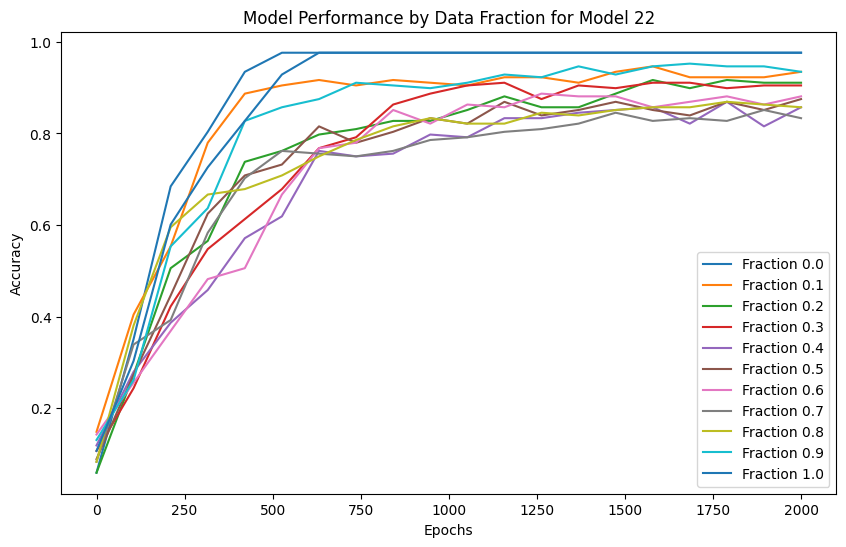

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2019
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9152
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.4162
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.0462
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.7742
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5692
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4211
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.3105
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.2344
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1865
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1558
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1350
predi

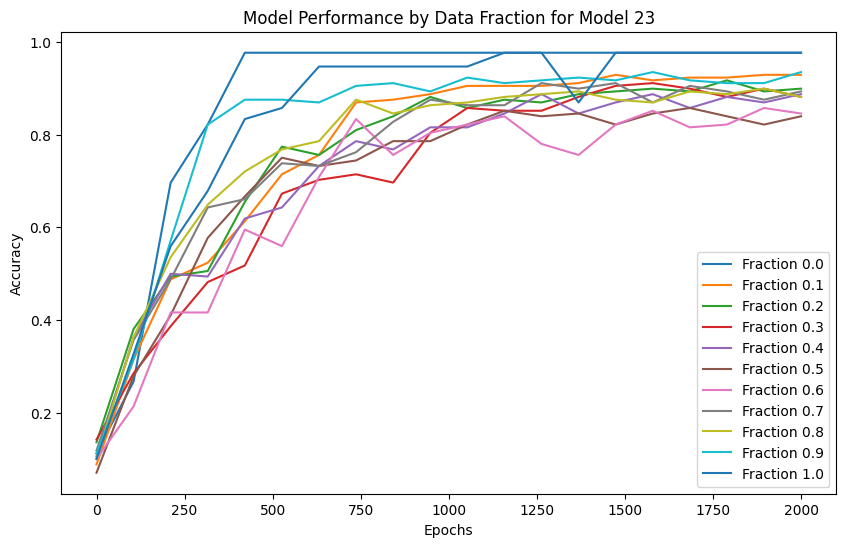

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2132
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.9138
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.3639
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.0346
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.7903
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.6139
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4691
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.3546
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.2543
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1867
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1506
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1286
predi

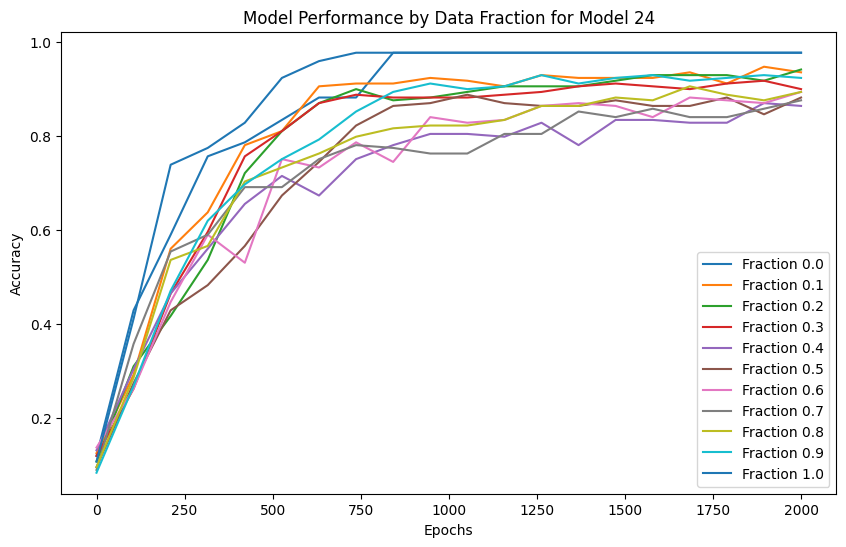

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2052
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.8737
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.3970
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.1211
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.9243
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.7096
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.5311
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.4135
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.3245
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.2600
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.2131
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1774
predi

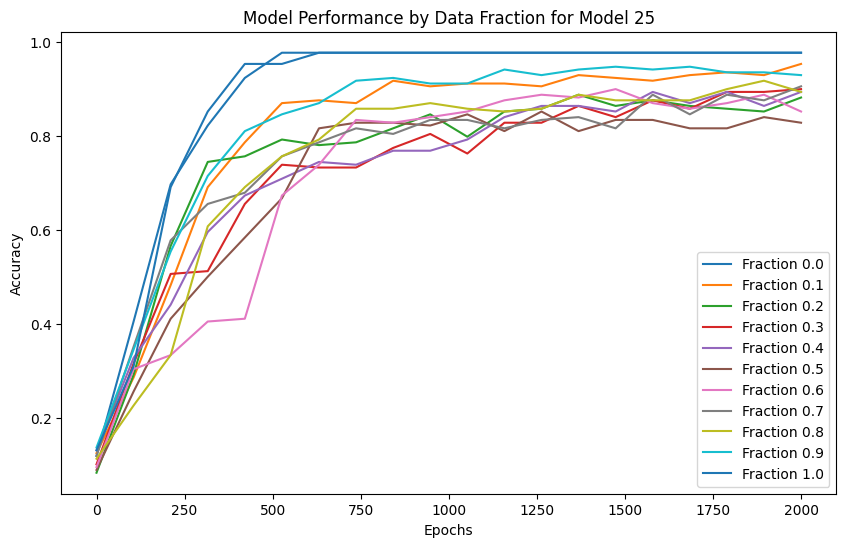

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2055
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.8755
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.4153
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 1.0825
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.8497
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.6657
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.4706
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.3071
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.2267
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1811
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1517
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1314
predi

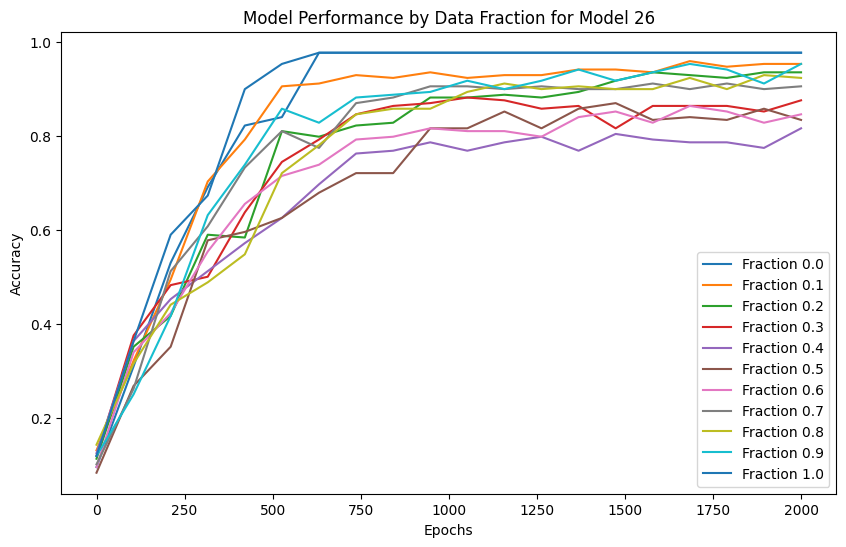

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2151
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.9202
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.3643
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.0643
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.7954
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.5717
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4062
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.2920
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.2236
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1798
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1512
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1312
predi

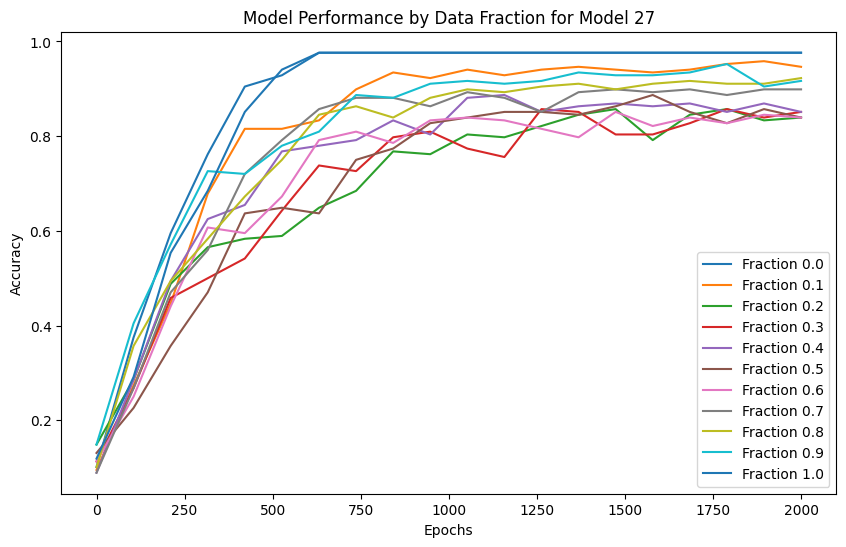

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2046
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.8854
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.4489
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.1544
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.9383
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.7260
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.5186
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.3530
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.2360
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1796
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1485
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1284
predi

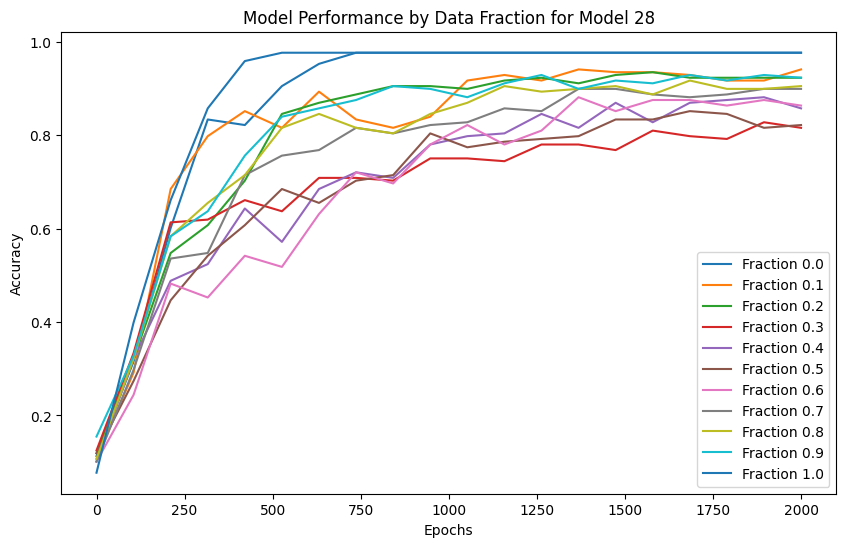

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.9958
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.3441
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.9760
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.7120
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.5637
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.4626
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.3449
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.2670
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.2143
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1767
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1496
predi

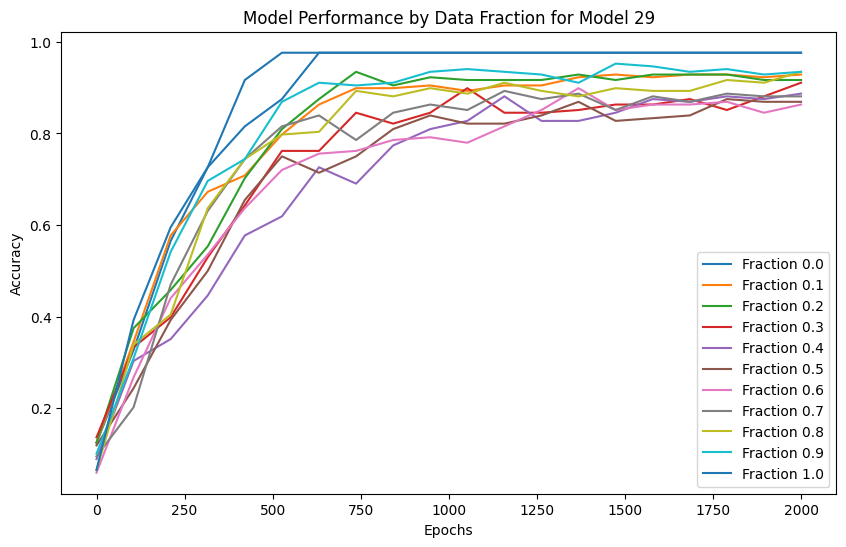

In [29]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
    #"ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [33]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0155
  Fraction 0.10, Average Accuracy: 0.5381
  Fraction 0.20, Average Accuracy: 0.6446
  Fraction 0.30, Average Accuracy: 0.7012
  Fraction 0.40, Average Accuracy: 0.7292
  Fraction 0.50, Average Accuracy: 0.8415
  Fraction 0.60, Average Accuracy: 0.9141
  Fraction 0.70, Average Accuracy: 0.9589
  Fraction 0.80, Average Accuracy: 0.9724
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9756
  Fraction 0.20, Average Accuracy: 0.9752
  Fraction 0.30, Average Accuracy: 0.9714
  Fraction 0.40, Average Accuracy: 0.9444
  Fraction 0.50, Average Accuracy: 0.8472
  Fraction 0.60, Average Accuracy: 0.7579
  Fraction 0.70, Average Accuracy: 0.7097
  Fraction 0.80, Average Accuracy: 0.6683
  Fraction 0.90, Average Accuracy: 0.6000
  Fraction 1.00, Average Accuracy: 0.0147


#### plot of transformer

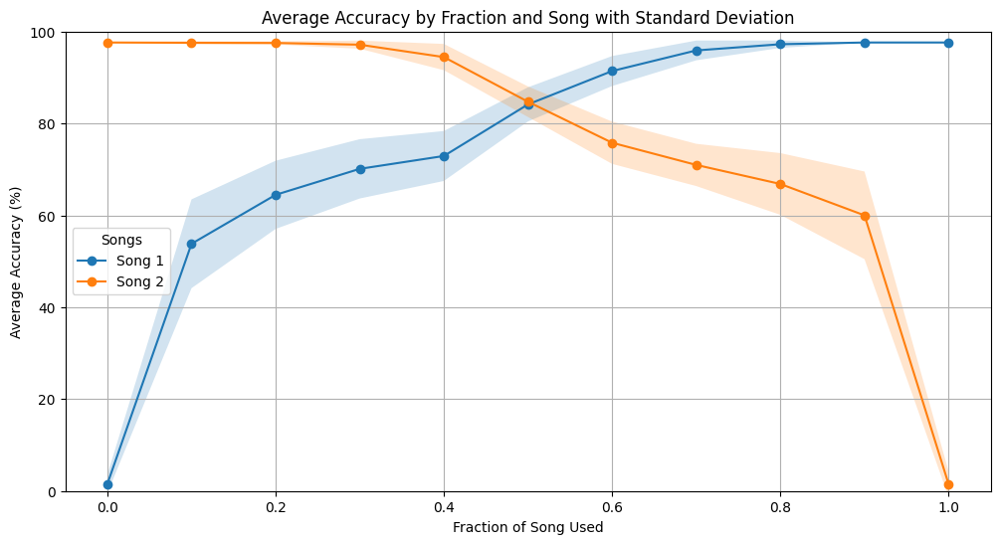

In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot of Decision tree

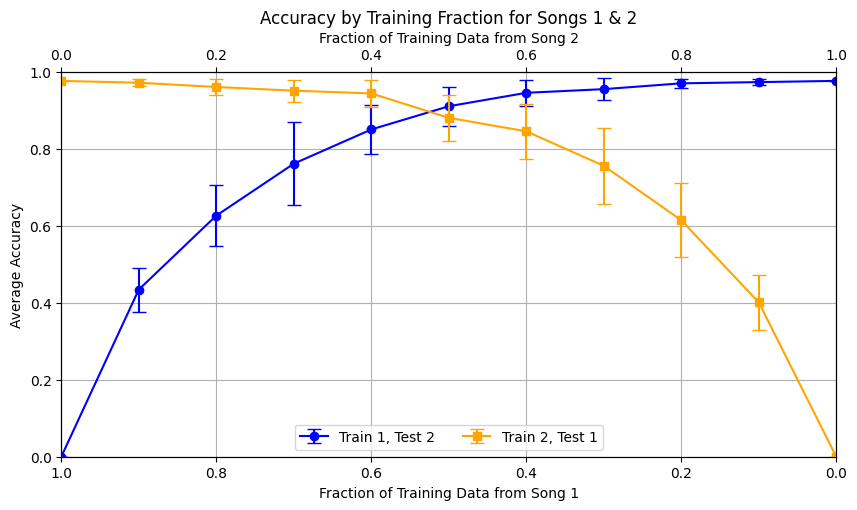

In [30]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 2), (2, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combines plot

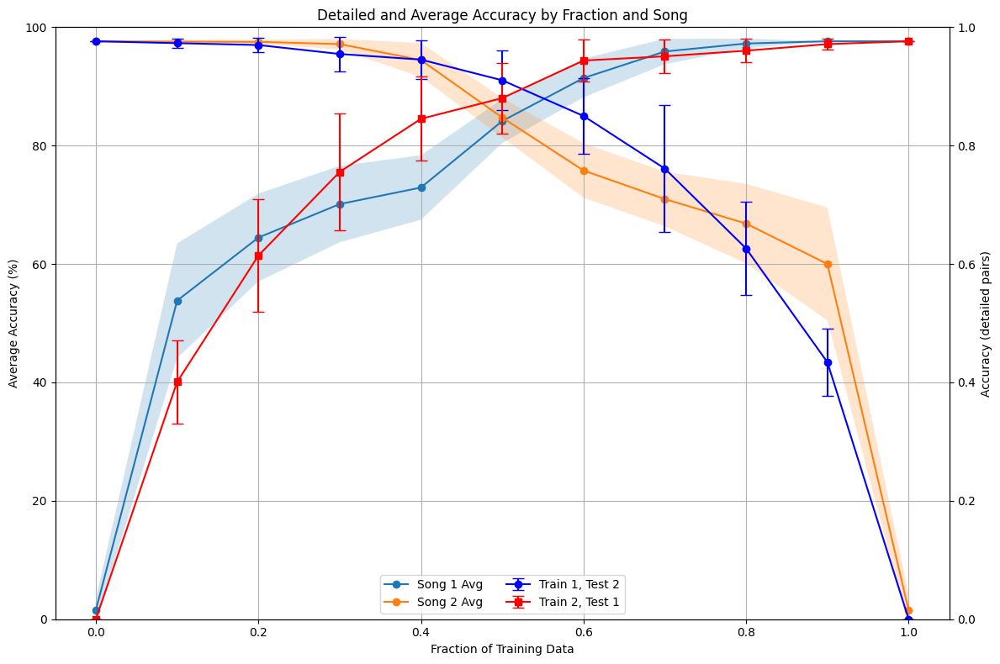

In [88]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


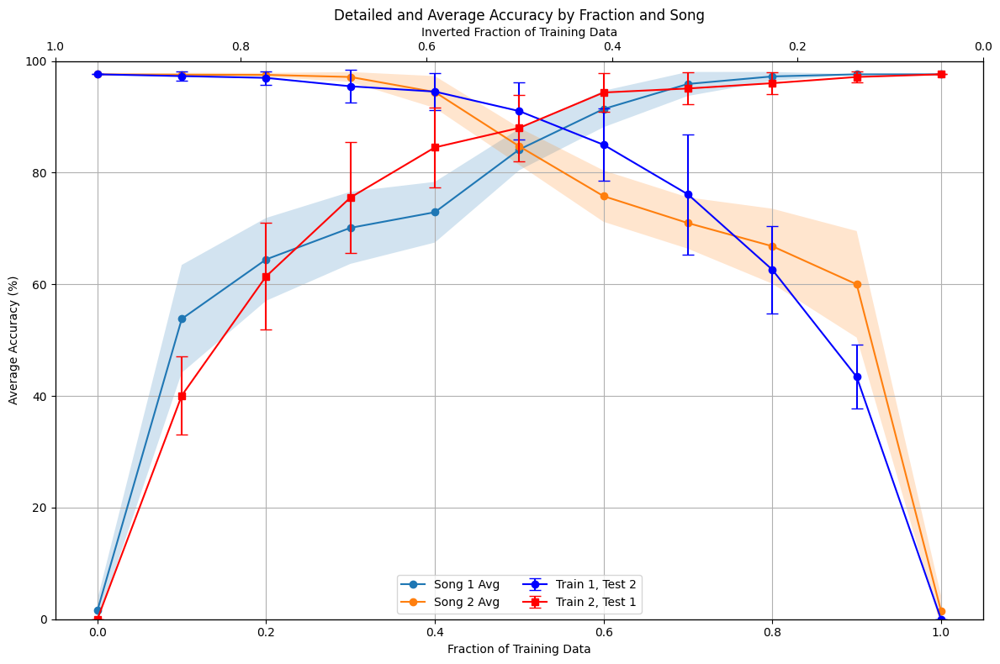

In [74]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Set up the figure and primary axis
# fig, ax1 = plt.subplots(figsize=(12, 8))

# # Plot the overall average accuracies in the primary axis
# average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
# std_dev_accuracies = accuracies.std(axis=2) * 100

# for song_idx, song in enumerate(songStrings):
#     x_values = fractions
#     y_values = average_accuracies[:, song_idx]
#     y_err = std_dev_accuracies[:, song_idx]
#     ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
#     ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# # Configure primary axis
# ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
# ax1.set_xlabel('Fraction of Training Data')
# ax1.set_ylabel('Average Accuracy (%)')
# ax1.set_ylim(0, 100)
# ax1.grid(True)

# # Initialize the secondary axis on the same x-axis but different y-scale
# ax2 = ax1.twinx()

# # Plotting detailed pair data on the secondary axis
# desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
# for pair, data in plot_data.items():
#     if pair in desired_pairs:
#         for order_label, (fractions, means, std_devs) in data.items():
#             sorted_data = sorted(zip(fractions, means, std_devs))
#             fractions, means, std_devs = zip(*sorted_data)

#             if "Train " + str(pair[0]) in order_label:
#                 ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
#             else:
#                 mirrored_fractions = [1 - f for f in fractions]
#                 ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# # Configure secondary axis
# ax2.set_ylabel('Accuracy (detailed pairs)')
# ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# # Hide the secondary y-axis labels and ticks
# ax2.yaxis.set_visible(False)

# # Configure secondary x-axis as before
# ax3 = ax1.twiny()
# ax3.set_xlabel('Inverted Fraction of Training Data')
# ax3.set_xlim(1, 0)  # Set limits to invert the secondary x-axis

# # Combine legends from both axes
# lines, labels = ax1.get_legend_handles_labels()
# lines2, labels2 = ax2.get_legend_handles_labels()
# lines3, labels3 = ax3.get_legend_handles_labels()
# ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

# plt.tight_layout()
# plt.show()


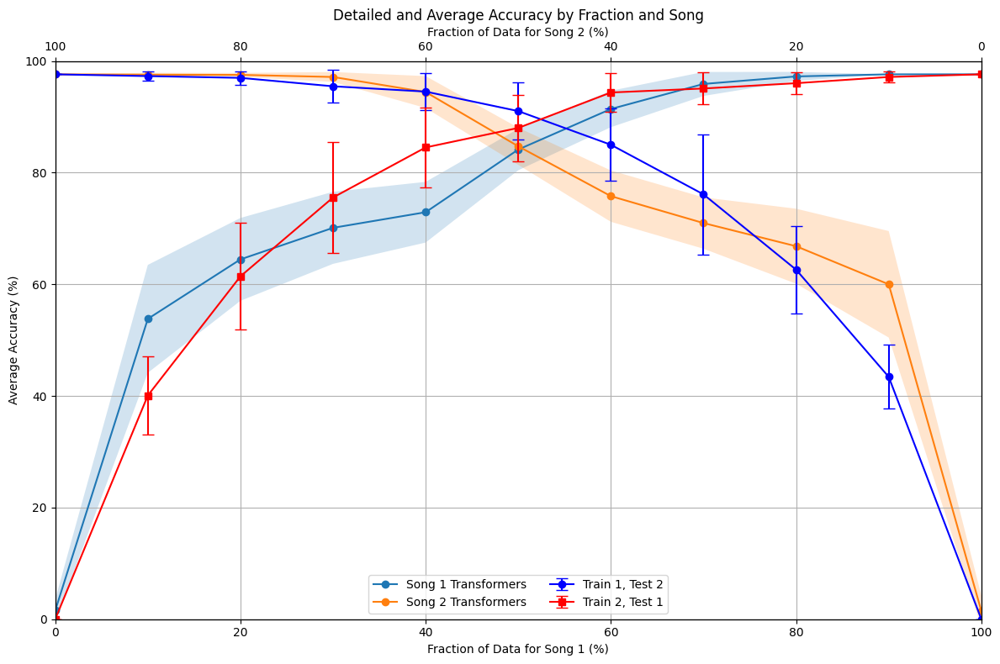

In [89]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Data for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Data for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


### Normal and reverse songs - 16,16,4 - L

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2312
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 0.6259
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.1909
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.1133
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.0889
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.0781
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.0724
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0690
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0668
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0653
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0642
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0634
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0628
prediction sha

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.10, Epoch 1, Loss: 2.2192
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 101, Loss: 0.7647
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 201, Loss: 0.2872
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 301, Loss: 0.2064
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 401, Loss: 0.1741
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 501, Loss: 0.1497
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 601, Loss: 0.1552
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 701, Loss: 0.1335
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 801, Loss: 0.1448
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 901, Loss: 0.1380
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1001, Loss: 0.1538
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1101, Loss: 0.1315
prediction shape 

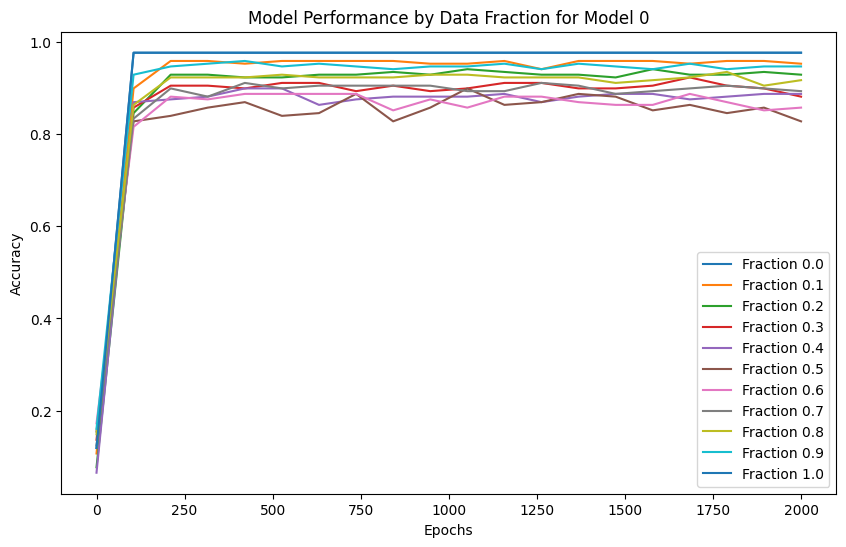

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1857
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 0.5732
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.1950
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.1169
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.0910
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.0733
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0696
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0672
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0656
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0644
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0636
prediction shape 

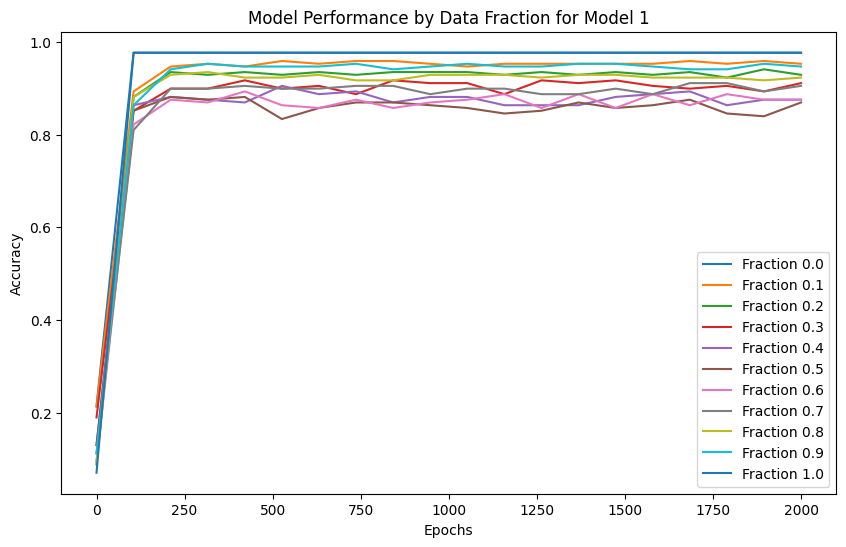

Model 2, Fraction 0.00, Epoch 1, Loss: 2.1956
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 0.6041
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.1971
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.1170
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.0914
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.0800
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0701
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0677
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0660
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0648
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0639
prediction shape 

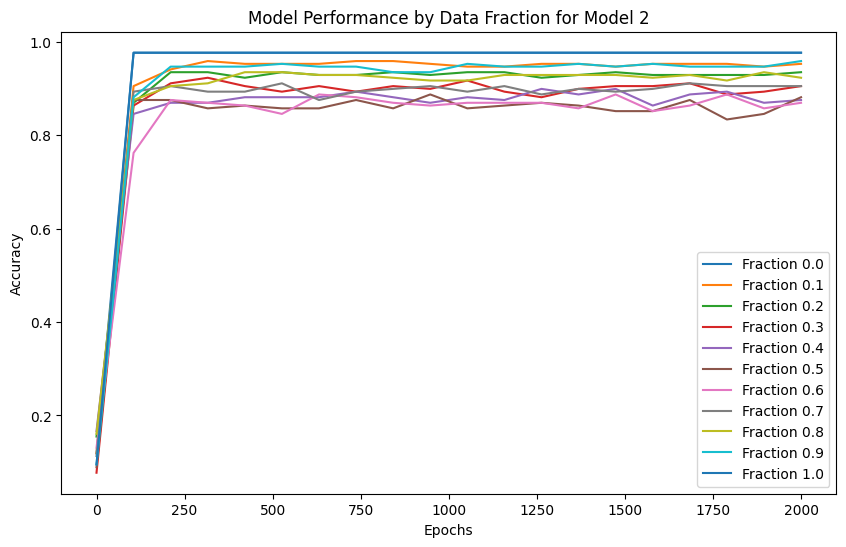

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2463
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 0.6213
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.2019
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.1181
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.0916
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.0737
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0699
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0675
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0659
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0638
prediction shape 

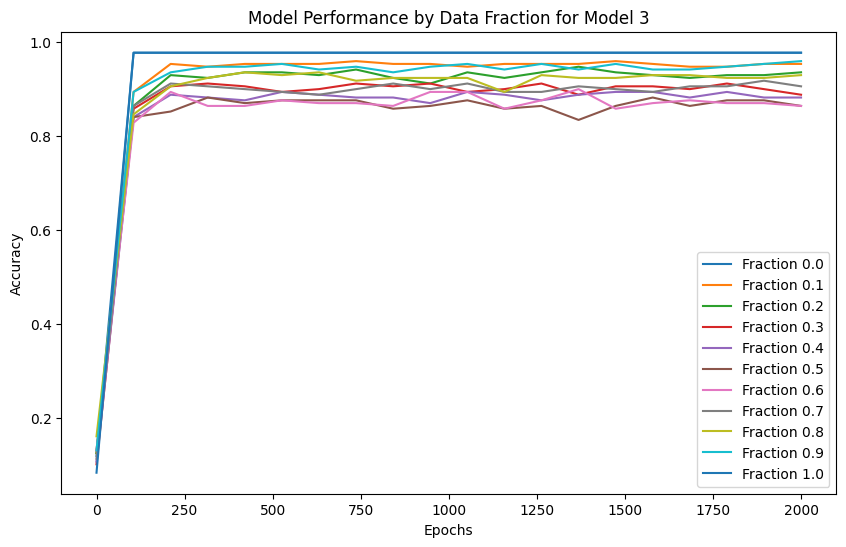

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2456
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 0.6489
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.1889
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.1127
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.0887
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.0781
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.0725
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0690
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0668
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0653
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0642
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0634
prediction shape 

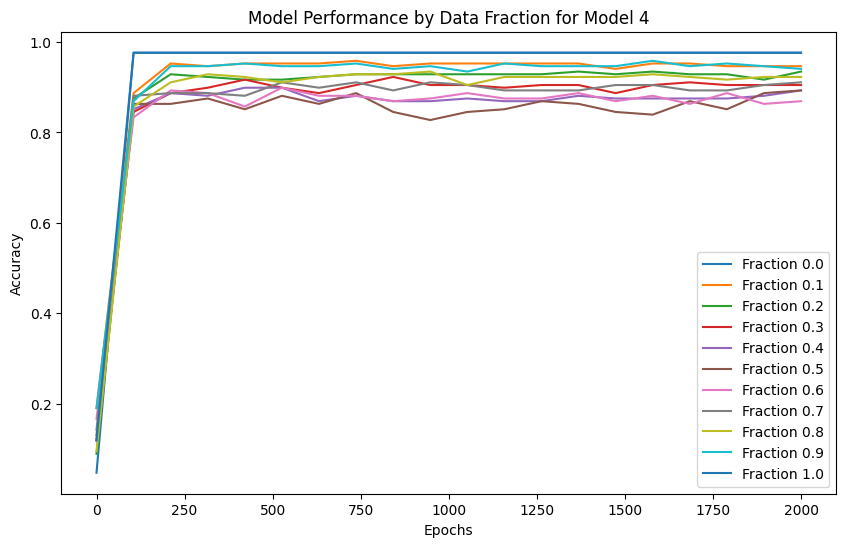

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2361
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 0.6178
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.1845
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.1112
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.0881
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.0722
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0689
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0668
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0653
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0642
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0634
prediction shape 

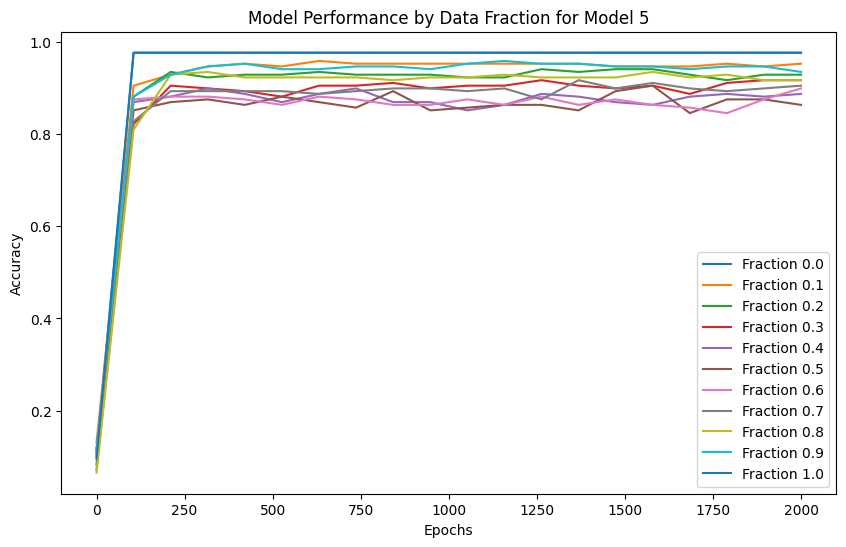

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2149
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 0.5497
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.1932
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.1177
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.0920
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.0803
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.0740
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0701
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0677
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0660
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0638
prediction shape 

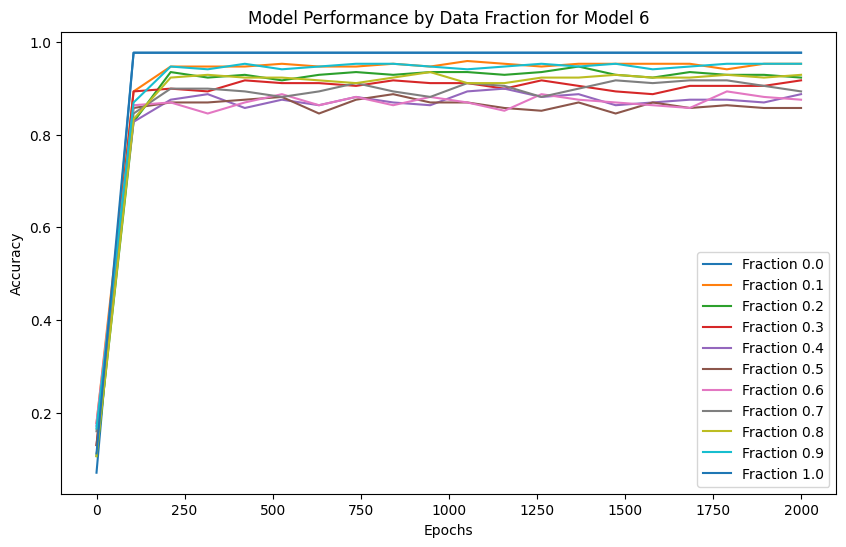

Model 7, Fraction 0.00, Epoch 1, Loss: 2.1869
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 0.5752
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.1841
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.1115
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.0880
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0687
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0665
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0651
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0640
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0632
prediction shape 

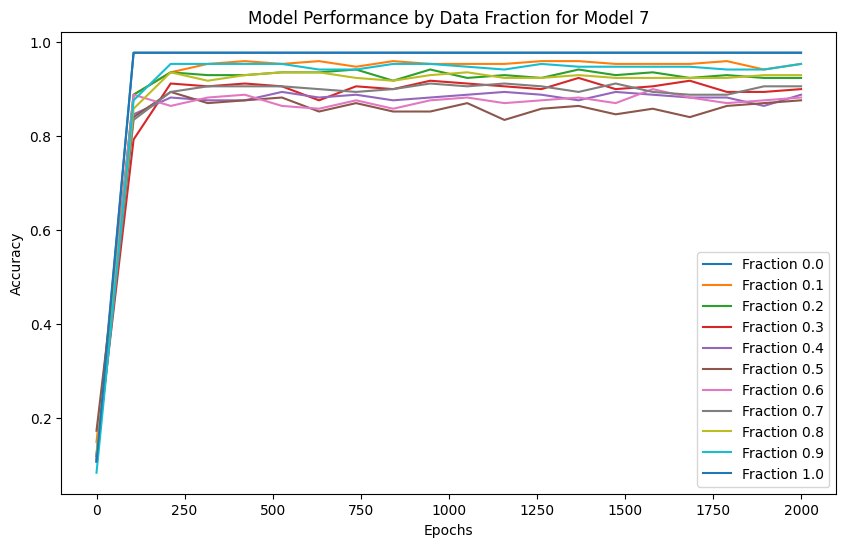

Model 8, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 0.5729
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.1988
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.1197
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.0929
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.0808
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.0743
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0703
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0678
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0661
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0648
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0639
prediction shape 

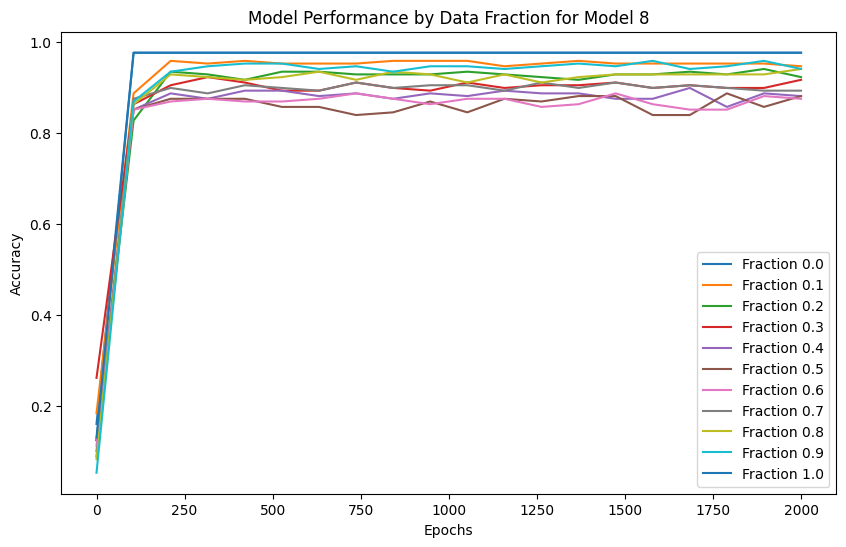

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2182
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 0.5929
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.1962
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.1159
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.0901
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.0728
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0692
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0669
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0642
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0634
prediction shape 

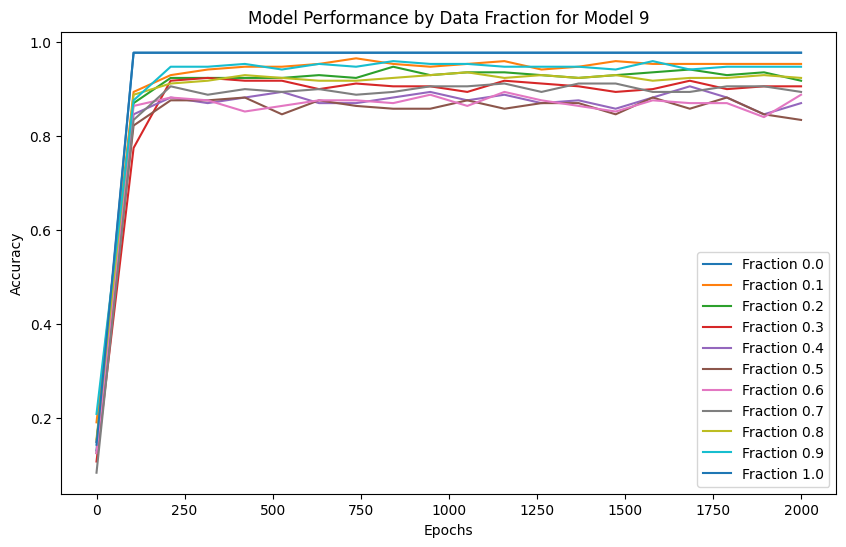

Model 10, Fraction 0.00, Epoch 1, Loss: 2.1999
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 0.6074
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.2048
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.1211
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.0937
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.0813
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.0747
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0707
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0681
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0663
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0650
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0641
predi

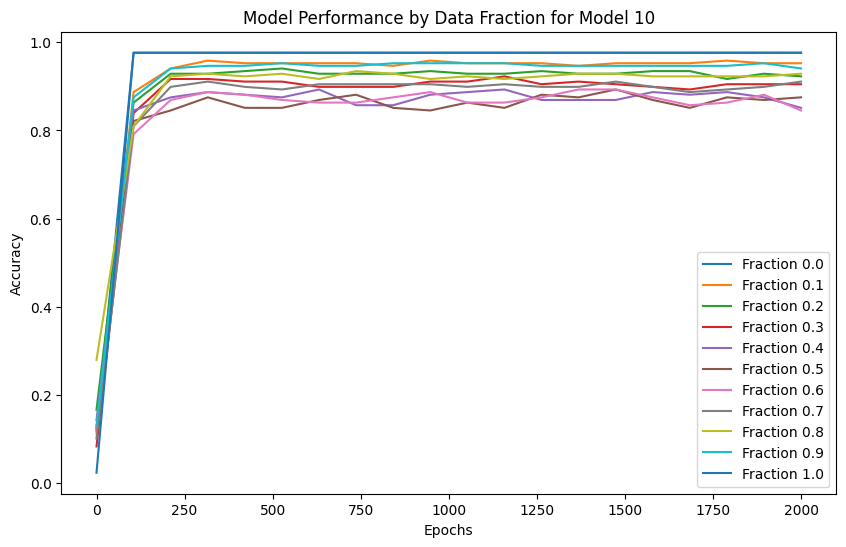

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2450
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 0.6546
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.2010
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.1176
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.0914
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.0736
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0699
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0675
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0658
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0646
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0637
predi

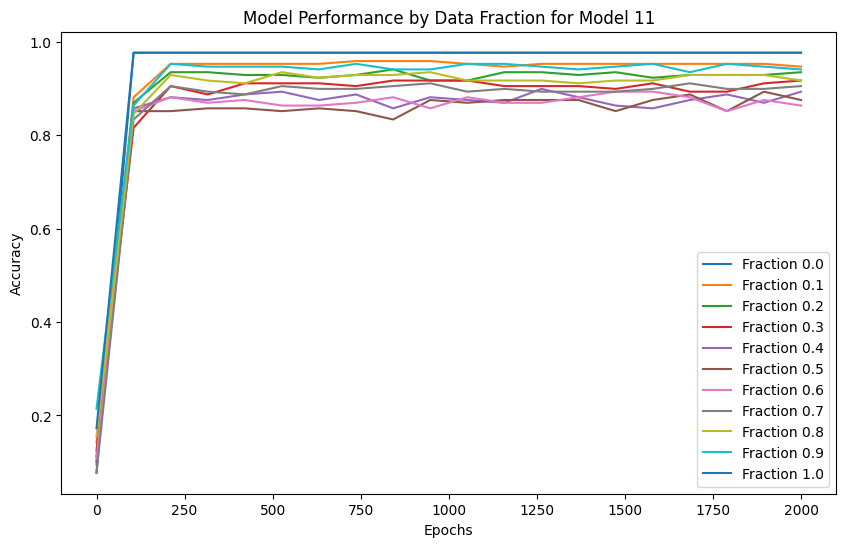

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2314
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 0.5993
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.2008
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.1193
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.0924
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.0803
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0701
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0676
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0659
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0638
predi

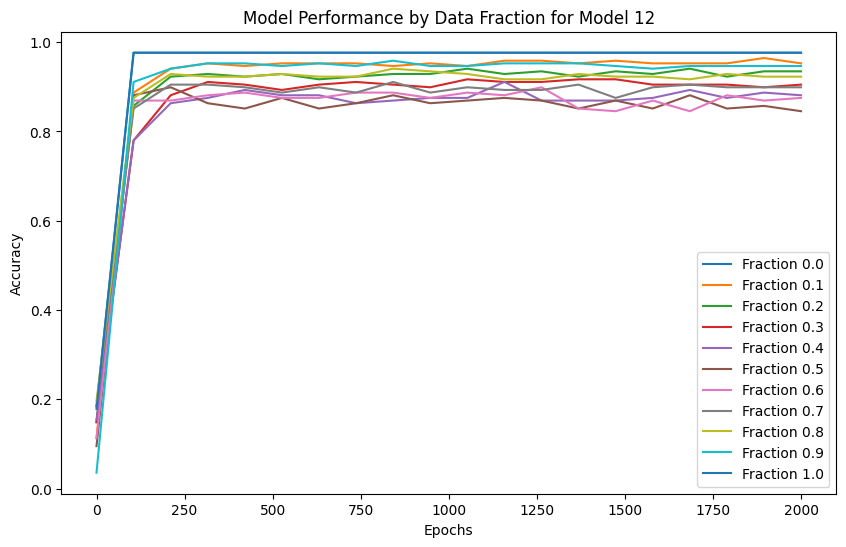

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2074
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 0.6337
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.1950
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.1154
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.0902
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.0731
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0695
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0672
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0656
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0645
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0636
predi

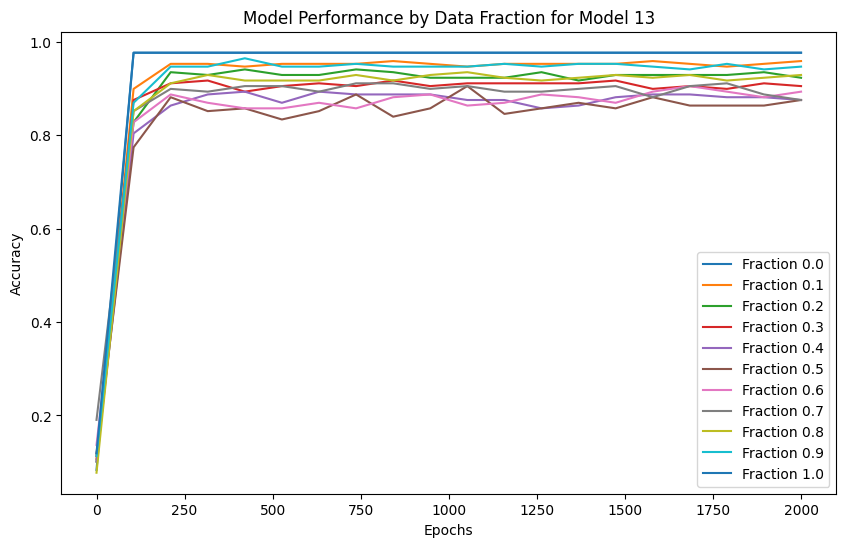

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2237
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 0.5898
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.1883
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.1125
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.0884
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.0722
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0688
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0666
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0641
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0633
predi

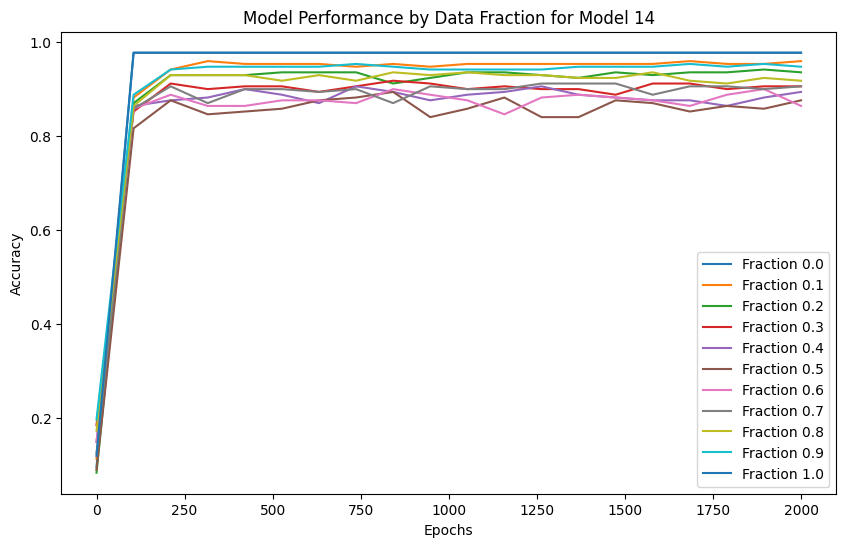

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2164
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 0.6198
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.2027
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.1186
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.0917
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.0735
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0698
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0674
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0657
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0646
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0637
predi

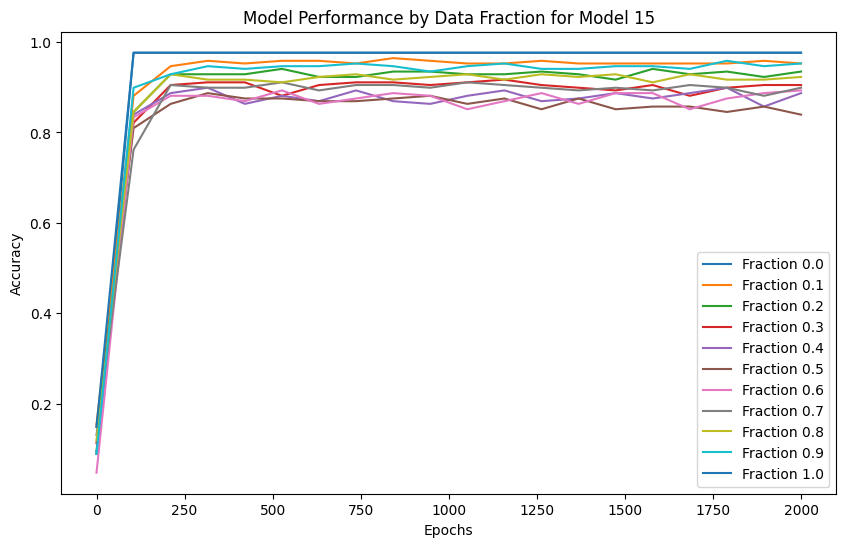

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2315
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 0.5603
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.1864
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.1136
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.0895
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.0787
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.0728
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0693
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0670
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0655
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0643
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0635
predi

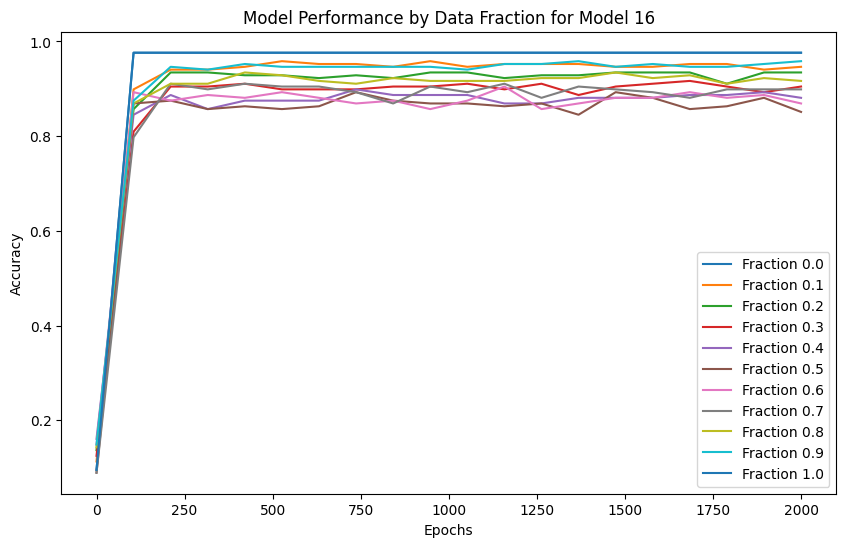

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2275
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 0.6496
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.2007
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.1173
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.0911
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.0796
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.0734
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0698
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0674
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0657
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0646
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0637
predi

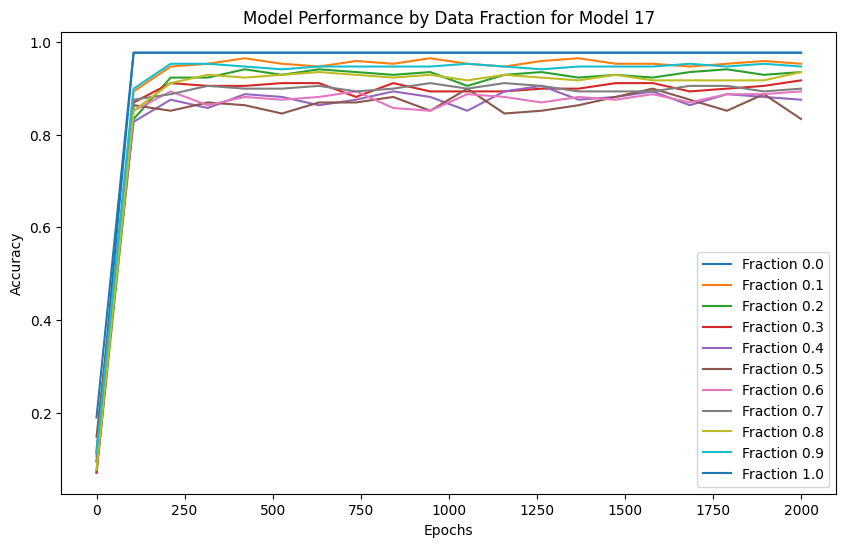

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2381
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 0.6328
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.2011
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.1172
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.0907
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.0790
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0693
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0670
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0643
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0634
predi

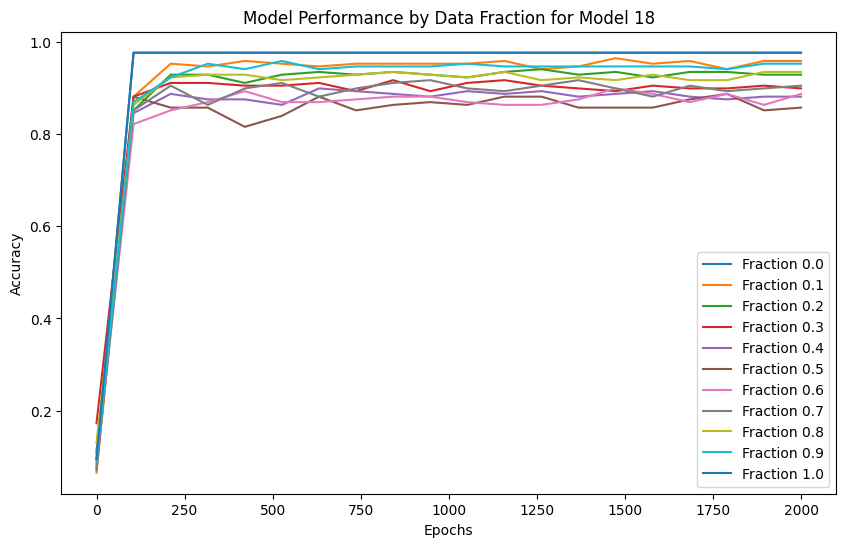

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 0.6189
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.2088
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.1223
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.0813
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.0745
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0706
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0679
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0662
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0649
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0639
predi

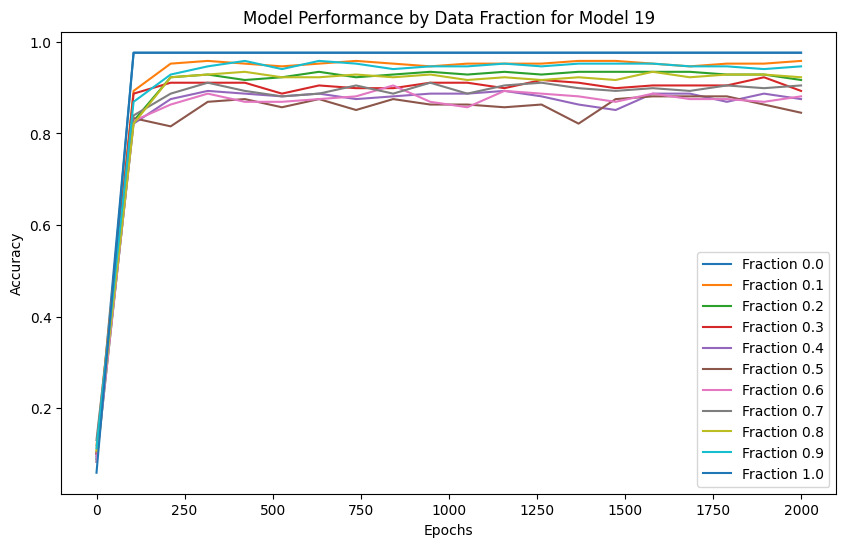

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1873
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 0.5465
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.1976
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.1196
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.0804
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0700
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0675
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0658
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0646
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0637
predi

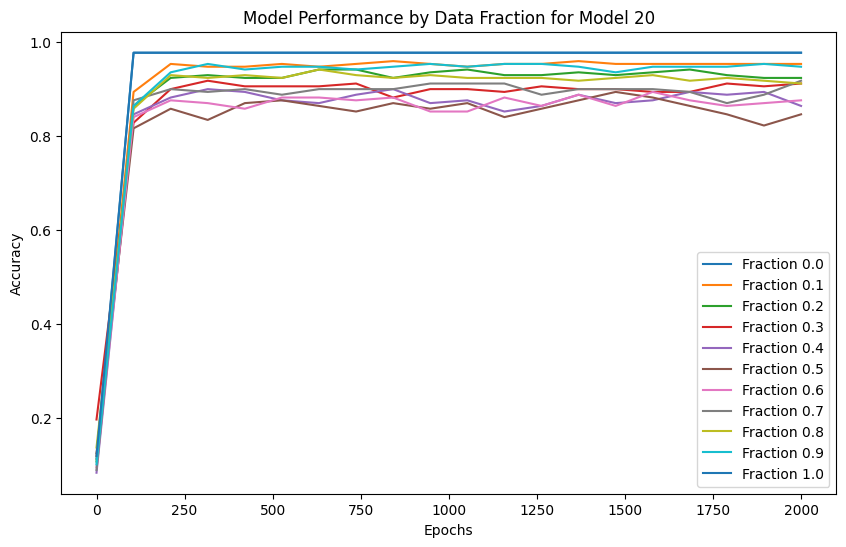

Model 21, Fraction 0.00, Epoch 1, Loss: 2.1680
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 0.5897
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.2021
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.1197
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.0805
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.0740
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0702
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0677
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0660
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0638
predi

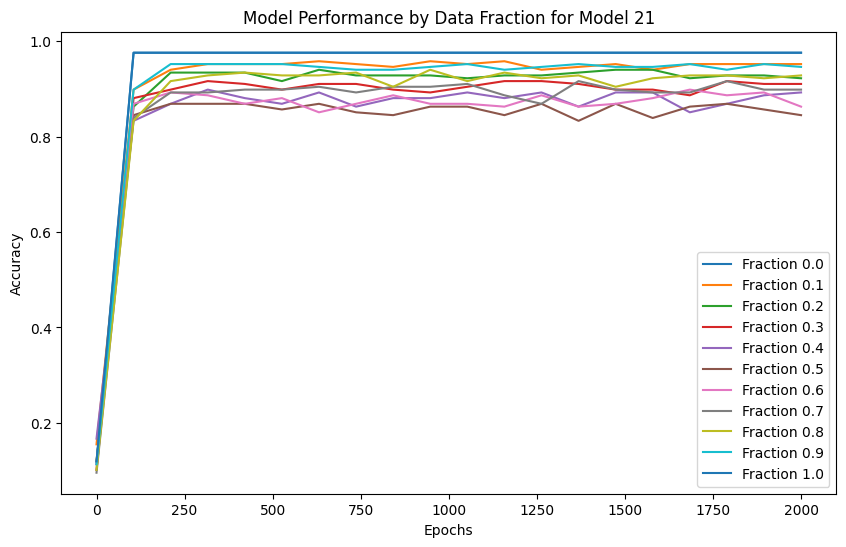

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2549
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 0.6691
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.2148
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.1238
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.0946
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.0817
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.0748
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0707
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0681
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0663
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0650
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0640
predi

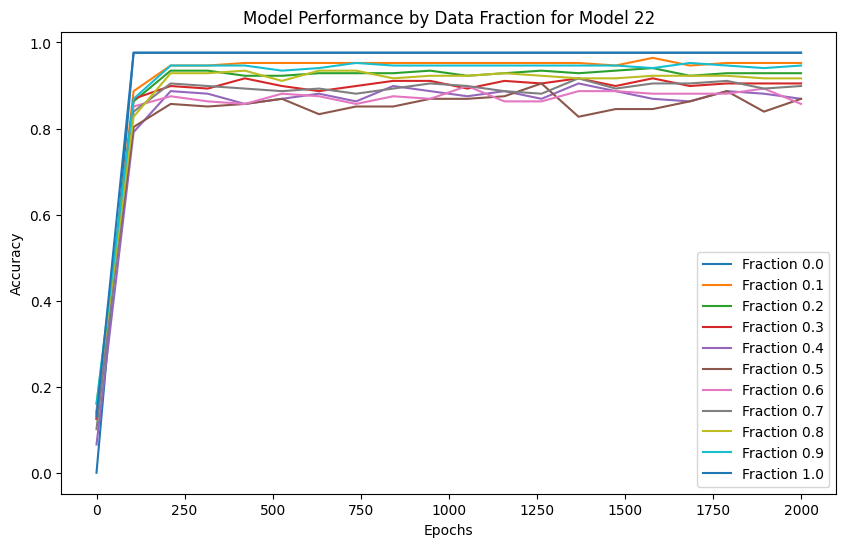

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2280
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 0.6864
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.2045
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.1170
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.0903
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.0728
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0692
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0669
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0642
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0634
predi

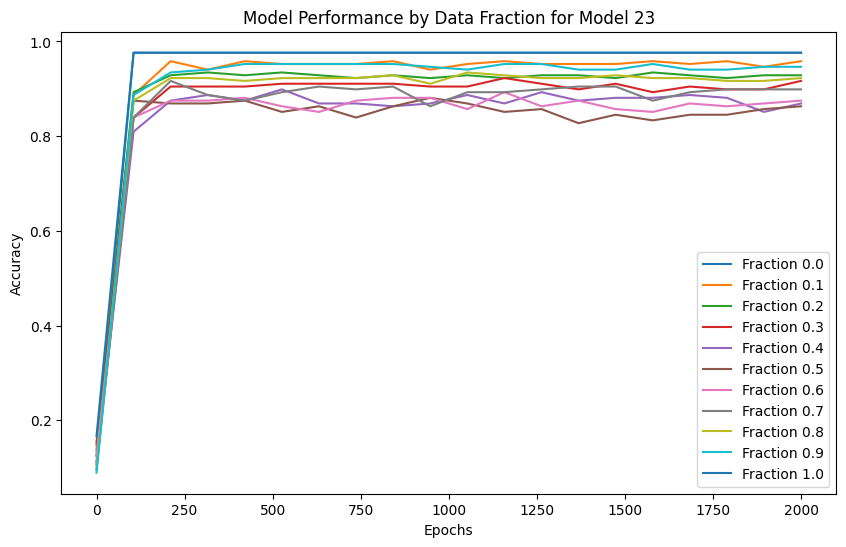

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2564
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 0.6258
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.2027
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.1197
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.0805
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.0740
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0706
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0676
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0659
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0638
predi

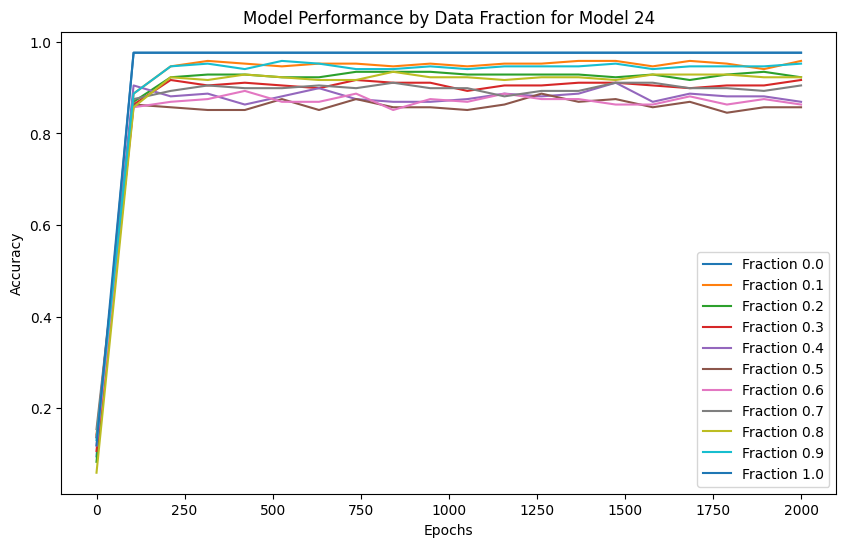

Model 25, Fraction 0.00, Epoch 1, Loss: 2.1935
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 0.6185
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.2021
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.1185
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.0919
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.0801
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0700
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0676
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0659
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0638
predi

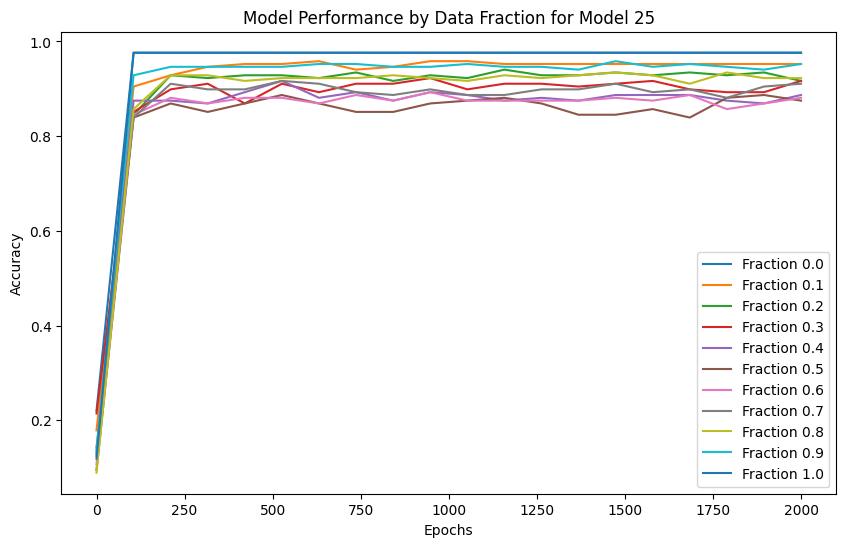

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2479
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 0.6745
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.2050
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.1190
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.0920
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.0801
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0700
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0676
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0659
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0638
predi

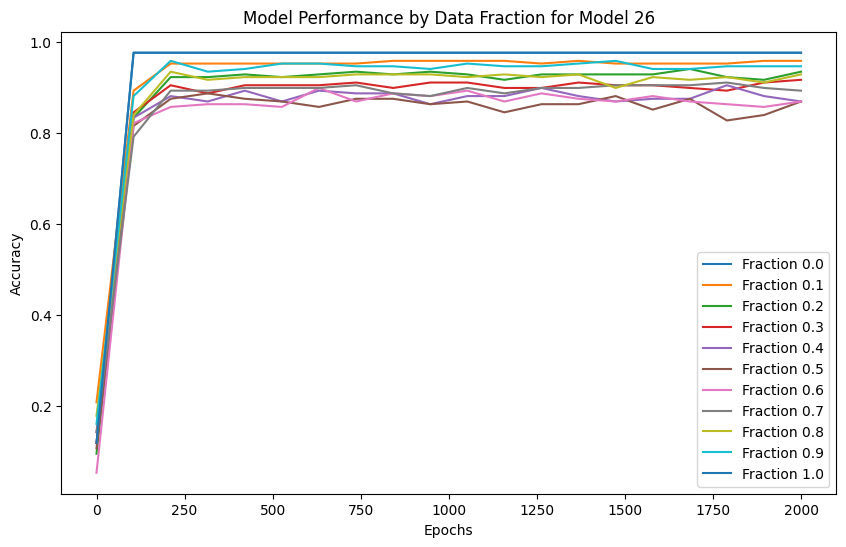

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2481
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 0.6433
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.2170
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.1259
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.0959
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.0825
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.0754
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0711
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0683
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0664
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0651
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0641
predi

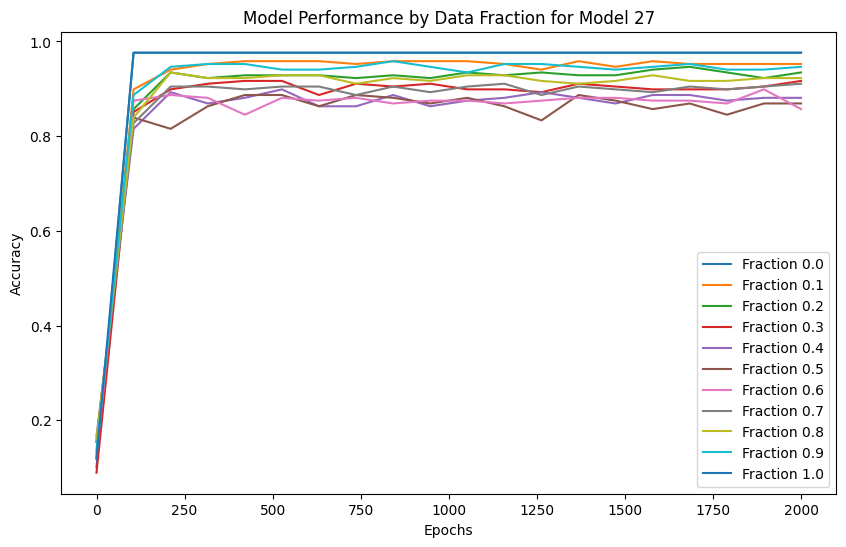

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2229
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 0.6102
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.1978
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.1166
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.0733
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0697
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0673
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0657
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0645
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0636
predi

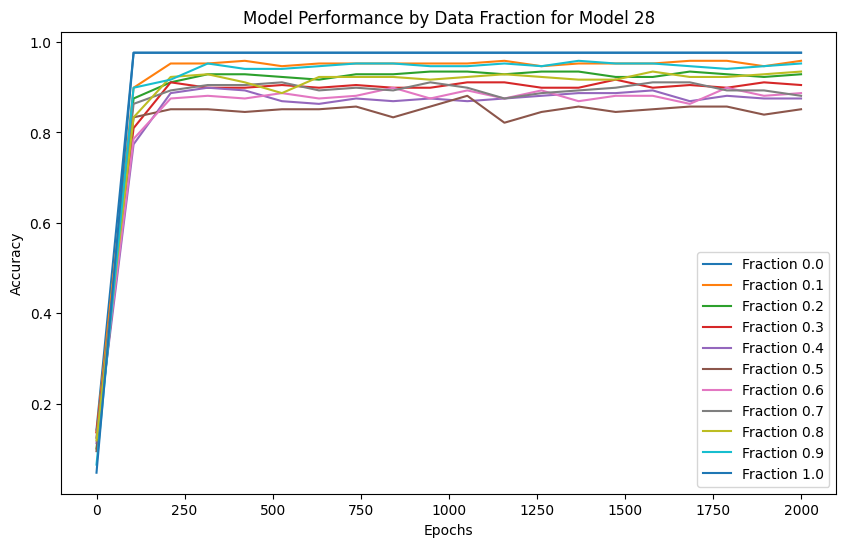

Model 29, Fraction 0.00, Epoch 1, Loss: 2.1944
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 0.6009
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.2026
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.1186
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.0917
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.0736
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0699
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0674
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0658
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0646
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0637
predi

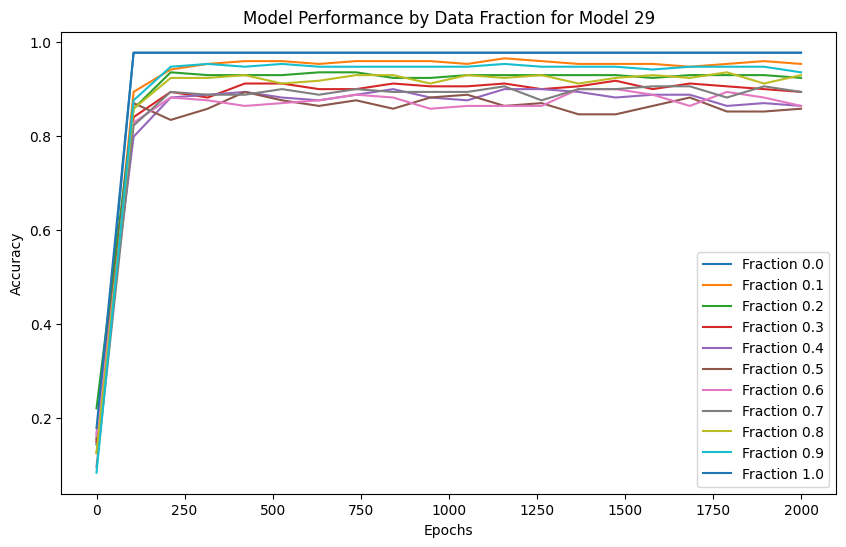

In [7]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 16
nhead = 2
d_hid = 16
nlayers = 4
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
    #"ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse_higher_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [96]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 16
nhead = 2
d_hid = 16
nlayers = 4
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse_higher_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "IHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFEDCBAIHGFED",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0000
  Fraction 0.10, Average Accuracy: 0.7321
  Fraction 0.20, Average Accuracy: 0.7321
  Fraction 0.30, Average Accuracy: 0.7351
  Fraction 0.40, Average Accuracy: 0.7607
  Fraction 0.50, Average Accuracy: 0.8595
  Fraction 0.60, Average Accuracy: 0.9304
  Fraction 0.70, Average Accuracy: 0.9746
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9762
  Fraction 0.30, Average Accuracy: 0.9738
  Fraction 0.40, Average Accuracy: 0.9526
  Fraction 0.50, Average Accuracy: 0.8603
  Fraction 0.60, Average Accuracy: 0.7871
  Fraction 0.70, Average Accuracy: 0.7341
  Fraction 0.80, Average Accuracy: 0.7321
  Fraction 0.90, Average Accuracy: 0.7321
  Fraction 1.00, Average Accuracy: 0.0000


#### plot for transformers

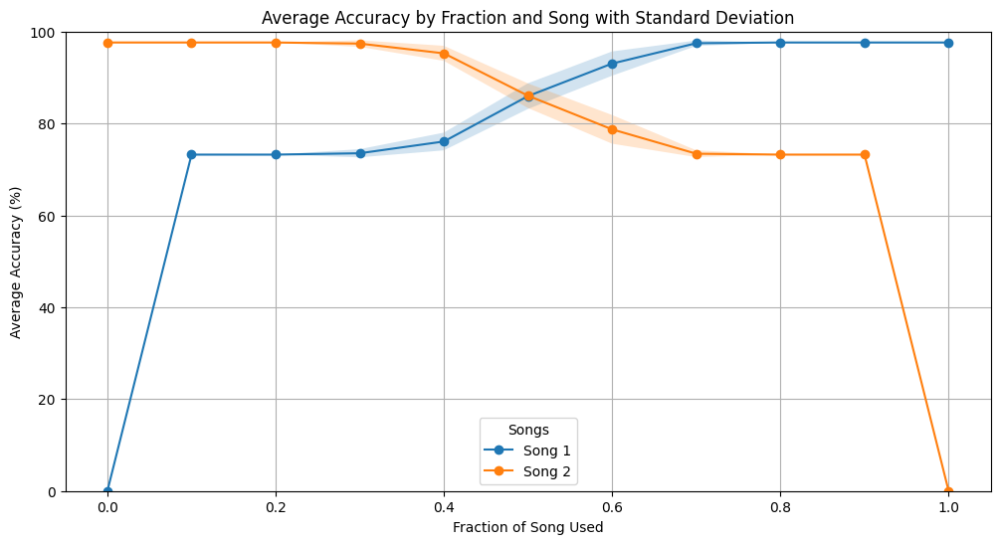

In [97]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

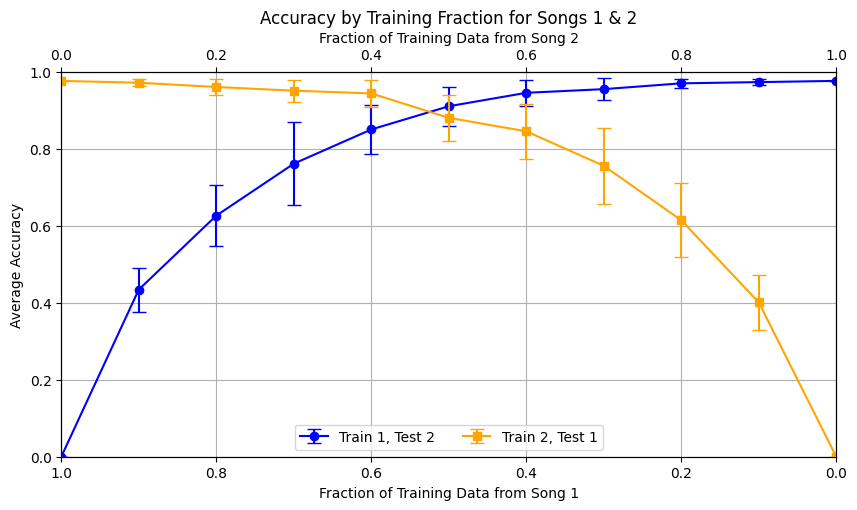

In [95]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 2), (2, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

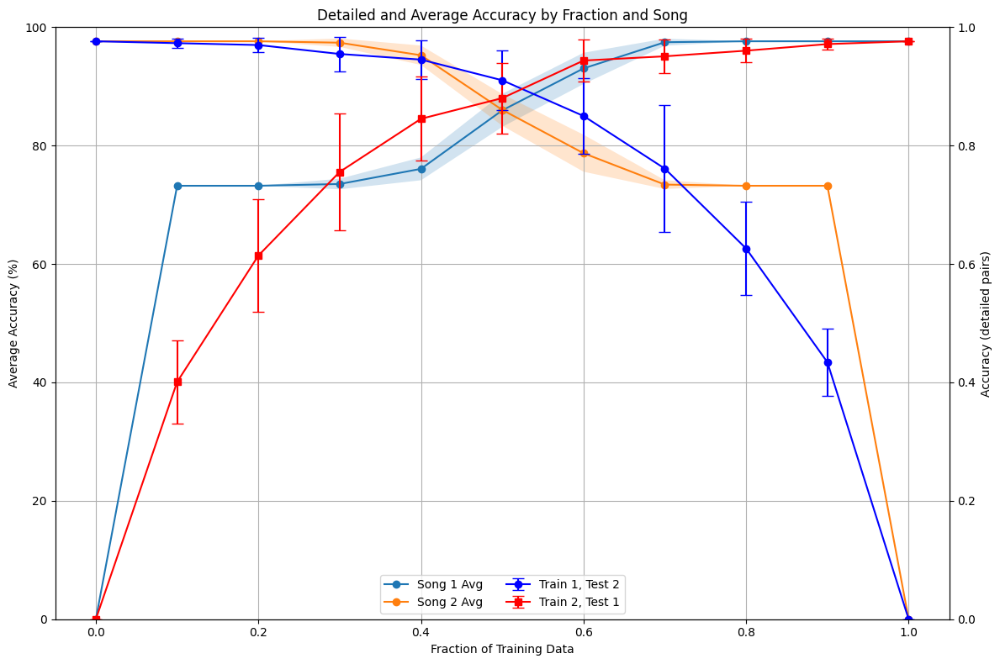

In [98]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


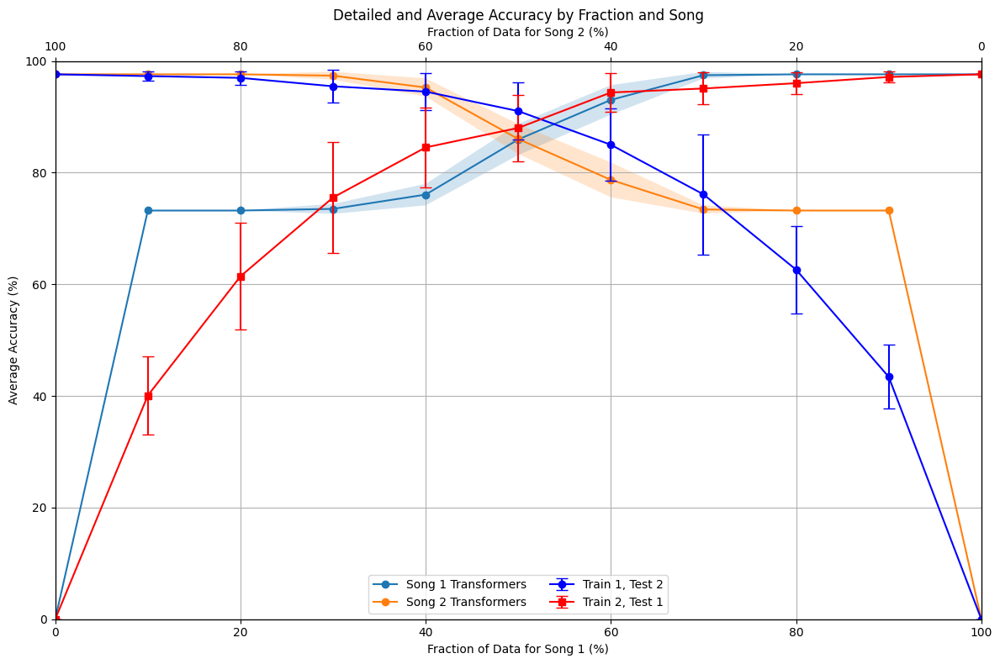

In [99]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Data for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Data for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


## Training and Testing for normal and 5th note 

## Song Complexity

### Daisy and 5th note - Hard Songs

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.1886
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.5964
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.0649
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.7410
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.5771
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.5017
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4678
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.4466
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.4278
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.4179
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.4118
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.4078
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.4051
prediction sha

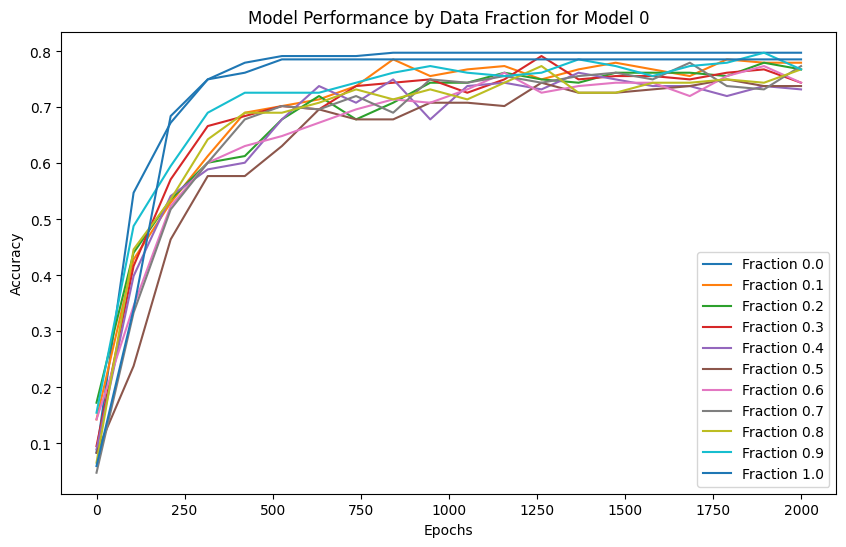

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1947
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.5544
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.1140
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.7940
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.6090
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.5054
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4572
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.4352
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.4235
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.4149
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.4099
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.4060
prediction shape 

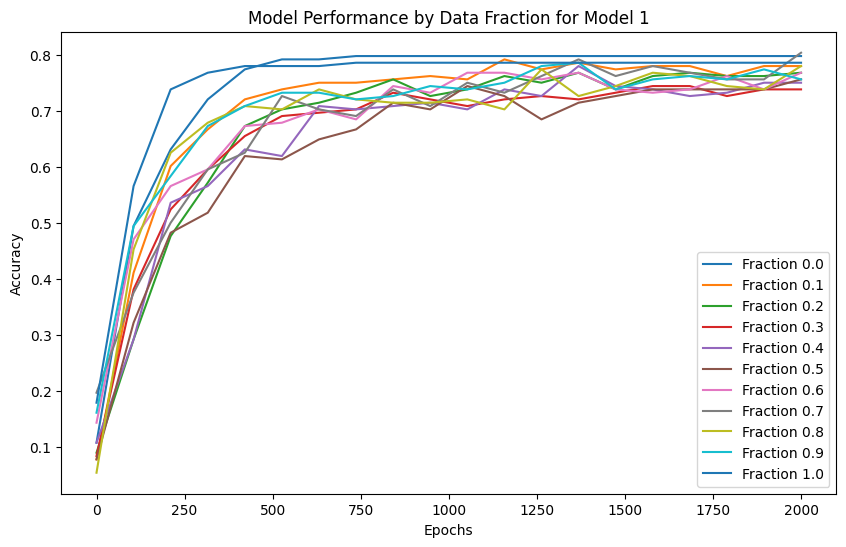

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2313
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.6778
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.1711
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.8146
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.6466
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.5410
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4734
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4412
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4227
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.4142
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.4085
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.4052
prediction shape 

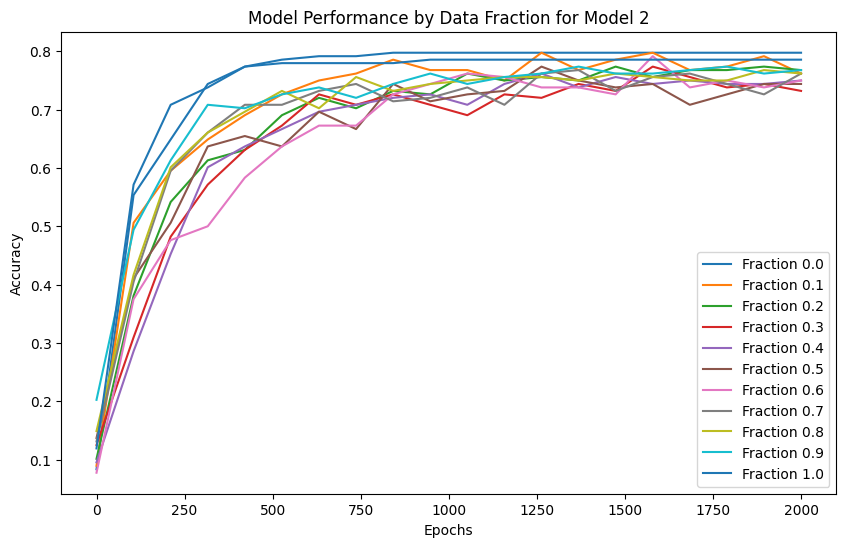

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2121
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.5905
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.1494
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.8015
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.6072
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.5143
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.4673
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4421
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.4284
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.4179
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.4123
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.4082
prediction shape 

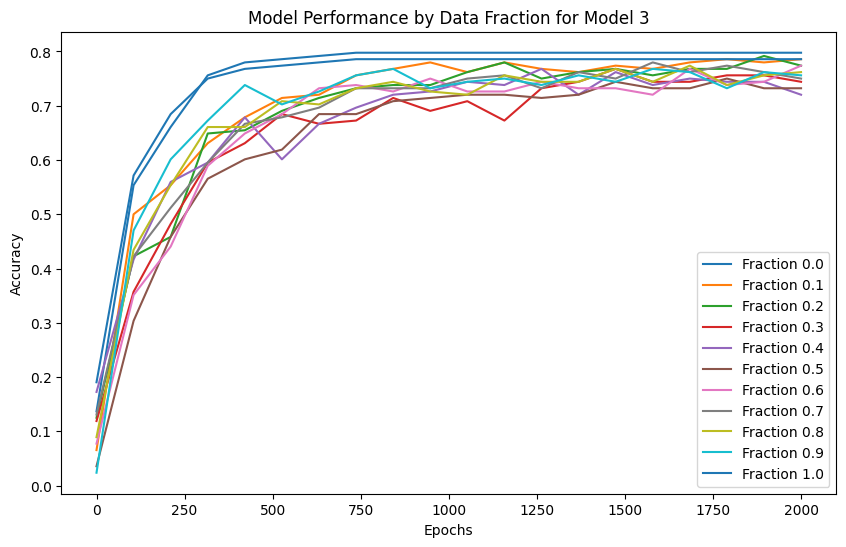

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1874
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.5989
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.1077
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.8001
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.6137
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5180
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.4710
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.4424
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.4268
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.4177
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.4118
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.4073
prediction shape 

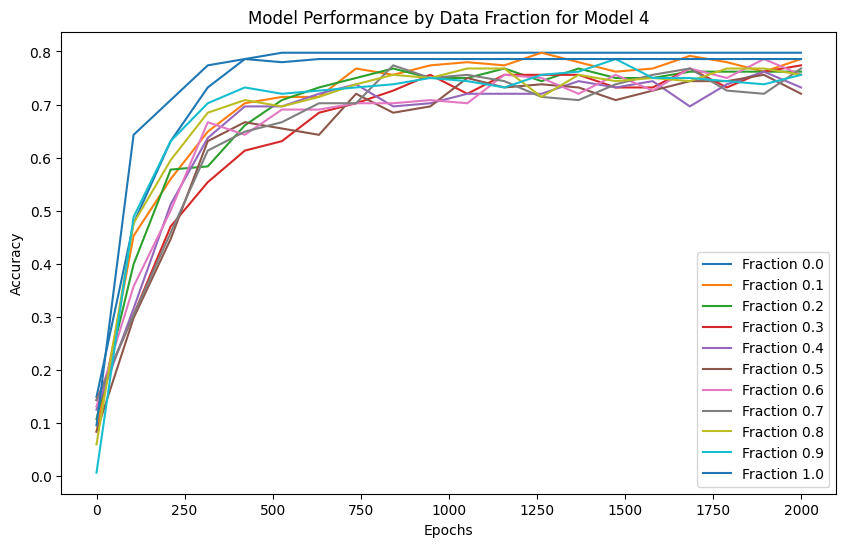

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2036
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.6207
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.1450
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.8765
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.6868
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.5898
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.5168
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4733
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.4449
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.4268
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.4161
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.4123
prediction shape 

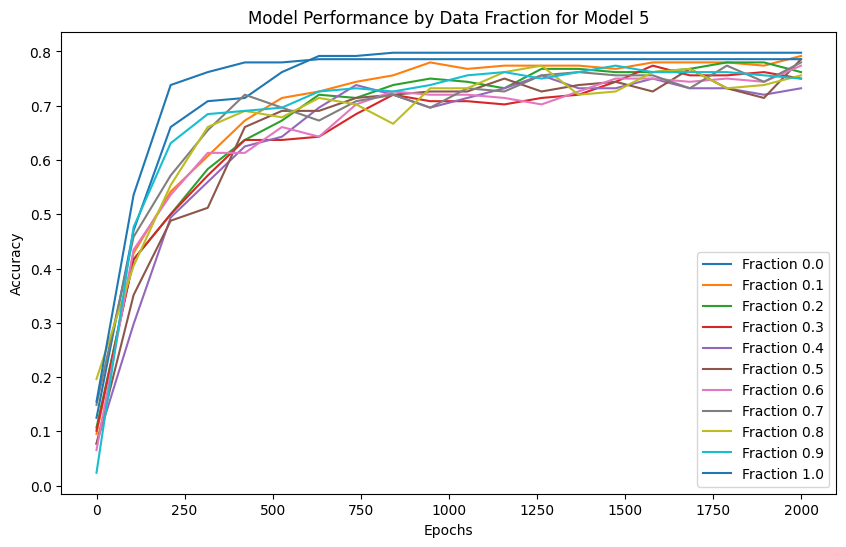

Model 6, Fraction 0.00, Epoch 1, Loss: 2.1958
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.5588
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.0397
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.7362
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.5729
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.4867
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4437
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.4261
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.4163
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.4109
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.4069
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.4041
prediction shape 

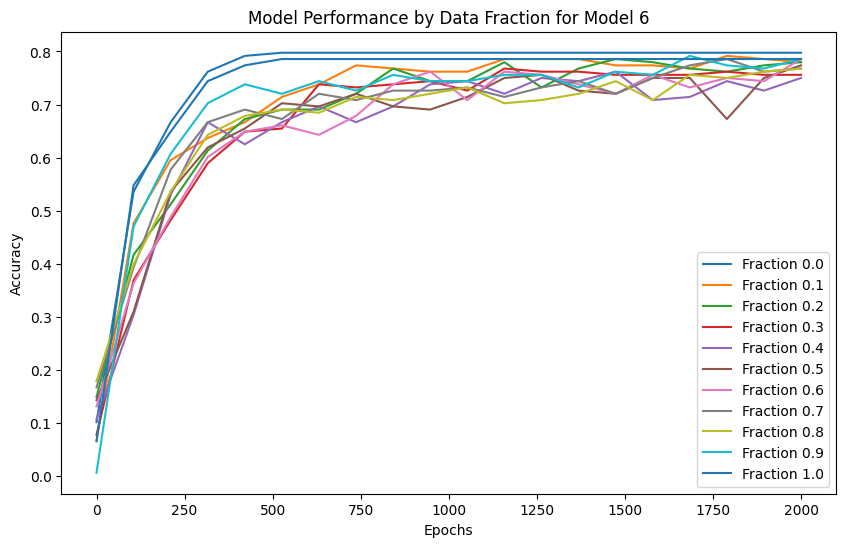

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2158
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.6368
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.1189
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.7716
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.6069
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.5234
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4796
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.4554
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.4392
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.4269
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.4180
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.4111
prediction shape 

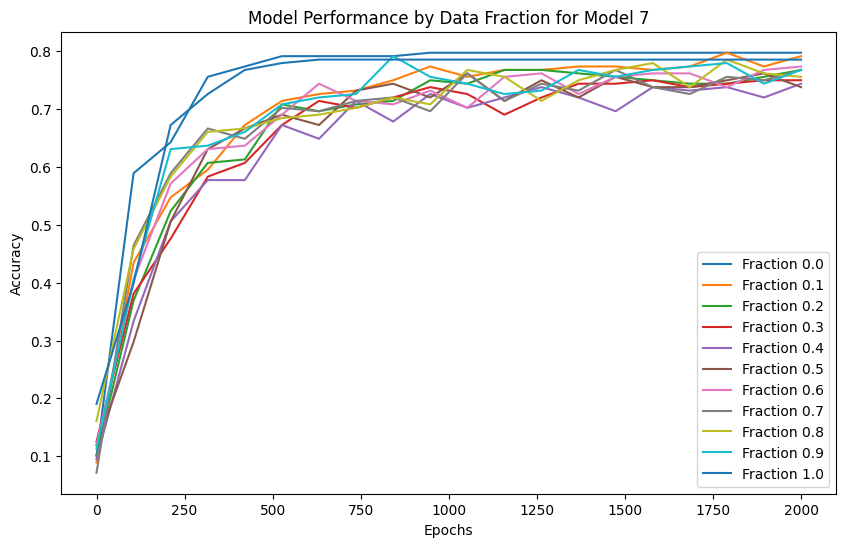

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2390
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.6236
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.1791
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.8342
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.6263
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.5247
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.4708
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.4429
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.4275
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.4176
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.4116
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.4075
prediction shape 

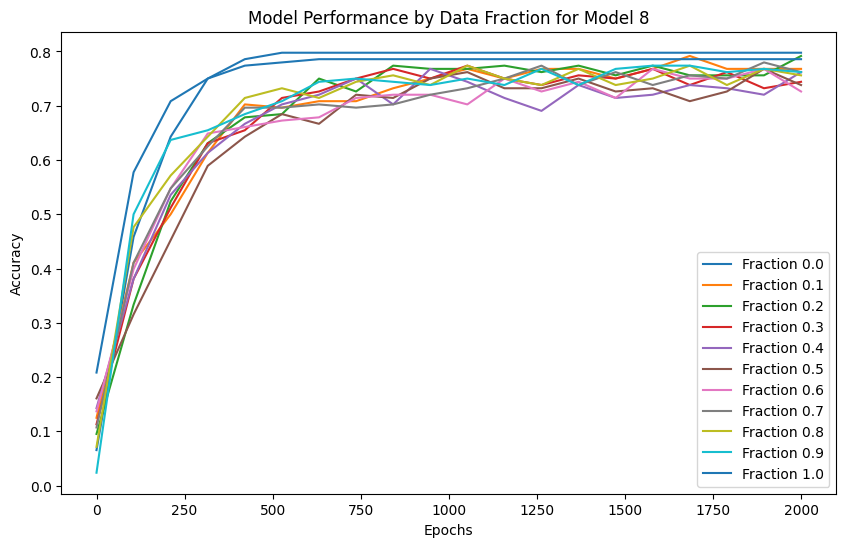

Model 9, Fraction 0.00, Epoch 1, Loss: 2.1918
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.5778
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.0462
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.7317
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.5609
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.4793
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.4438
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.4260
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.4162
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.4106
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.4092
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.4039
prediction shape 

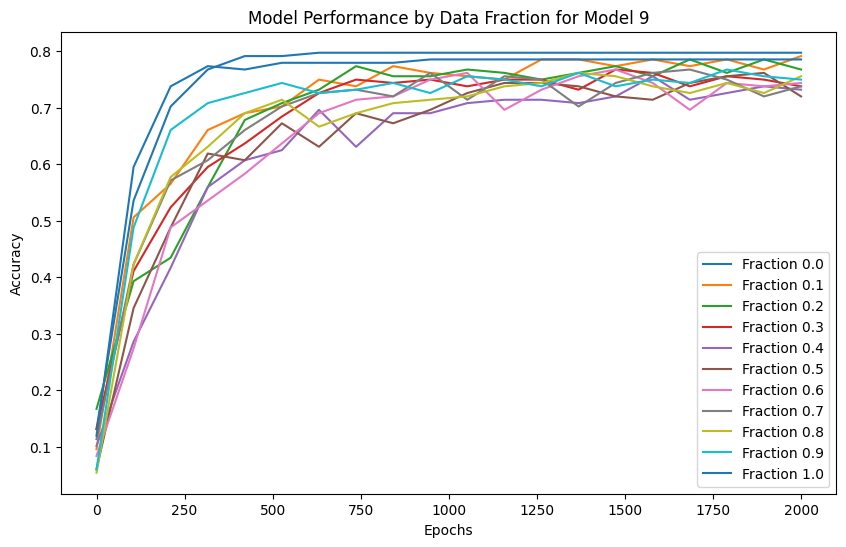

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2132
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.6716
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.1707
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.8195
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.6216
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.5020
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.4545
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.4341
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.4220
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.4143
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.4094
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.4060
predi

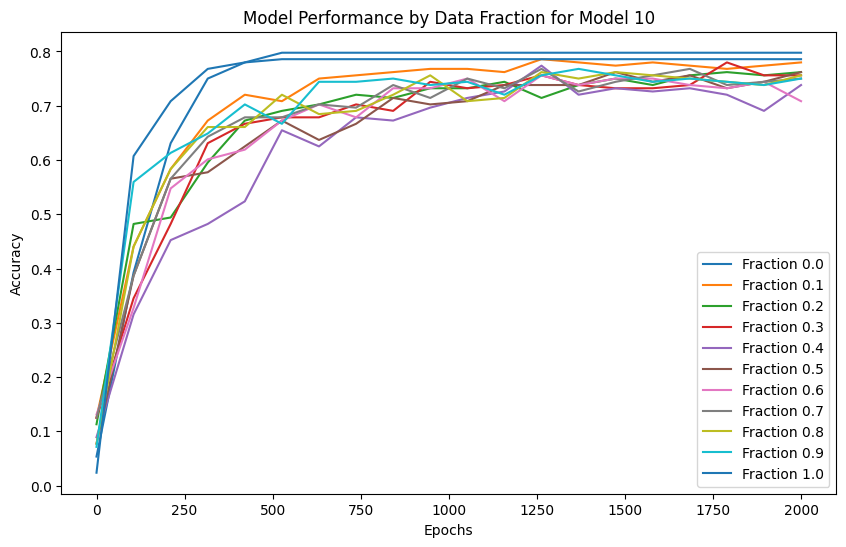

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2113
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.5558
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.1088
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.7837
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.6033
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.5108
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.4653
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.4382
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.4240
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.4159
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.4105
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.4070
predi

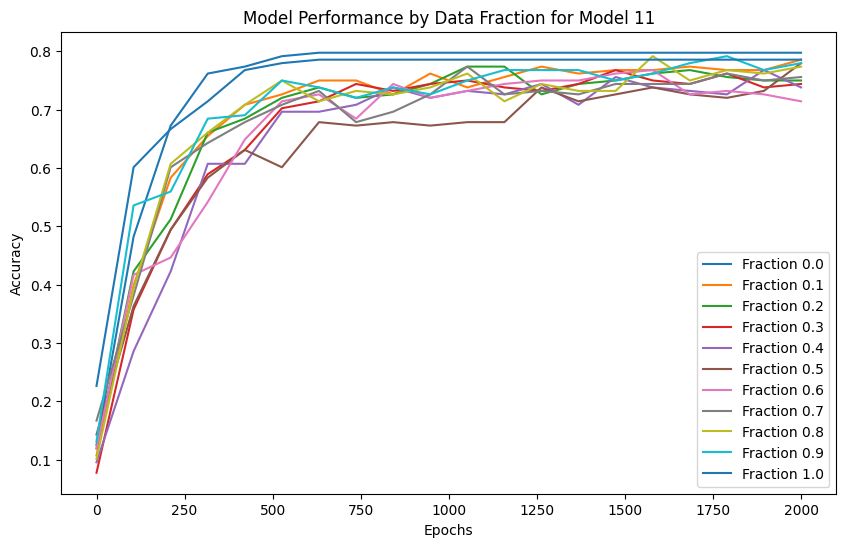

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2145
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.5855
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.1232
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.7970
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.6094
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5116
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4573
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.4340
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.4217
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.4143
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.4099
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.4066
predi

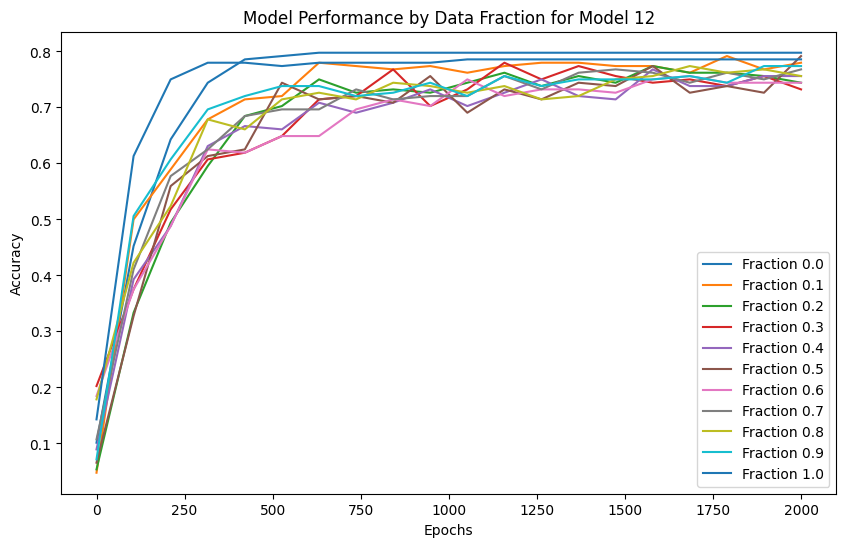

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2139
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.6775
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.1193
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.7701
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.5840
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.5016
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4591
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4349
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.4215
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.4143
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.4085
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.4052
predi

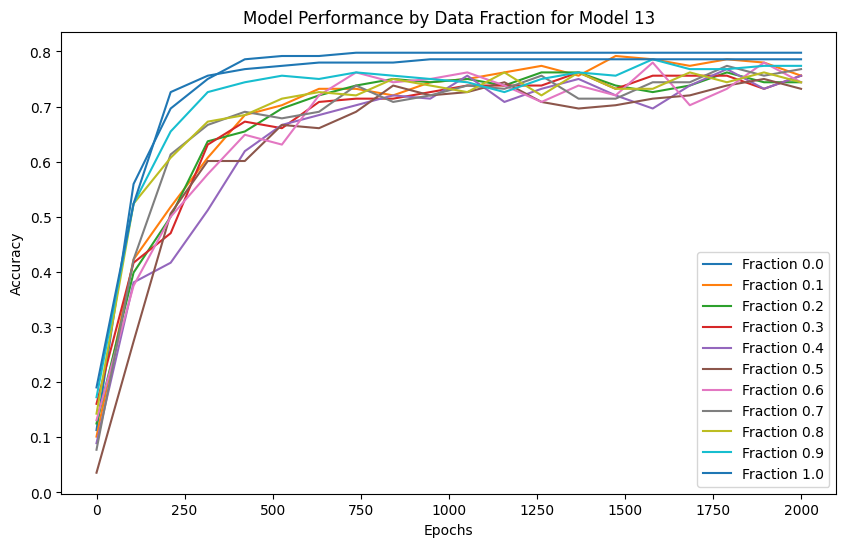

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2350
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.6491
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.1506
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.8158
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.6355
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.5274
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.4674
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.4420
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.4261
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.4174
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.4120
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.4085
predi

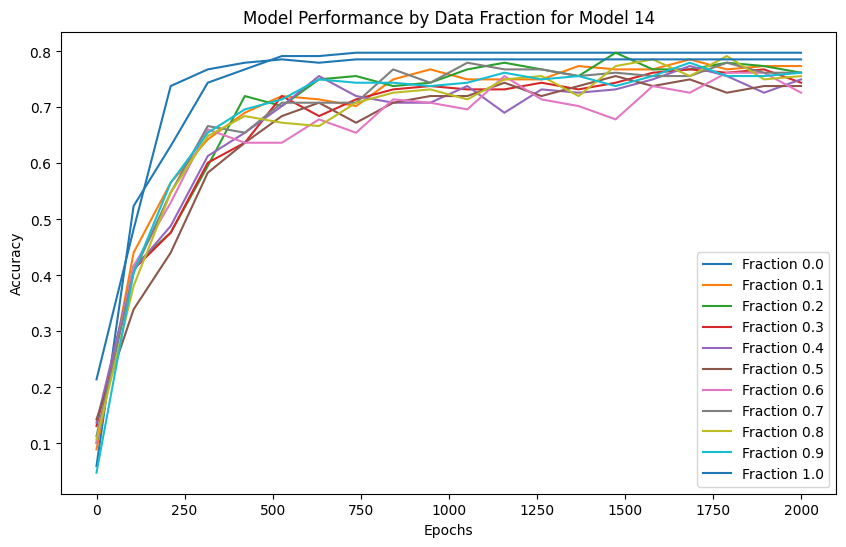

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2275
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.6162
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.1350
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.8244
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.6411
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.5218
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4620
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.4359
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.4218
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.4141
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.4088
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.4054
predi

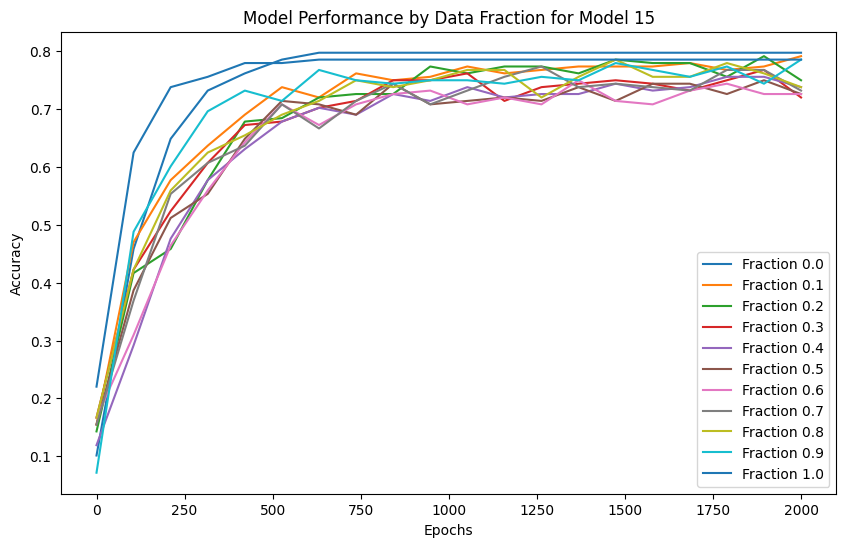

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2055
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.5952
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.1507
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.8107
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.6066
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.4999
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.4531
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.4315
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.4199
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.4126
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.4083
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.4051
predi

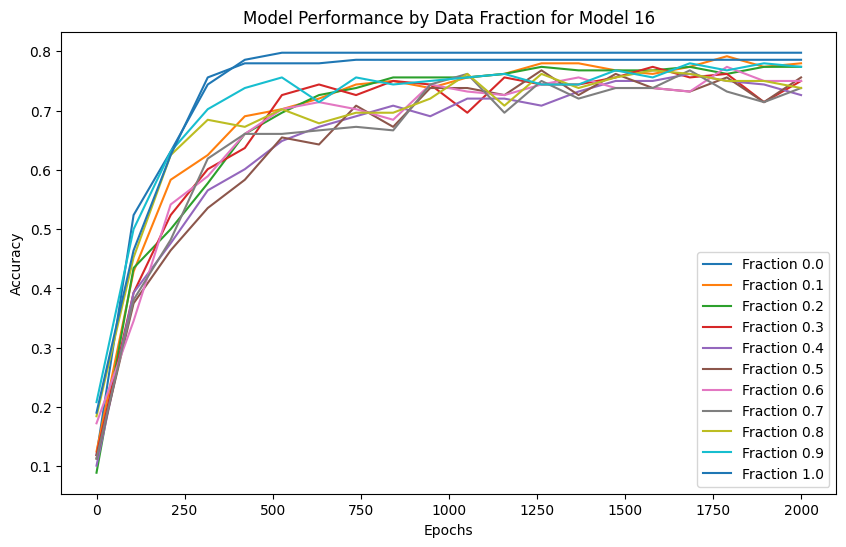

Model 17, Fraction 0.00, Epoch 1, Loss: 2.1945
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.5504
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.1017
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.8167
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.6188
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.5296
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.5041
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.4645
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.4443
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.4284
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.4192
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.4118
predi

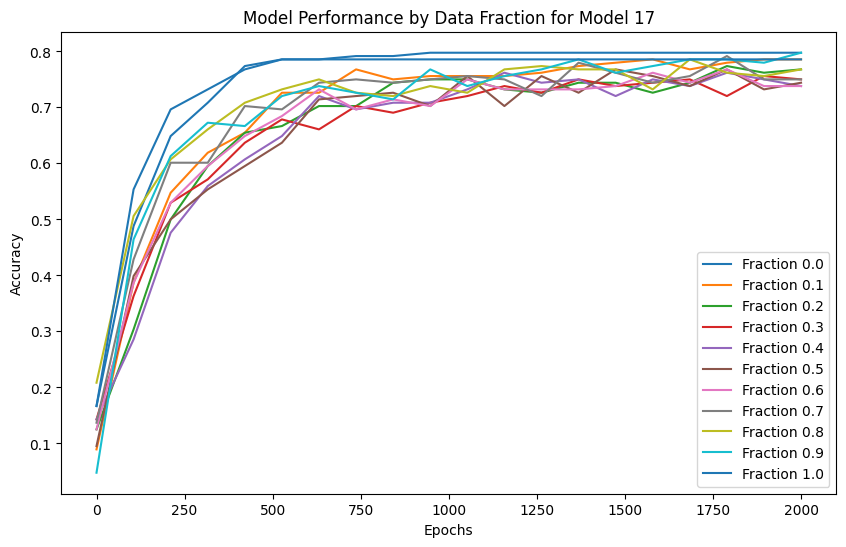

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2260
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.6608
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.1118
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.7922
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.6180
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5362
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4912
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.4566
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.4335
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.4214
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.4155
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.4083
predi

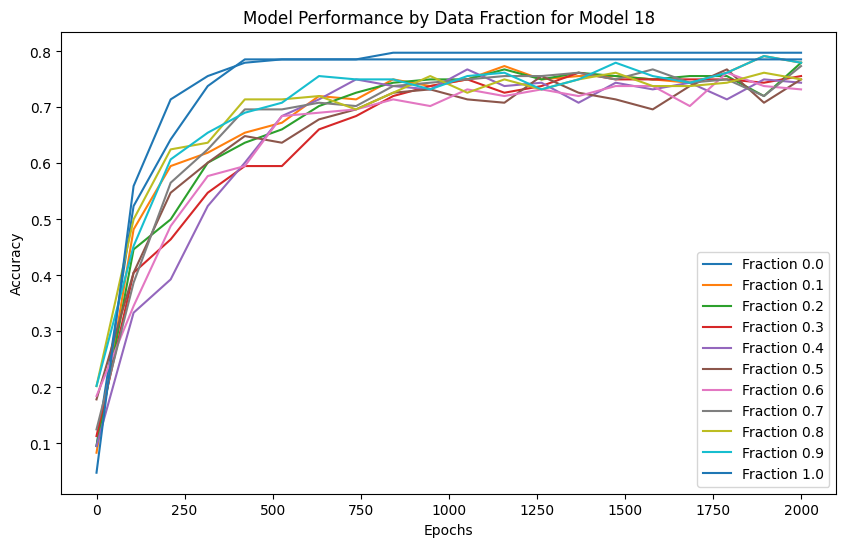

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.6246
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.1504
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.7991
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6142
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.5409
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.5012
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.4719
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.4477
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.4309
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.4204
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.4173
predi

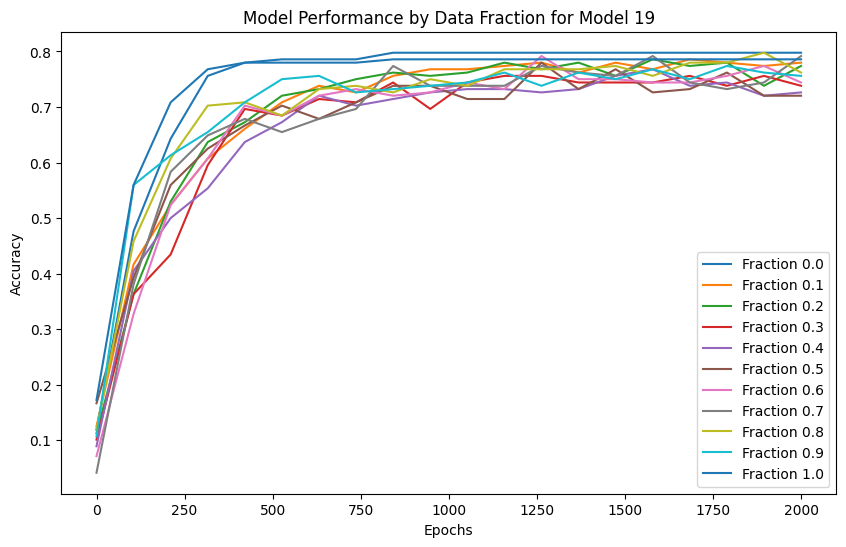

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2010
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.5870
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.0421
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.7342
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.5739
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.4914
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4495
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.4276
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.4172
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.4112
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.4072
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.4044
predi

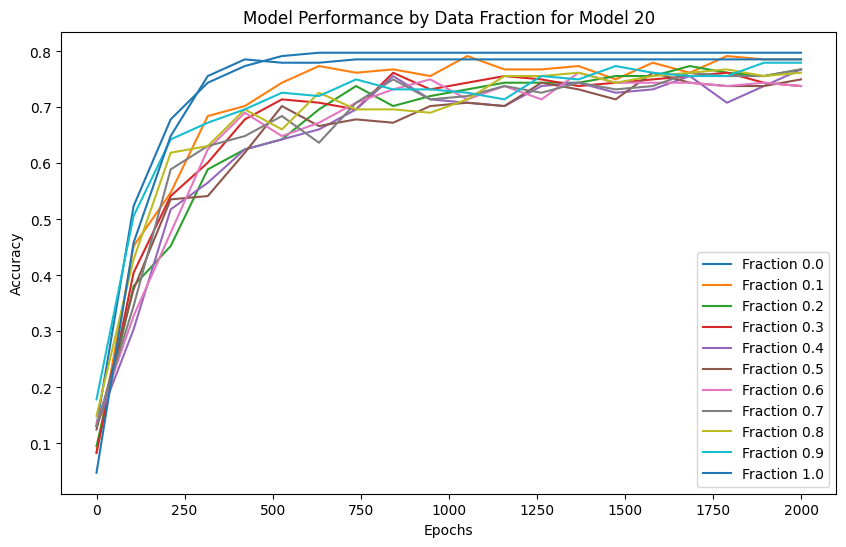

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2084
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.5953
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.0598
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.7669
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6093
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5319
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.4918
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.4665
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.4513
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.4389
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.4279
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.4189
predi

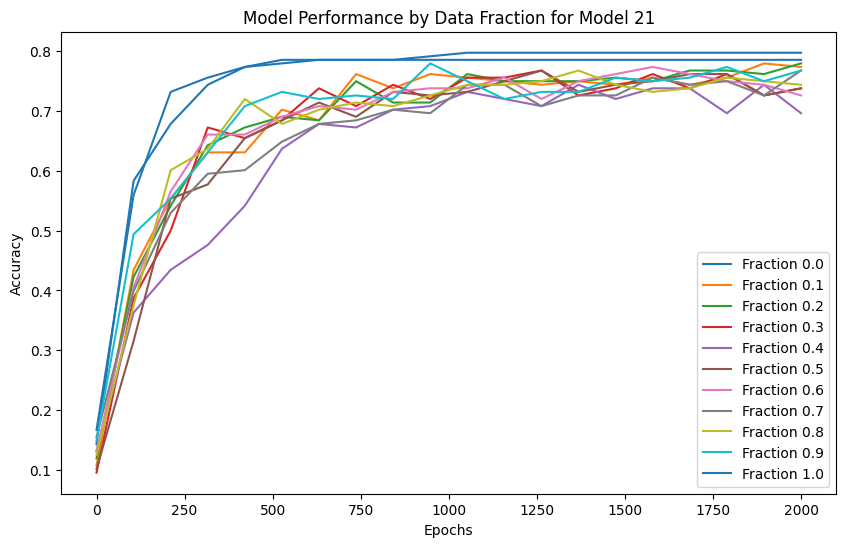

Model 22, Fraction 0.00, Epoch 1, Loss: 2.1923
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.5916
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.0493
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.7370
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.5873
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.4848
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.4421
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.4255
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.4164
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.4118
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.4071
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.4046
predi

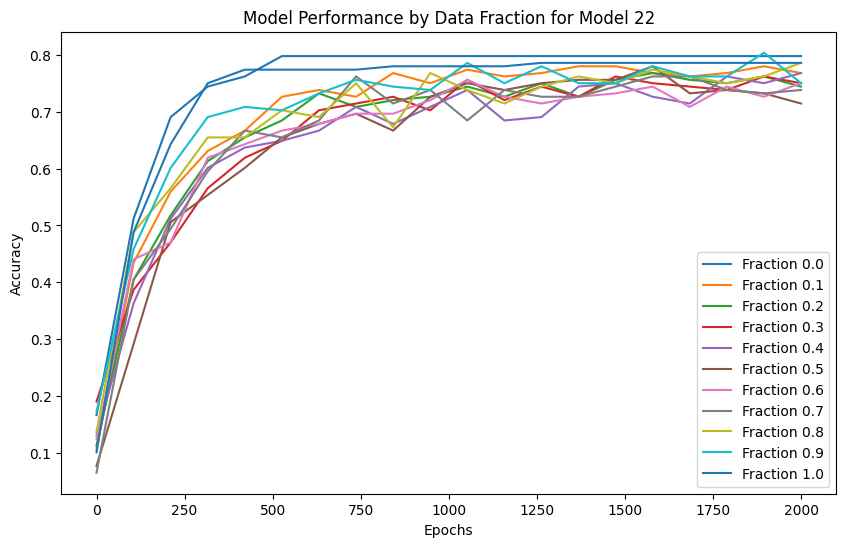

Model 23, Fraction 0.00, Epoch 1, Loss: 2.1897
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.6150
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.0527
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.7084
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.5504
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.4840
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4537
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.4351
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.4230
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.4159
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.4108
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.4084
predi

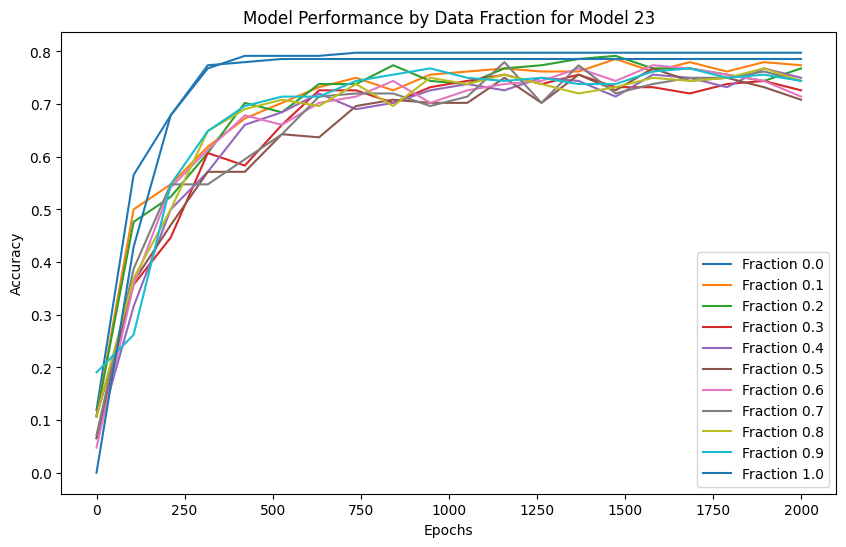

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2030
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.6038
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.1046
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.7995
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.6193
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.5362
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4835
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.4525
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.4339
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.4218
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.4142
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.4106
predi

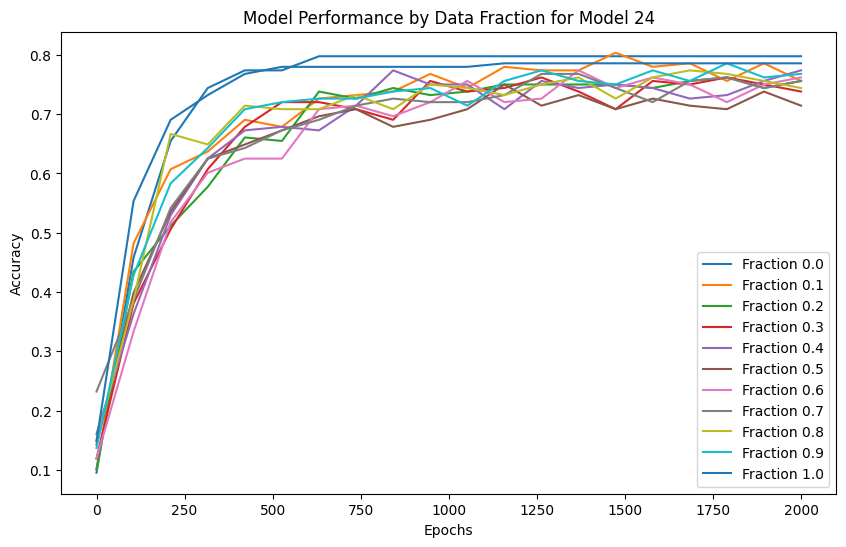

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2070
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.6061
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.0629
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.7533
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.6015
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.5068
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4577
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.4341
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.4219
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.4148
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.4096
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.4063
predi

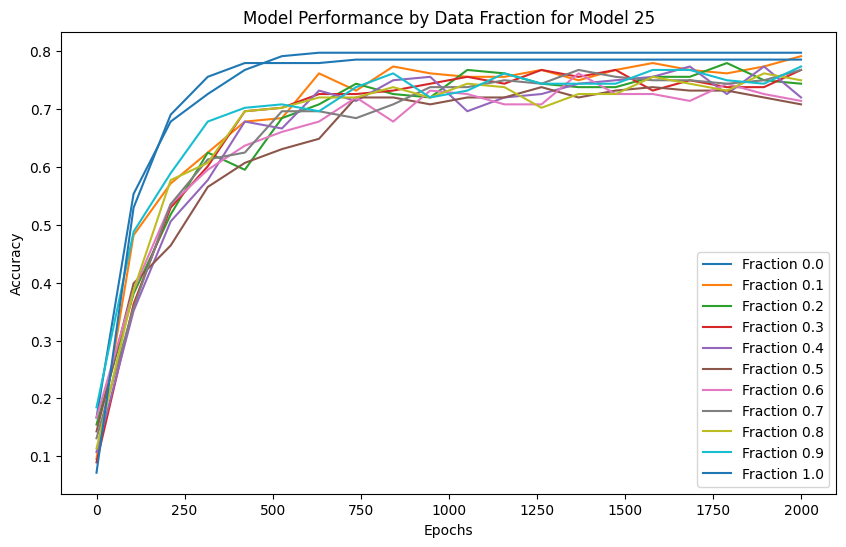

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2193
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.6214
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.1443
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.7978
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6043
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.5056
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.4603
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.4364
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.4237
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.4162
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.4113
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.4075
predi

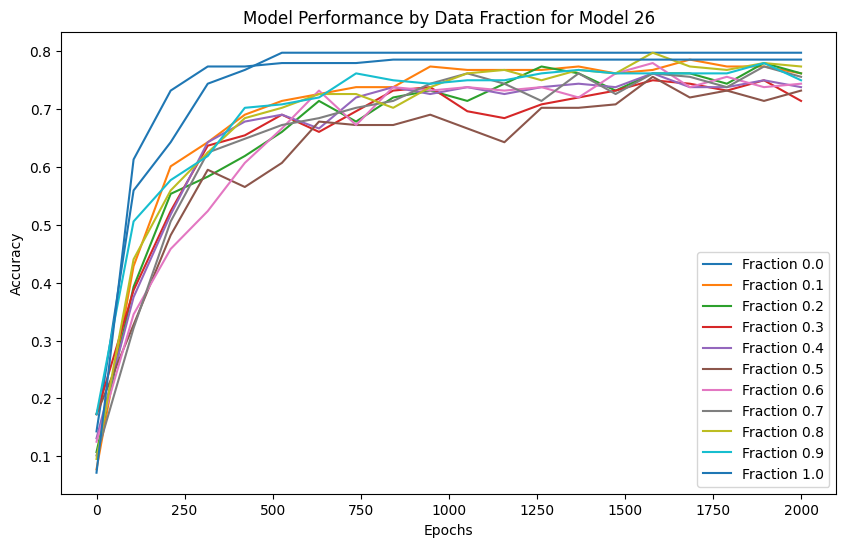

Model 27, Fraction 0.00, Epoch 1, Loss: 2.1972
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.5670
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.1483
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.8299
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.6029
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.5048
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4539
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.4313
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.4195
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.4124
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.4081
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.4050
predi

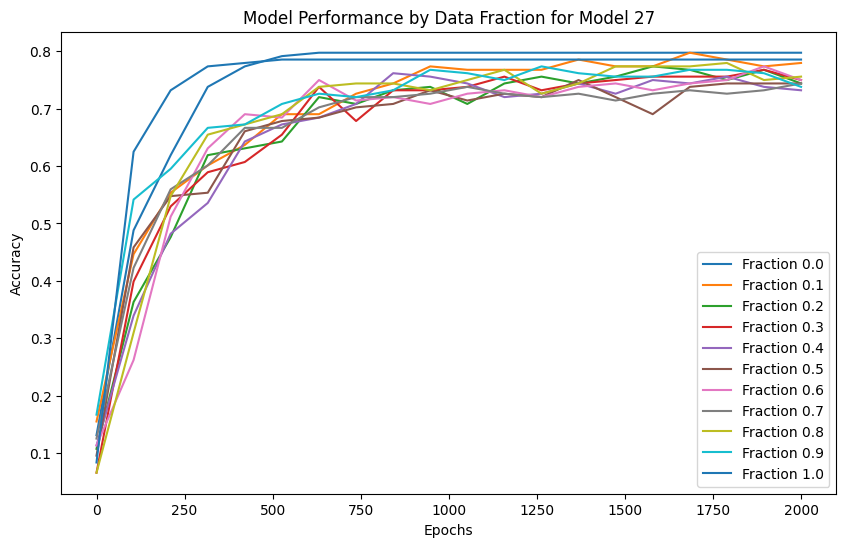

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2201
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.5188
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.1215
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.7775
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.6072
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.5189
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4750
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.4512
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.4399
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.4254
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.4159
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.4099
predi

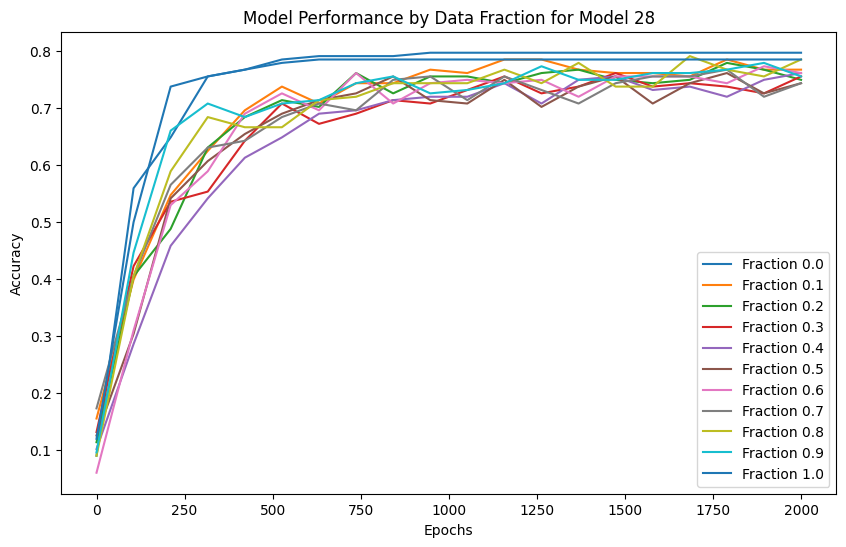

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2008
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.5537
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.0645
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.7288
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.5853
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.4960
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.4555
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.4330
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.4214
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.4135
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.4091
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.4058
predi

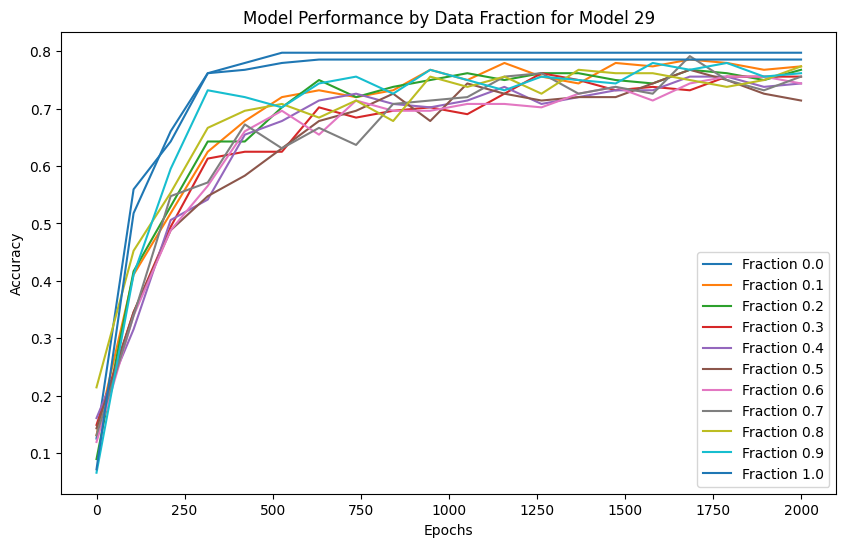

In [13]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_hard_daisy_5th_note/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [115]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_hard_daisy_5th_note"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0306
  Fraction 0.10, Average Accuracy: 0.5986
  Fraction 0.20, Average Accuracy: 0.6444
  Fraction 0.30, Average Accuracy: 0.6675
  Fraction 0.40, Average Accuracy: 0.7179
  Fraction 0.50, Average Accuracy: 0.7581
  Fraction 0.60, Average Accuracy: 0.7722
  Fraction 0.70, Average Accuracy: 0.7802
  Fraction 0.80, Average Accuracy: 0.7812
  Fraction 0.90, Average Accuracy: 0.7849
  Fraction 1.00, Average Accuracy: 0.7857
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7976
  Fraction 0.10, Average Accuracy: 0.7962
  Fraction 0.20, Average Accuracy: 0.7931
  Fraction 0.30, Average Accuracy: 0.7813
  Fraction 0.40, Average Accuracy: 0.7490
  Fraction 0.50, Average Accuracy: 0.7167
  Fraction 0.60, Average Accuracy: 0.7002
  Fraction 0.70, Average Accuracy: 0.6835
  Fraction 0.80, Average Accuracy: 0.6696
  Fraction 0.90, Average Accuracy: 0.6181
  Fraction 1.00, Average Accuracy: 0.0550


#### plotting for transformers

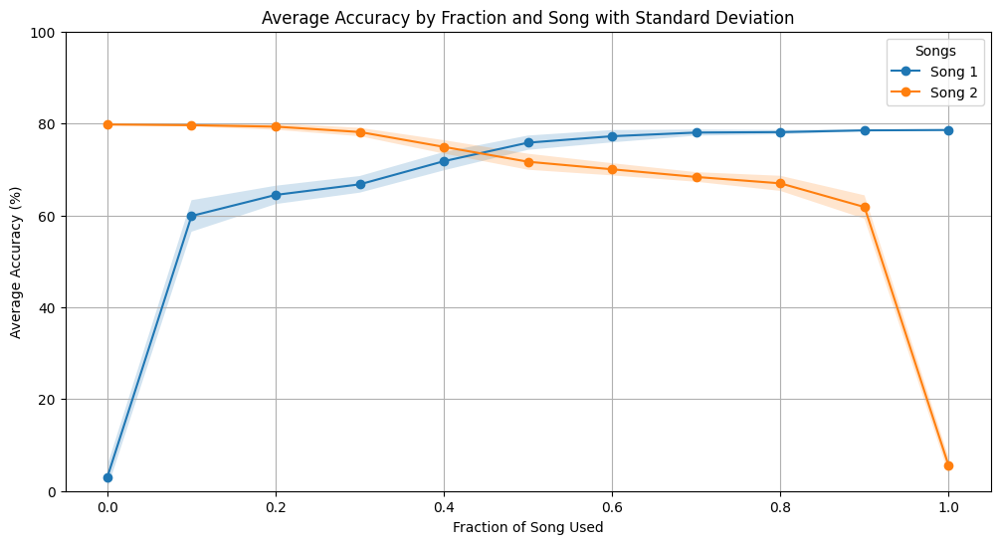

In [116]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

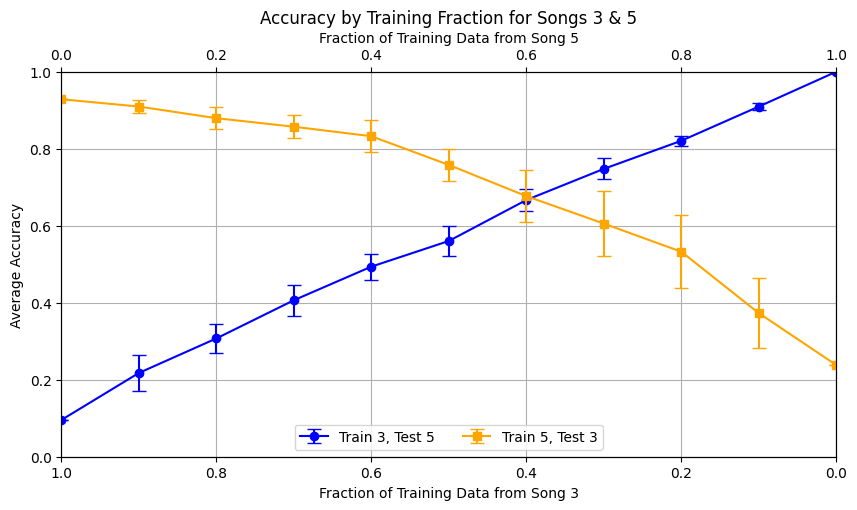

In [119]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(3, 5), (5, 3)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

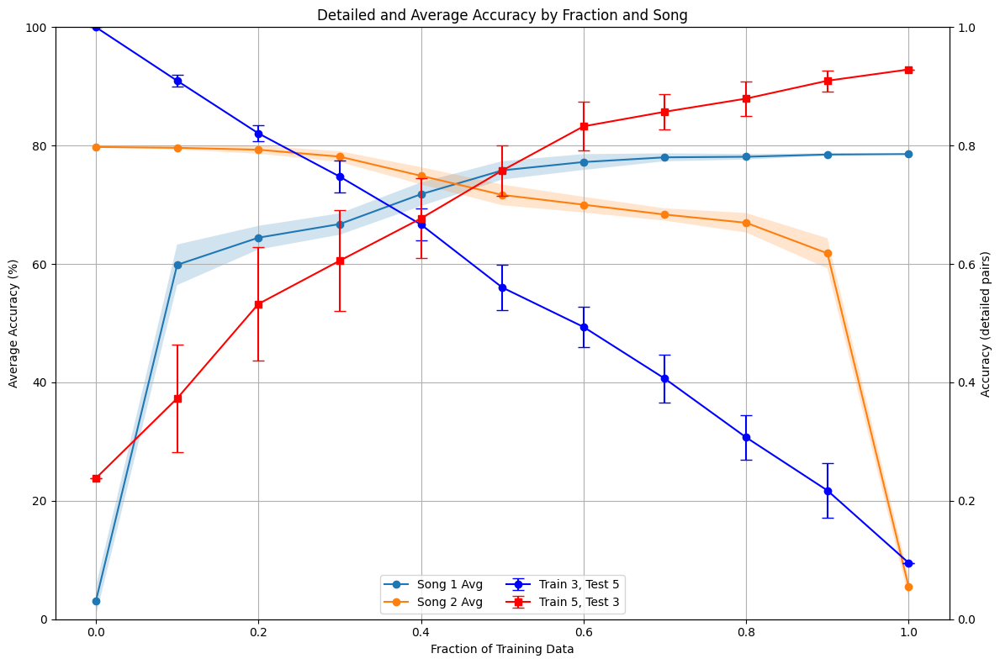

In [123]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(3, 5), (5, 3)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


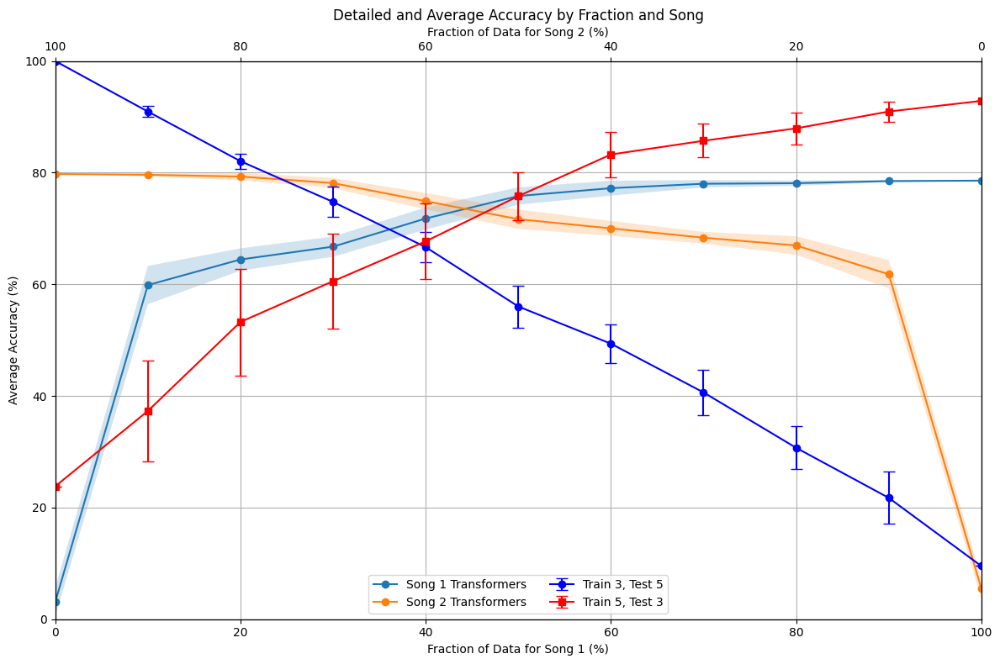

In [124]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Data for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(3, 5), (5, 3)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Data for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


## Training and Testing for daisybells and 5th note Lower parameter

Model 0, Fraction 0.00, Epoch 1, Loss: 2.1989
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 2.0135
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.5584
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.3003
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 1.1454
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 1.0289
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.9412
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.8687
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.8174
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.7811
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.7545
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.7386
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.7183
prediction sha

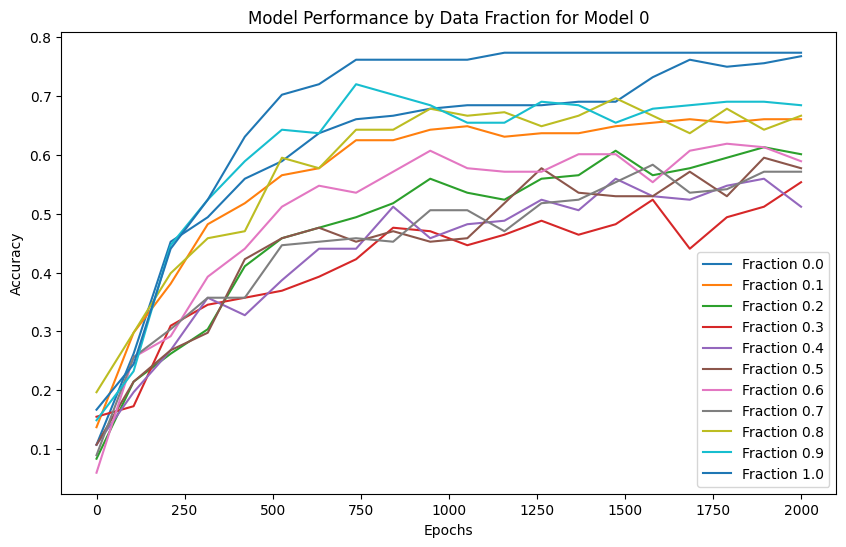

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2062
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 2.0370
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5813
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.3391
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 1.1794
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 1.0651
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.9838
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.9131
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.8589
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.8004
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.7650
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.7388
prediction shape 

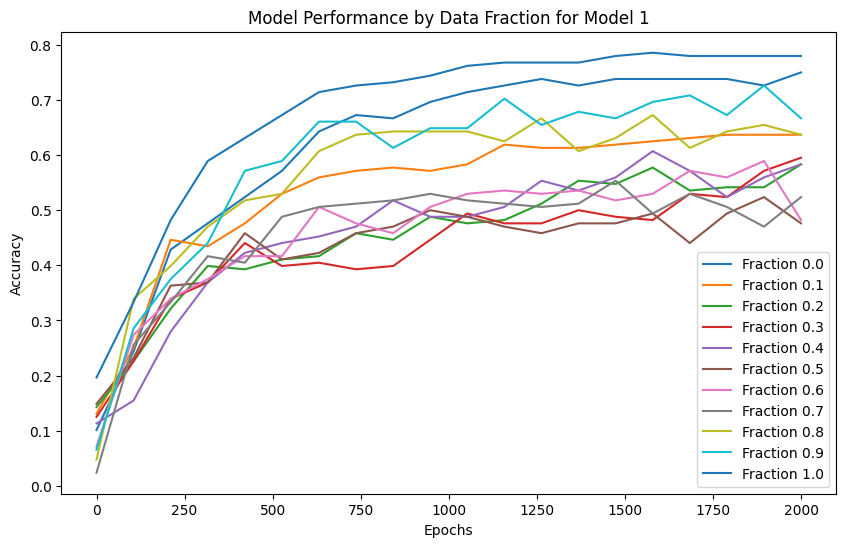

Model 2, Fraction 0.00, Epoch 1, Loss: 2.1919
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 2.0077
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.6579
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.3754
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 1.2431
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 1.1574
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 1.1023
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 1.0540
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.9913
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.9383
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.8812
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.8355
prediction shape 

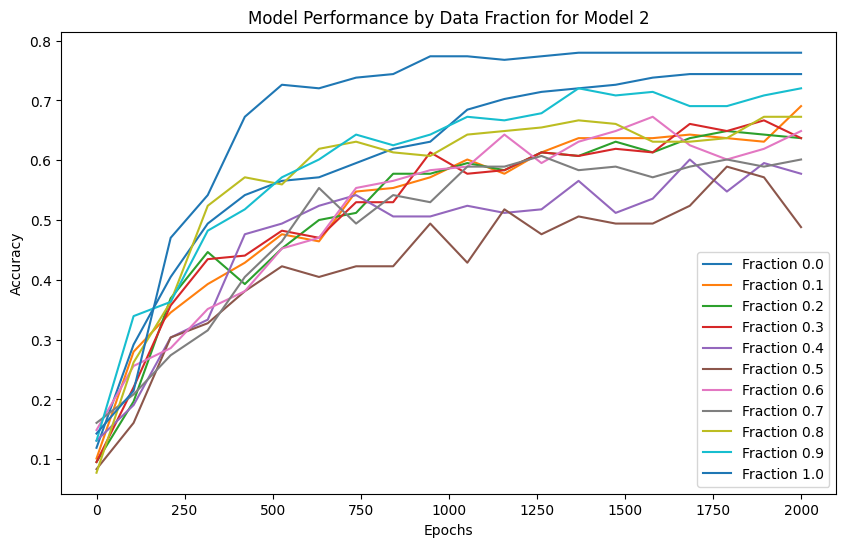

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2059
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 2.0326
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.6444
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.3916
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 1.1823
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.9959
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.8944
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.8157
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.7703
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.7370
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.7145
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.7022
prediction shape 

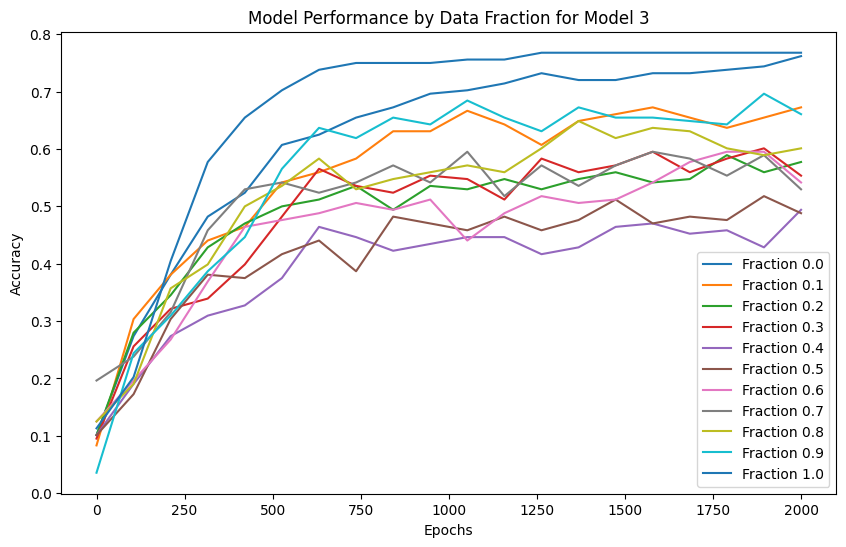

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2079
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.9928
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.6496
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.4257
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 1.1836
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 1.0165
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.9317
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.8793
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.8500
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.8241
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.8162
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.7902
prediction shape 

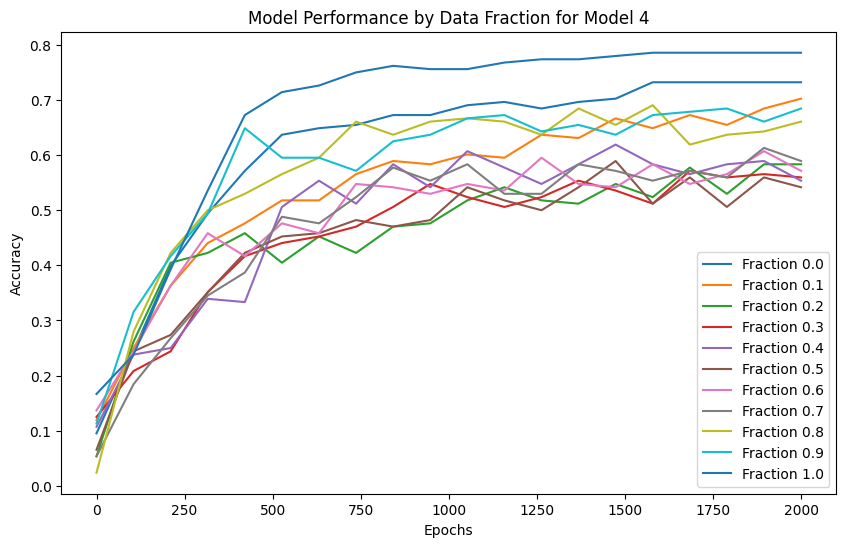

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1993
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.9641
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.6273
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.3790
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 1.2112
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 1.0981
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 1.0019
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.9196
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.8722
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.8424
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.8041
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.7782
prediction shape 

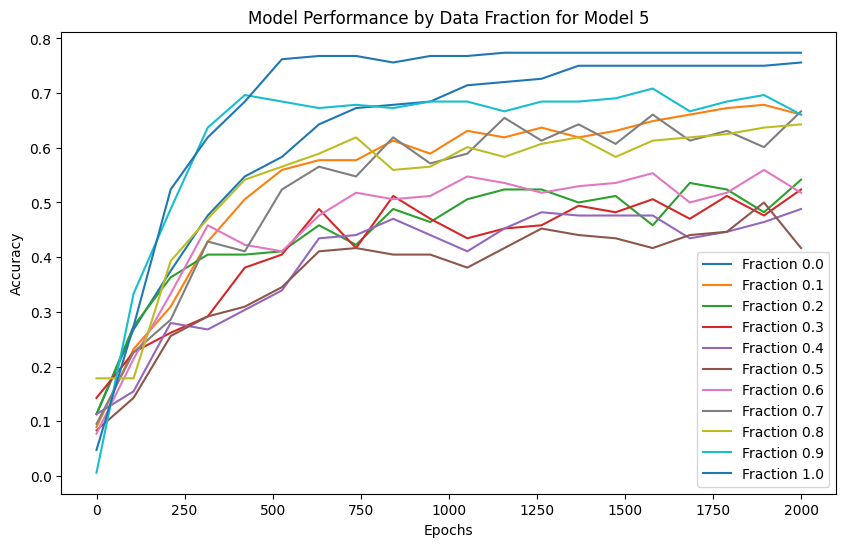

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2304
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 2.0160
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.6973
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 1.4658
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 1.2004
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.9723
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.8351
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.7515
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.6921
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.6519
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.6184
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.5984
prediction shape 

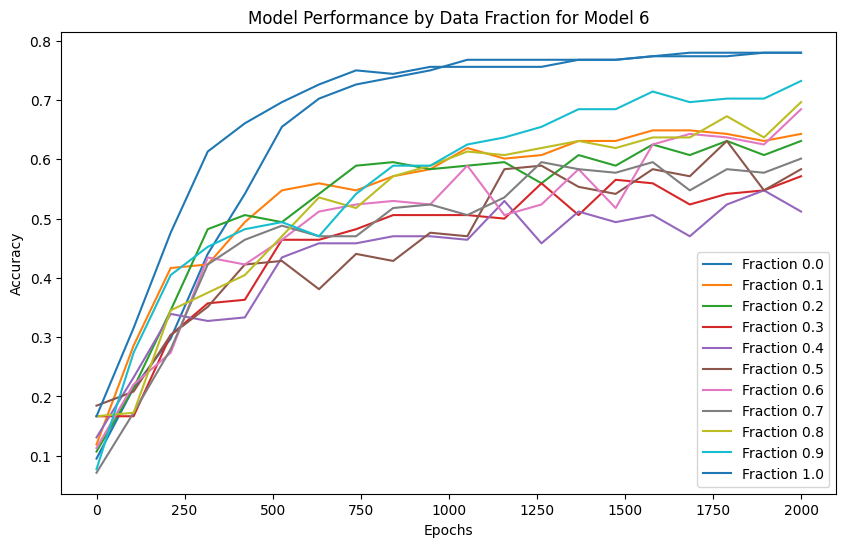

Model 7, Fraction 0.00, Epoch 1, Loss: 2.1951
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 2.0072
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.6558
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.3723
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 1.1859
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 1.0642
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.9639
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.8930
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.8422
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.8036
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.8379
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.7460
prediction shape 

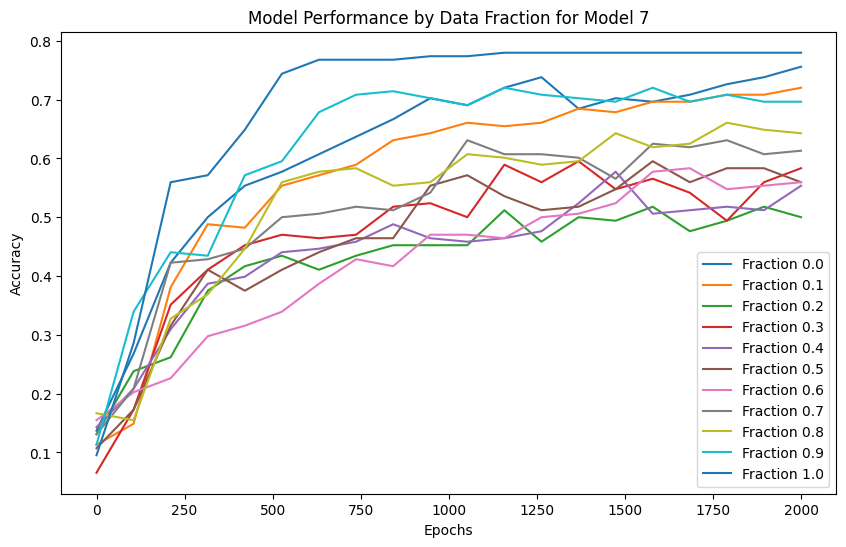

Model 8, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9591
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.5717
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.3353
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 1.1523
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 1.0355
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.9615
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.9081
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.8587
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.8150
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.7801
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.7517
prediction shape 

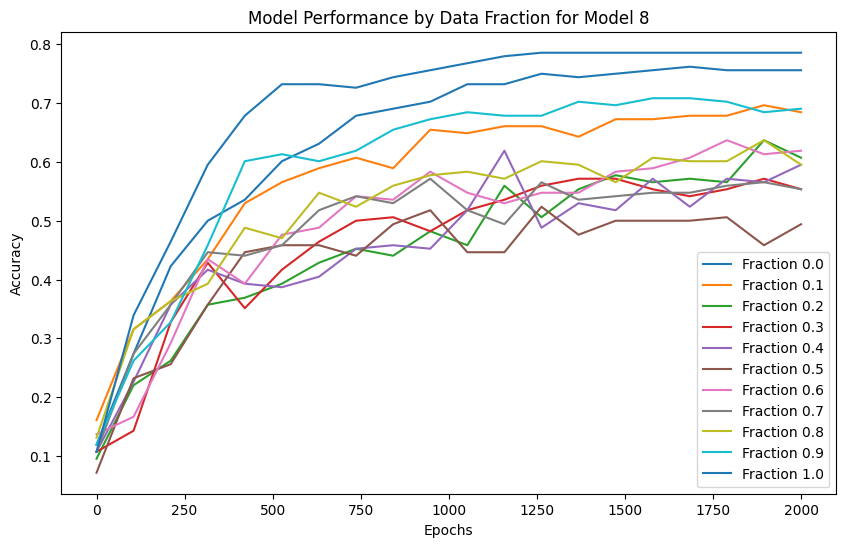

Model 9, Fraction 0.00, Epoch 1, Loss: 2.1930
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.9688
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.6541
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.4153
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 1.2421
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 1.1280
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 1.0522
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 1.0073
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.9822
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.9627
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.9458
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.9285
prediction shape 

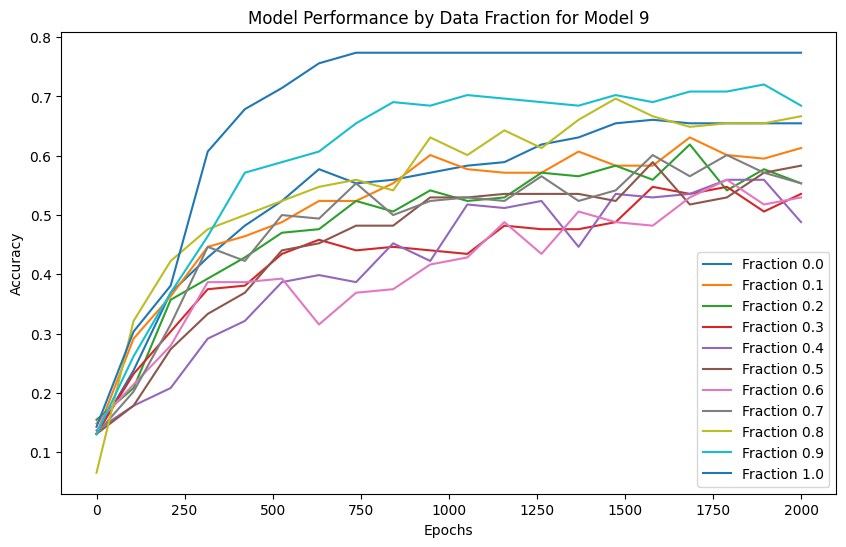

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2056
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.9002
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.5822
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.3858
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 1.2479
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 1.1186
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 1.0228
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.9148
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.8414
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.7888
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.7553
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.7278
predi

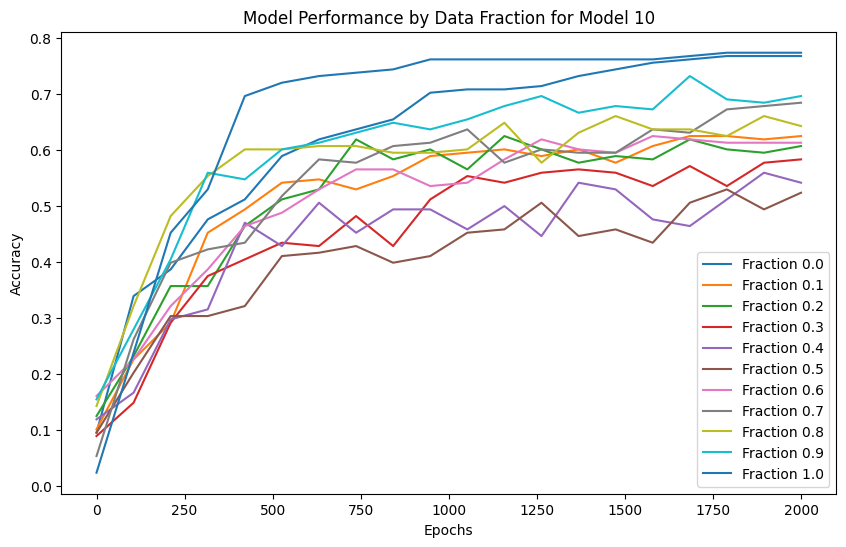

Model 11, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9042
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.6541
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.3790
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 1.1866
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 1.0017
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.9176
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.8725
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.8280
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.8059
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.8100
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.7860
predi

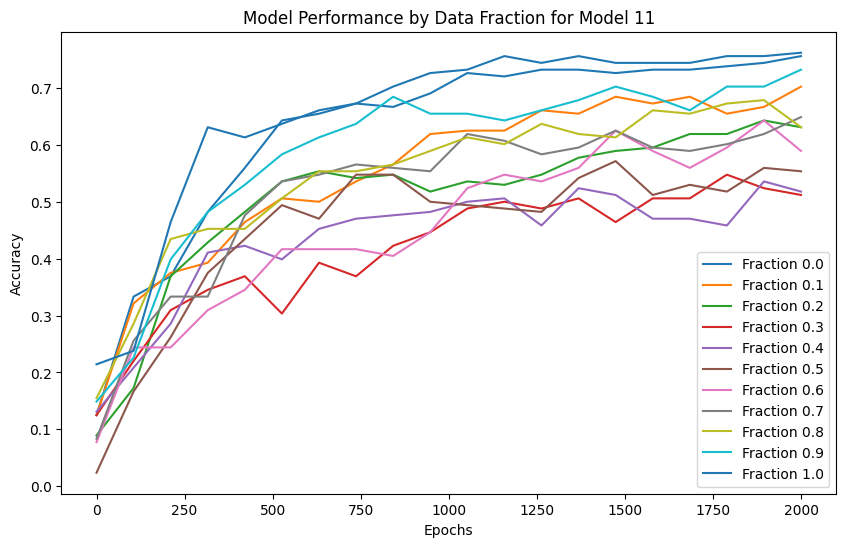

Model 12, Fraction 0.00, Epoch 1, Loss: 2.1928
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.9671
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.6285
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 1.3903
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 1.2151
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 1.0879
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.9799
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.9011
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.8270
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.7714
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.7346
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.7080
predi

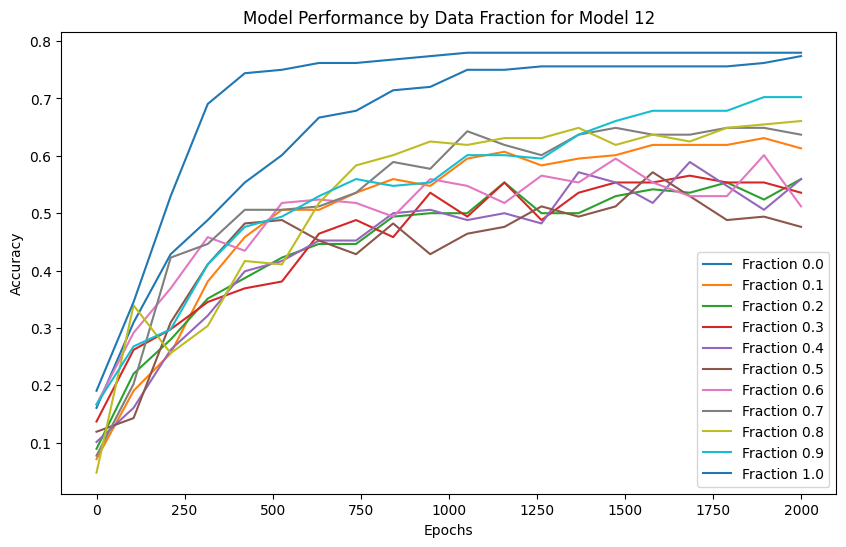

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2091
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 2.0396
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.6148
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 1.3394
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 1.1024
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.9296
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.8378
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.7826
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.7442
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.7157
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.6949
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.6781
predi

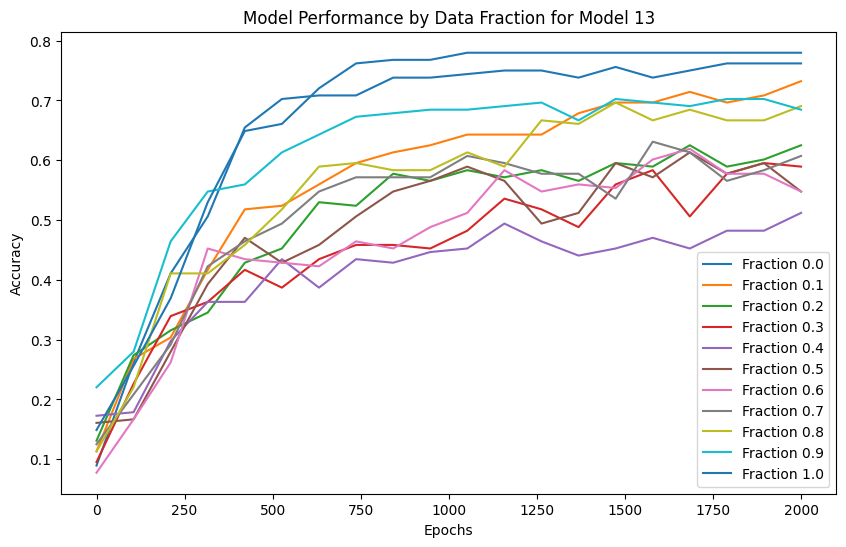

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2058
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.9630
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.6122
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.3258
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 1.1494
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 1.0264
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.9337
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.8568
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.8038
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.7609
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.7264
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.6962
predi

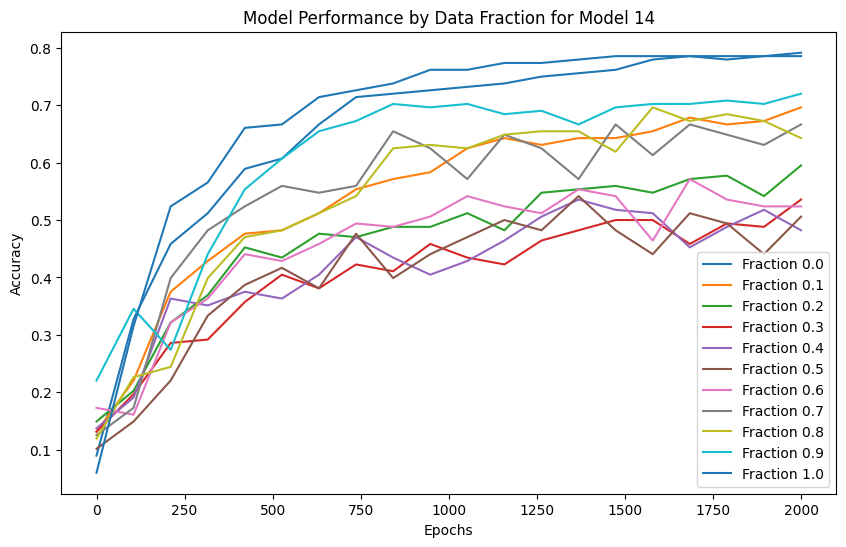

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2006
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.9863
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.5966
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.3514
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 1.2203
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 1.1033
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.9981
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.9139
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.8546
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.7975
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.7578
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.7258
predi

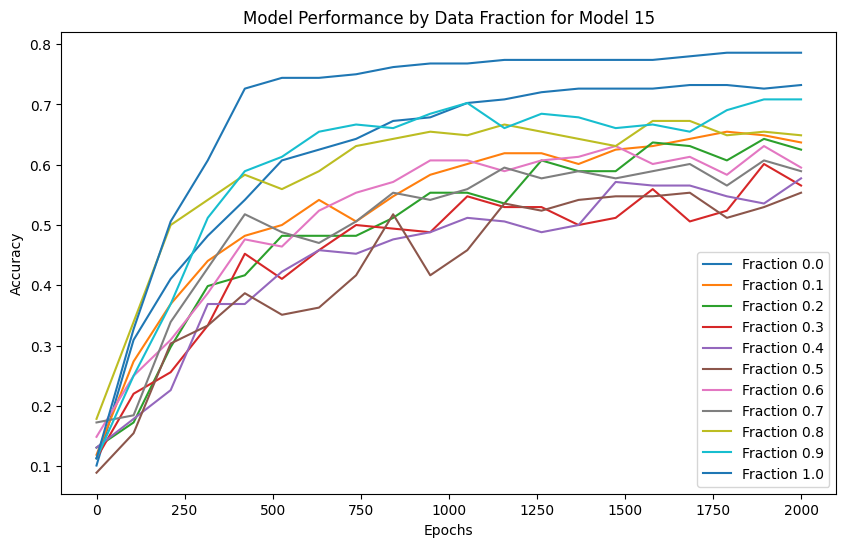

Model 16, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.9658
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.6683
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.4089
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 1.2337
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 1.1130
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 1.0278
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.9463
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.8824
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.8185
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.7538
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.7027
predi

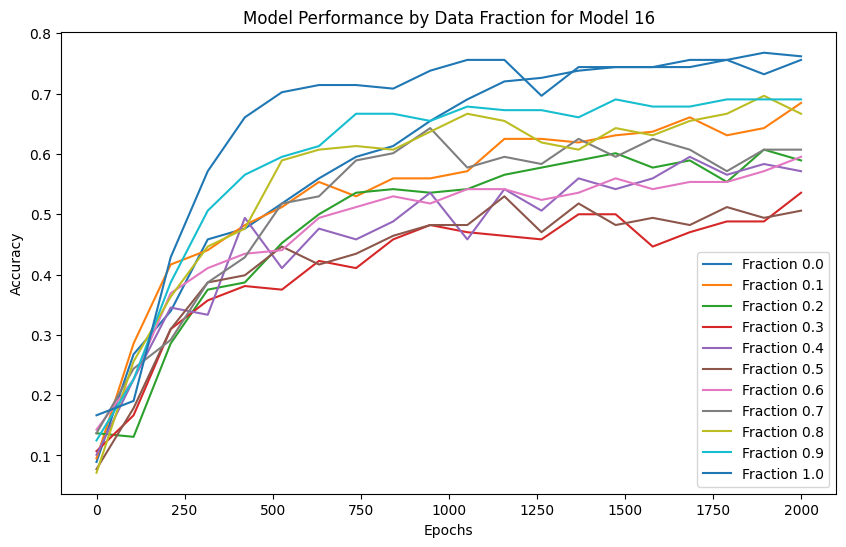

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.8806
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.5494
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 1.3361
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 1.1881
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 1.0685
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.9663
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.8932
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.8285
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.7782
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.7288
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.6983
predi

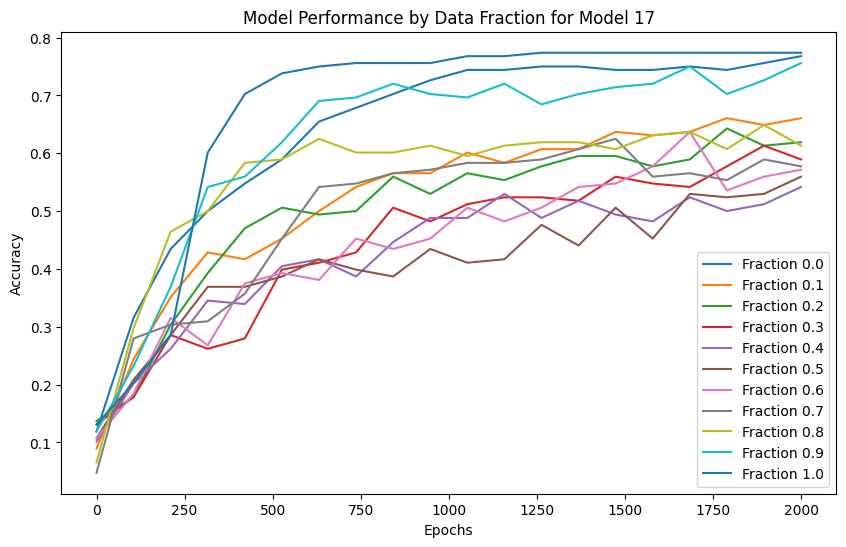

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2090
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 2.0190
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.5709
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 1.3232
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 1.1170
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.9996
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.8857
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.8188
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.7730
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.7270
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.6932
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.6685
predi

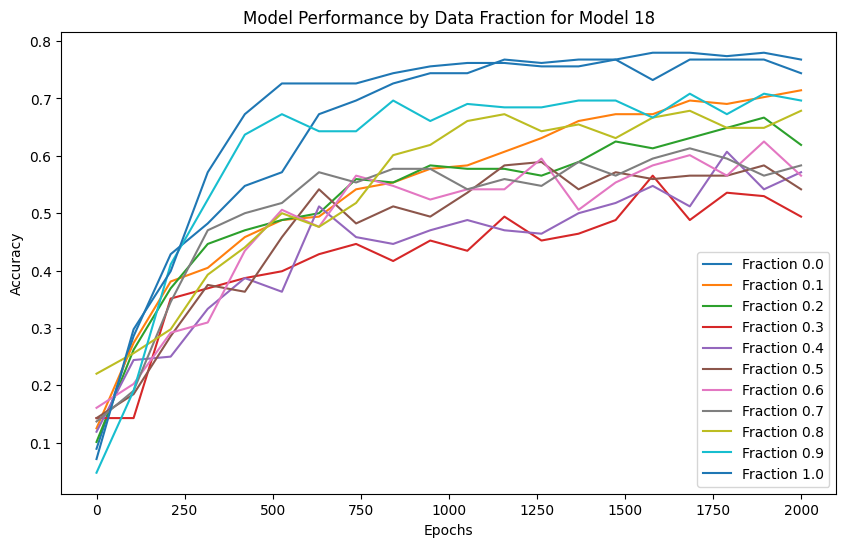

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2010
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9842
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.6519
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 1.4613
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 1.2901
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 1.1048
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.9799
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.9045
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.8491
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.8078
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.7598
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.7286
predi

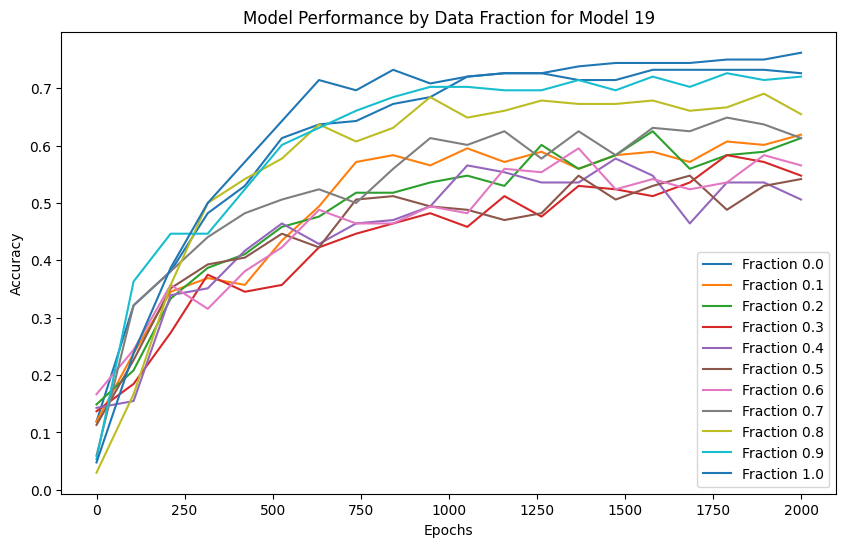

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1962
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9337
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.6040
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.3488
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 1.1759
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 1.0321
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.9425
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.8795
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.8238
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.7827
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.7483
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.7232
predi

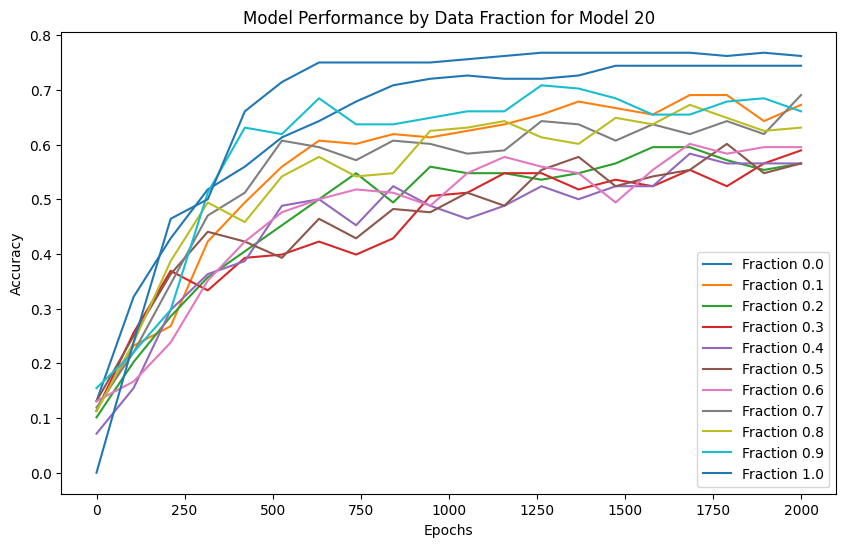

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2053
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.9338
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.6349
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 1.3438
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 1.1351
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 1.0036
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.9254
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.8697
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.8303
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.7929
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.7585
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.7543
predi

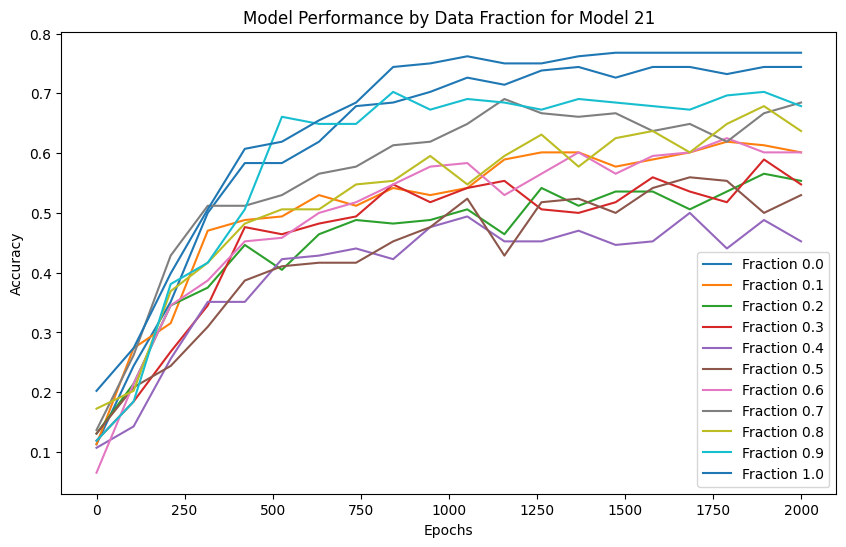

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2142
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.9642
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.6085
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.3677
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 1.2036
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 1.0958
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 1.0455
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 1.0017
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.9786
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.9467
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.9222
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.9053
predi

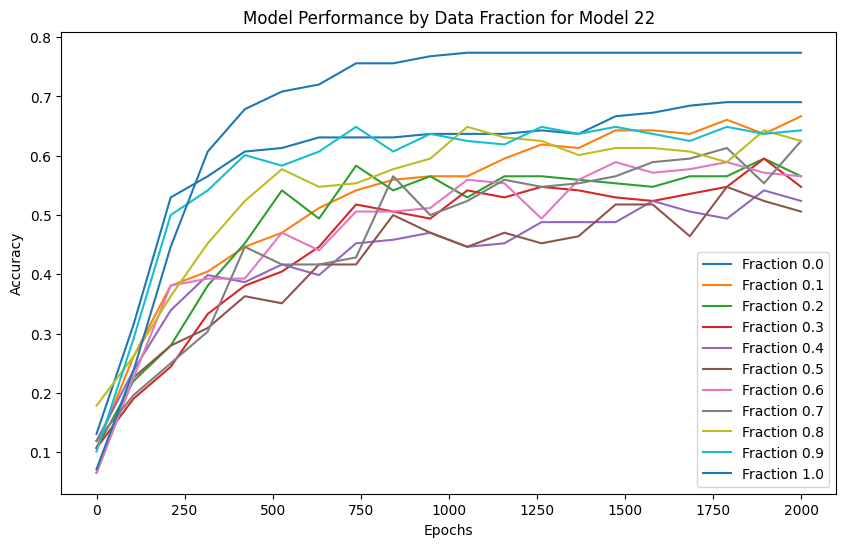

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9270
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.5415
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.3156
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 1.1395
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 1.0095
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.9199
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.8569
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.8081
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.7646
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.7559
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.6959
predi

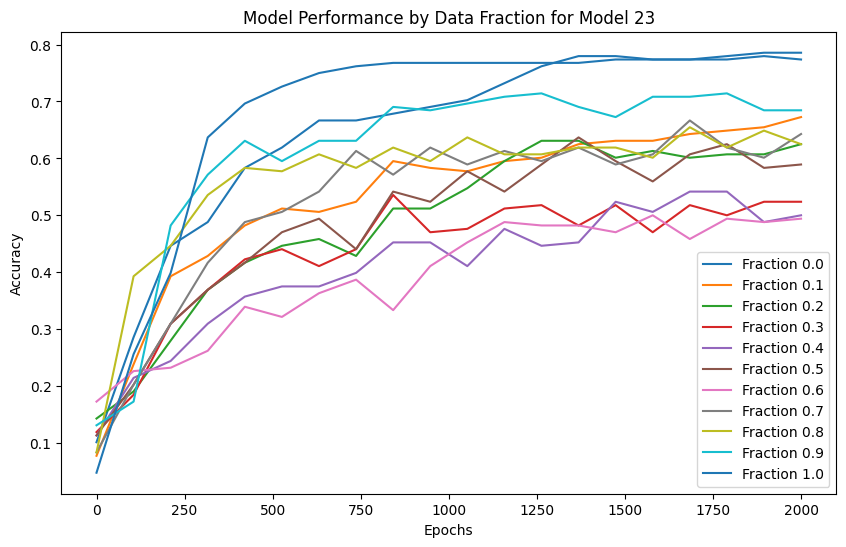

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2008
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.9982
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.6148
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.3800
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 1.1583
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 1.0000
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.8965
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.8305
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.7868
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.7312
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.7027
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.6779
predi

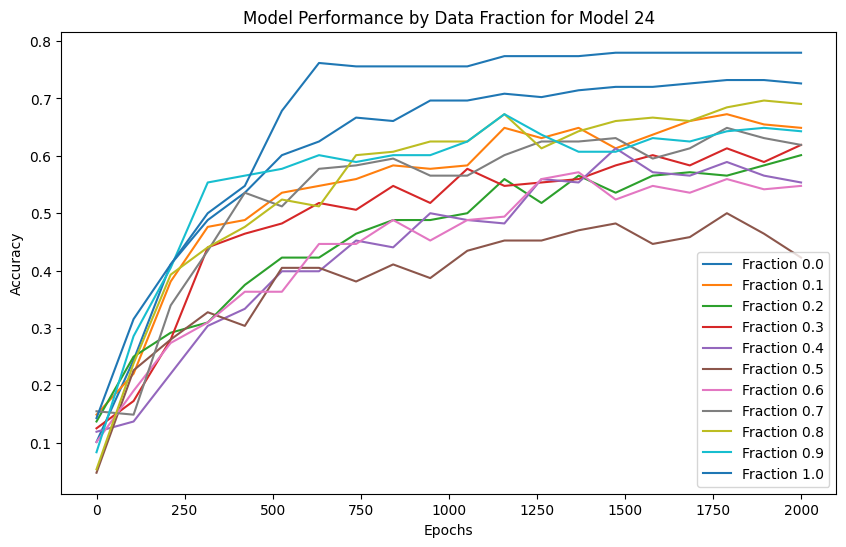

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2130
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 2.0315
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.6129
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.3835
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 1.2448
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 1.1383
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 1.0555
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.9914
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.9405
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.8923
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.8579
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.8327
predi

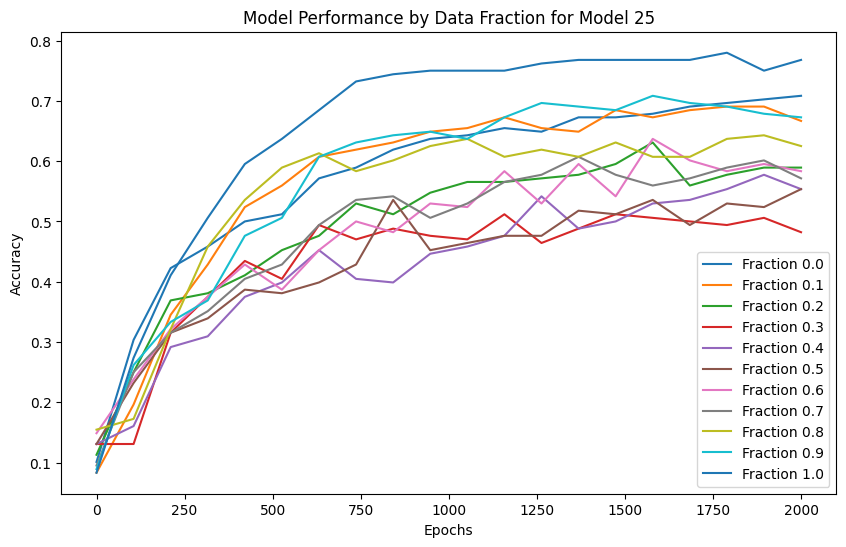

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1849
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.9151
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.6431
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 1.4592
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 1.2615
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 1.0845
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.9589
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.8838
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.8348
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.8003
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.7876
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.7494
predi

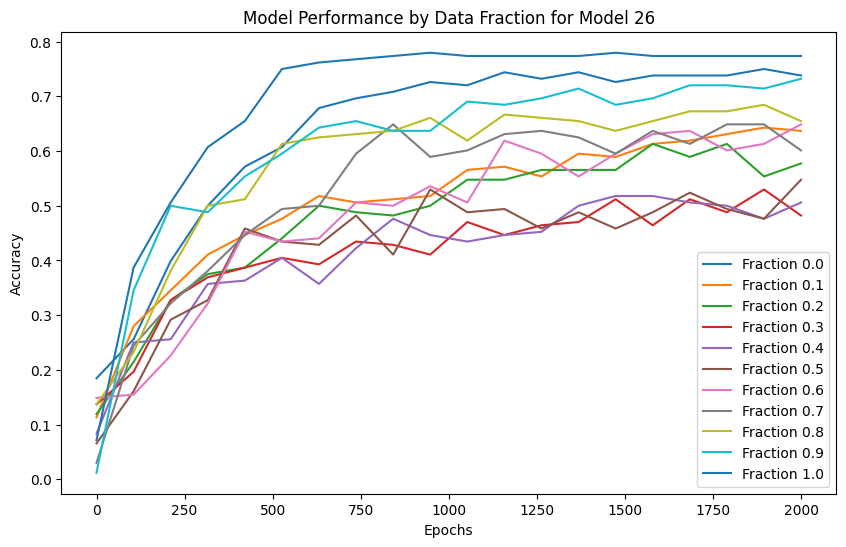

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2084
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 2.0280
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.5927
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.3604
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 1.2063
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 1.0814
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.9471
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.8131
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.7364
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.6923
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.6646
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.6426
predi

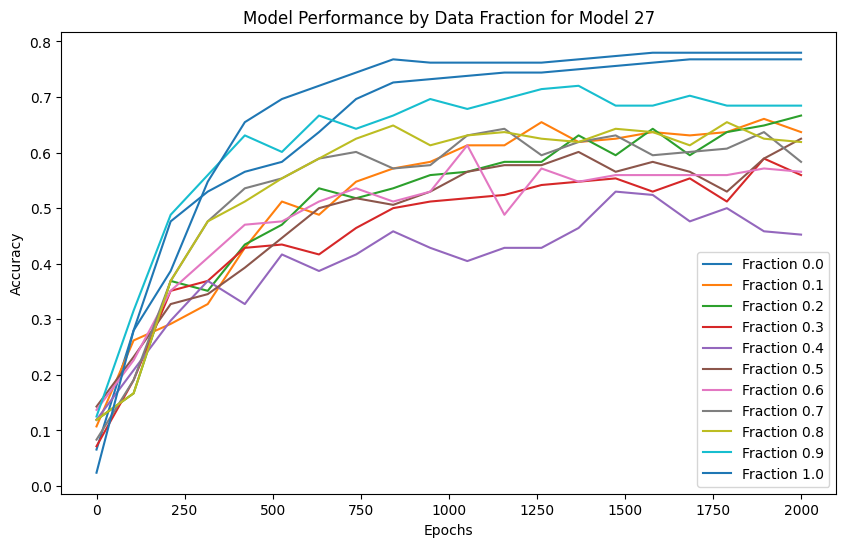

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2063
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 2.0252
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.6485
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.4087
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 1.2554
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 1.1144
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 1.0157
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.9547
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.9113
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.8800
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.8501
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.8177
predi

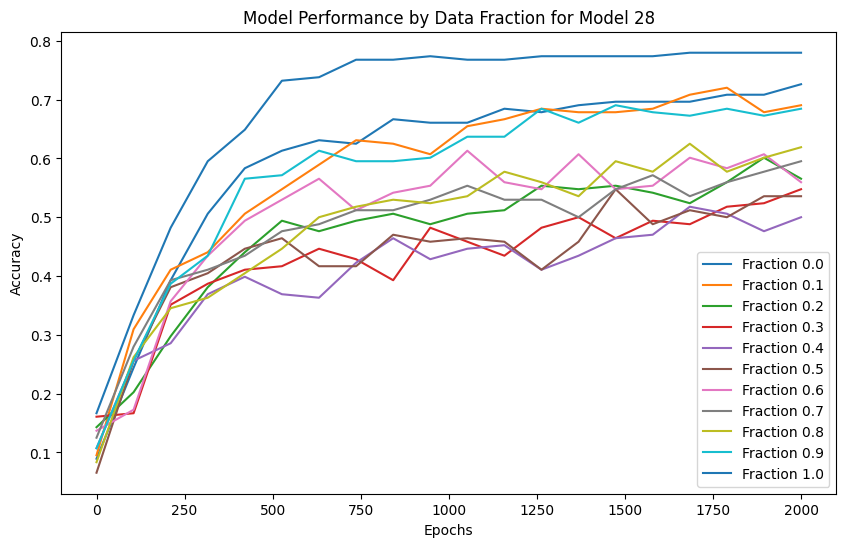

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2156
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 2.0236
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.6519
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 1.3776
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 1.1610
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 1.0077
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.8858
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.7985
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.7364
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.6957
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.6731
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.6469
predi

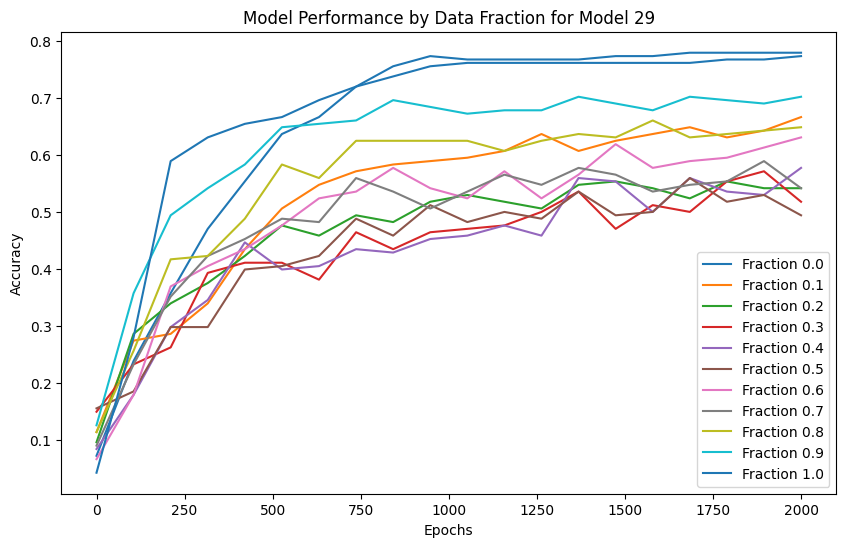

In [16]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_hard_daisy_5th_note_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [17]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_hard_daisy_5th_note_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0429
  Fraction 0.10, Average Accuracy: 0.2161
  Fraction 0.20, Average Accuracy: 0.3308
  Fraction 0.30, Average Accuracy: 0.4359
  Fraction 0.40, Average Accuracy: 0.5198
  Fraction 0.50, Average Accuracy: 0.6218
  Fraction 0.60, Average Accuracy: 0.6873
  Fraction 0.70, Average Accuracy: 0.7103
  Fraction 0.80, Average Accuracy: 0.7357
  Fraction 0.90, Average Accuracy: 0.7502
  Fraction 1.00, Average Accuracy: 0.7766
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7474
  Fraction 0.10, Average Accuracy: 0.7083
  Fraction 0.20, Average Accuracy: 0.6562
  Fraction 0.30, Average Accuracy: 0.6016
  Fraction 0.40, Average Accuracy: 0.5442
  Fraction 0.50, Average Accuracy: 0.4440
  Fraction 0.60, Average Accuracy: 0.4276
  Fraction 0.70, Average Accuracy: 0.3786
  Fraction 0.80, Average Accuracy: 0.3399
  Fraction 0.90, Average Accuracy: 0.2665
  Fraction 1.00, Average Accuracy: 0.0702


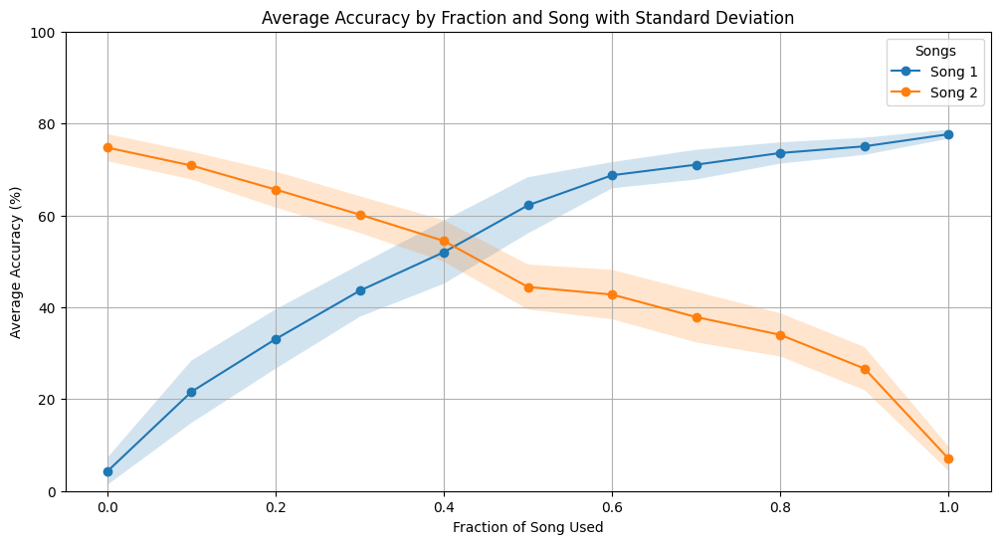

In [18]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()
